### BADASS Analysis: NASH (nonalcoholic fatty liver disease) - 2 classes

Can we train an ML model to distinguish between serum samples from two different classes of patient (patients with and without NASH (nonalcoholic fatty liver disease))? And can the model successfully classify samples from patients it has not seen during training?

(In this dataset, include single (median) reading for each patient.)

#### Analytes

Normal:
- Patient 1
- Patient 2
- Patient 3
- Patient 4
- Patient 5
- Patient 6
- Patient 7
- Patient 8
- Patient 9
- Patient 10
- Patient 11
- Patient 12
- Patient 13
- Patient 14
- Patient 29
- Patient 30
- Patient 31
- Patient 32
- Patient 33
- Patient 34
- Patient 35
- Patient 36
- Patient 37
- Patient 38
- Patient 39
- Patient 40
- Patient 41
- Patient 42

NASH:
- Patient 15
- Patient 16
- Patient 17
- Patient 18
- Patient 19
- Patient 20
- Patient 21
- Patient 22
- Patient 23
- Patient 24
- Patient 25
- Patient 26
- Patient 27
- Patient 28

Note that whilst the NASH patients definitely have NASH, the "normal" patients have not been tested to see if they also have NASH or not. Both sets of patients also have a range of other medical conditions (e.g. all of the NASH patients, and half of the "Normal" patients, have CAD (coronary artery disease)). Consequently, in spite of merging the original CAD and Normal classes into a single "Normal" class in this current analysis, these two new classes remain noisy, and this is likely to be reflected in the results!

In [1]:
# Import from array_sensing package
from subroutines.parse_array_data import ParseArrayData
from subroutines.train import RunML, draw_conf_matrices

In [2]:
import copy
import math
import os
import pickle
import random
import shutil
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from collections import OrderedDict
from IPython.display import display
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import (
    accuracy_score, recall_score, precision_score, f1_score, cohen_kappa_score, make_scorer
)
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import LinearSVC, SVC

%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size

#### Parse in input data

NASH data (large array)

In [3]:
nash_fluor_data = ParseArrayData(
    data_dirs_dict={'DPH': '/home/ks17361/ML_environment/BADASS/NASH_serum_data/'
                           'Reformatted_csvs_2_classes_split_illness/'},
    results_dir='/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_2_classes_split_illness/'
                'NASH_plate_parsing_plots/',
    repeat_labels_list=['repeat_1', 'repeat_2', 'repeat_3', 'repeat_4', 'repeat_5', 'repeat_6', 'repeat_7',
                        'repeat_8', 'repeat_9', 'repeat_10', 'repeat_11', 'repeat_12', 'repeat_13', 'repeat_14',
                        'repeat_15', 'repeat_16', 'repeat_17', 'repeat_18', 'repeat_19', 'repeat_20', 'repeat_21',
                        'repeat_22', 'repeat_23', 'repeat_24', 'repeat_25', 'repeat_26', 'repeat_27', 'repeat_28'],
    peptide_dict = {'DPH': ['No Pep', 'CCPent', 'QLKEIA', 'CCHex2-I24K', 'CCHept-I24N', 'CCHept-L28W',
                            'GRP22', 'CCHex', 'NLKEIA', 'CCHept-L28K', 'CCHept-I24T', 'CCHept-L7Y',
                            'GRP35', 'CCHex2', 'CCHept-I17G-L21G', 'CCHept-I17H', 'CCHept-I24H', 'CCHept-L28Y',
                            'GRP46', 'CCHept', 'CCHept-I17A-L21A', 'CCHept-I17K-L24E', 'CCHept-L21S-I24S',
                            'CCHept-I24Y', 'GRP51', 'CCHept-I24D', 'CCHept-L14A', 'CCHept-L7K',
                            'CCHept-L21N-I24N', 'CCHept-L21S-I24Y', 'GRP52', 'CCHept-I24E', 'CCHept-L21A',
                            'CCHept-L21K-I24E', 'CCHept-L21T-I24T', 'CCHept-L21Y-I24S', 'GRP63', 'CCHept-I24K',
                            'CCHept-L21K', 'CCHept-L21E-I24K', 'CCHept-L21H-I24H', 'CCHept-I17T', 'GRP80',
                            'CCHept-I17K', 'CCPent-I24K', 'CCHept-I24S', 'CCHept-L7W', 'CCHept-I24P']},
    control_peptides={'DPH': ['GRP35']},
    control_analytes=[]
)

Locate xlsx files

In [4]:
nash_fluor_data.group_xlsx_repeats()

In [5]:
nash_fluor_data.repeat_dict

OrderedDict([('repeat_1',
              OrderedDict([('DPH',
                            ['NASH_fifteenR1_repeat_1.xlsx',
                             'NASH_fifteenR2_repeat_1.xlsx',
                             'NASH_fifteenR3_repeat_1.xlsx',
                             'NASH_fifteenR4_repeat_1.xlsx',
                             'Normal_oneR1_repeat_1.xlsx',
                             'Normal_oneR2_repeat_1.xlsx',
                             'Normal_oneR3_repeat_1.xlsx',
                             'Normal_oneR4_repeat_1.xlsx'])])),
             ('repeat_2',
              OrderedDict([('DPH',
                            ['NASH_sixteenR1_repeat_2.xlsx',
                             'NASH_sixteenR2_repeat_2.xlsx',
                             'NASH_sixteenR3_repeat_2.xlsx',
                             'NASH_sixteenR4_repeat_2.xlsx',
                             'Normal_twoR1_repeat_2.xlsx',
                             'Normal_twoR2_repeat_2.xlsx',
                             'N

Read the data in each xlsx file into a dataframe and perform min-max scaling

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteenR1_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

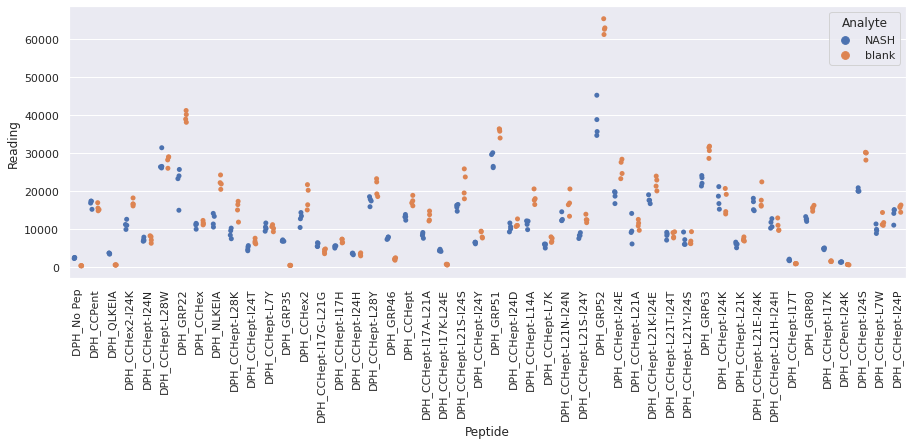

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR2_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteenR2_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

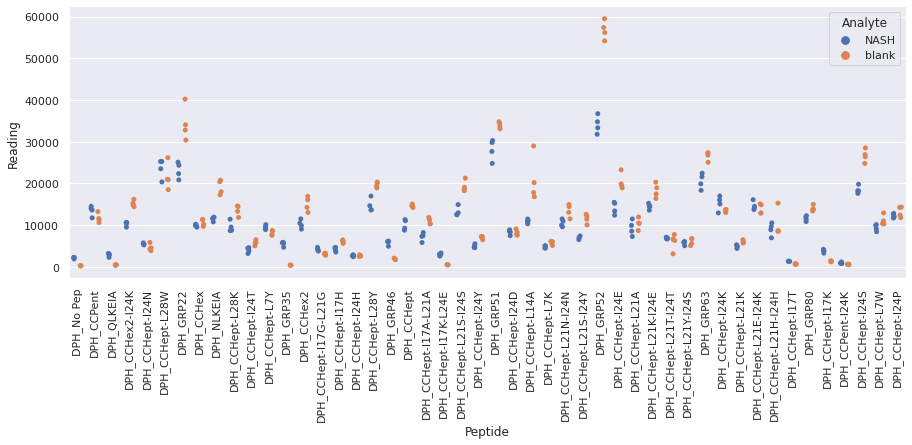

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR3_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteenR3_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

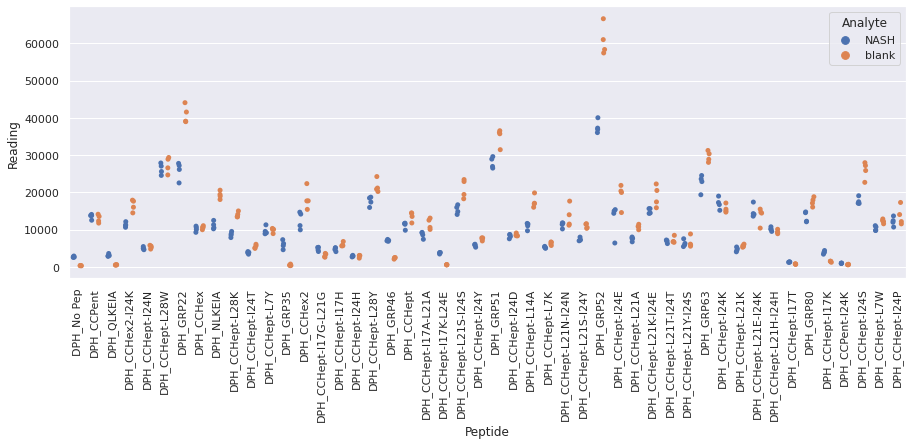

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR4_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteenR4_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

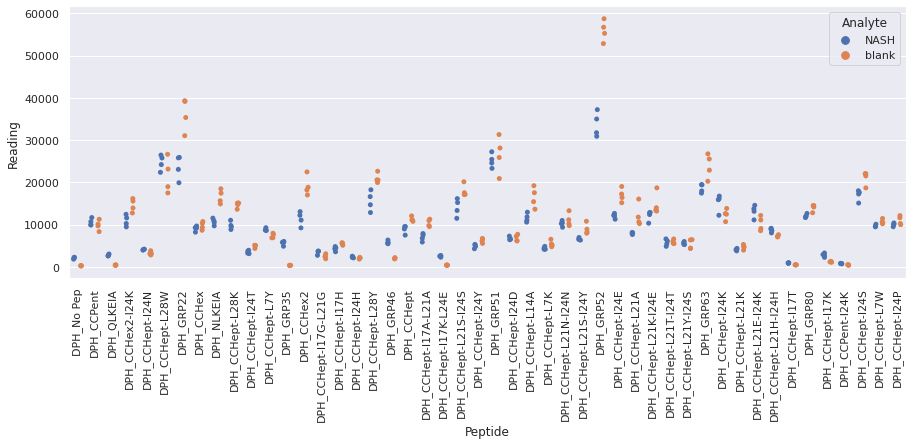

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR1_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_oneR1_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

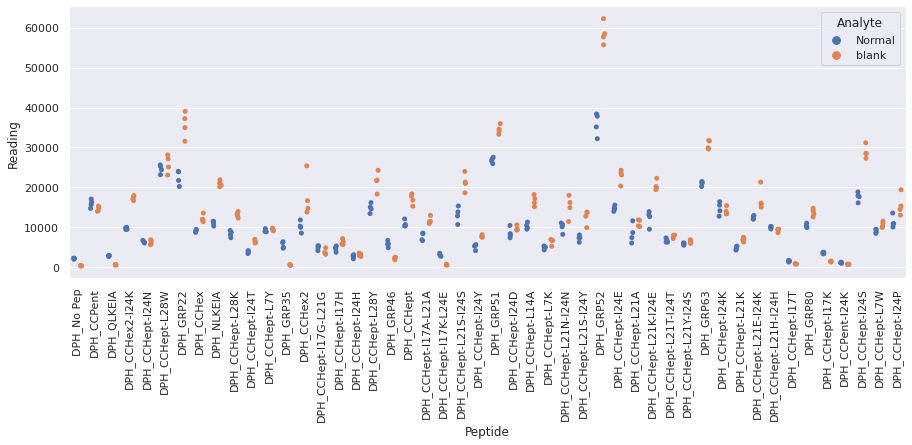

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR2_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_oneR2_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

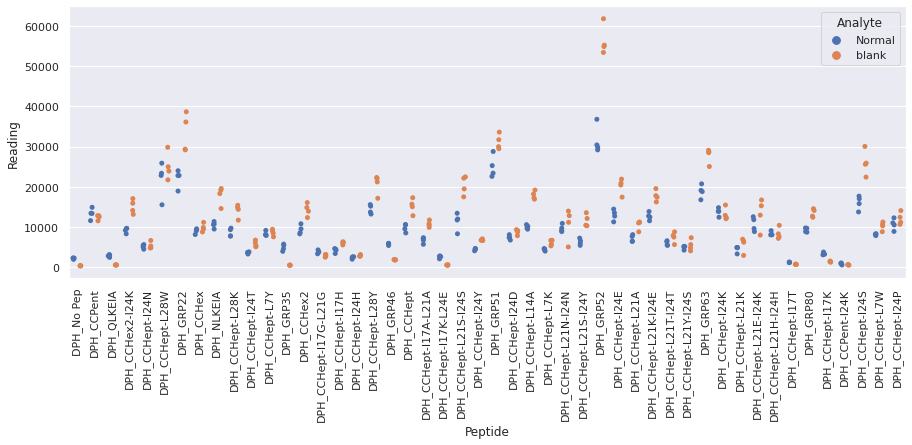

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR3_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_oneR3_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

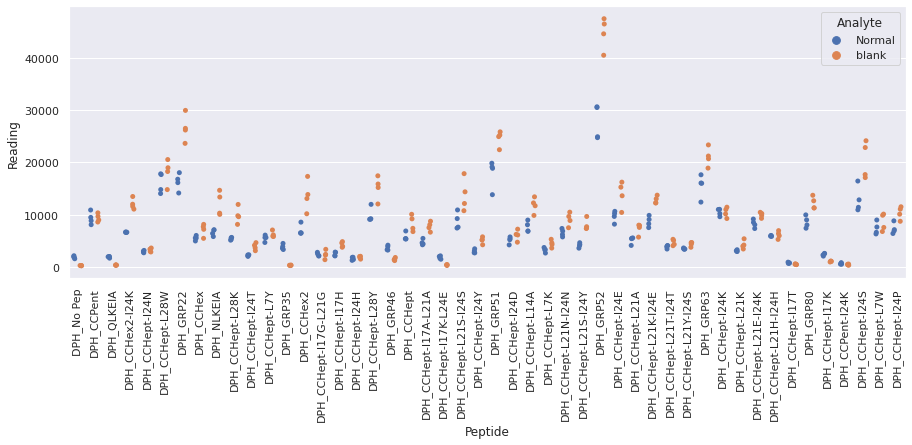

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR4_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_oneR4_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

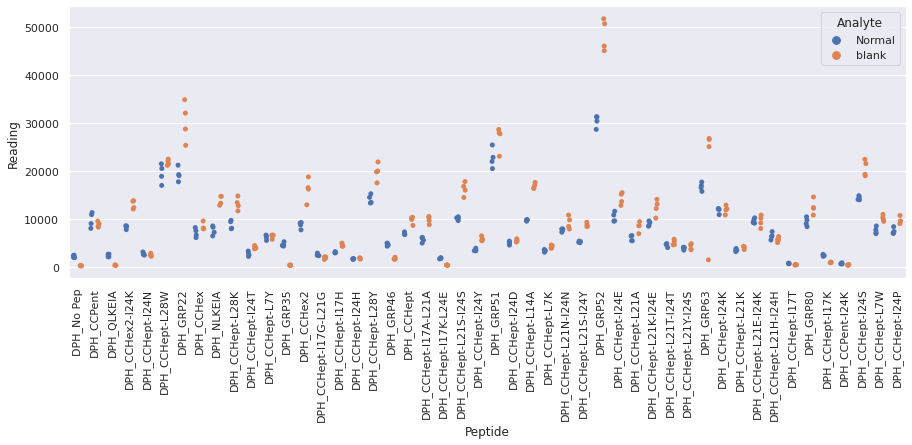

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR1_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteenR1_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

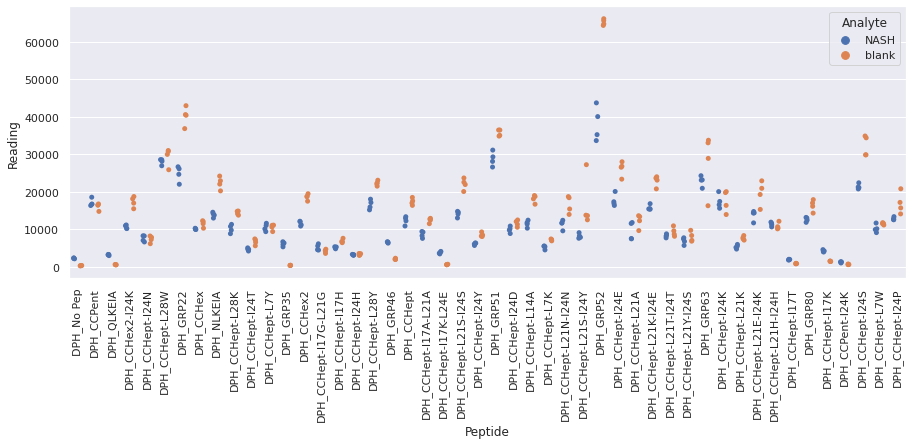

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR2_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteenR2_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

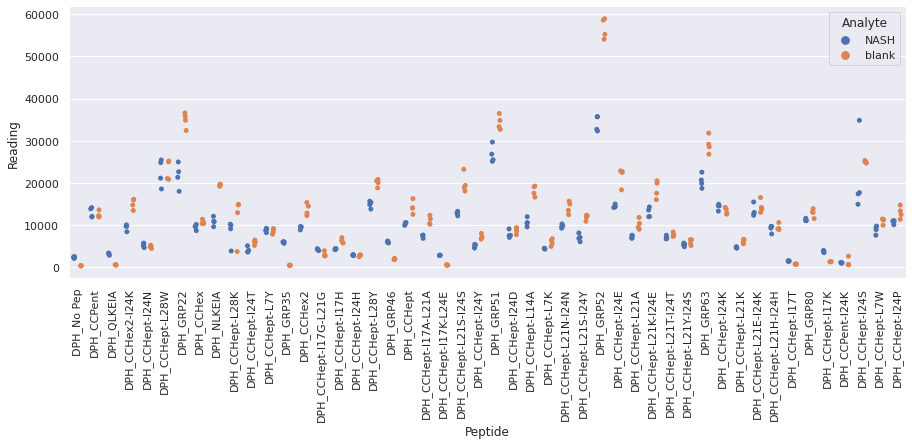

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR3_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteenR3_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

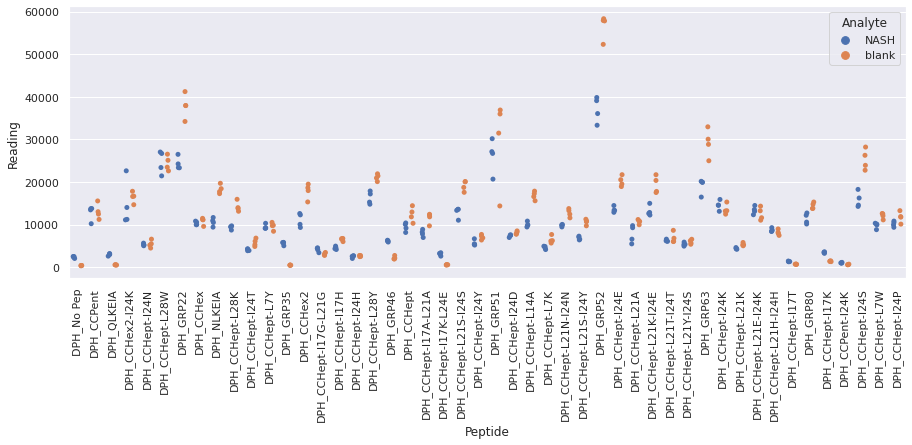

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR4_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteenR4_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

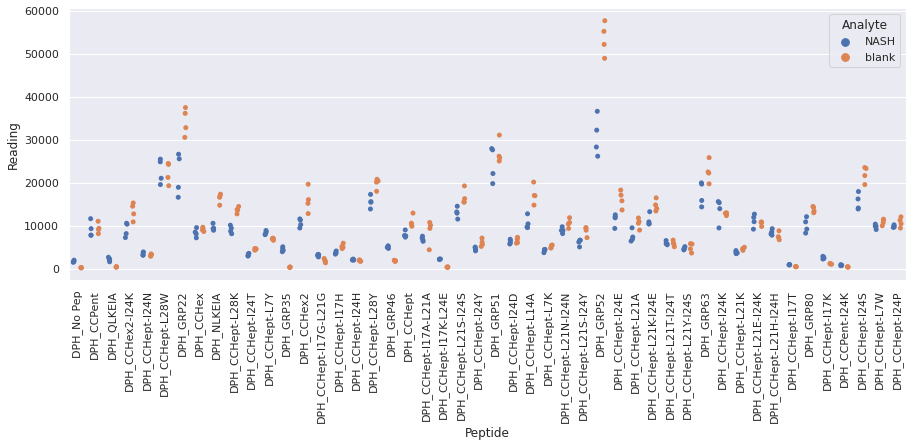

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR1_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twoR1_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

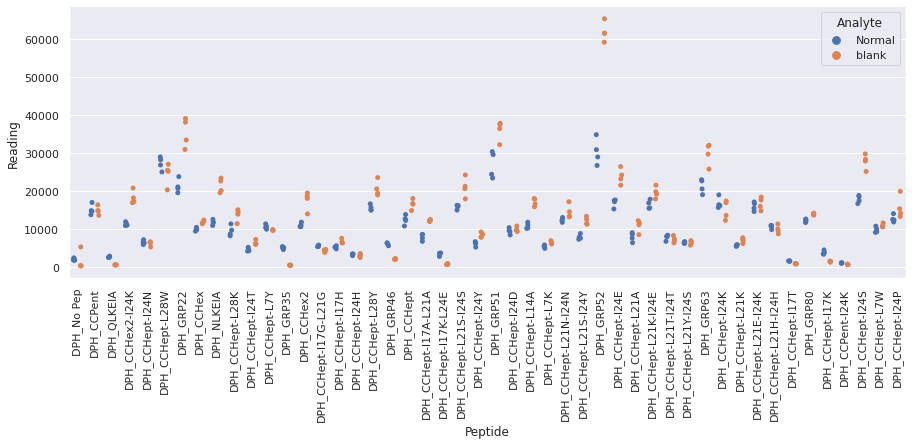

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR2_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twoR2_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

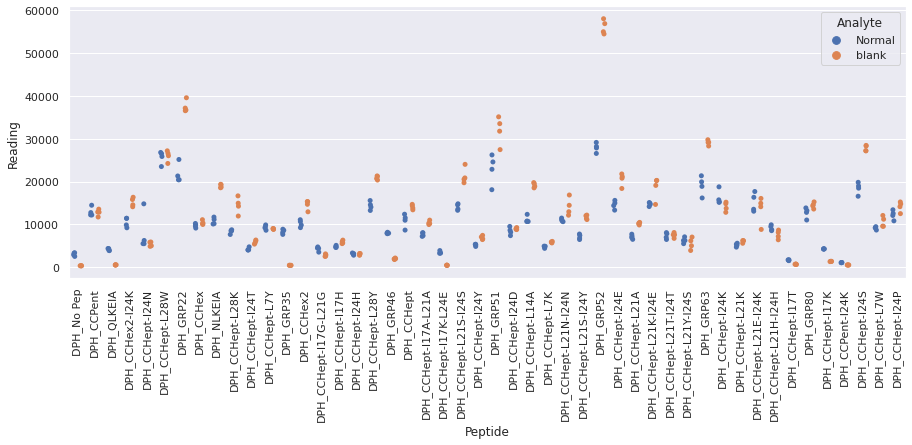

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR3_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twoR3_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

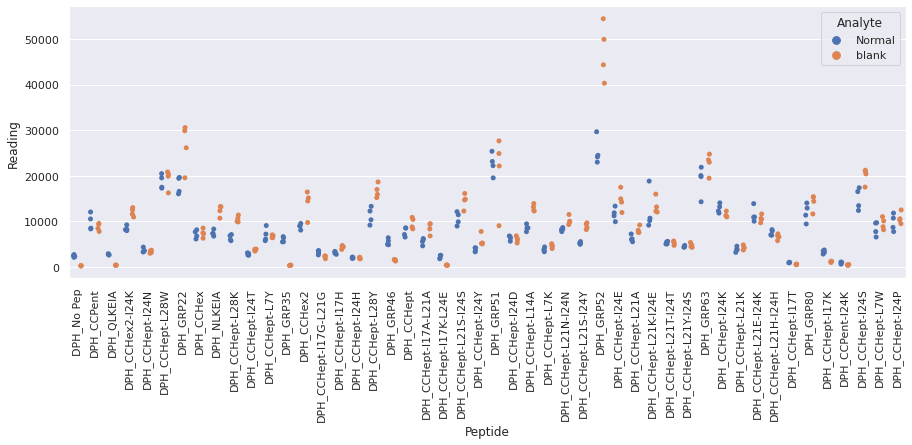

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR4_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twoR4_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

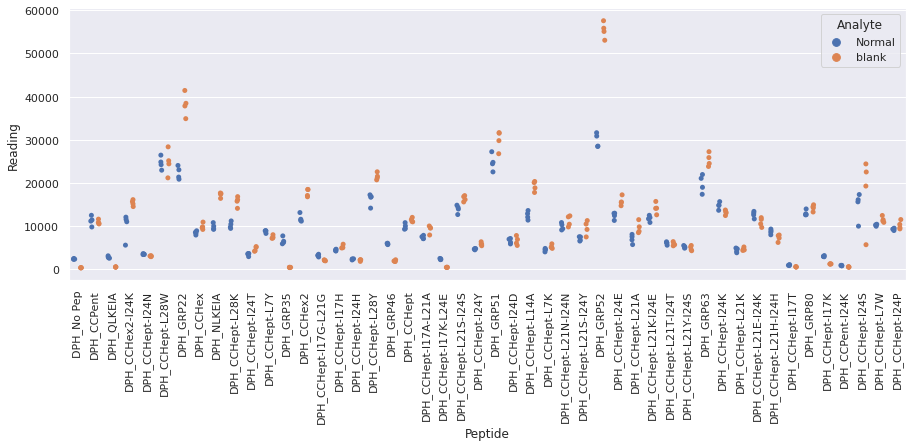

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR1_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeenR1_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

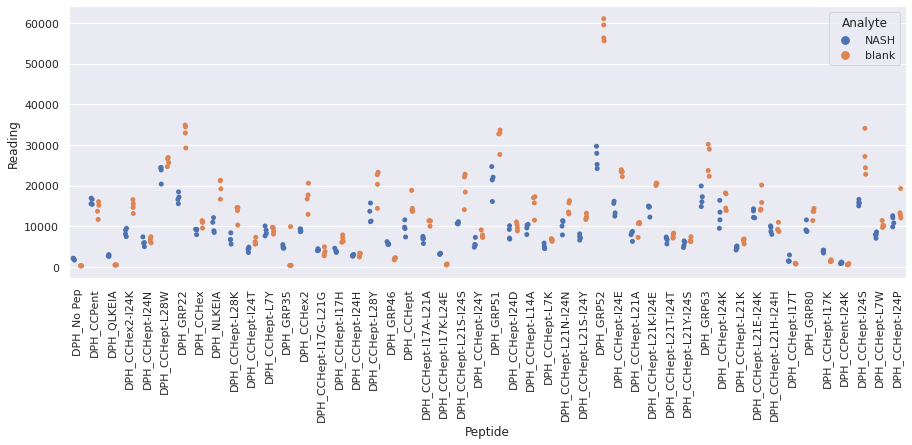

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR2_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeenR2_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

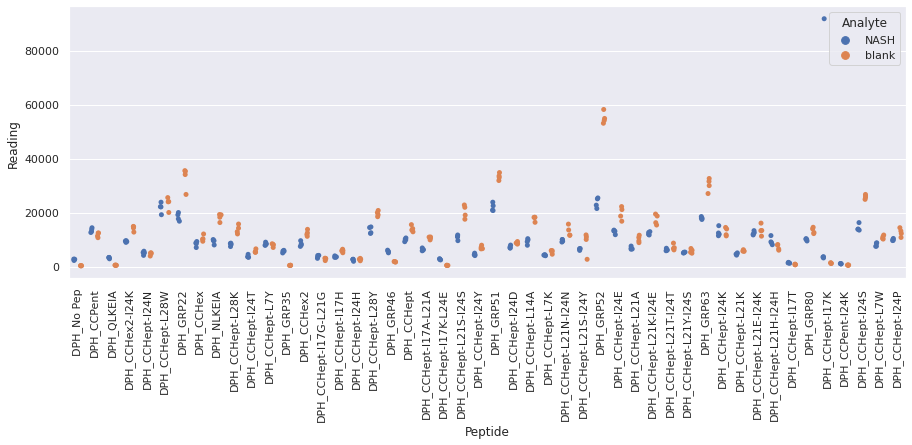

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR3_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeenR3_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

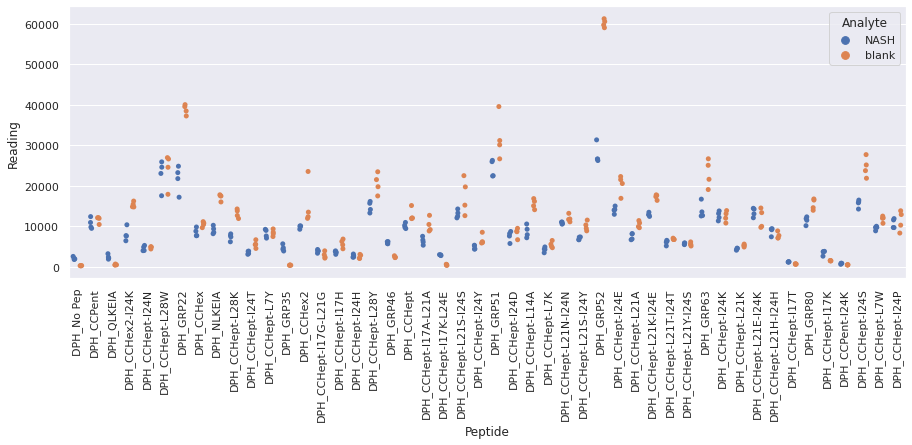

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR4_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeenR4_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

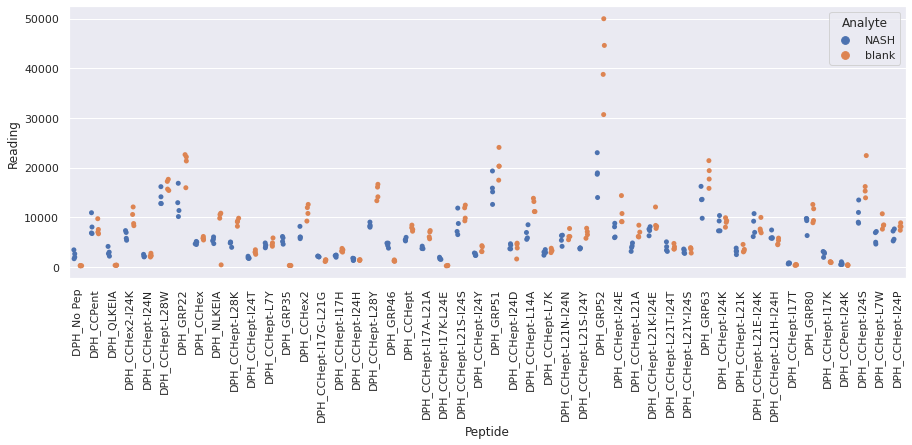

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR1_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_threeR1_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

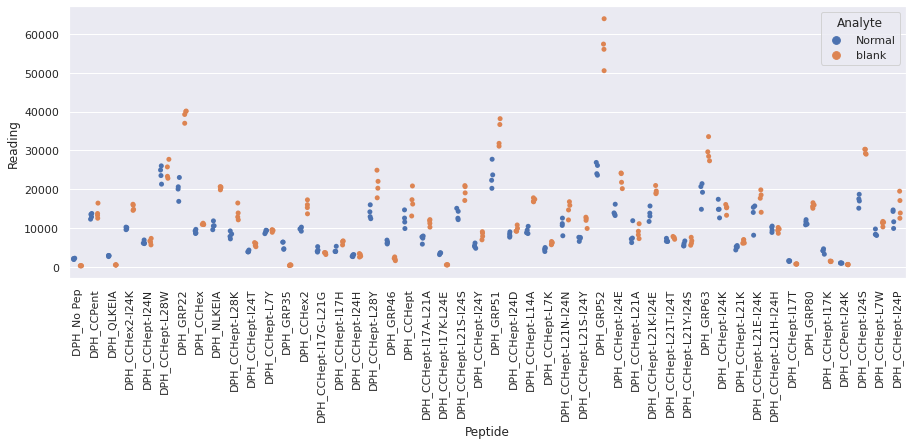

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR2_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_threeR2_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

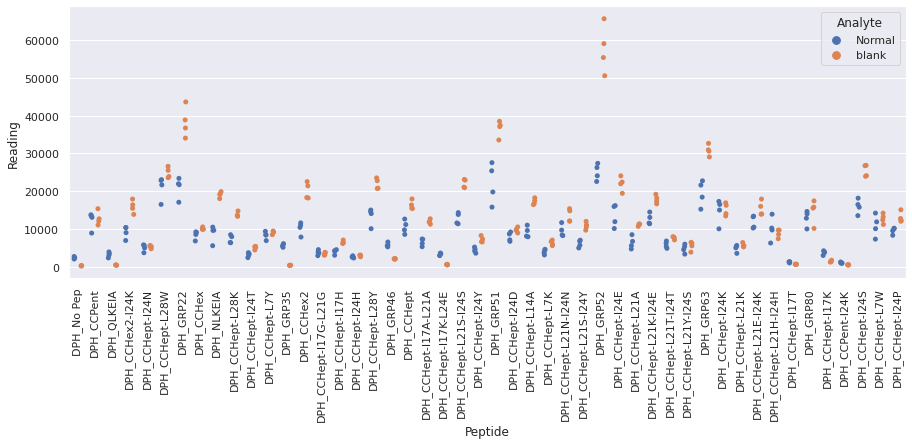

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR3_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_threeR3_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

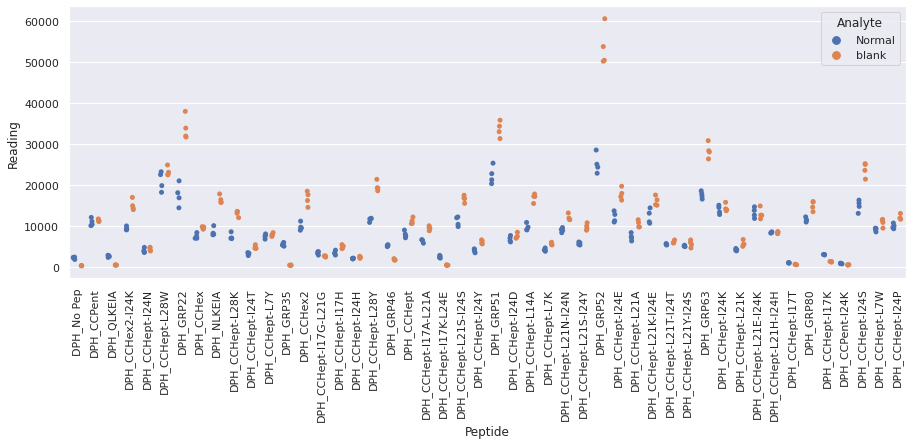

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR4_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_threeR4_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

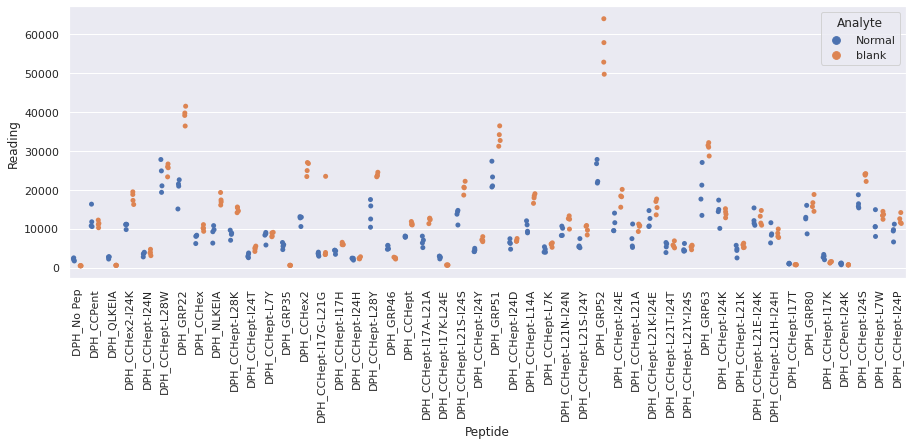

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR1_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteenR1_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

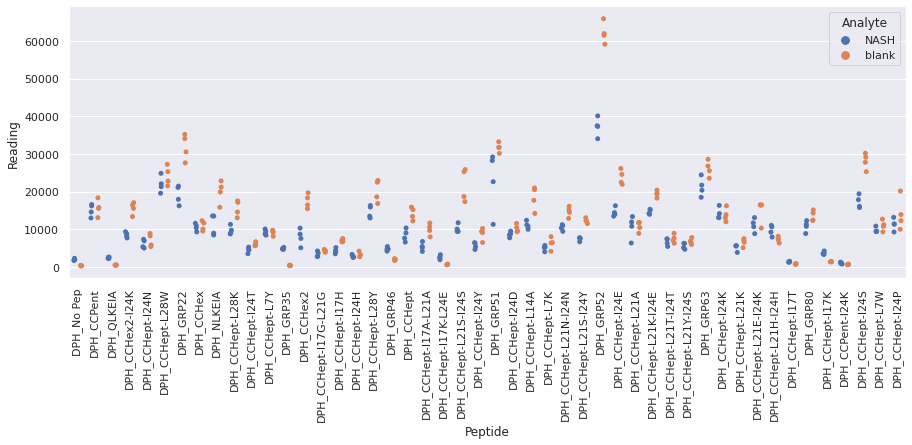

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR2_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteenR2_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

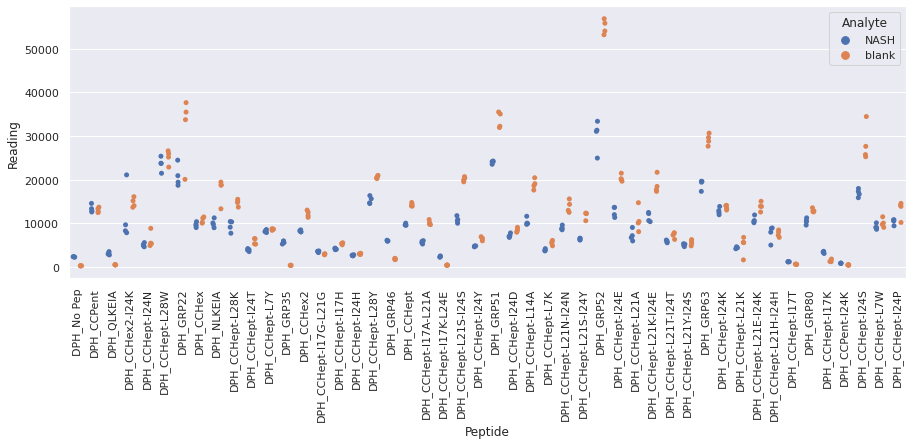

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR3_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteenR3_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

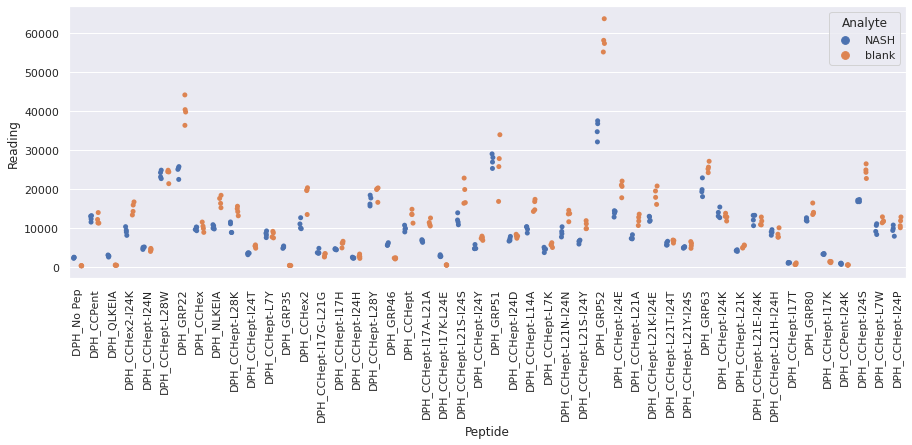

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR4_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteenR4_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

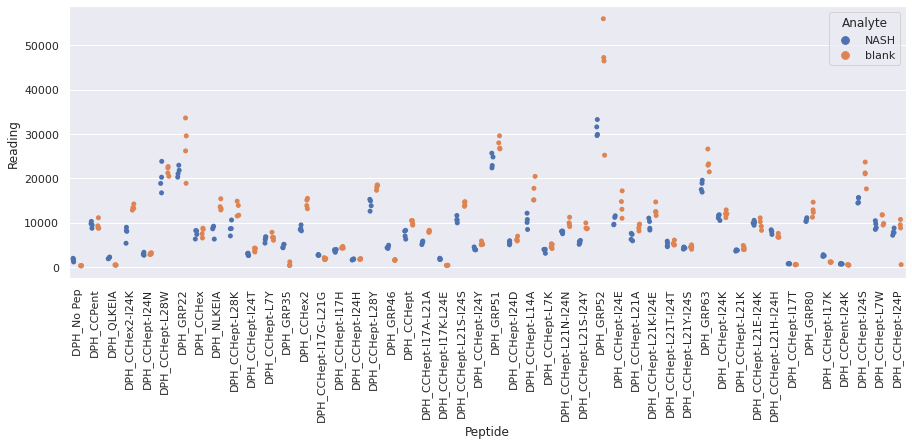

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR1_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourR1_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

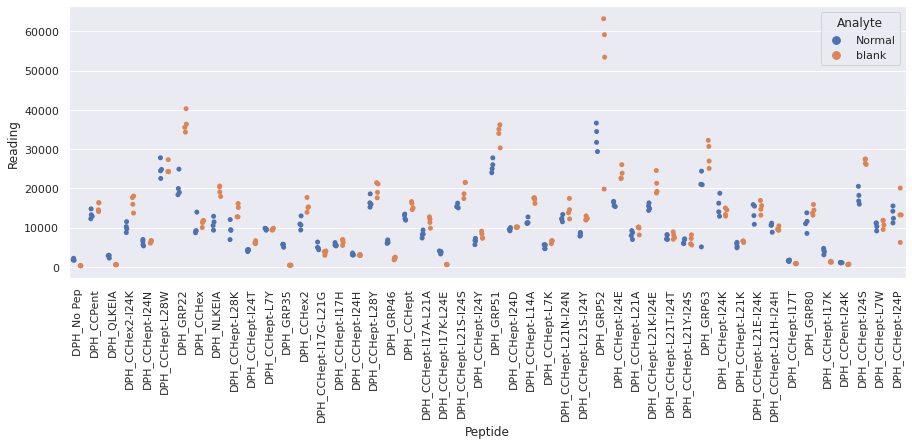

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR2_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourR2_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

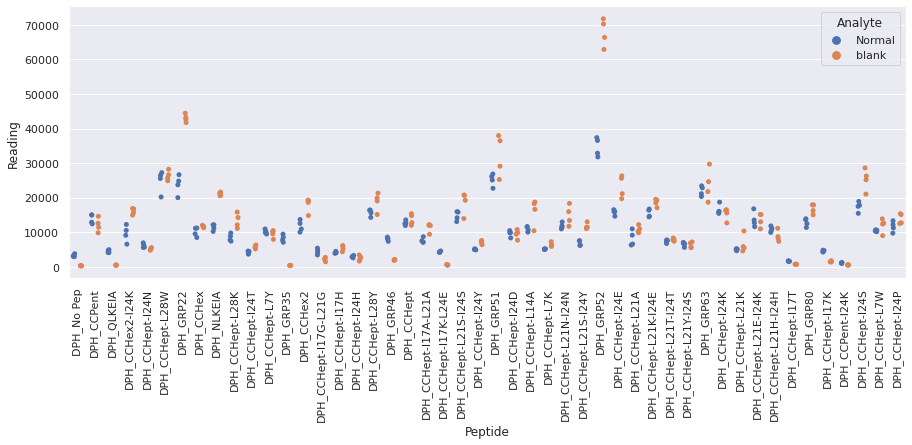

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR3_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourR3_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

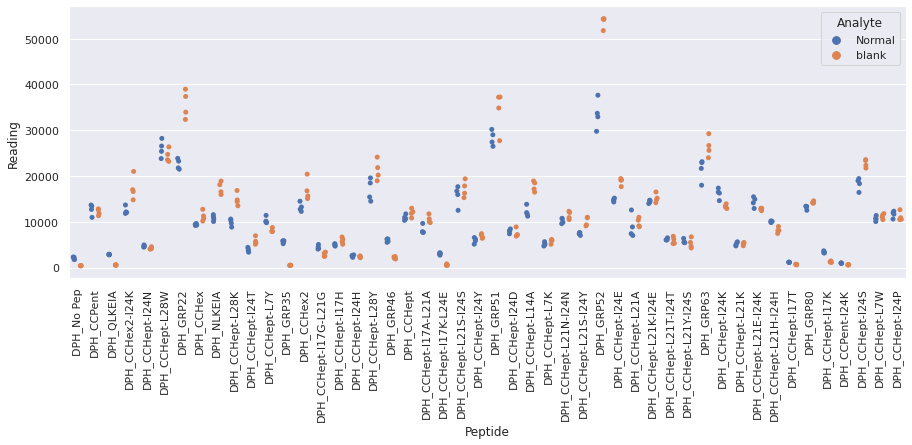

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR4_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourR4_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

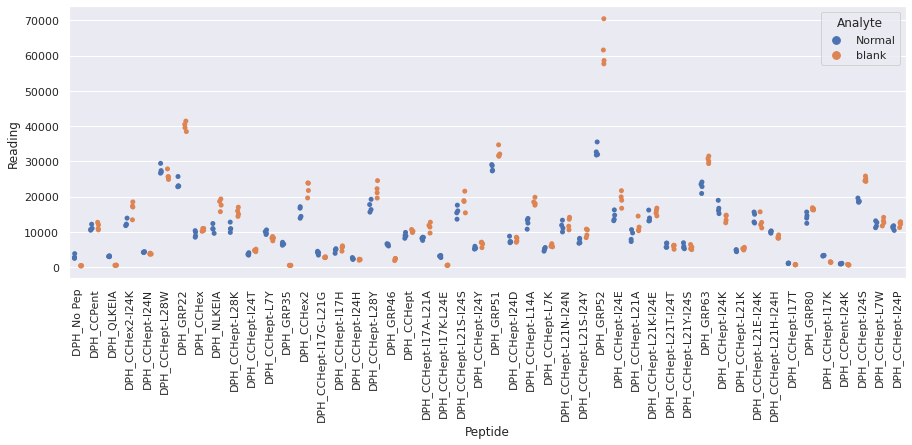

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR1_repeat_5.xlsx
Drawing scatter plot of data spread for NASH_nineteenR1_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

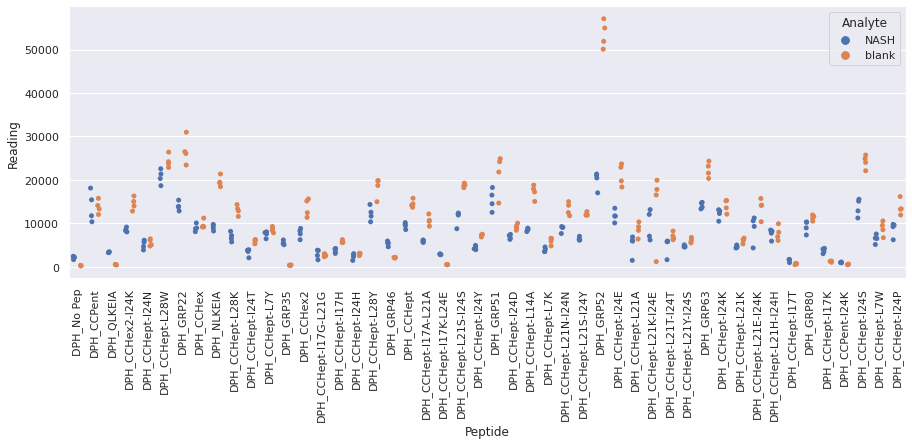

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR2_repeat_5.xlsx
Drawing scatter plot of data spread for NASH_nineteenR2_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

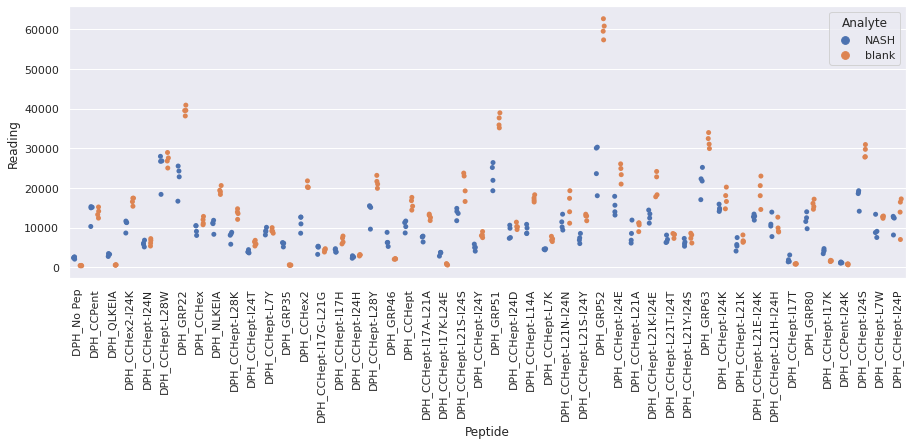

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR3_repeat_5.xlsx
Drawing scatter plot of data spread for NASH_nineteenR3_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

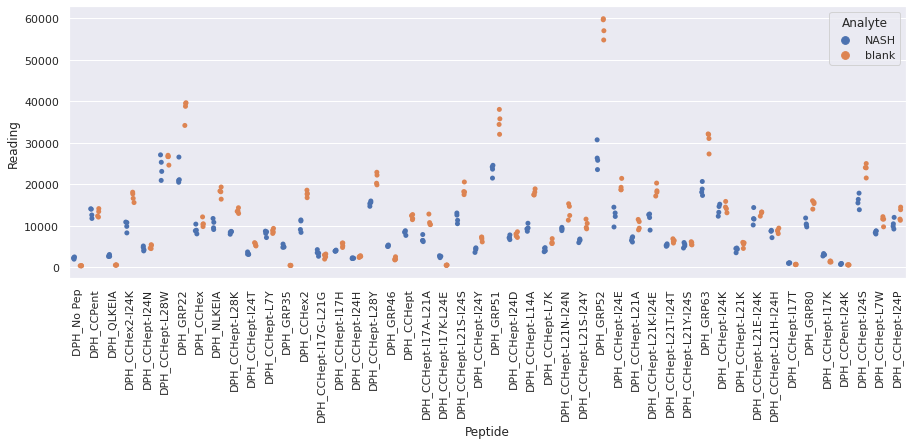

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR4_repeat_5.xlsx
Drawing scatter plot of data spread for NASH_nineteenR4_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

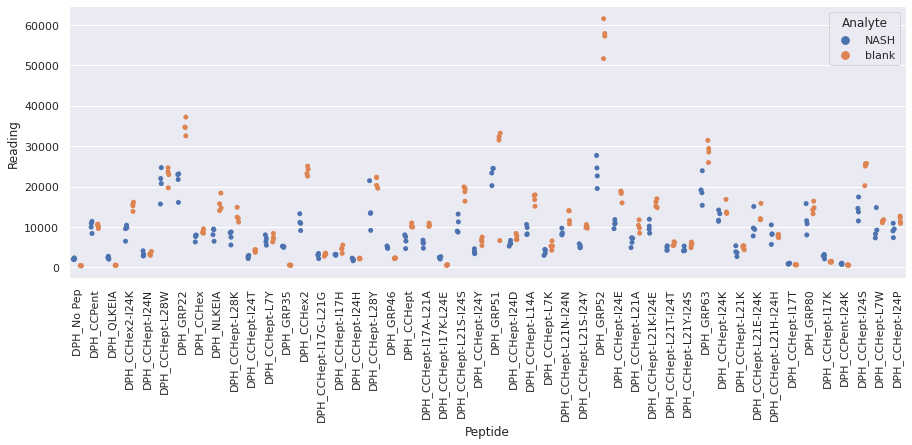

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR1_repeat_5.xlsx
Drawing scatter plot of data spread for Normal_fiveR1_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

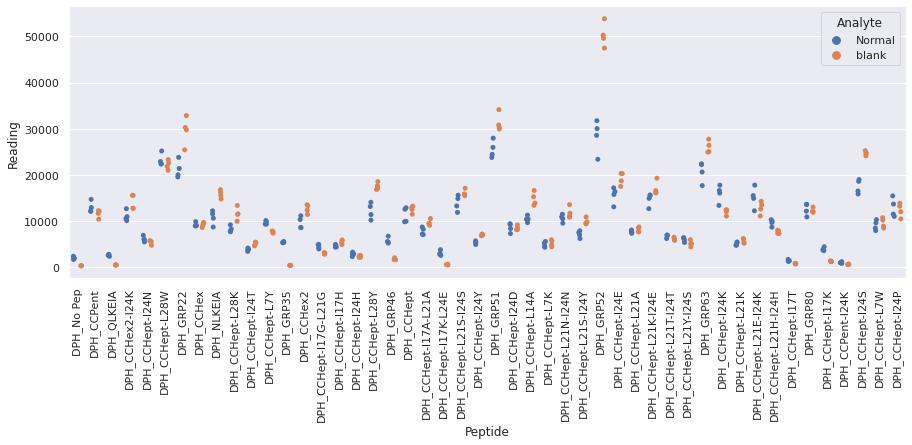

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR2_repeat_5.xlsx
Drawing scatter plot of data spread for Normal_fiveR2_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

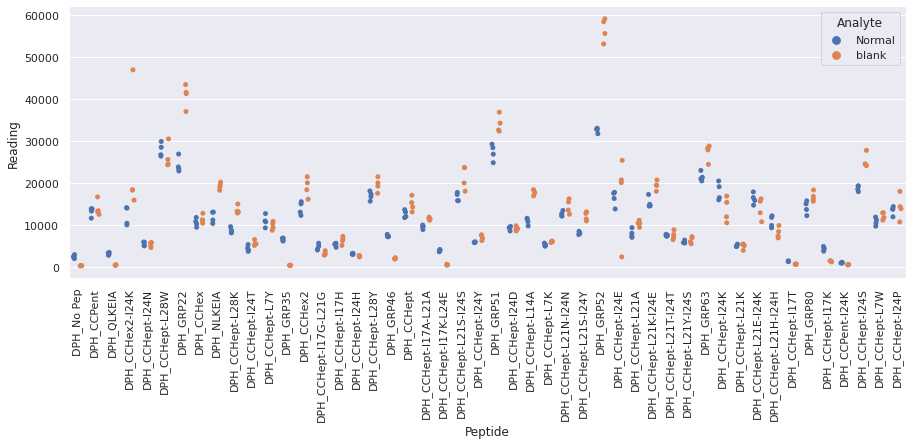

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR3_repeat_5.xlsx
Drawing scatter plot of data spread for Normal_fiveR3_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

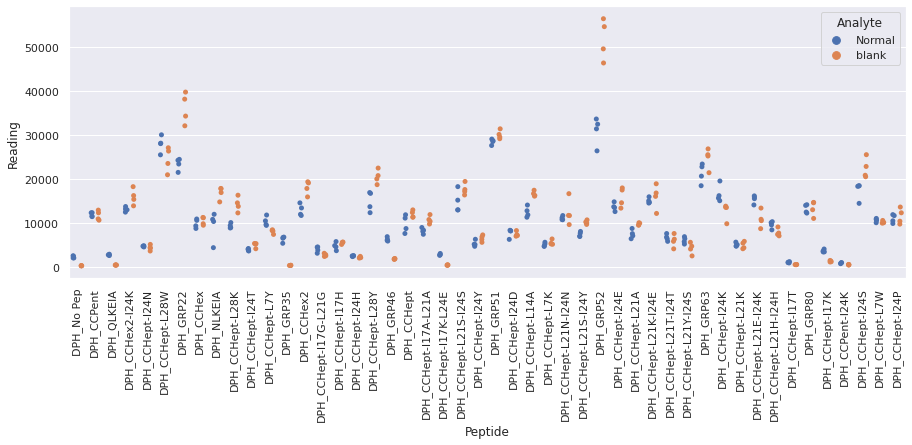

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR4_repeat_5.xlsx
Drawing scatter plot of data spread for Normal_fiveR4_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

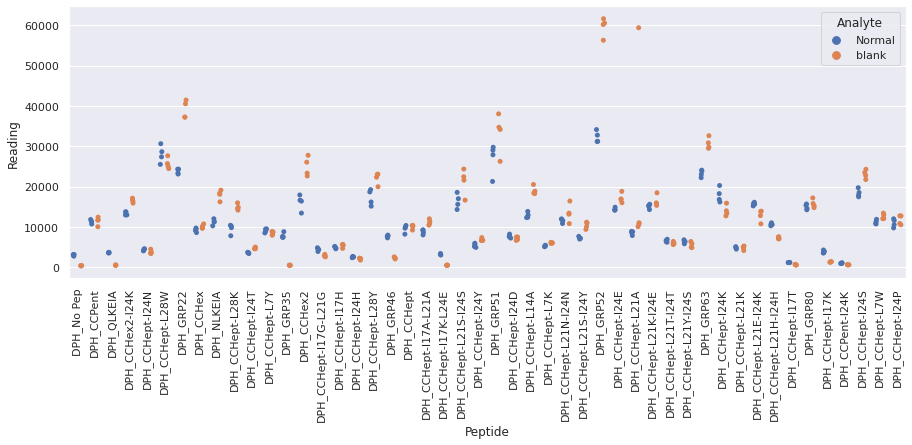

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR1_repeat_6.xlsx
Drawing scatter plot of data spread for NASH_twentyR1_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

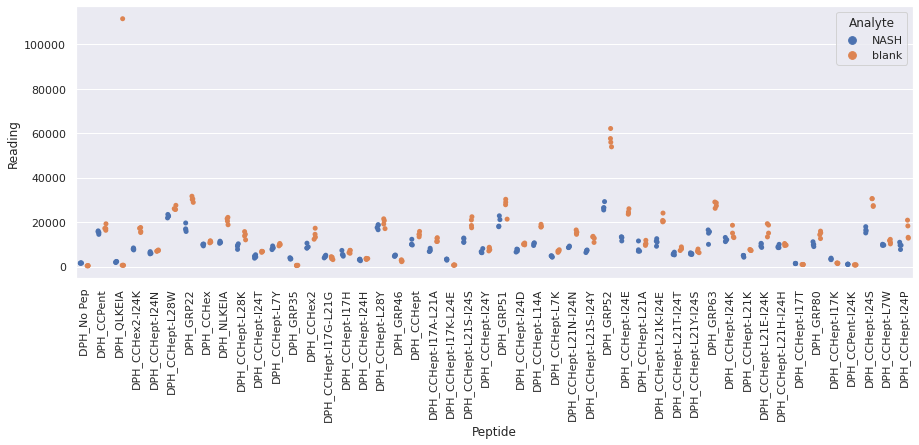

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR2_repeat_6.xlsx
Drawing scatter plot of data spread for NASH_twentyR2_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

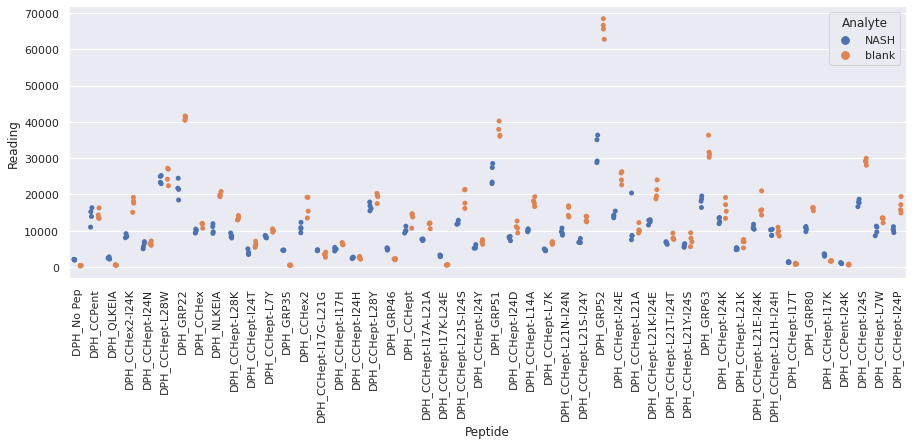

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR3_repeat_6.xlsx
Drawing scatter plot of data spread for NASH_twentyR3_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

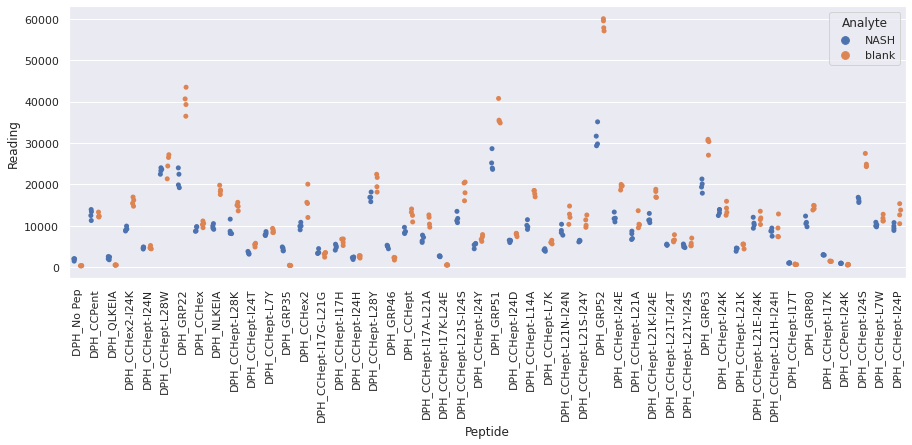

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR4_repeat_6.xlsx
Drawing scatter plot of data spread for NASH_twentyR4_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

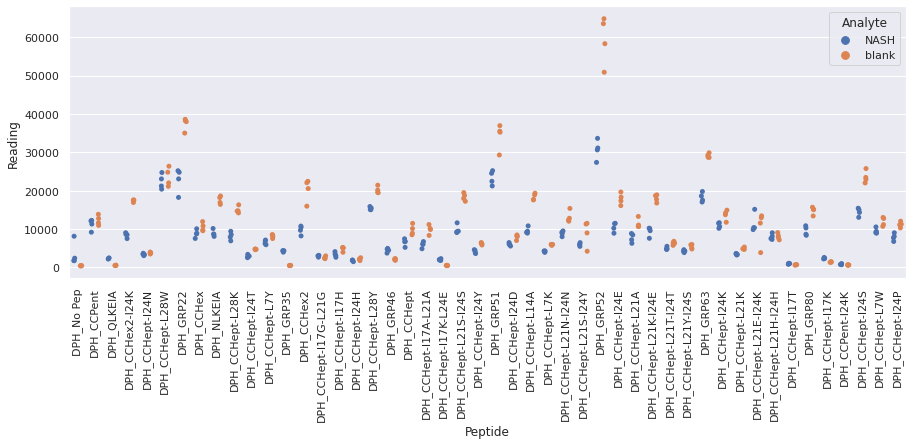

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR1_repeat_6.xlsx
Drawing scatter plot of data spread for Normal_sixR1_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

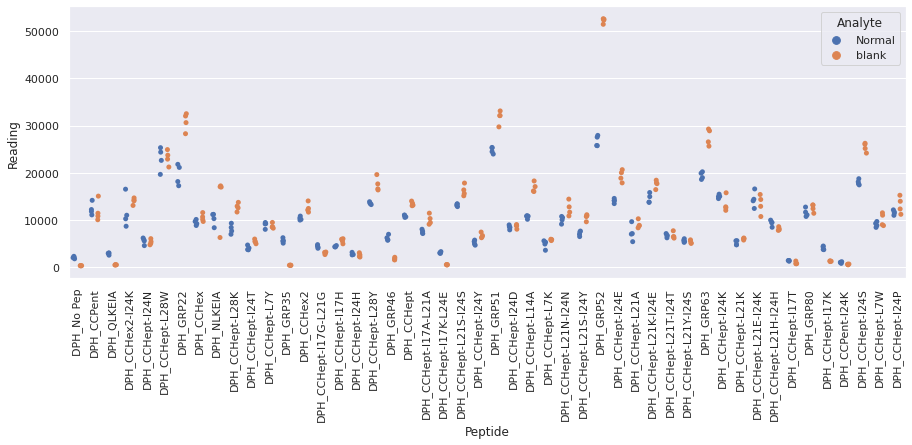

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR2_repeat_6.xlsx
Drawing scatter plot of data spread for Normal_sixR2_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

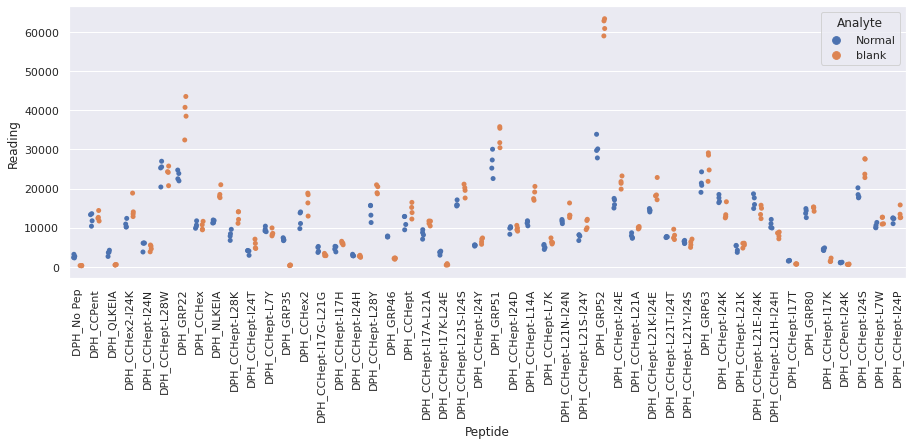

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR3_repeat_6.xlsx
Drawing scatter plot of data spread for Normal_sixR3_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

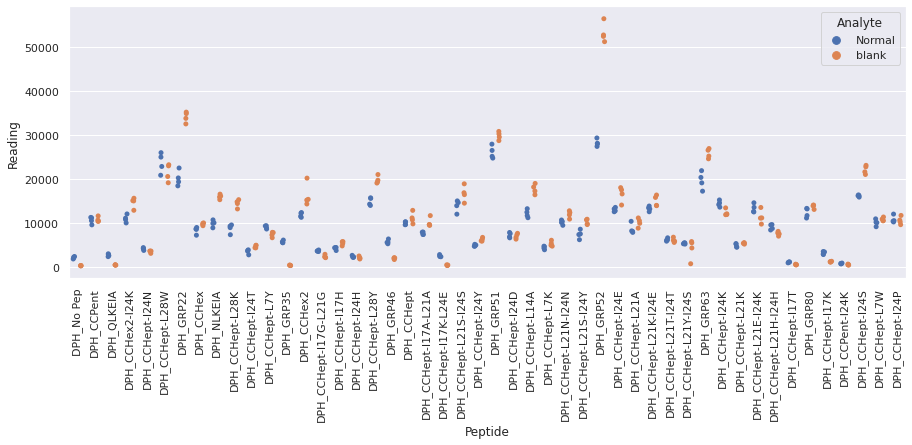

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR4_repeat_6.xlsx
Drawing scatter plot of data spread for Normal_sixR4_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

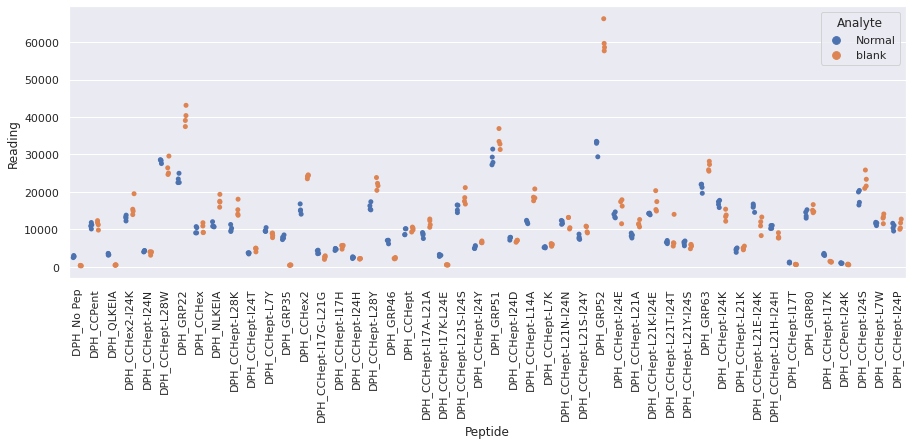

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR1_repeat_7.xlsx
Drawing scatter plot of data spread for NASH_twentyoneR1_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

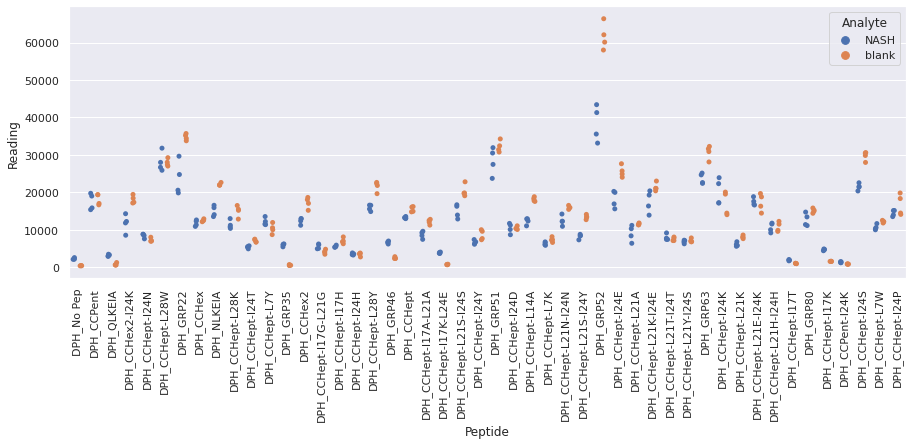

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR2_repeat_7.xlsx
Drawing scatter plot of data spread for NASH_twentyoneR2_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

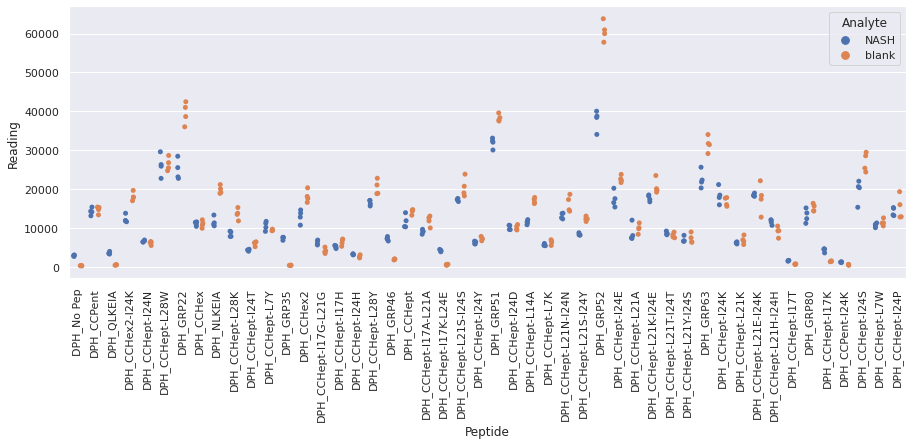

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR3_repeat_7.xlsx
Drawing scatter plot of data spread for NASH_twentyoneR3_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

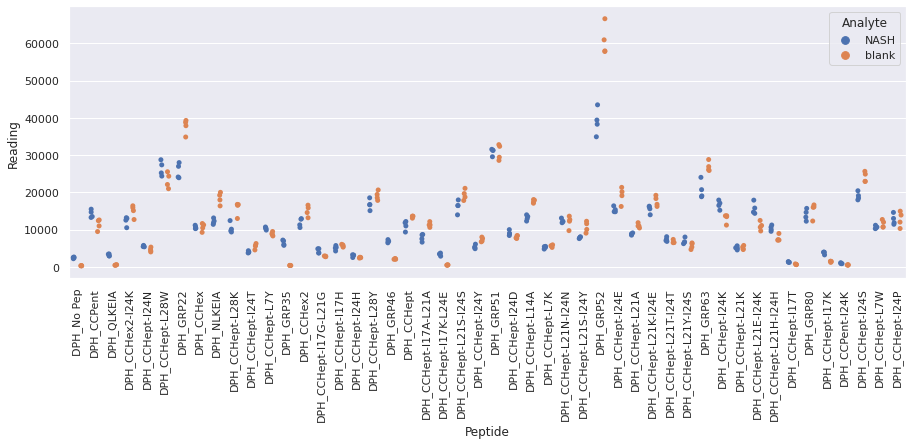

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR4_repeat_7.xlsx
Drawing scatter plot of data spread for NASH_twentyoneR4_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

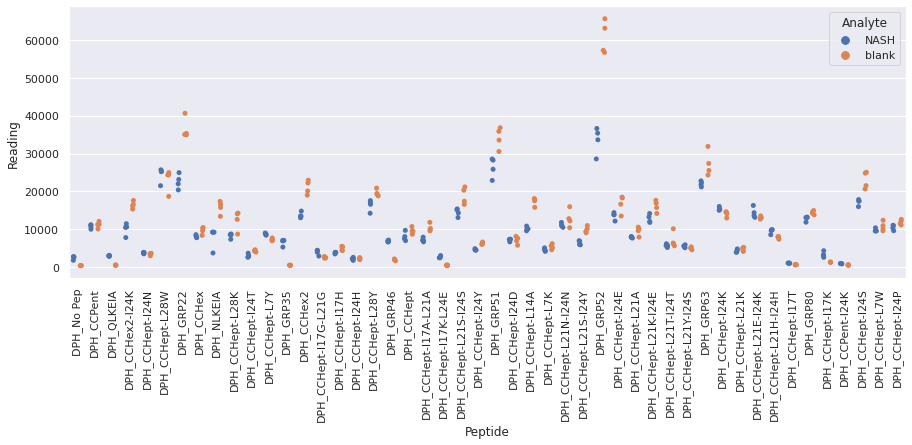

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR1_repeat_7.xlsx
Drawing scatter plot of data spread for Normal_sevenR1_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

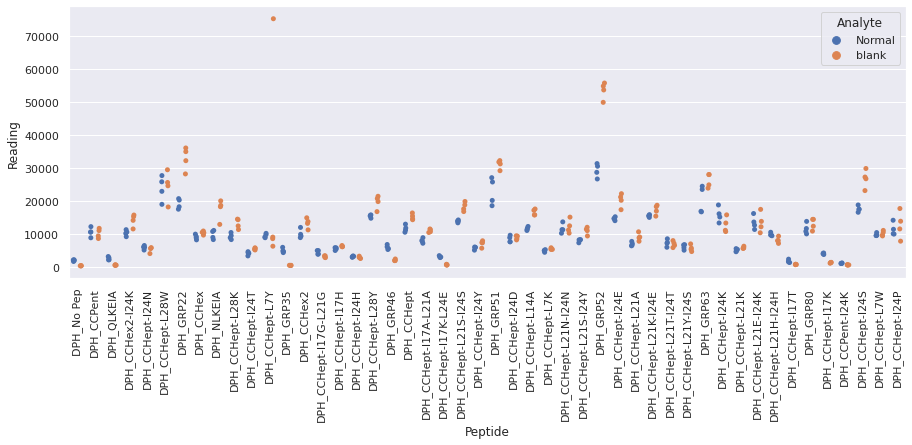

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR2_repeat_7.xlsx
Drawing scatter plot of data spread for Normal_sevenR2_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

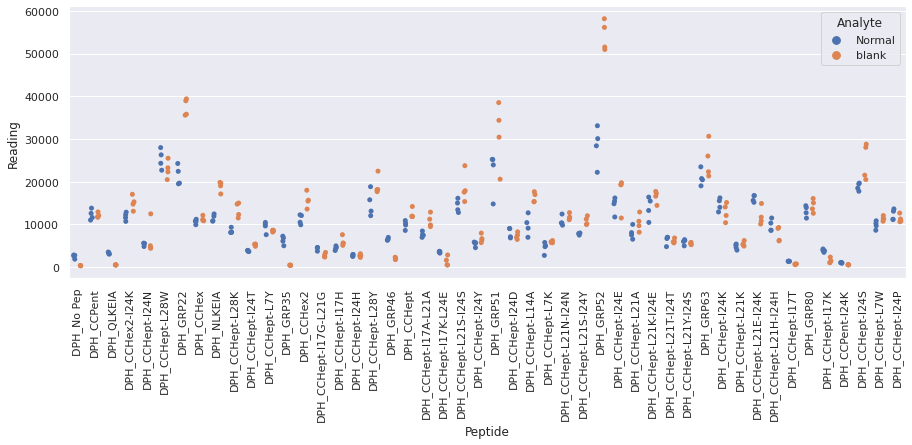

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR3_repeat_7.xlsx
Drawing scatter plot of data spread for Normal_sevenR3_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

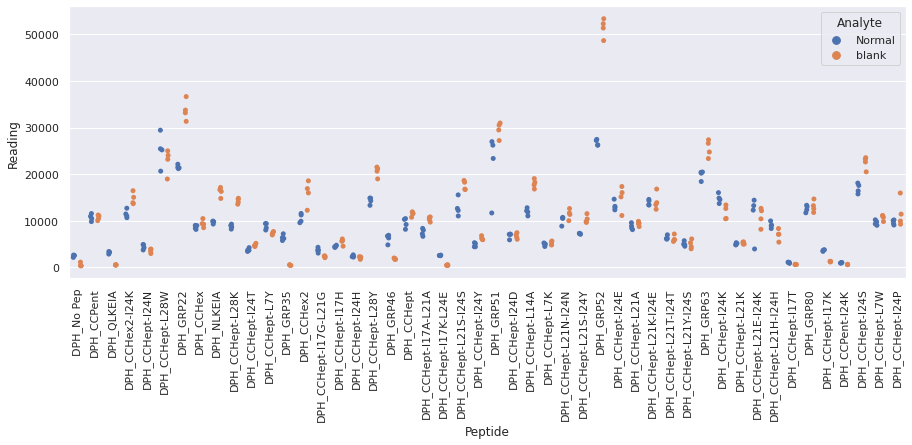

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR4_repeat_7.xlsx
Drawing scatter plot of data spread for Normal_sevenR4_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

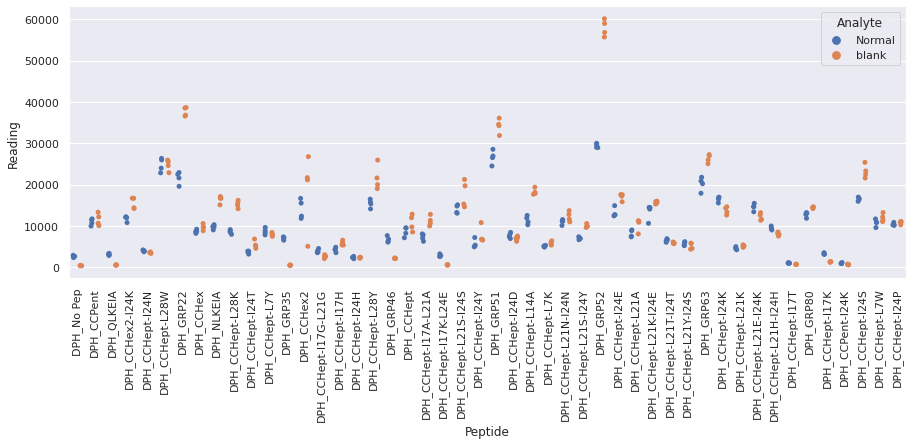

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR1_repeat_8.xlsx
Drawing scatter plot of data spread for NASH_twentytwoR1_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

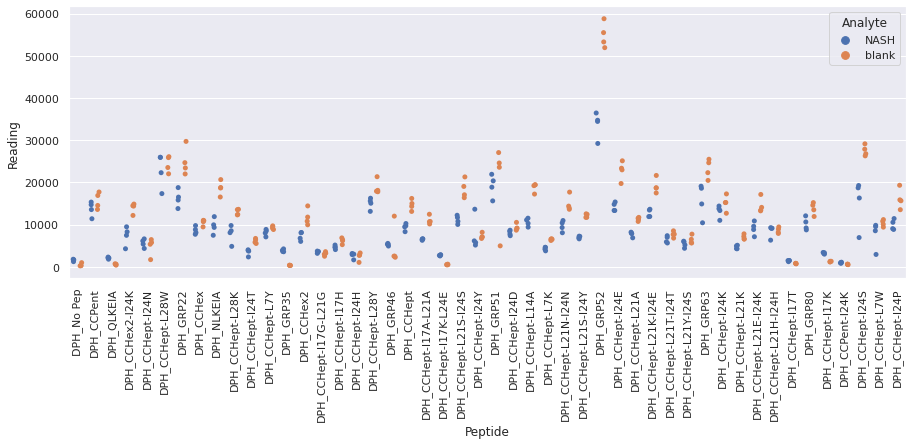

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR2_repeat_8.xlsx
Drawing scatter plot of data spread for NASH_twentytwoR2_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

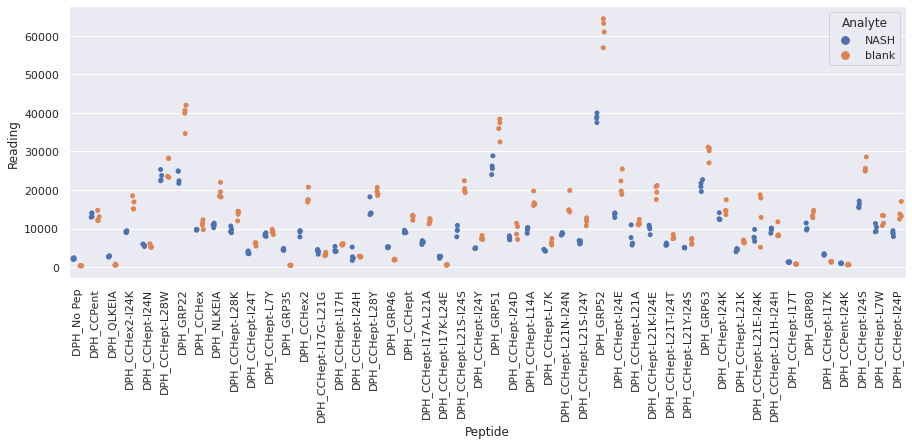

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR3_repeat_8.xlsx
Drawing scatter plot of data spread for NASH_twentytwoR3_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

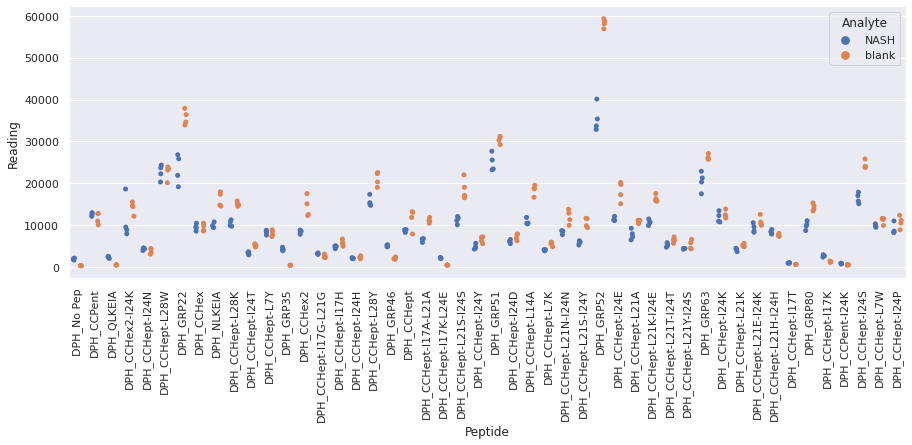

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR4_repeat_8.xlsx
Drawing scatter plot of data spread for NASH_twentytwoR4_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

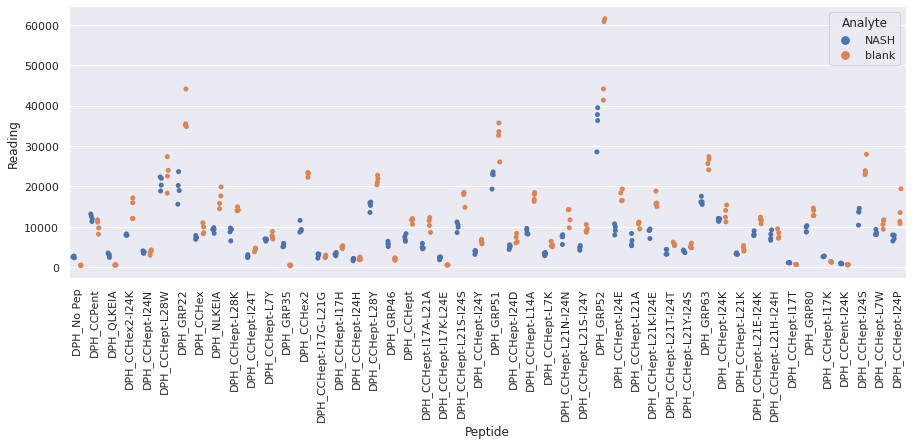

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR1_repeat_8.xlsx
Drawing scatter plot of data spread for Normal_eightR1_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

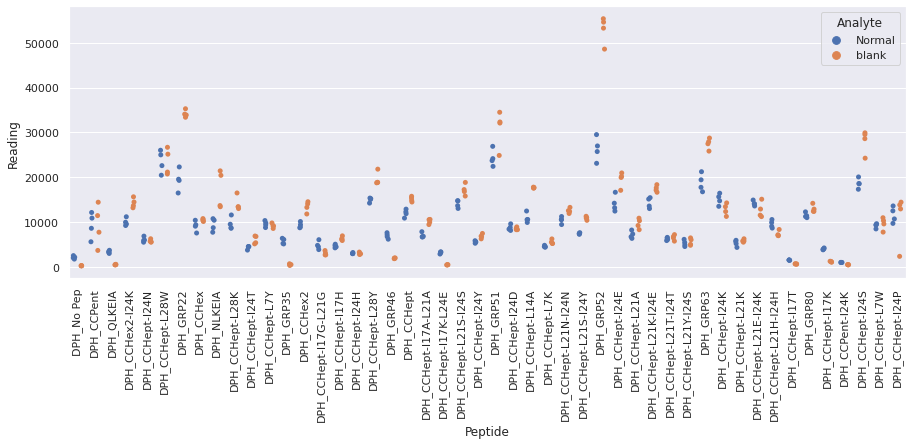

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR2_repeat_8.xlsx
Drawing scatter plot of data spread for Normal_eightR2_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

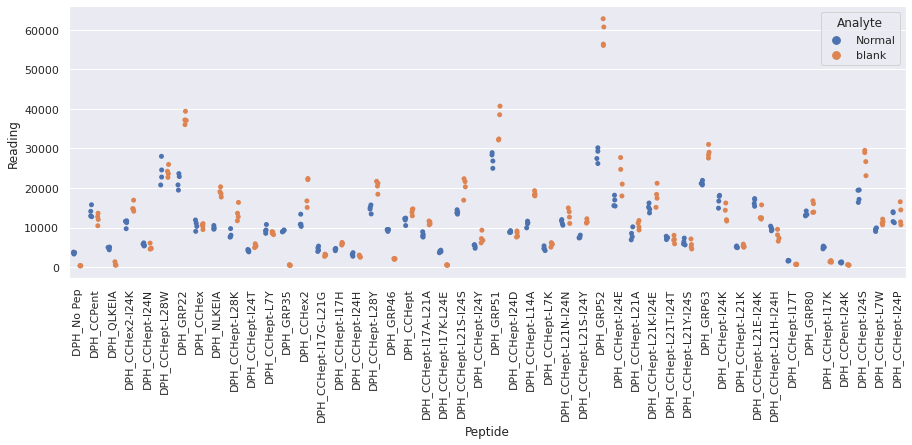

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR3_repeat_8.xlsx
Drawing scatter plot of data spread for Normal_eightR3_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

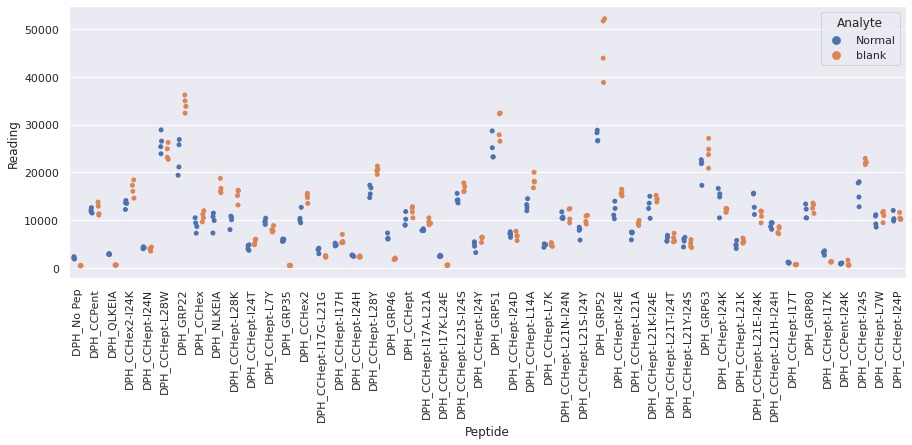

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR4_repeat_8.xlsx
Drawing scatter plot of data spread for Normal_eightR4_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

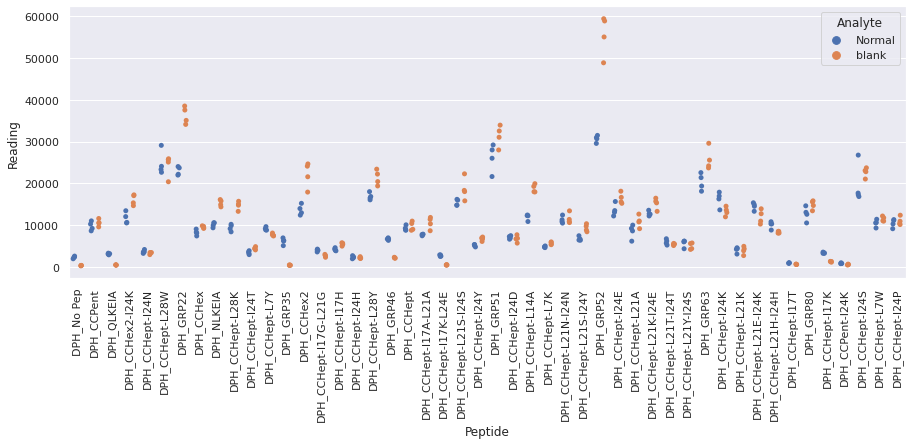

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR1_repeat_9.xlsx
Drawing scatter plot of data spread for NASH_twentythreeR1_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

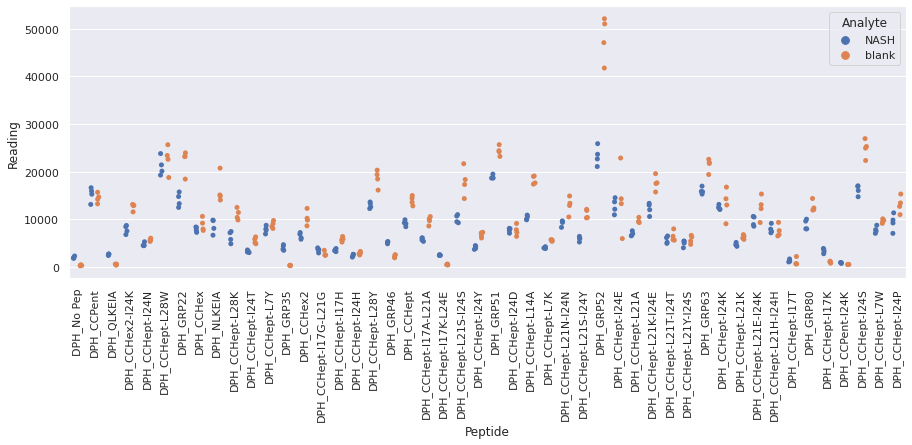

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR2_repeat_9.xlsx
Drawing scatter plot of data spread for NASH_twentythreeR2_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

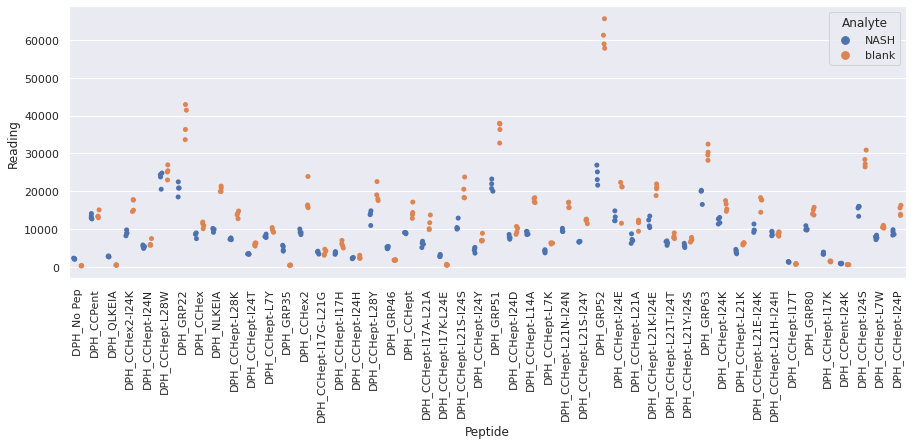

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR3_repeat_9.xlsx
Drawing scatter plot of data spread for NASH_twentythreeR3_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

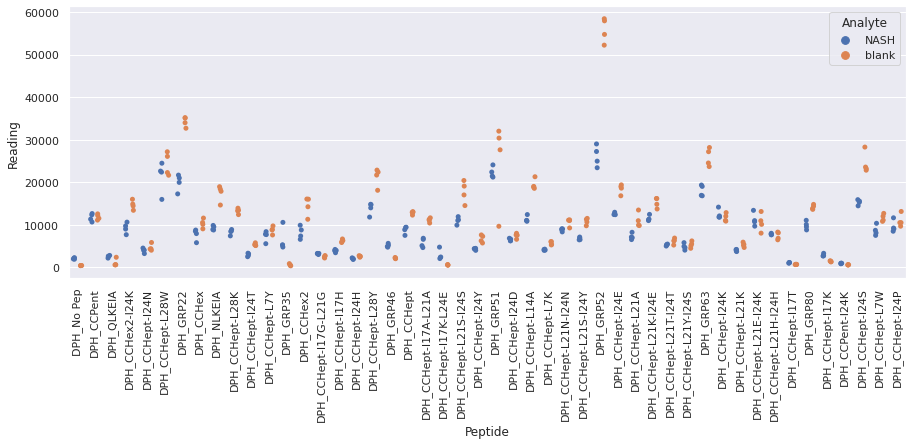

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR4_repeat_9.xlsx
Drawing scatter plot of data spread for NASH_twentythreeR4_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

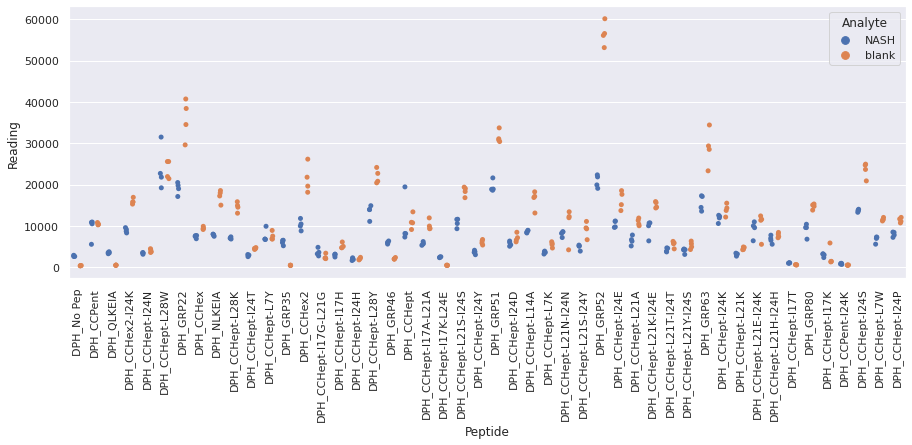

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR1_repeat_9.xlsx
Drawing scatter plot of data spread for Normal_nineR1_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

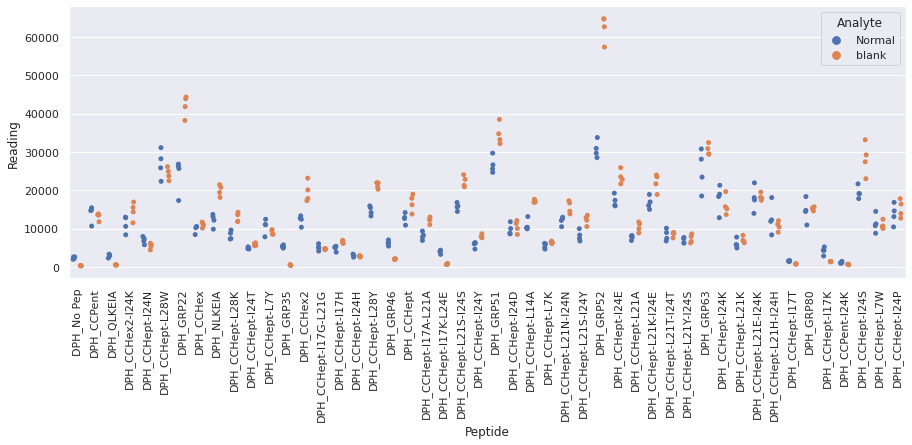

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR2_repeat_9.xlsx
Drawing scatter plot of data spread for Normal_nineR2_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

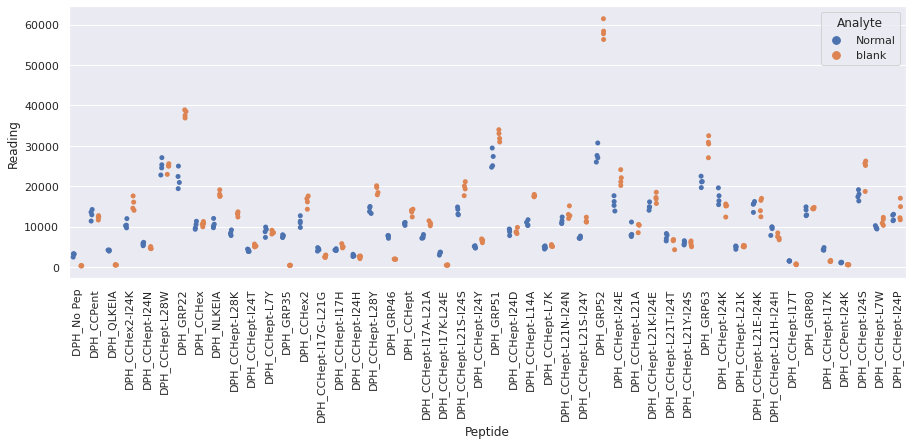

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR3_repeat_9.xlsx
Drawing scatter plot of data spread for Normal_nineR3_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

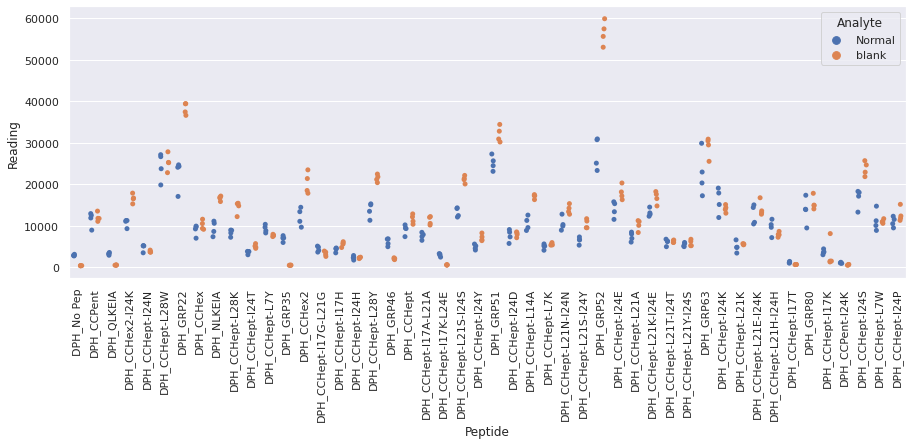

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR4_repeat_9.xlsx
Drawing scatter plot of data spread for Normal_nineR4_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

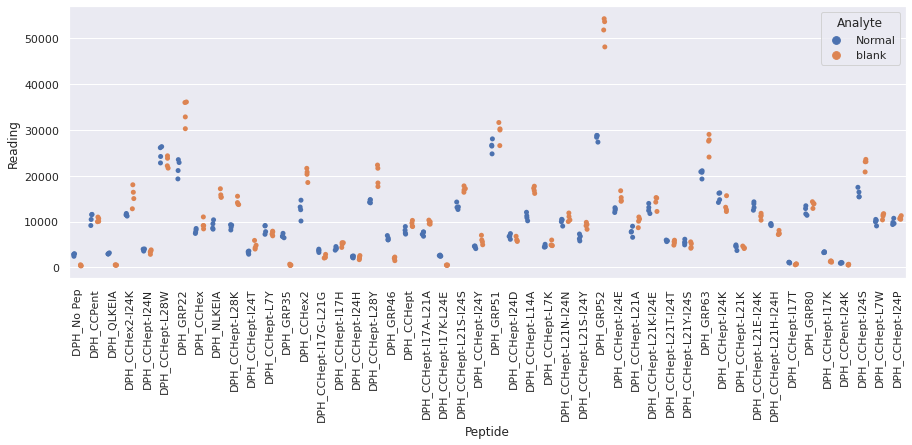

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR1_repeat_10.xlsx
Drawing scatter plot of data spread for NASH_twentyfourR1_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

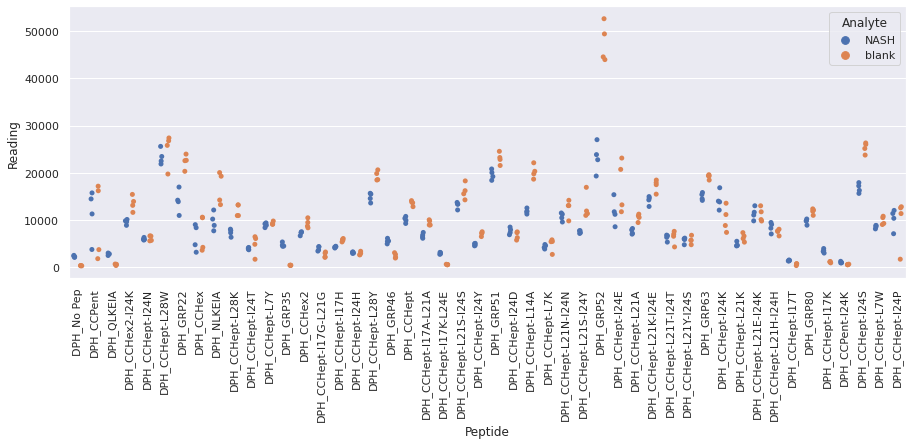

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR2_repeat_10.xlsx
Drawing scatter plot of data spread for NASH_twentyfourR2_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

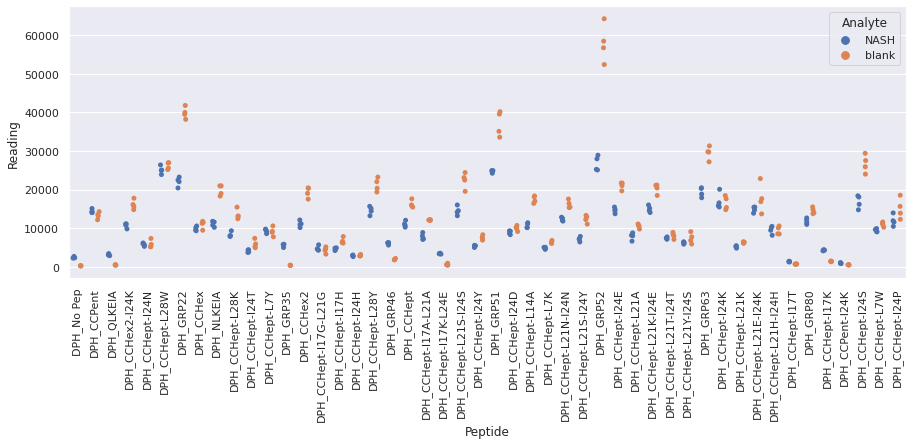

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR3_repeat_10.xlsx
Drawing scatter plot of data spread for NASH_twentyfourR3_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

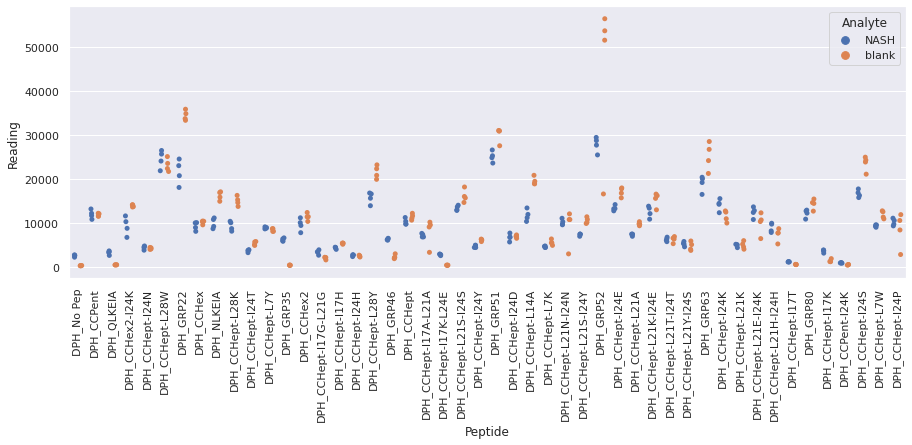

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR4_repeat_10.xlsx
Drawing scatter plot of data spread for NASH_twentyfourR4_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

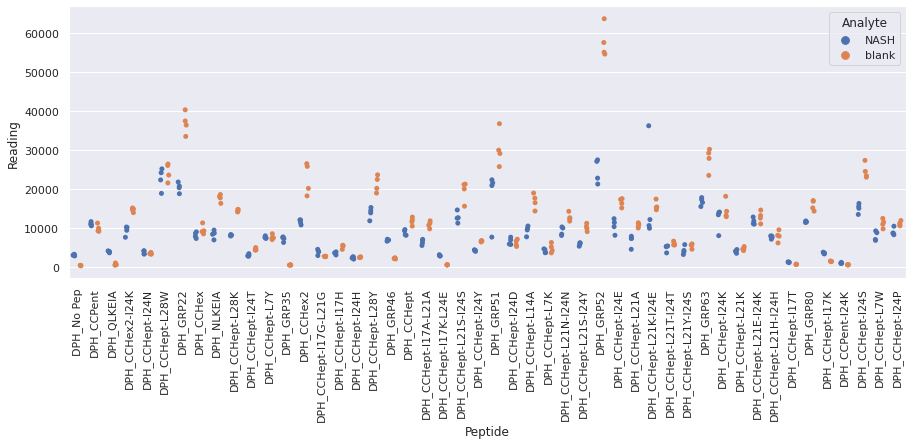

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR1_repeat_10.xlsx
Drawing scatter plot of data spread for Normal_tenR1_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

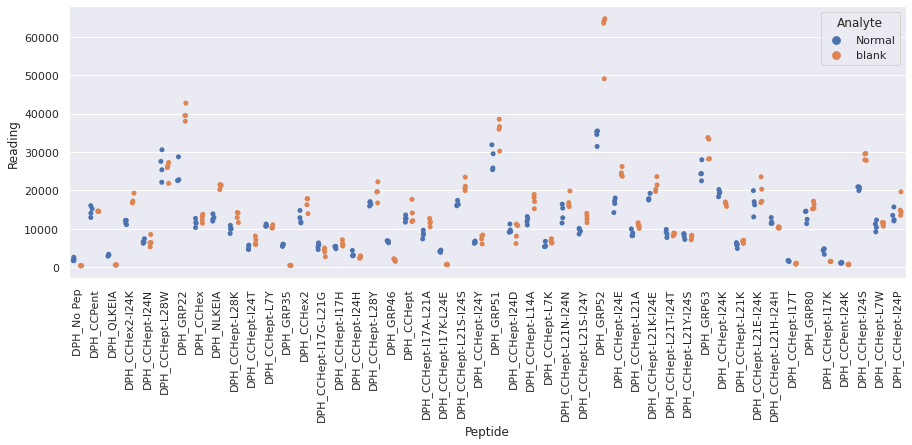

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR2_repeat_10.xlsx
Drawing scatter plot of data spread for Normal_tenR2_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

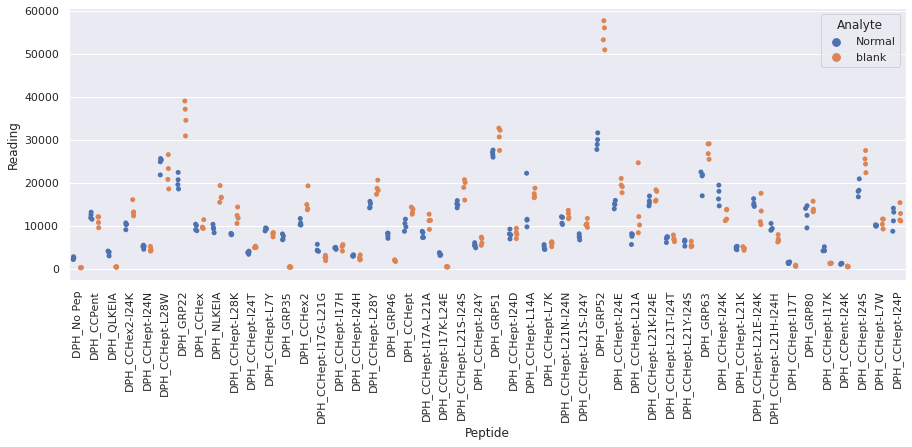

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR3_repeat_10.xlsx
Drawing scatter plot of data spread for Normal_tenR3_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

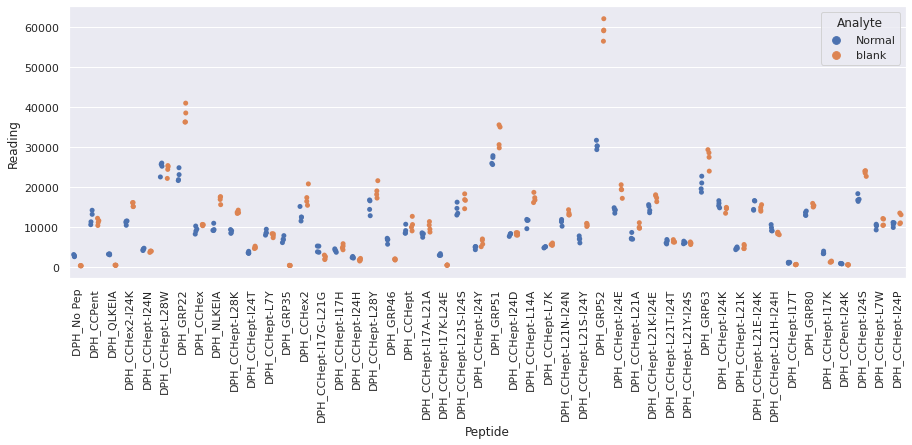

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR4_repeat_10.xlsx
Drawing scatter plot of data spread for Normal_tenR4_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

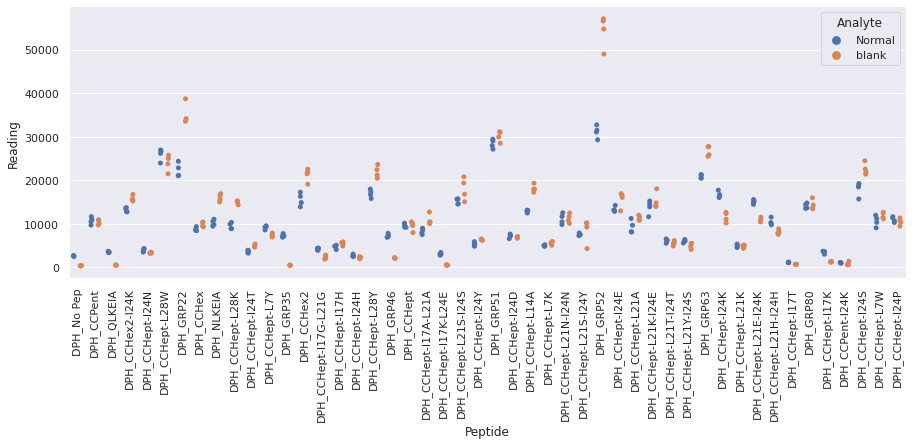

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR1_repeat_11.xlsx
Drawing scatter plot of data spread for NASH_twentyfiveR1_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

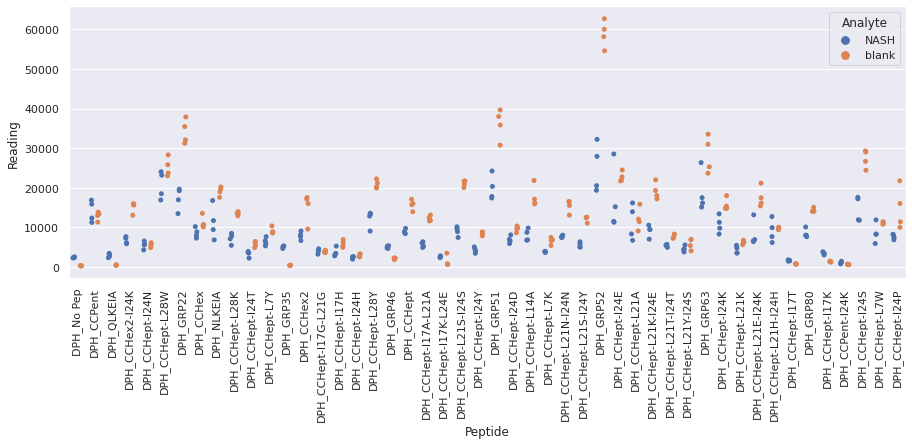

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR2_repeat_11.xlsx
Drawing scatter plot of data spread for NASH_twentyfiveR2_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

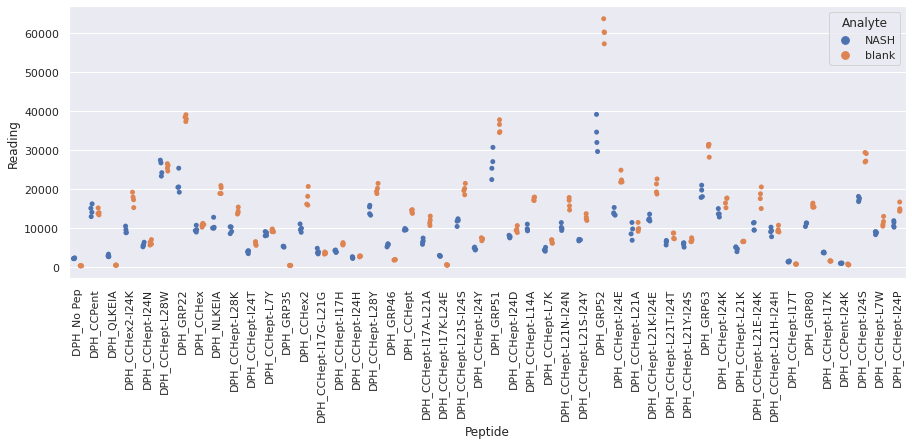

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR3_repeat_11.xlsx
Drawing scatter plot of data spread for NASH_twentyfiveR3_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

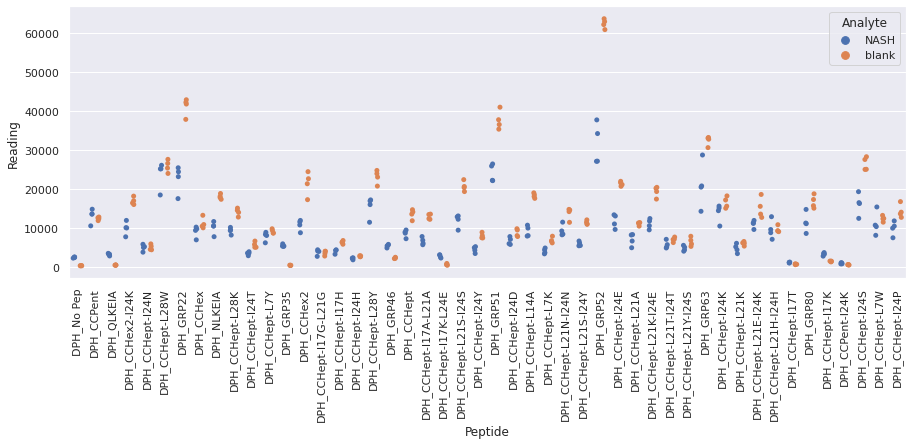

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR4_repeat_11.xlsx
Drawing scatter plot of data spread for NASH_twentyfiveR4_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

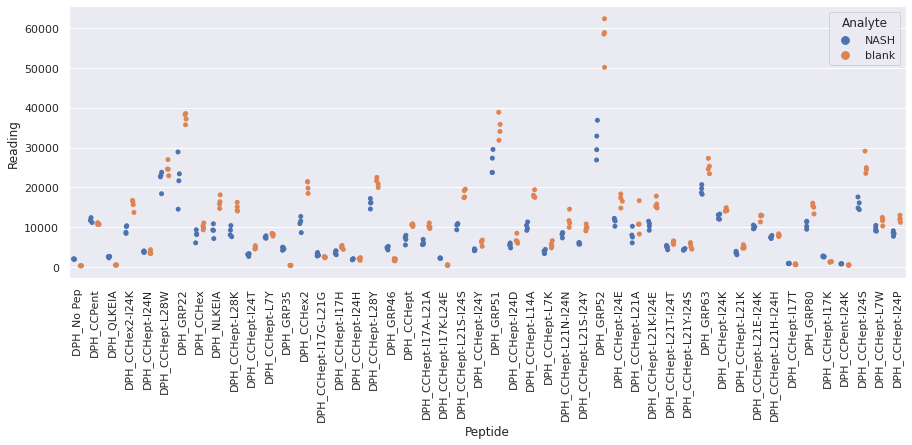

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR1_repeat_11.xlsx
Drawing scatter plot of data spread for Normal_elevenR1_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

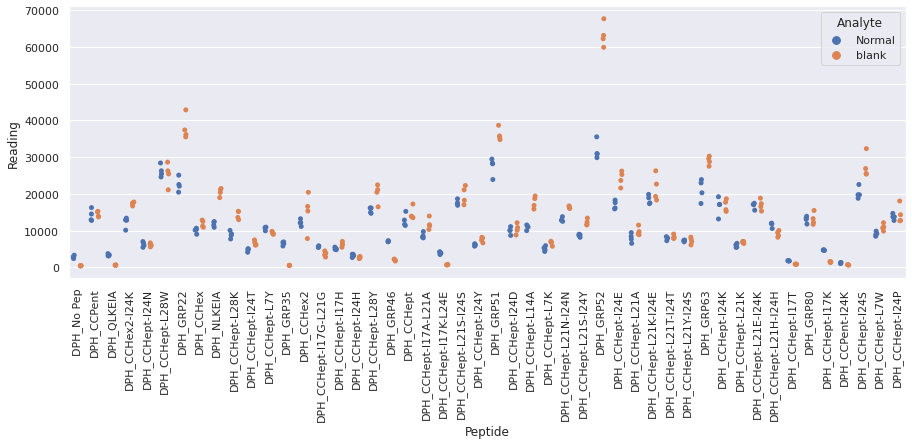

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR2_repeat_11.xlsx
Drawing scatter plot of data spread for Normal_elevenR2_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

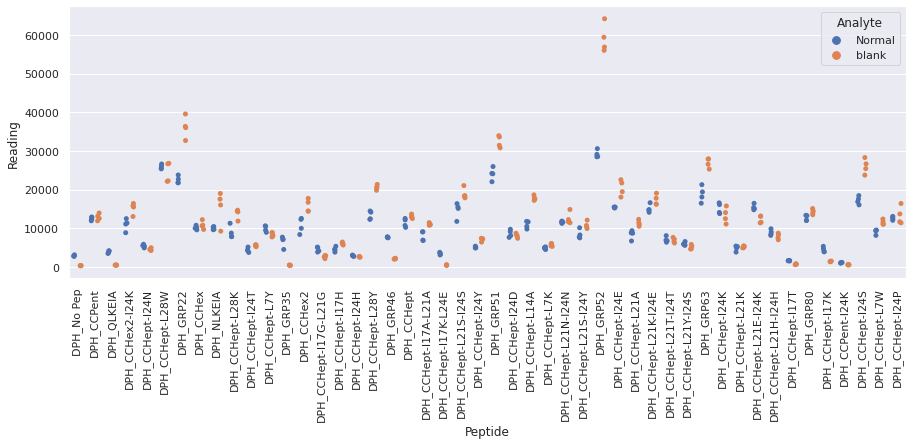

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR3_repeat_11.xlsx
Drawing scatter plot of data spread for Normal_elevenR3_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

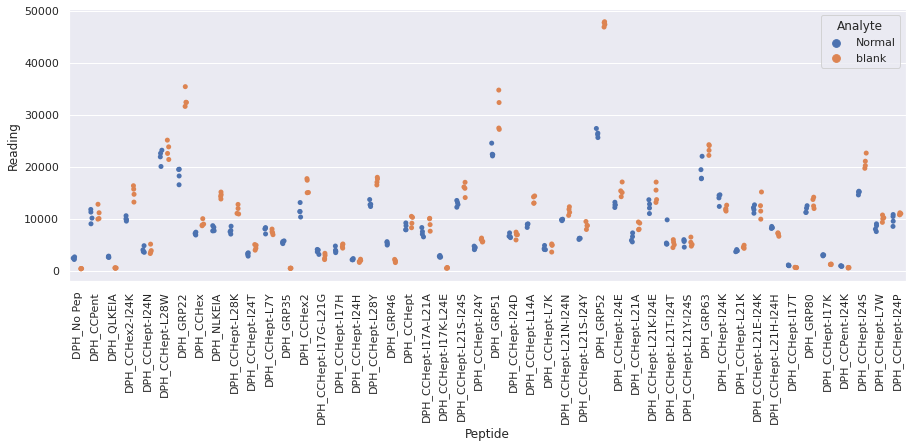

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR4_repeat_11.xlsx
Drawing scatter plot of data spread for Normal_elevenR4_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

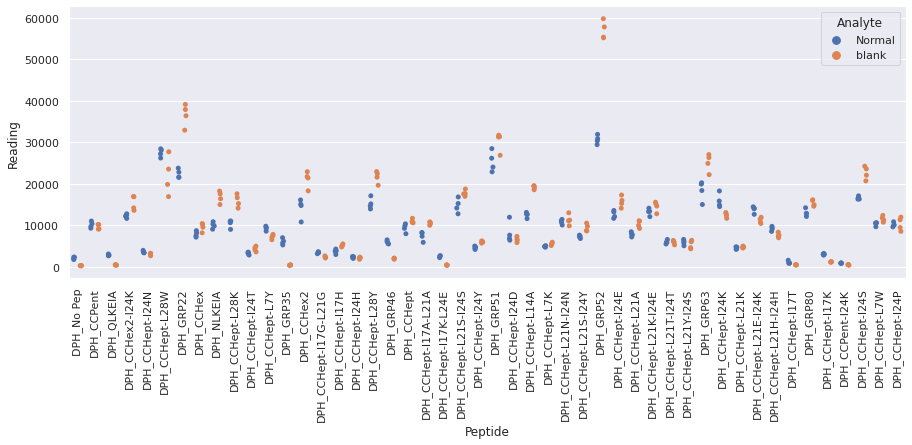

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR1_repeat_12.xlsx
Drawing scatter plot of data spread for NASH_twentysixR1_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

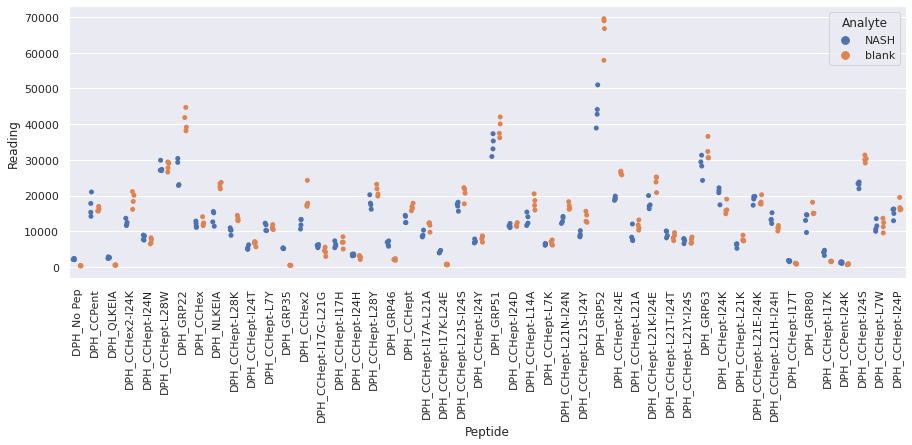

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR2_repeat_12.xlsx
Drawing scatter plot of data spread for NASH_twentysixR2_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

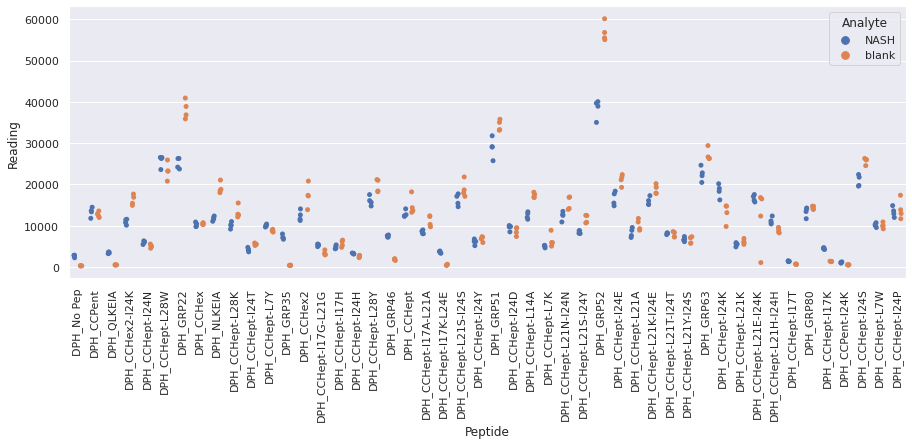

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR3_repeat_12.xlsx
Drawing scatter plot of data spread for NASH_twentysixR3_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

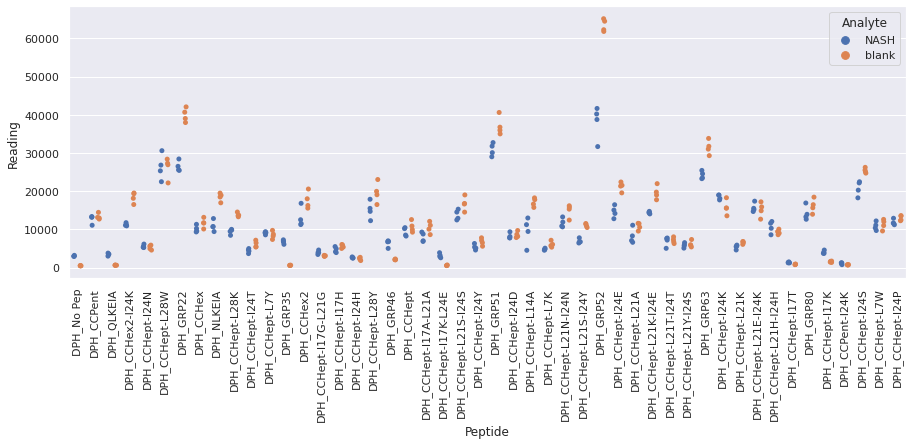

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR4_repeat_12.xlsx
Drawing scatter plot of data spread for NASH_twentysixR4_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

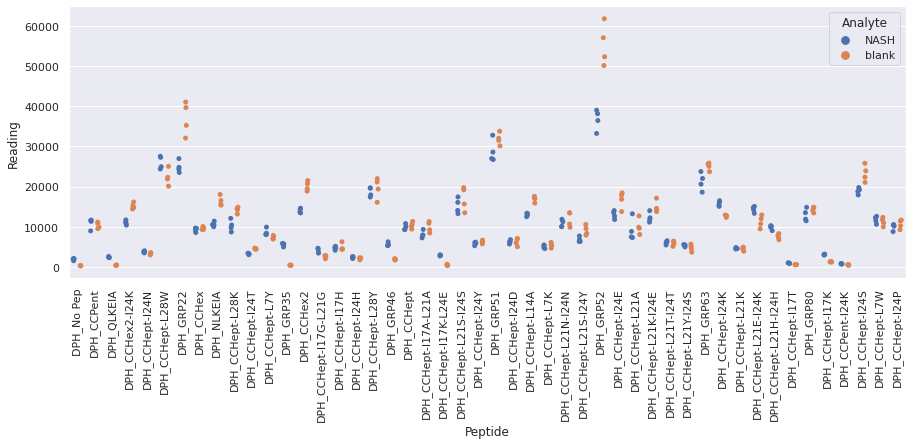

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR1_repeat_12.xlsx
Drawing scatter plot of data spread for Normal_twelveR1_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

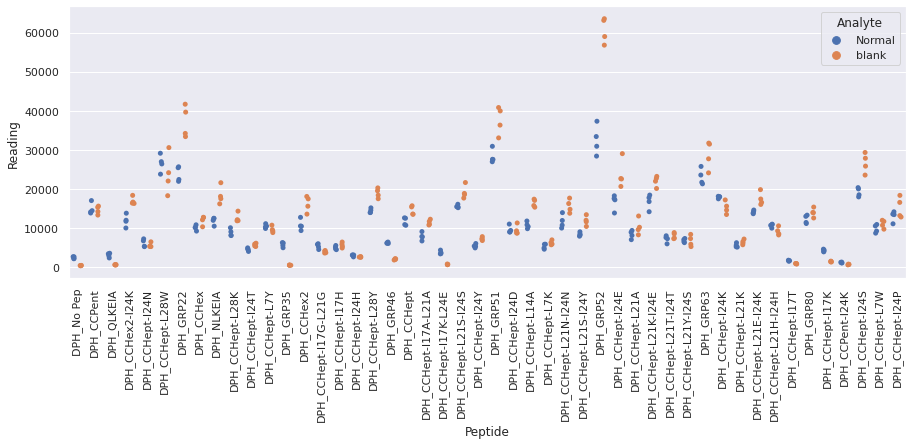

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR2_repeat_12.xlsx
Drawing scatter plot of data spread for Normal_twelveR2_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

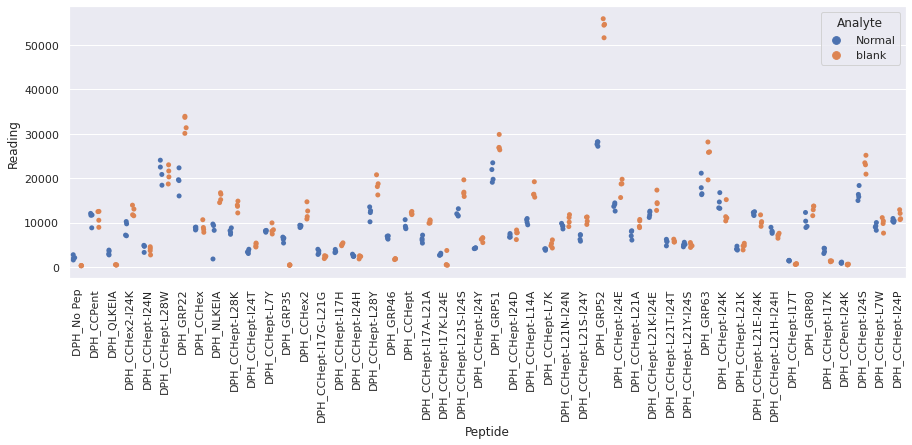

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR3_repeat_12.xlsx
Drawing scatter plot of data spread for Normal_twelveR3_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

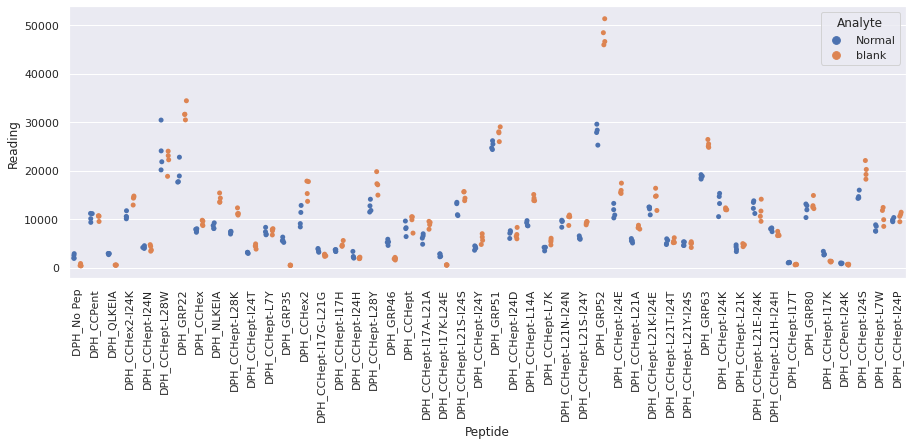

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR4_repeat_12.xlsx
Drawing scatter plot of data spread for Normal_twelveR4_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

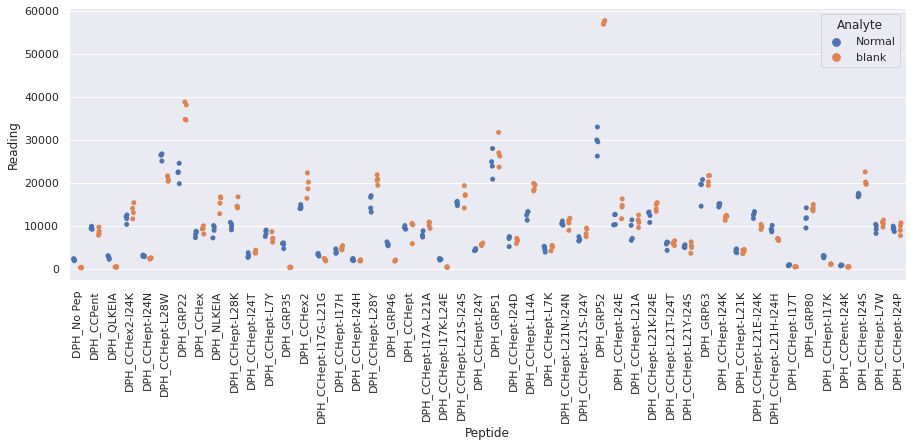

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR1_repeat_13.xlsx
Drawing scatter plot of data spread for NASH_twentysevenR1_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

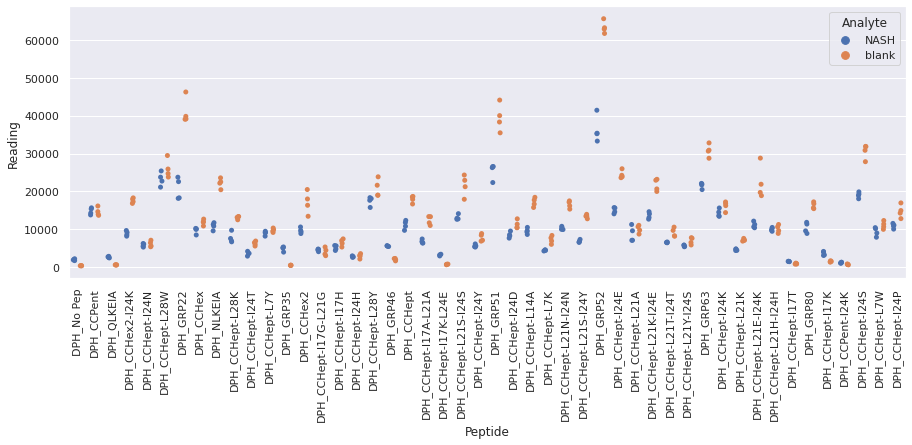

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR2_repeat_13.xlsx
Drawing scatter plot of data spread for NASH_twentysevenR2_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

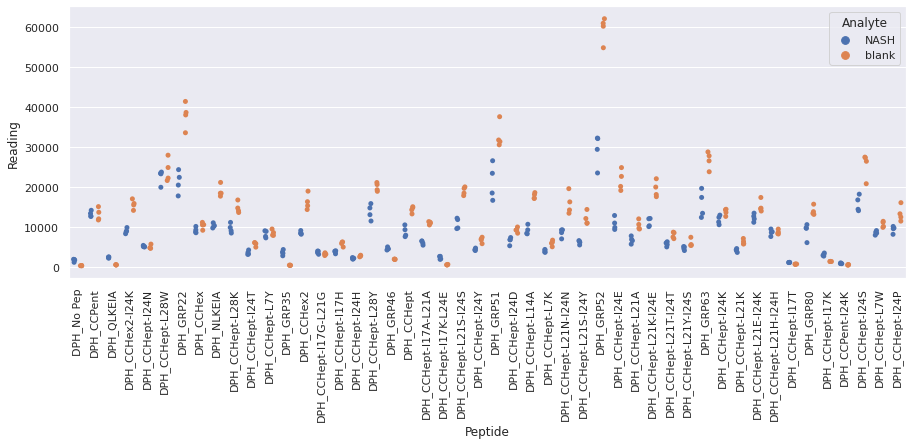

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR3_repeat_13.xlsx
Drawing scatter plot of data spread for NASH_twentysevenR3_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

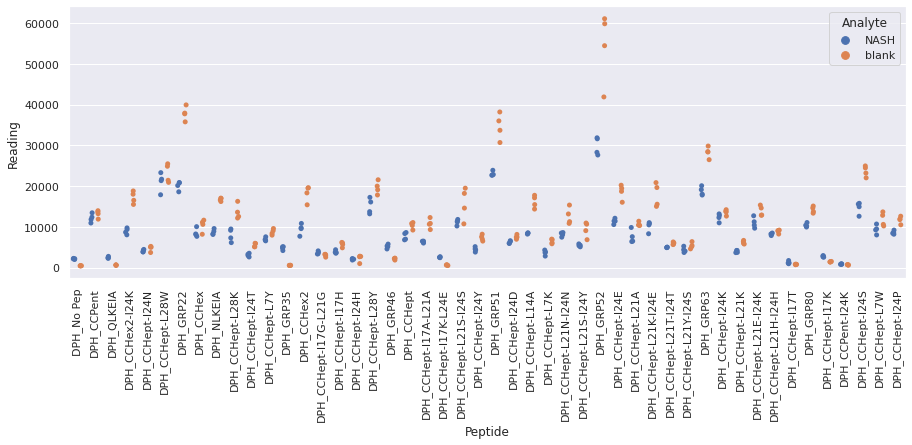

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR4_repeat_13.xlsx
Drawing scatter plot of data spread for NASH_twentysevenR4_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

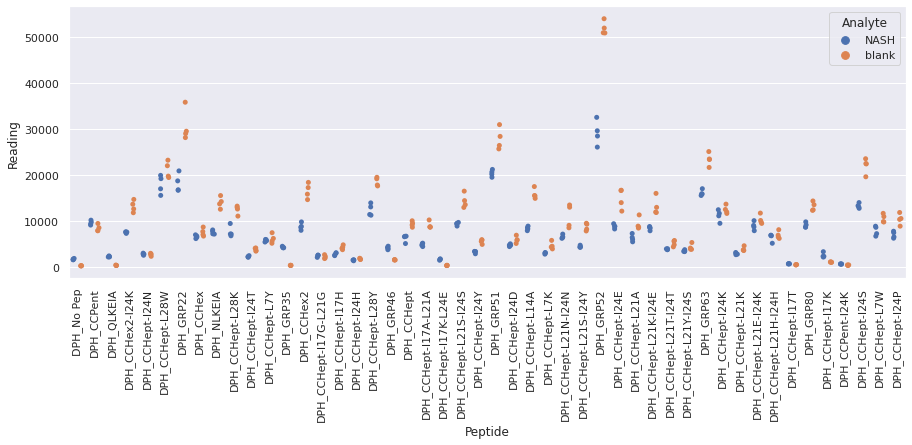

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR1_repeat_13.xlsx
Drawing scatter plot of data spread for Normal_thirteenR1_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

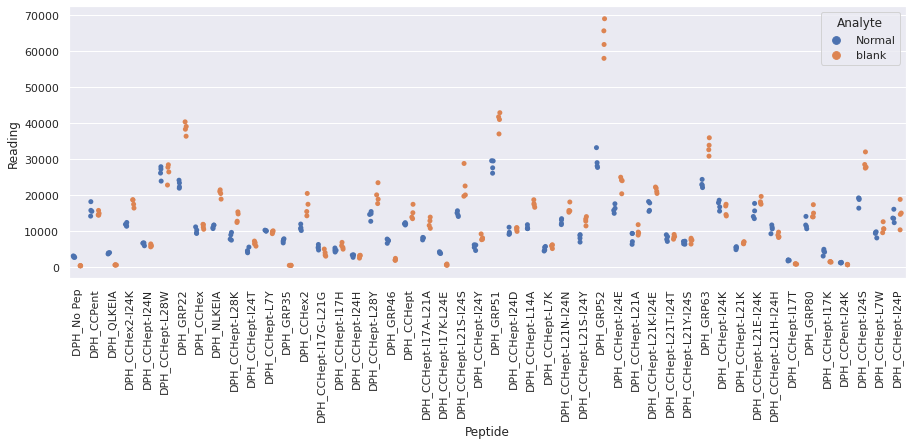

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR2_repeat_13.xlsx
Drawing scatter plot of data spread for Normal_thirteenR2_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

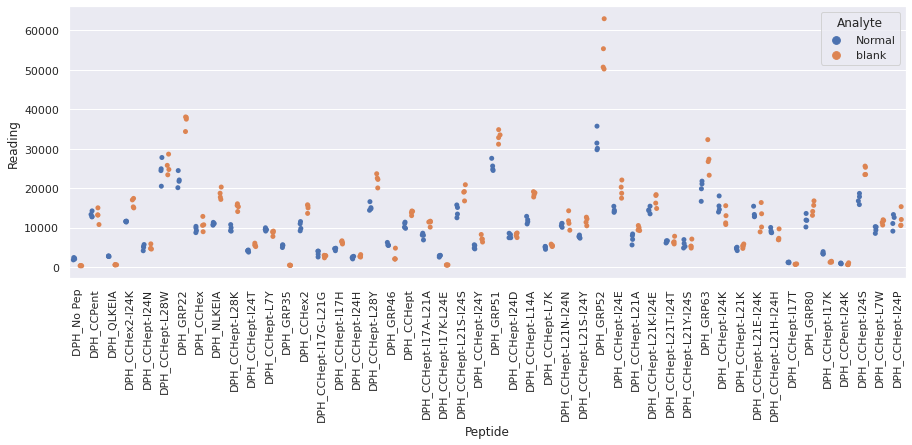

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR3_repeat_13.xlsx
Drawing scatter plot of data spread for Normal_thirteenR3_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

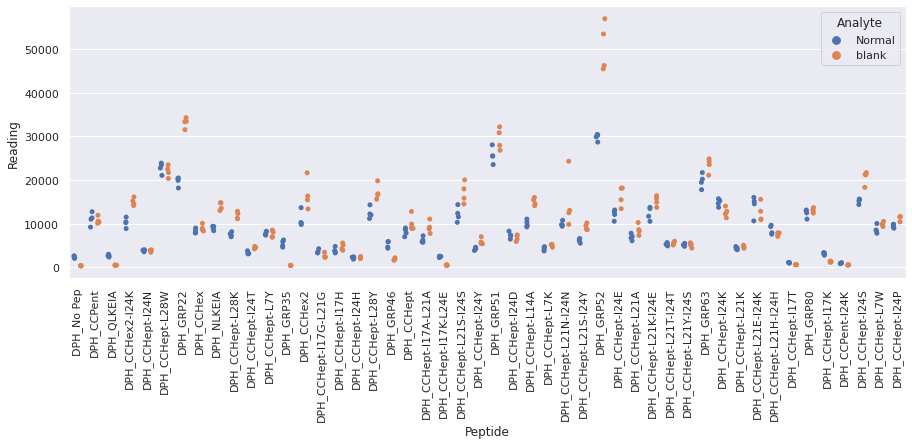

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR4_repeat_13.xlsx
Drawing scatter plot of data spread for Normal_thirteenR4_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

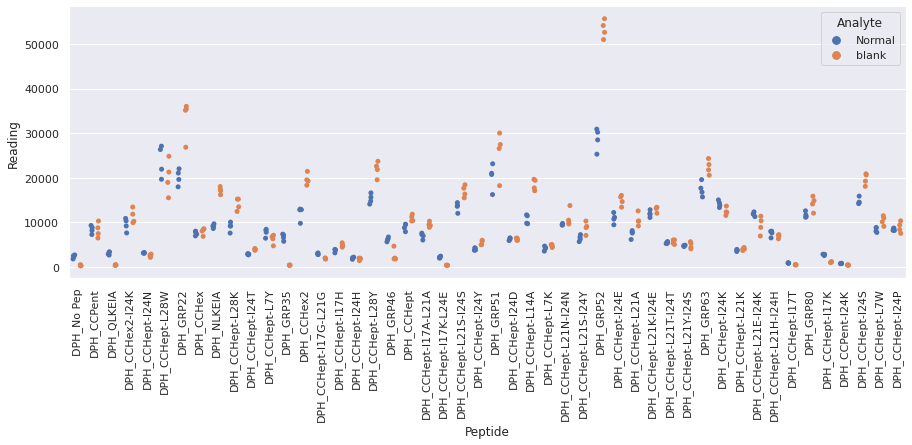

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR1_repeat_14.xlsx
Drawing scatter plot of data spread for NASH_twentyeightR1_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

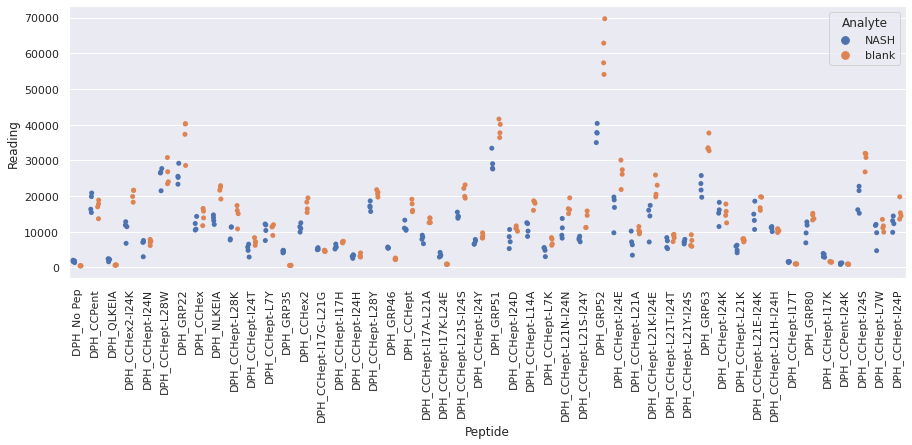

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR2_repeat_14.xlsx
Drawing scatter plot of data spread for NASH_twentyeightR2_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

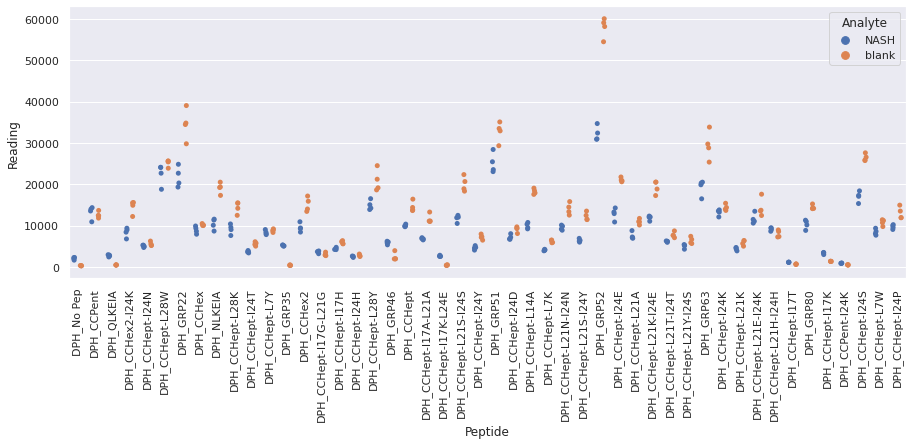

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR3_repeat_14.xlsx
Drawing scatter plot of data spread for NASH_twentyeightR3_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

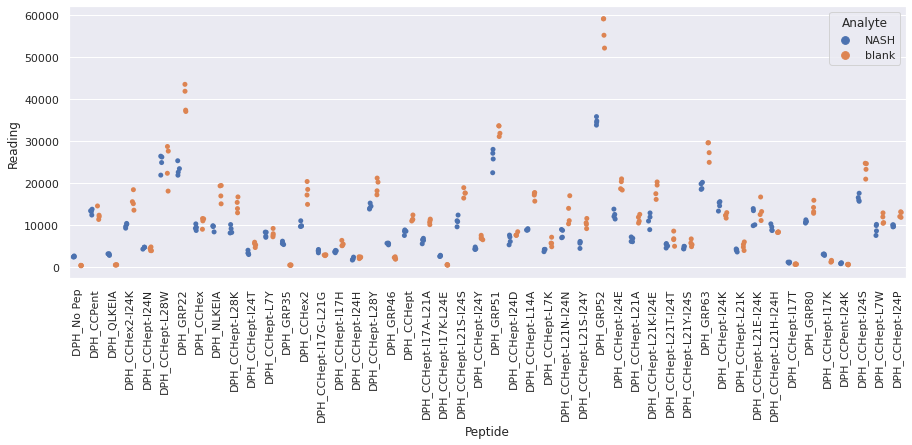

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR4_repeat_14.xlsx
Drawing scatter plot of data spread for NASH_twentyeightR4_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

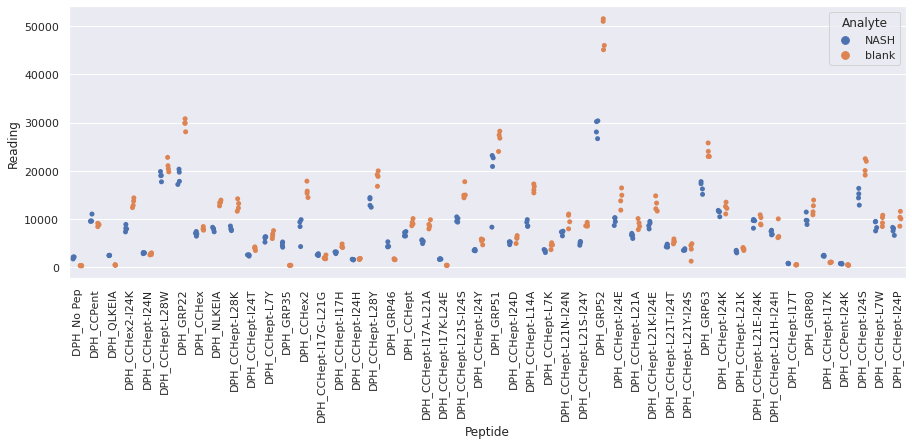

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR1_repeat_14.xlsx
Drawing scatter plot of data spread for Normal_fourteenR1_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

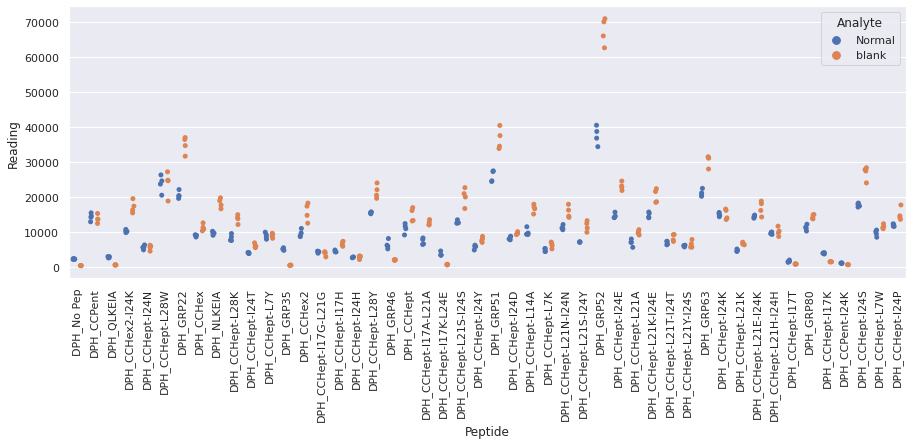

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR2_repeat_14.xlsx
Drawing scatter plot of data spread for Normal_fourteenR2_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

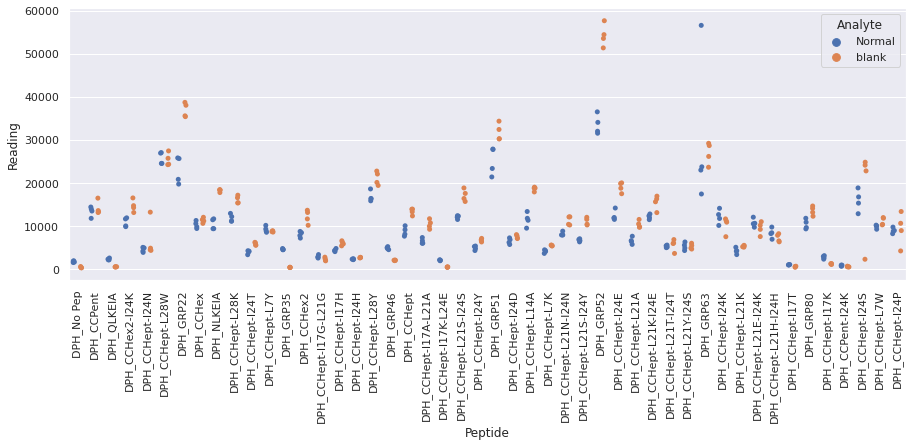

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR3_repeat_14.xlsx
Drawing scatter plot of data spread for Normal_fourteenR3_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

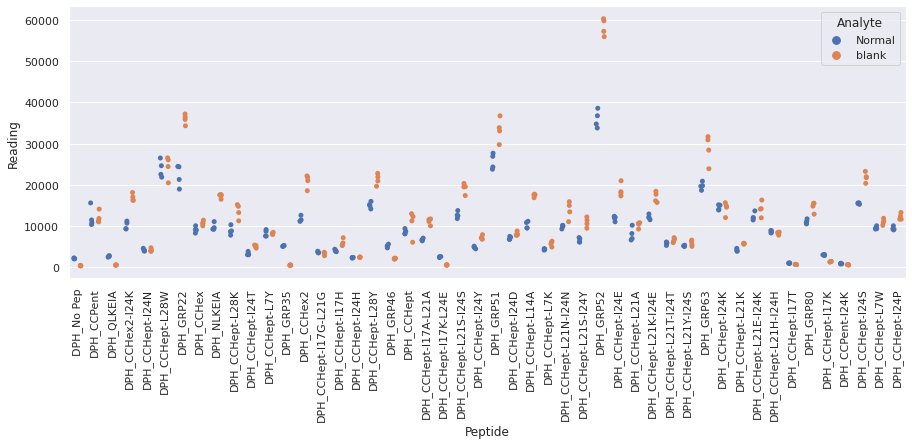

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR4_repeat_14.xlsx
Drawing scatter plot of data spread for Normal_fourteenR4_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

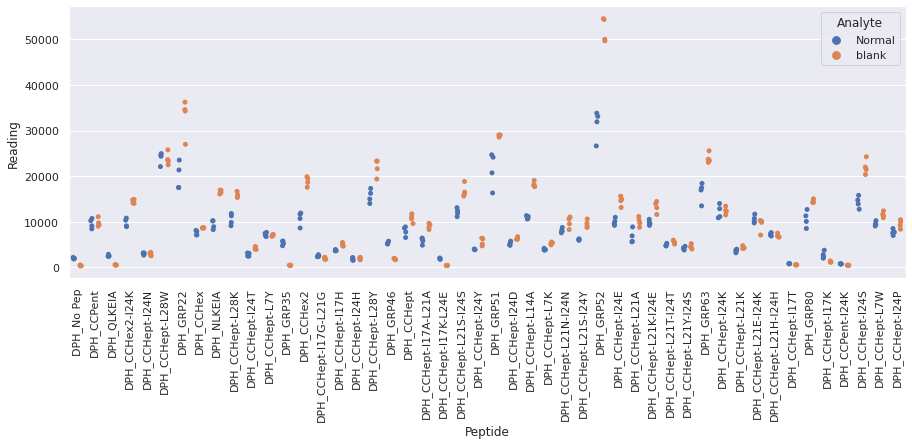

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR1_repeat_15.xlsx
Drawing scatter plot of data spread for Normal_twentynineR1_repeat_15 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

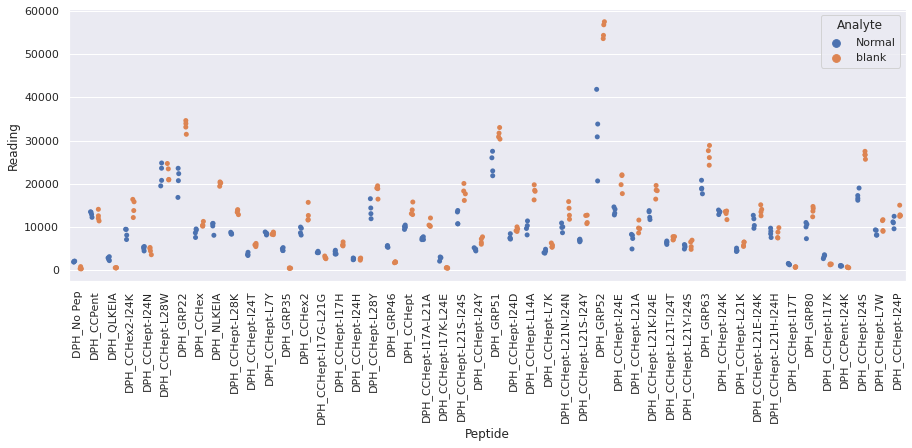

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR2_repeat_15.xlsx
Drawing scatter plot of data spread for Normal_twentynineR2_repeat_15 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

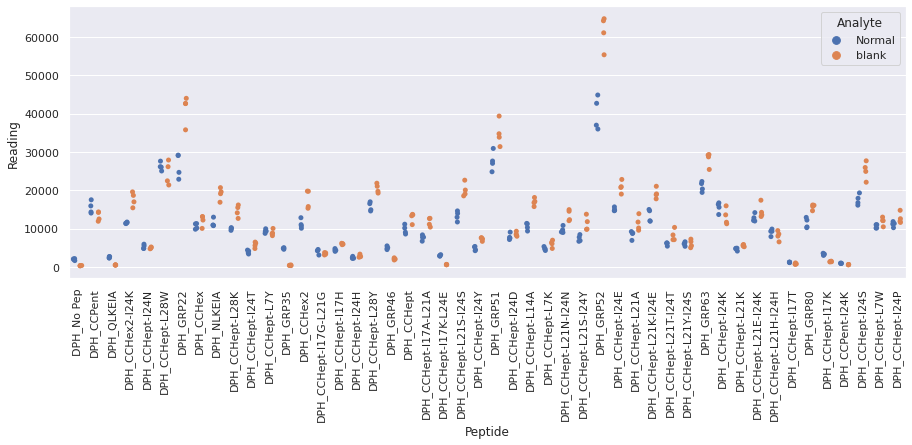

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR3_repeat_15.xlsx
Drawing scatter plot of data spread for Normal_twentynineR3_repeat_15 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

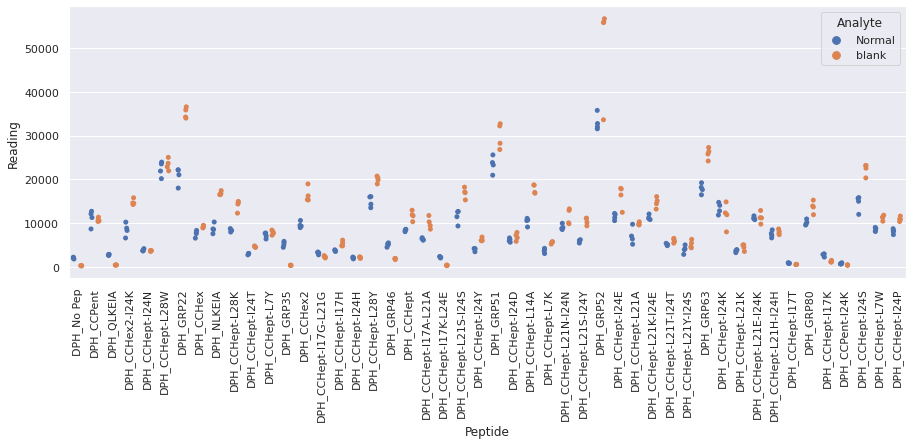

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR4_repeat_15.xlsx
Drawing scatter plot of data spread for Normal_twentynineR4_repeat_15 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

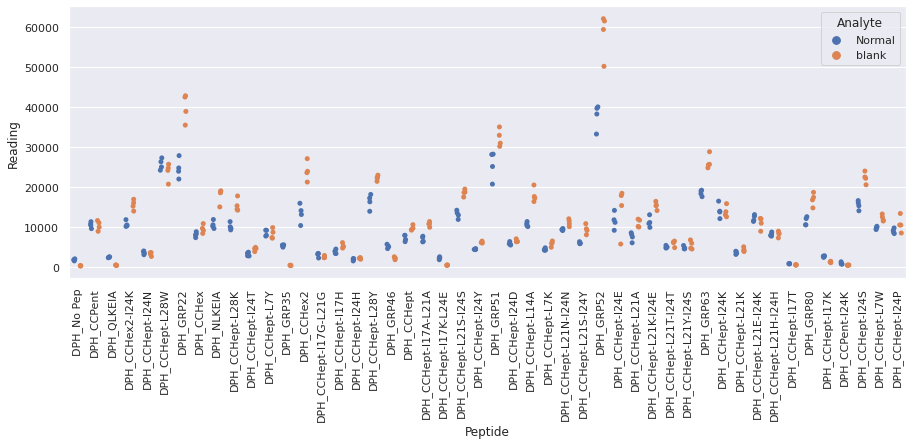

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR1_repeat_16.xlsx
Drawing scatter plot of data spread for Normal_thirtyR1_repeat_16 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

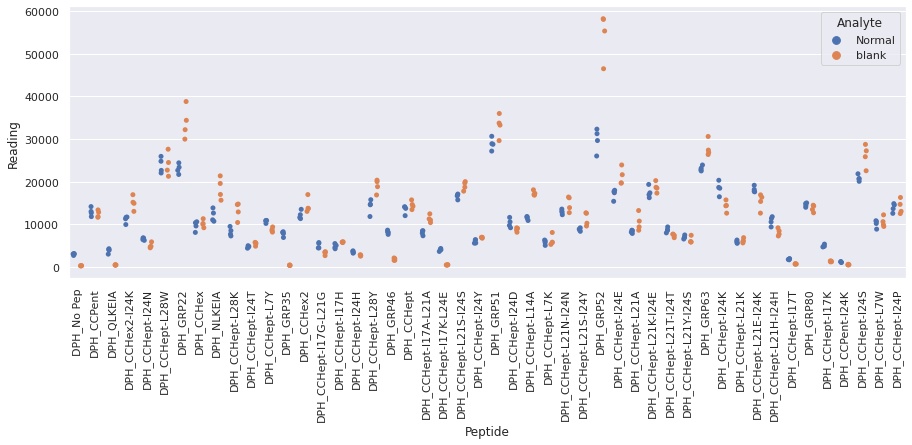

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR2_repeat_16.xlsx
Drawing scatter plot of data spread for Normal_thirtyR2_repeat_16 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

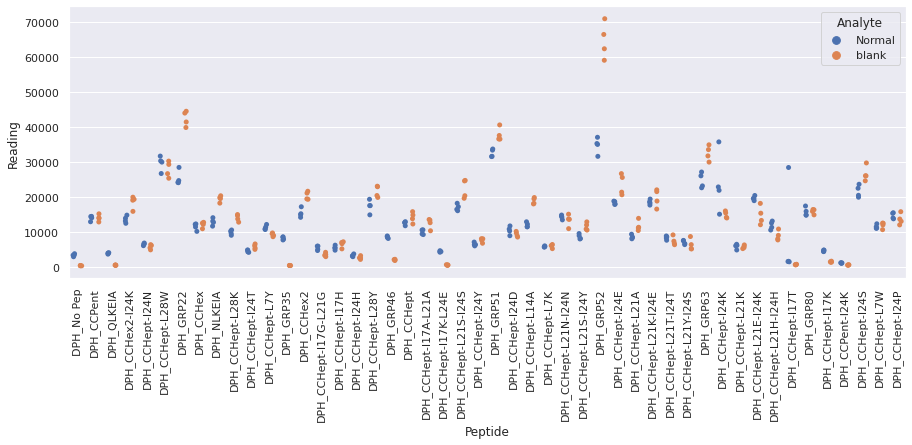

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR3_repeat_16.xlsx
Drawing scatter plot of data spread for Normal_thirtyR3_repeat_16 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

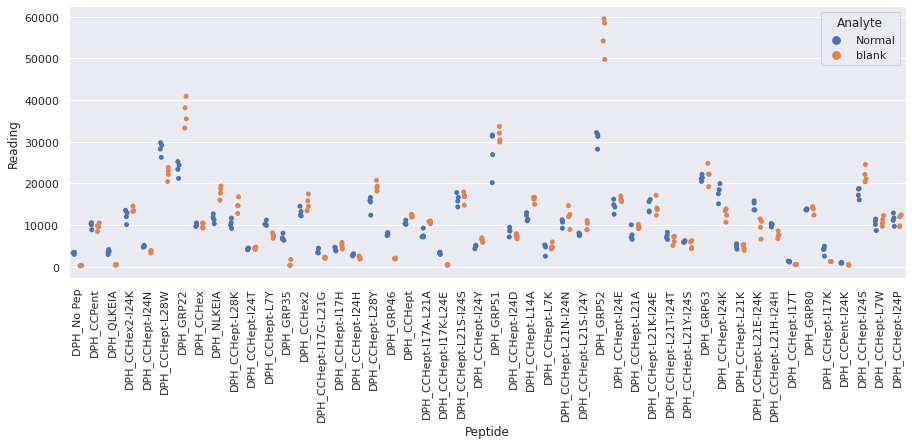

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR4_repeat_16.xlsx
Drawing scatter plot of data spread for Normal_thirtyR4_repeat_16 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

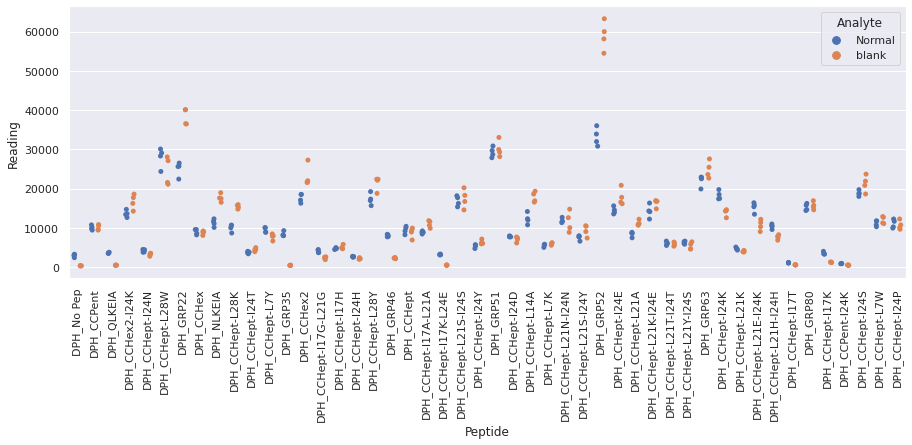

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR1_repeat_17.xlsx
Drawing scatter plot of data spread for Normal_thirtyoneR1_repeat_17 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

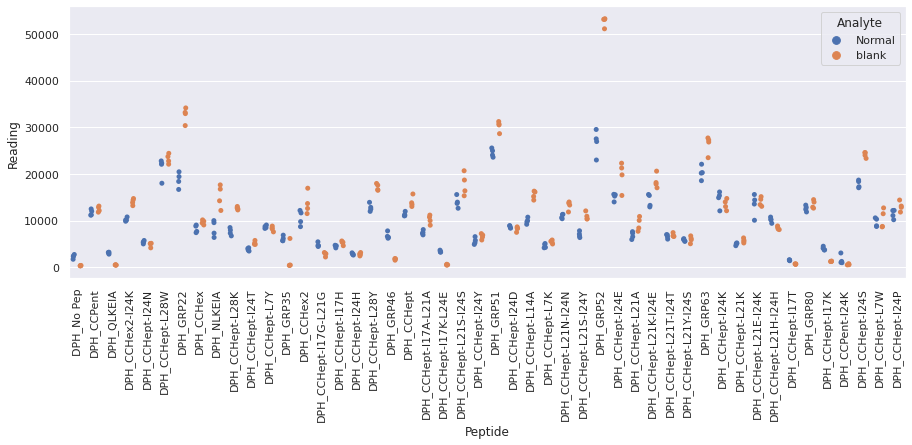

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR2_repeat_17.xlsx
Drawing scatter plot of data spread for Normal_thirtyoneR2_repeat_17 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

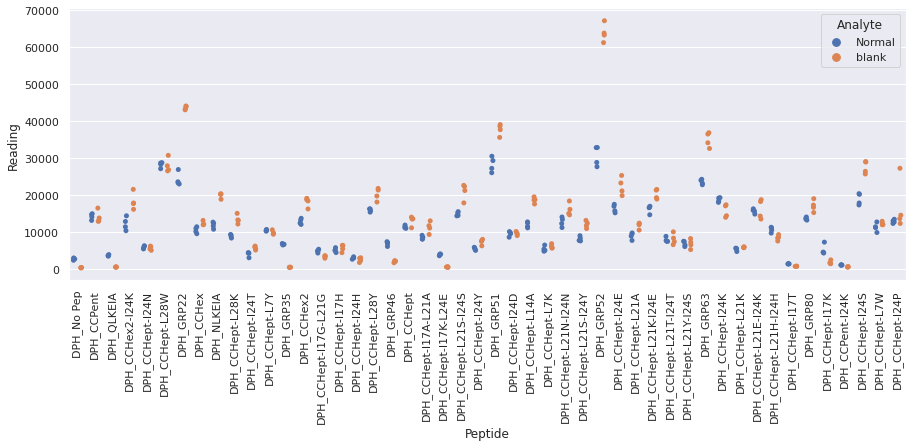

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR3_repeat_17.xlsx
Drawing scatter plot of data spread for Normal_thirtyoneR3_repeat_17 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

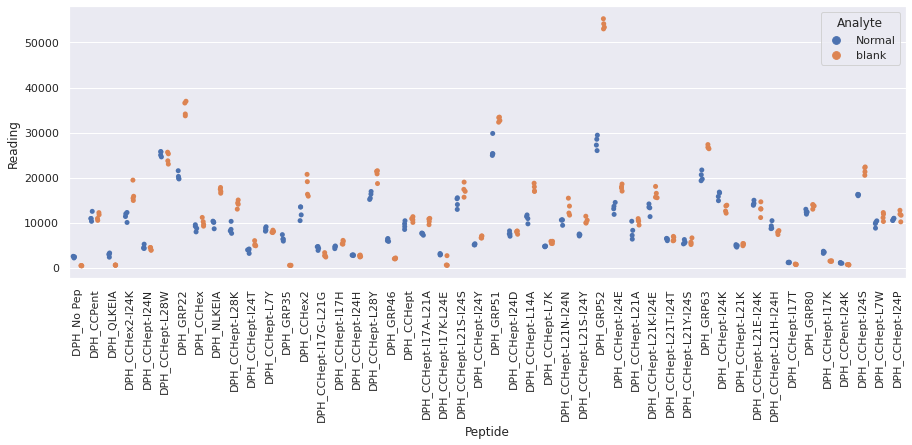

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR4_repeat_17.xlsx
Drawing scatter plot of data spread for Normal_thirtyoneR4_repeat_17 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

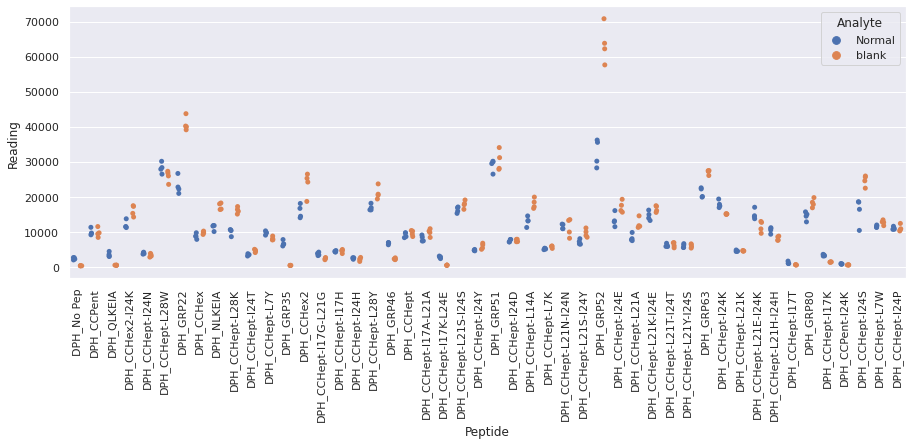

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR1_repeat_18.xlsx
Drawing scatter plot of data spread for Normal_thirtytwoR1_repeat_18 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

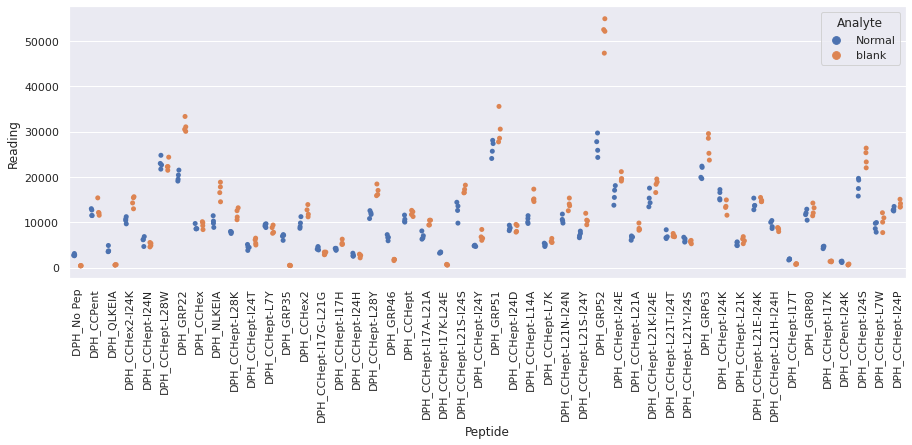

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR2_repeat_18.xlsx
Drawing scatter plot of data spread for Normal_thirtytwoR2_repeat_18 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

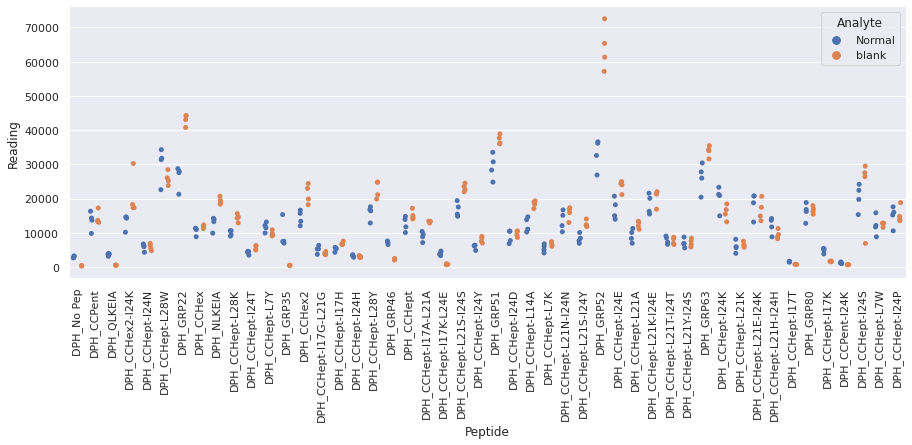

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR3_repeat_18.xlsx
Drawing scatter plot of data spread for Normal_thirtytwoR3_repeat_18 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

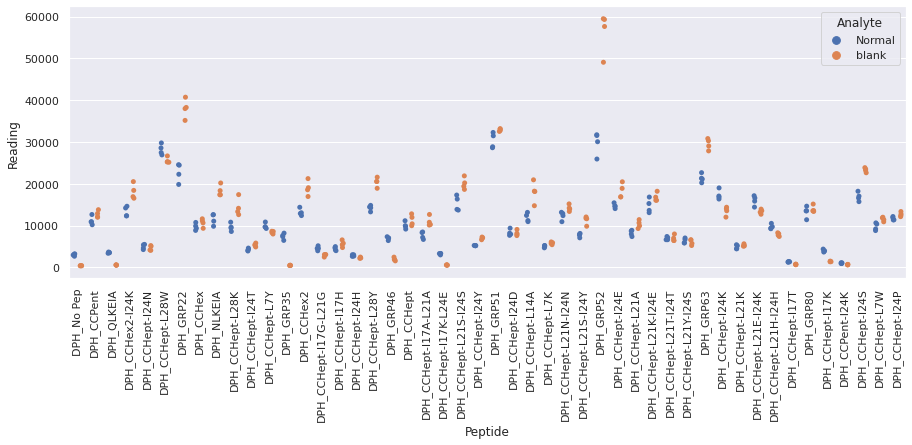

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR4_repeat_18.xlsx
Drawing scatter plot of data spread for Normal_thirtytwoR4_repeat_18 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

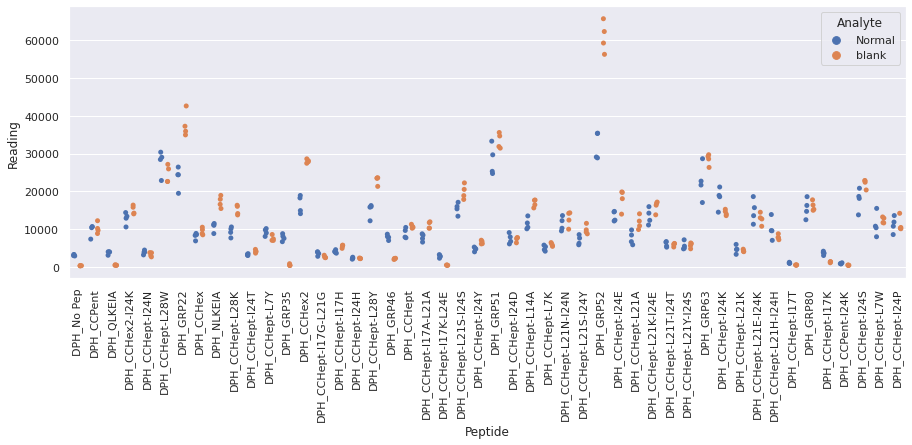

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR1_repeat_19.xlsx
Drawing scatter plot of data spread for Normal_thirtythreeR1_repeat_19 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

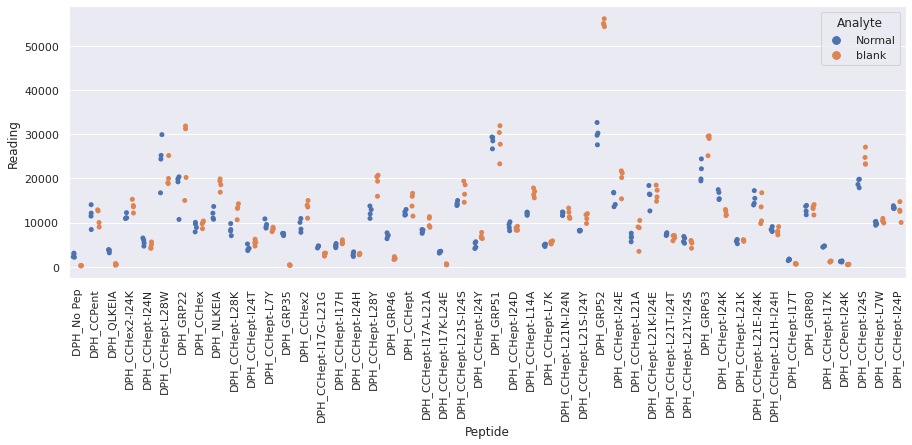

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR2_repeat_19.xlsx
Drawing scatter plot of data spread for Normal_thirtythreeR2_repeat_19 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

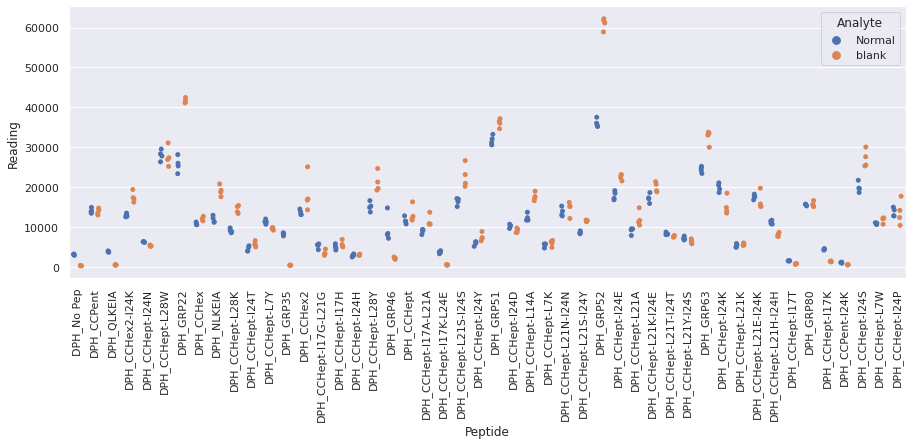

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR3_repeat_19.xlsx
Drawing scatter plot of data spread for Normal_thirtythreeR3_repeat_19 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

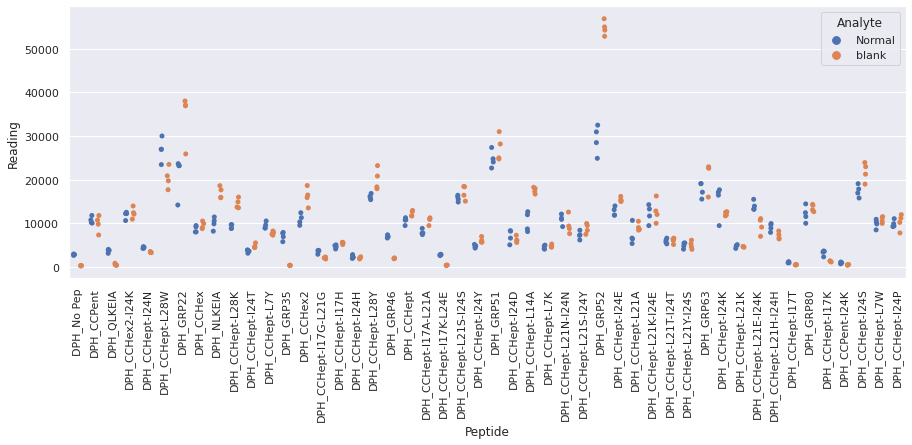

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR4_repeat_19.xlsx
Drawing scatter plot of data spread for Normal_thirtythreeR4_repeat_19 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

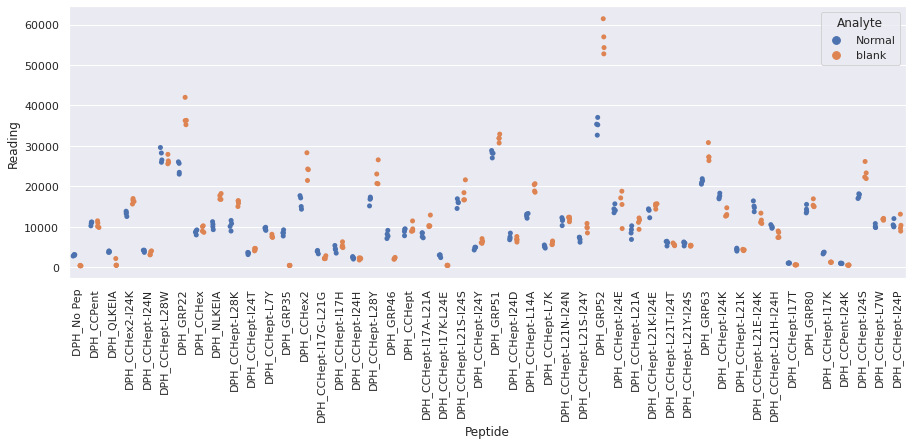

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR1_repeat_20.xlsx
Drawing scatter plot of data spread for Normal_thirtyfourR1_repeat_20 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

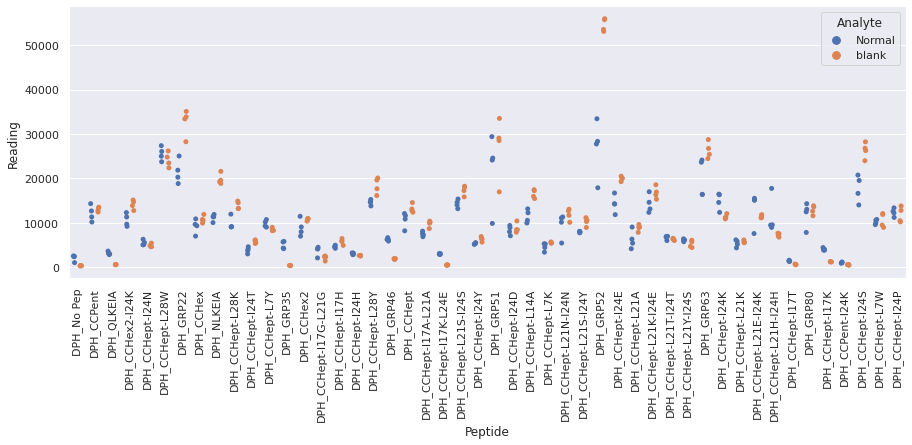

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR2_repeat_20.xlsx
Drawing scatter plot of data spread for Normal_thirtyfourR2_repeat_20 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

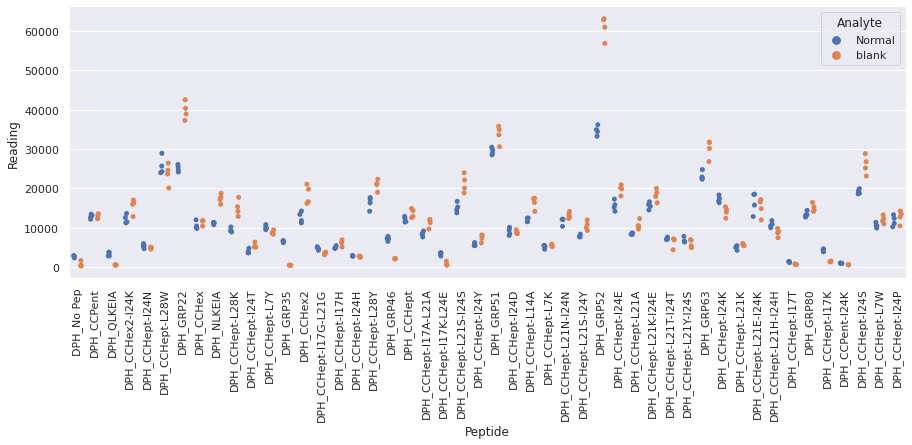

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR3_repeat_20.xlsx
Drawing scatter plot of data spread for Normal_thirtyfourR3_repeat_20 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

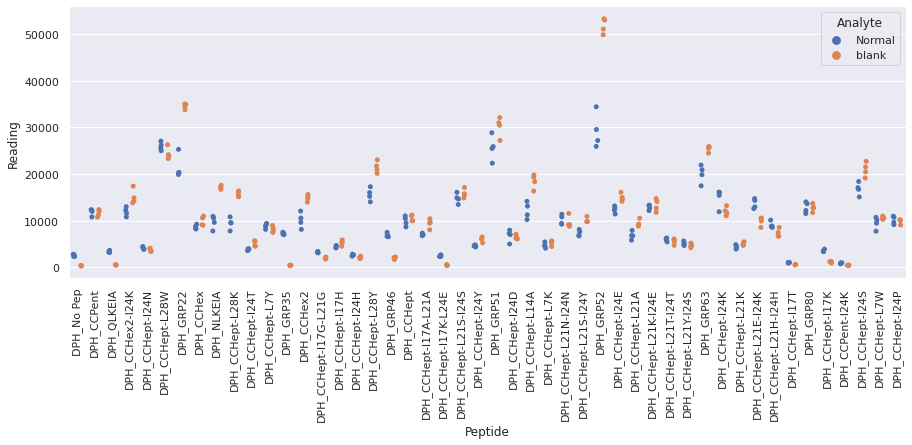

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR4_repeat_20.xlsx
Drawing scatter plot of data spread for Normal_thirtyfourR4_repeat_20 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

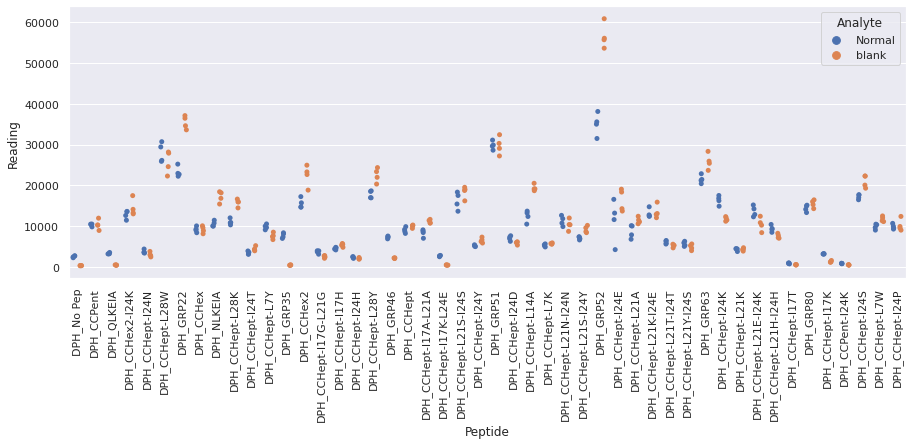

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR1_repeat_21.xlsx
Drawing scatter plot of data spread for Normal_thirtyfiveR1_repeat_21 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

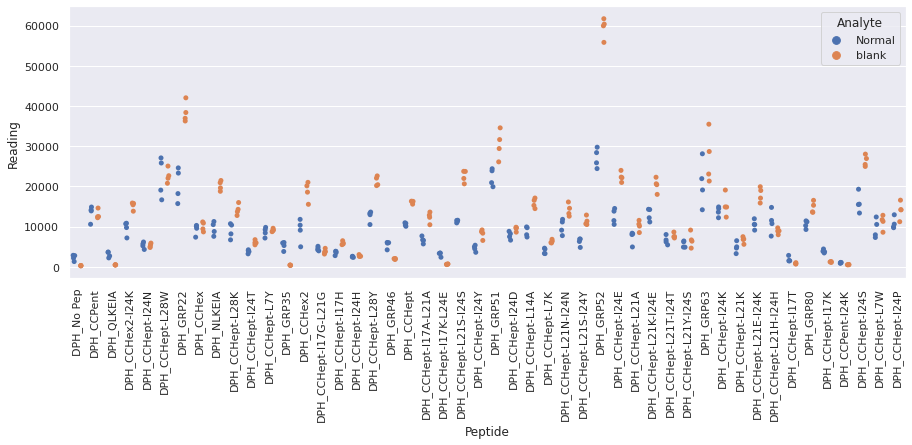

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR2_repeat_21.xlsx
Drawing scatter plot of data spread for Normal_thirtyfiveR2_repeat_21 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

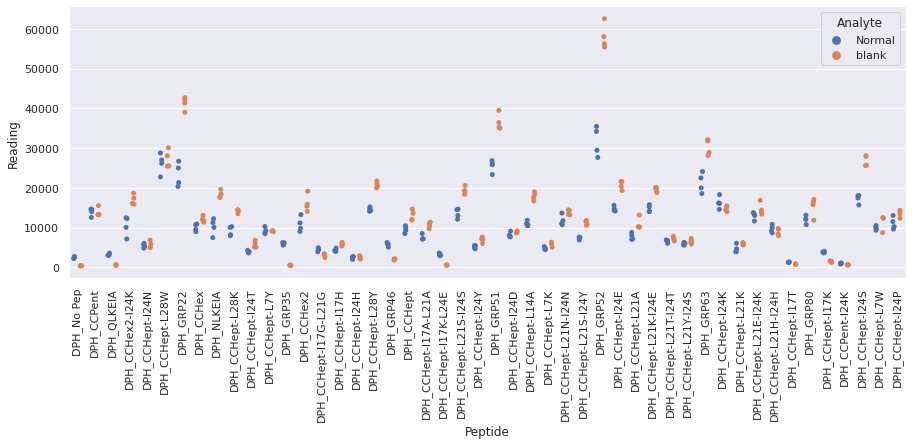

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR3_repeat_21.xlsx
Drawing scatter plot of data spread for Normal_thirtyfiveR3_repeat_21 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

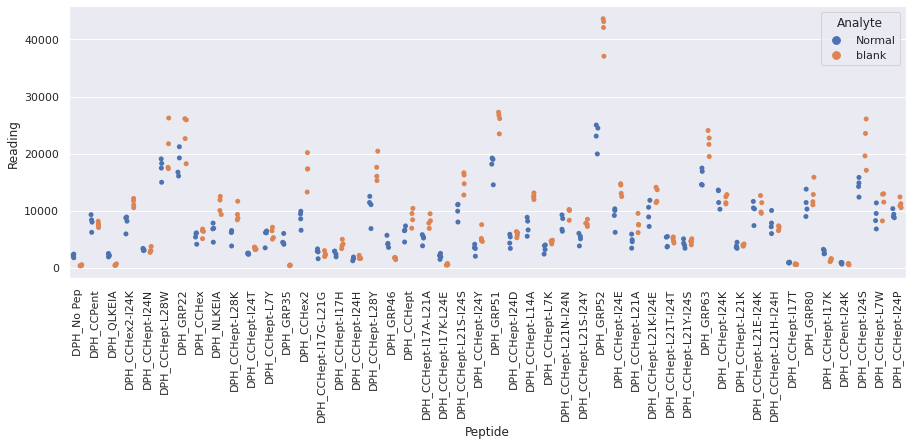

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR4_repeat_21.xlsx
Drawing scatter plot of data spread for Normal_thirtyfiveR4_repeat_21 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

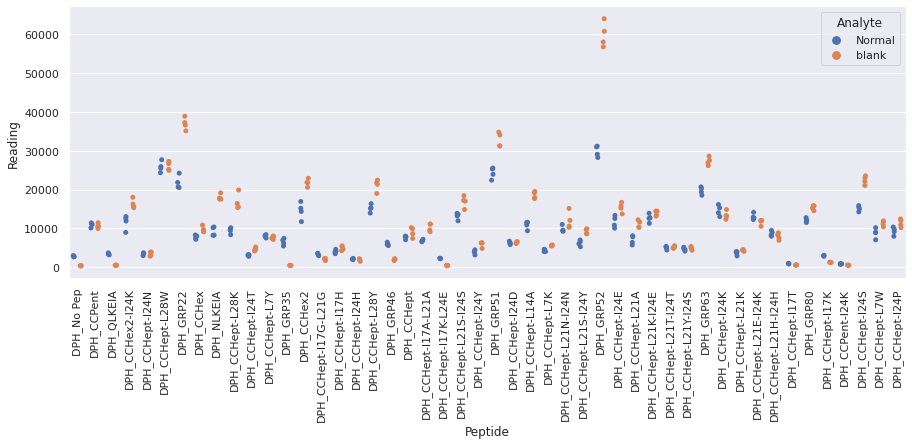

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR1_repeat_22.xlsx
Drawing scatter plot of data spread for Normal_thirtysixR1_repeat_22 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

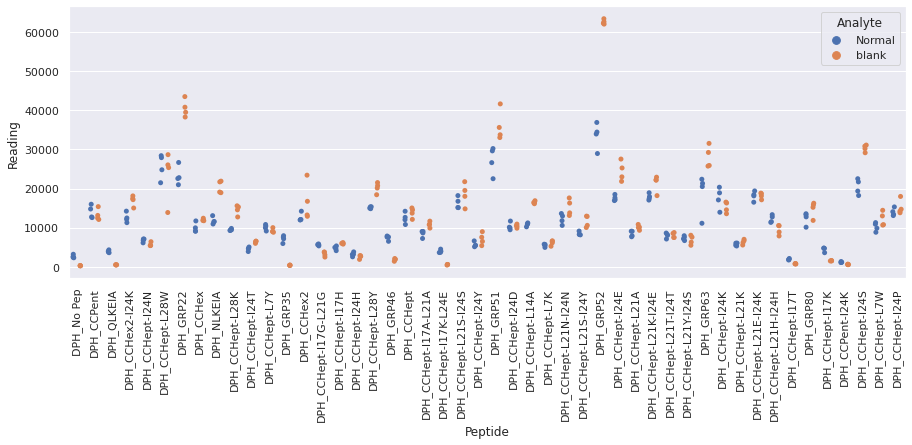

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR2_repeat_22.xlsx
Drawing scatter plot of data spread for Normal_thirtysixR2_repeat_22 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

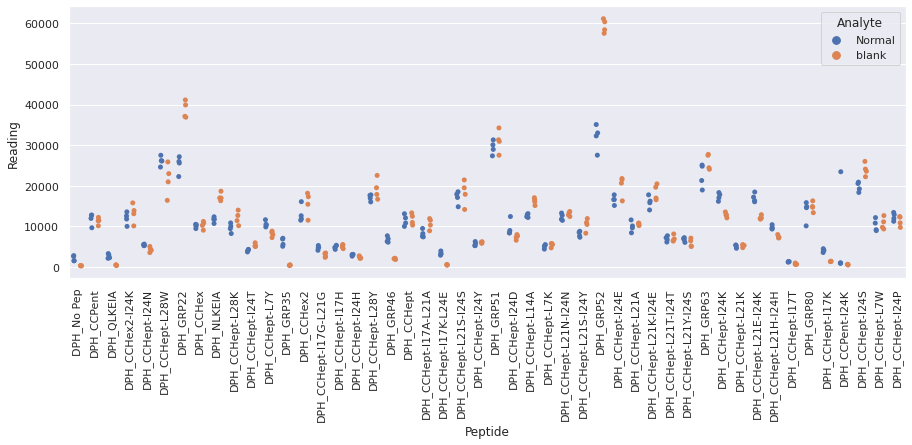

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR3_repeat_22.xlsx
Drawing scatter plot of data spread for Normal_thirtysixR3_repeat_22 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

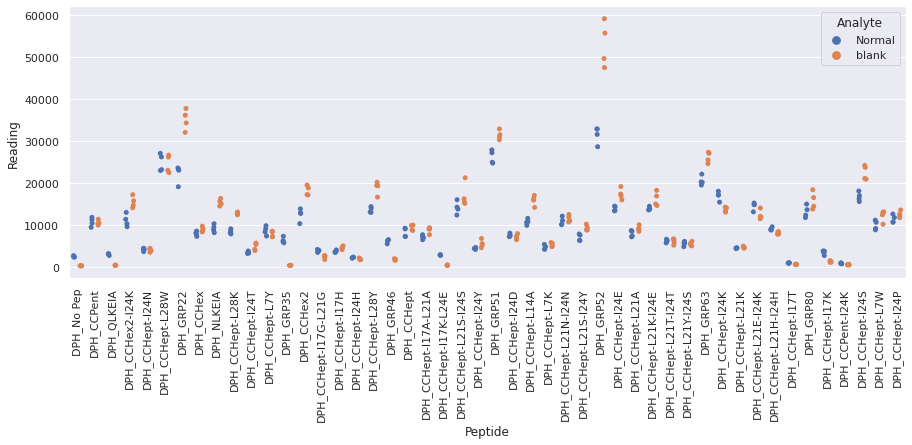

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR4_repeat_22.xlsx
Drawing scatter plot of data spread for Normal_thirtysixR4_repeat_22 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

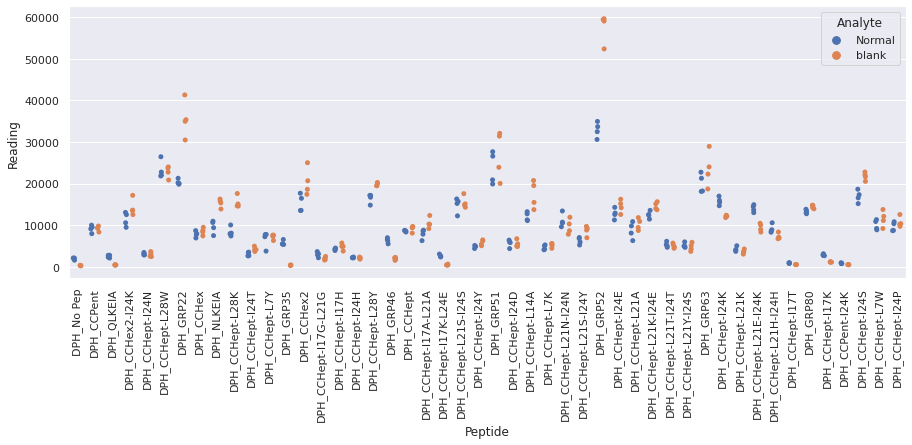

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR1_repeat_23.xlsx
Drawing scatter plot of data spread for Normal_thirtysevenR1_repeat_23 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

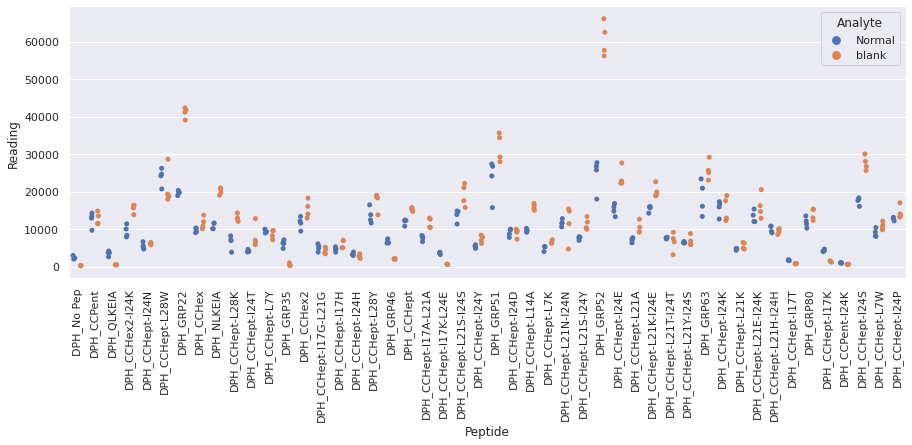

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR2_repeat_23.xlsx
Drawing scatter plot of data spread for Normal_thirtysevenR2_repeat_23 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

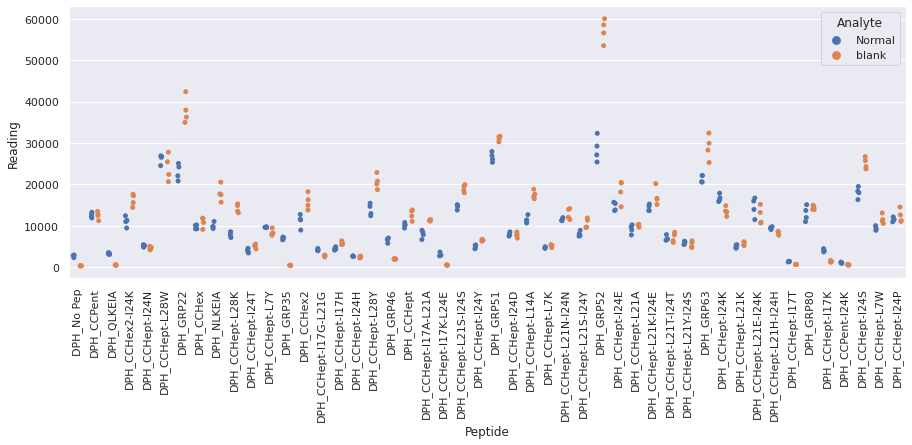

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR3_repeat_23.xlsx
Drawing scatter plot of data spread for Normal_thirtysevenR3_repeat_23 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

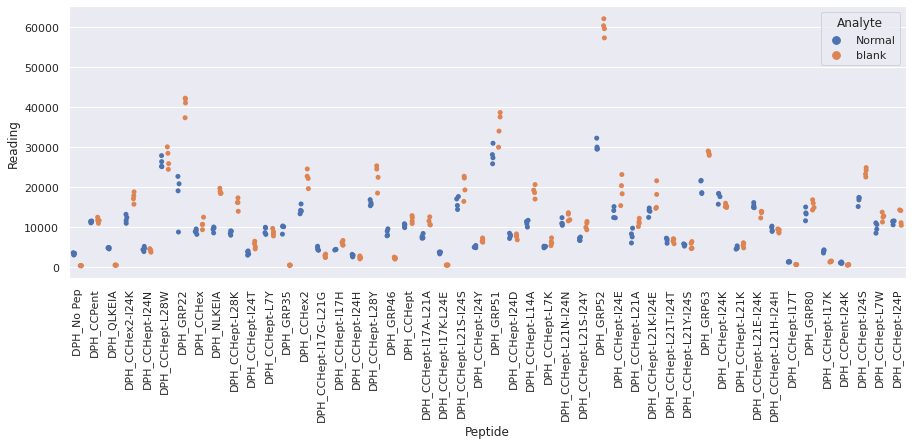

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR4_repeat_23.xlsx
Drawing scatter plot of data spread for Normal_thirtysevenR4_repeat_23 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

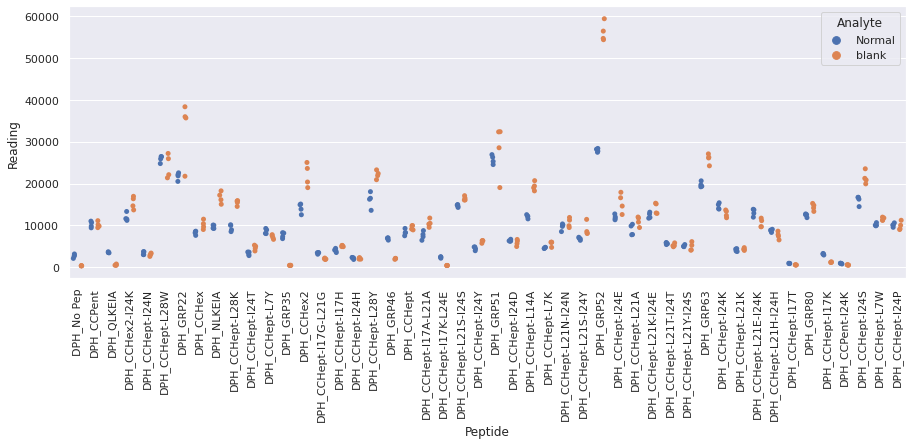

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR1_repeat_24.xlsx
Drawing scatter plot of data spread for Normal_thirtyeightR1_repeat_24 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

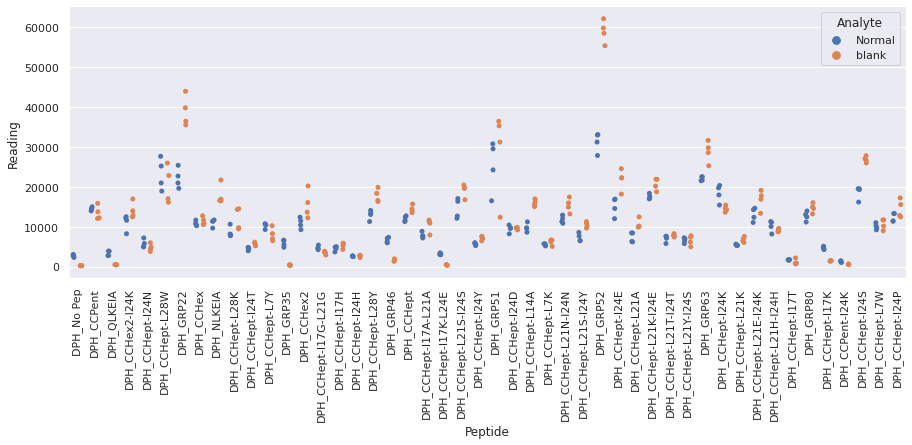

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR2_repeat_24.xlsx
Drawing scatter plot of data spread for Normal_thirtyeightR2_repeat_24 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

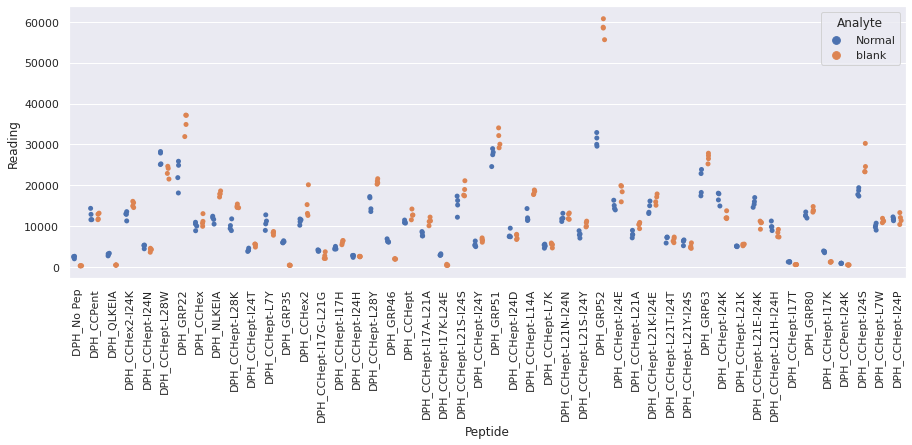

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR3_repeat_24.xlsx
Drawing scatter plot of data spread for Normal_thirtyeightR3_repeat_24 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

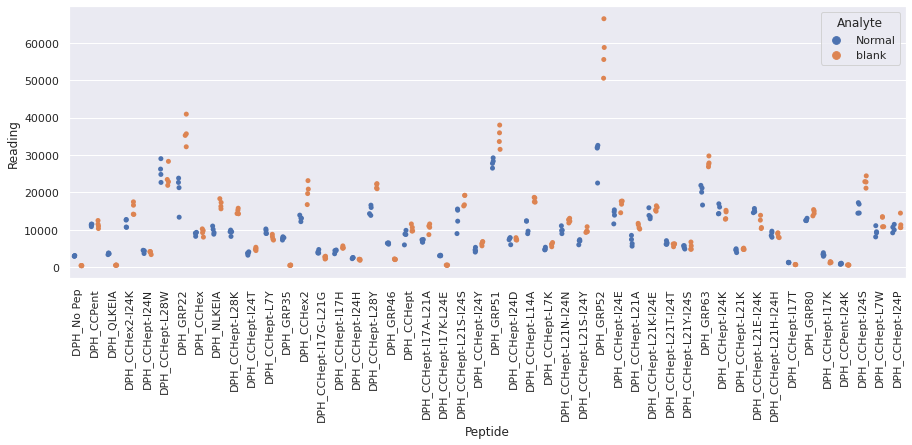

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR4_repeat_24.xlsx
Drawing scatter plot of data spread for Normal_thirtyeightR4_repeat_24 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

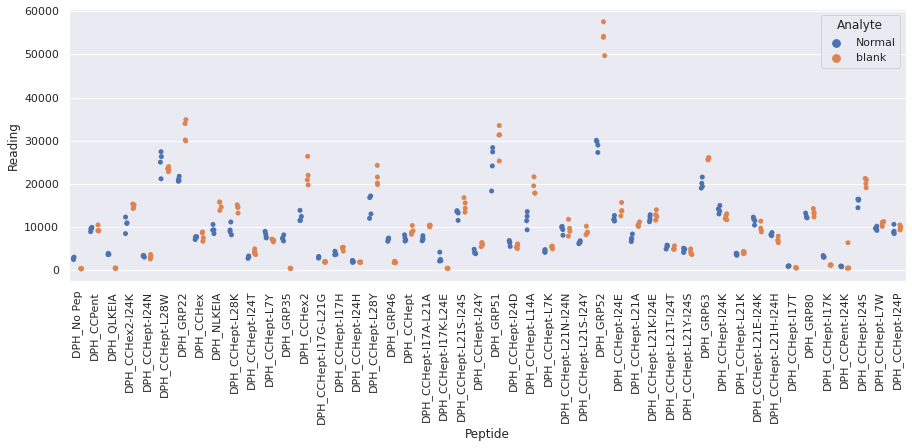

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR1_repeat_25.xlsx
Drawing scatter plot of data spread for Normal_thirtynineR1_repeat_25 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

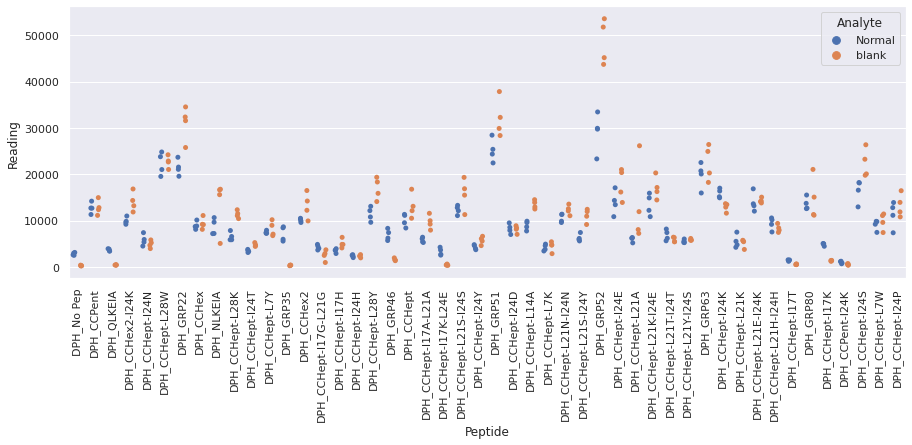

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR2_repeat_25.xlsx
Drawing scatter plot of data spread for Normal_thirtynineR2_repeat_25 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

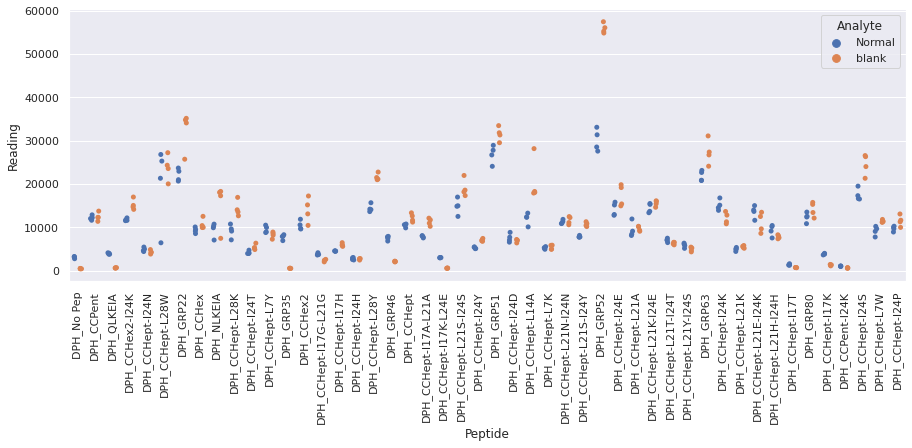

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR3_repeat_25.xlsx
Drawing scatter plot of data spread for Normal_thirtynineR3_repeat_25 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

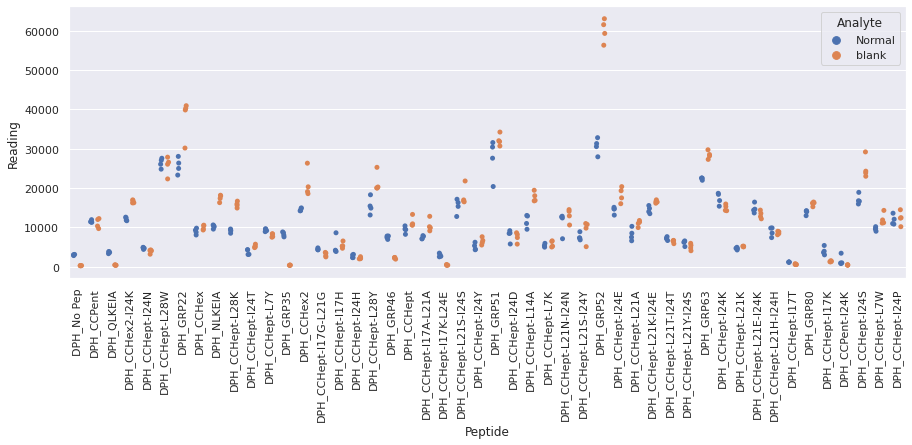

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR4_repeat_25.xlsx
Drawing scatter plot of data spread for Normal_thirtynineR4_repeat_25 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

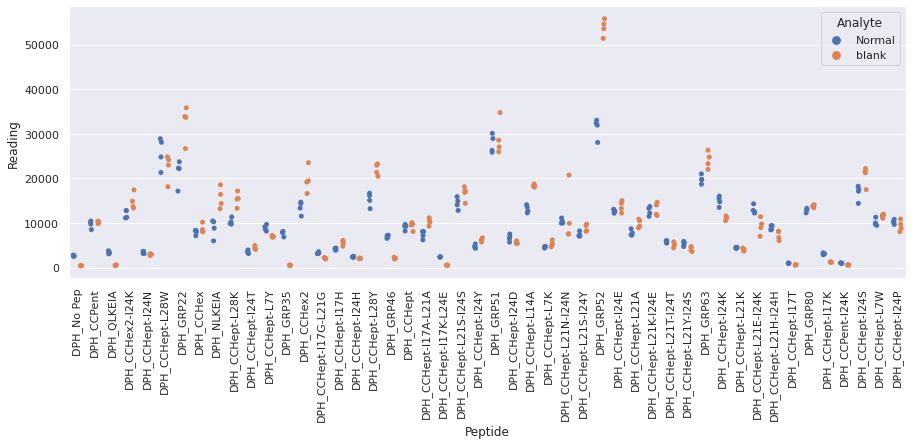

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR1_repeat_26.xlsx
Drawing scatter plot of data spread for Normal_fortyR1_repeat_26 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

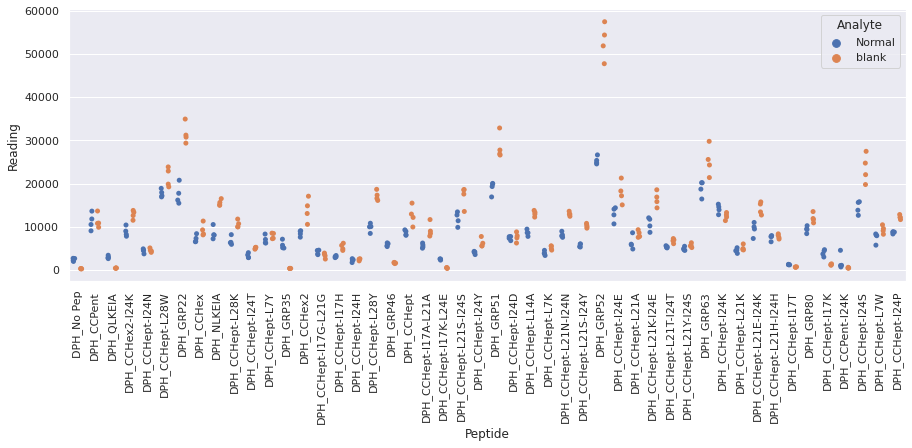

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR2_repeat_26.xlsx
Drawing scatter plot of data spread for Normal_fortyR2_repeat_26 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

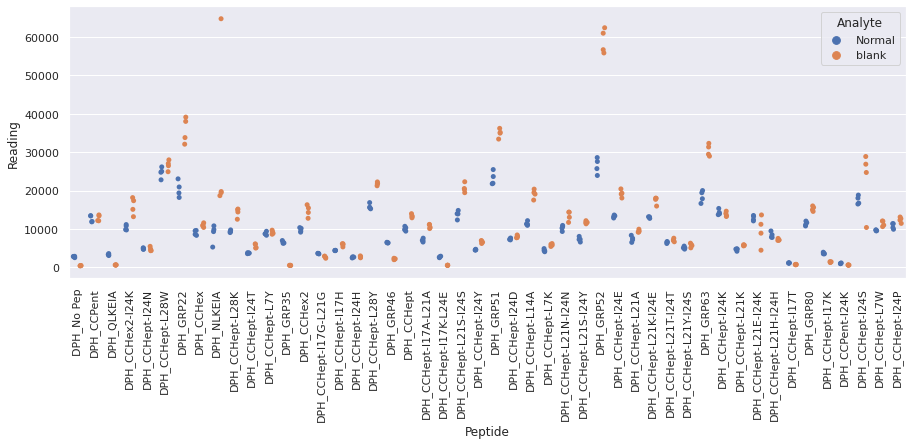

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR3_repeat_26.xlsx
Drawing scatter plot of data spread for Normal_fortyR3_repeat_26 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

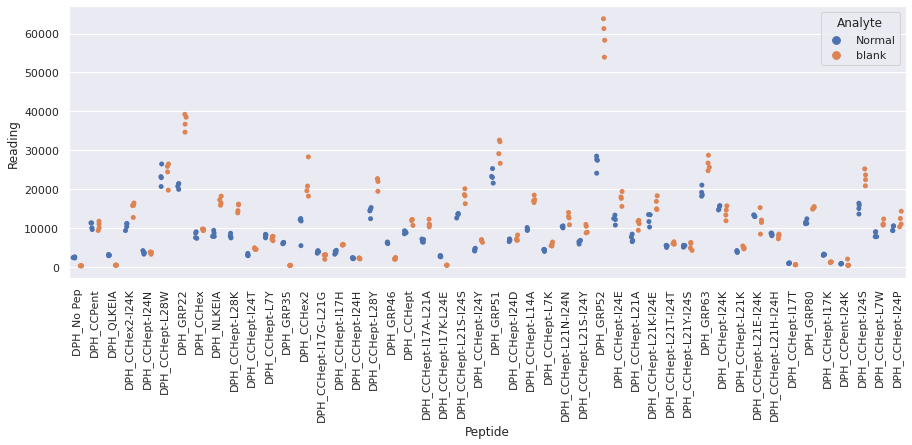

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR4_repeat_26.xlsx
Drawing scatter plot of data spread for Normal_fortyR4_repeat_26 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

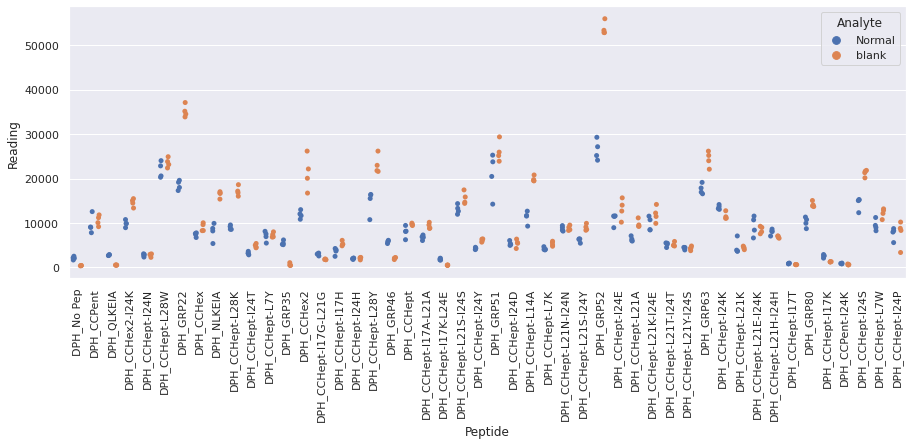

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR1_repeat_27.xlsx
Drawing scatter plot of data spread for Normal_fortyoneR1_repeat_27 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

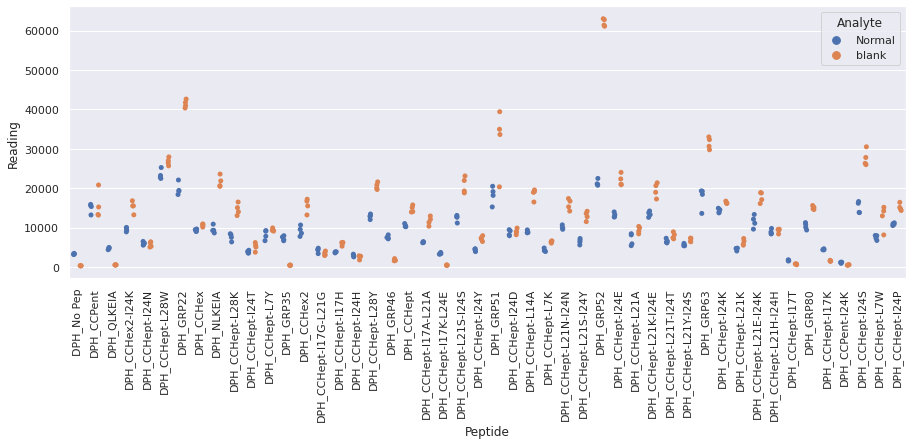

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR2_repeat_27.xlsx
Drawing scatter plot of data spread for Normal_fortyoneR2_repeat_27 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

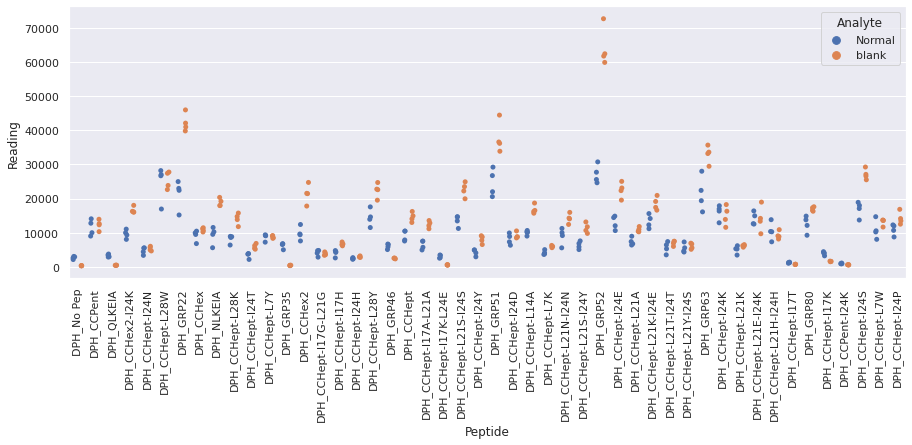

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR3_repeat_27.xlsx
Drawing scatter plot of data spread for Normal_fortyoneR3_repeat_27 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

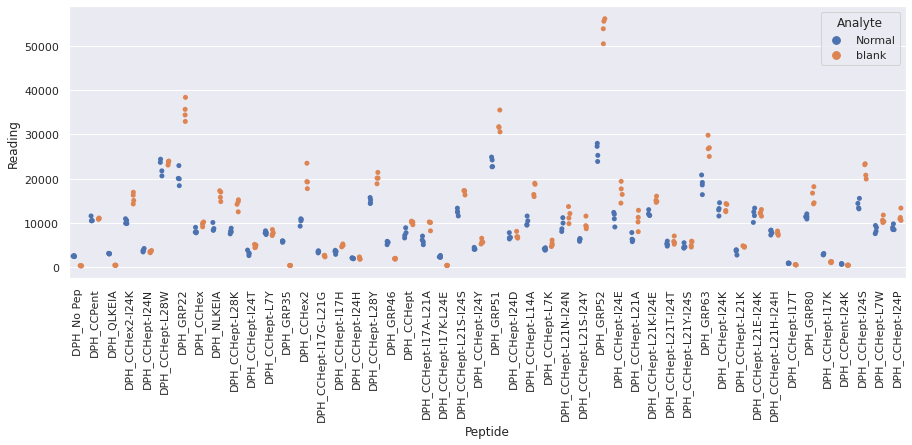

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR4_repeat_27.xlsx
Drawing scatter plot of data spread for Normal_fortyoneR4_repeat_27 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

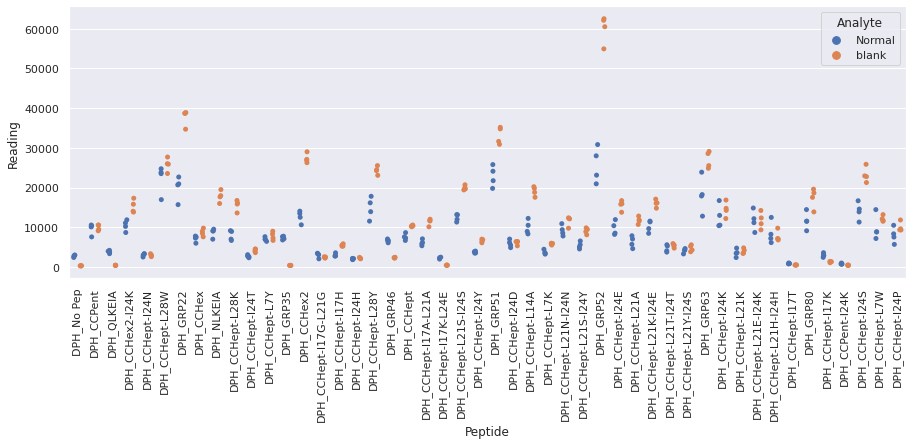

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR1_repeat_28.xlsx
Drawing scatter plot of data spread for Normal_fortytwoR1_repeat_28 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

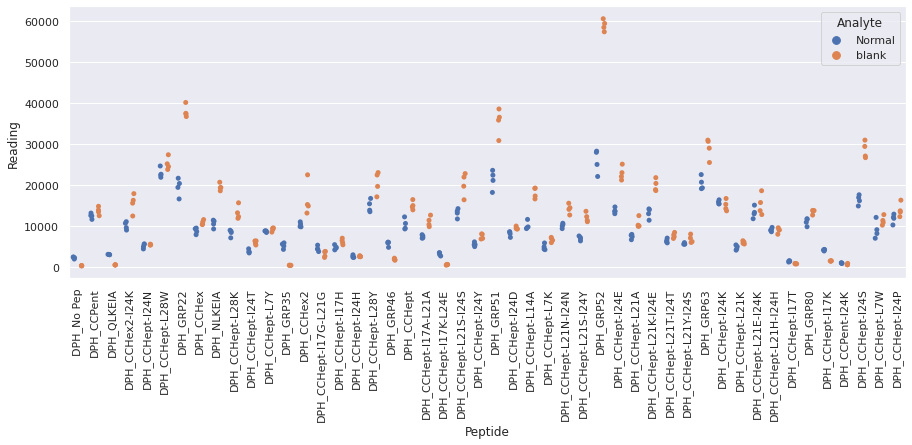

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR2_repeat_28.xlsx
Drawing scatter plot of data spread for Normal_fortytwoR2_repeat_28 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

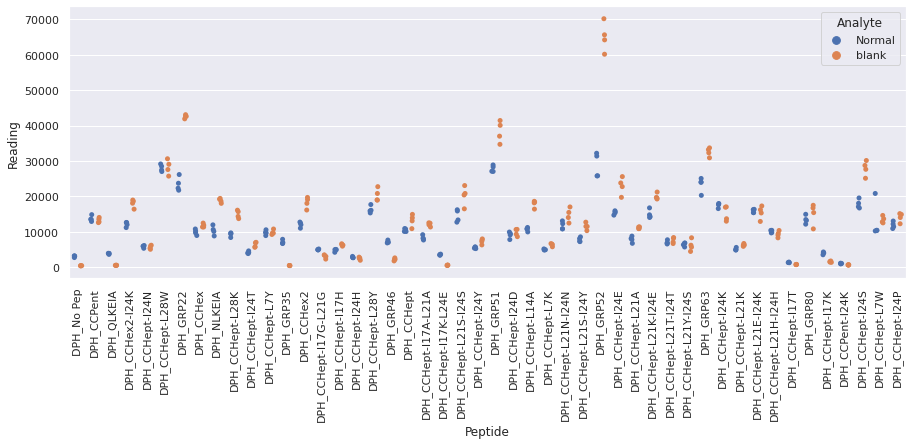

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR3_repeat_28.xlsx
Drawing scatter plot of data spread for Normal_fortytwoR3_repeat_28 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

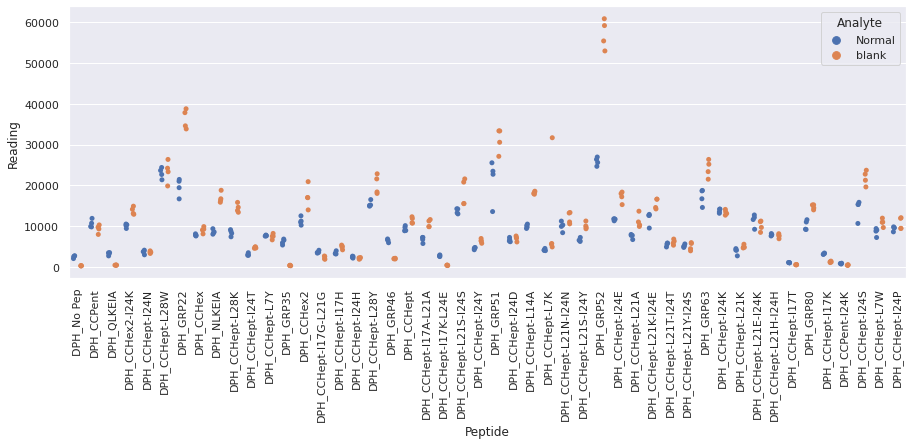

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR4_repeat_28.xlsx
Drawing scatter plot of data spread for Normal_fortytwoR4_repeat_28 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

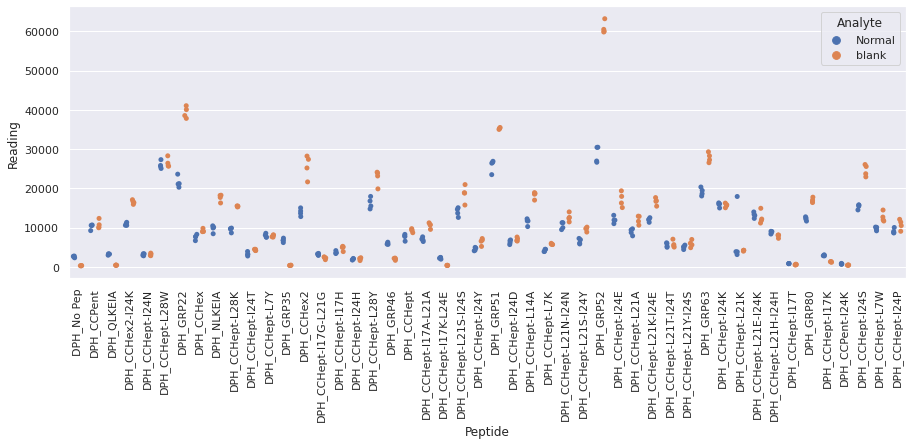

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteenR1_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

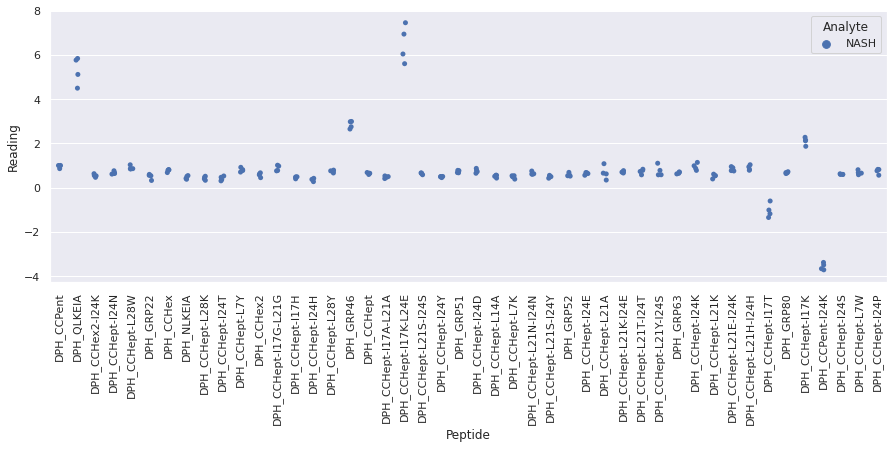

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR2_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR2_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteenR2_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

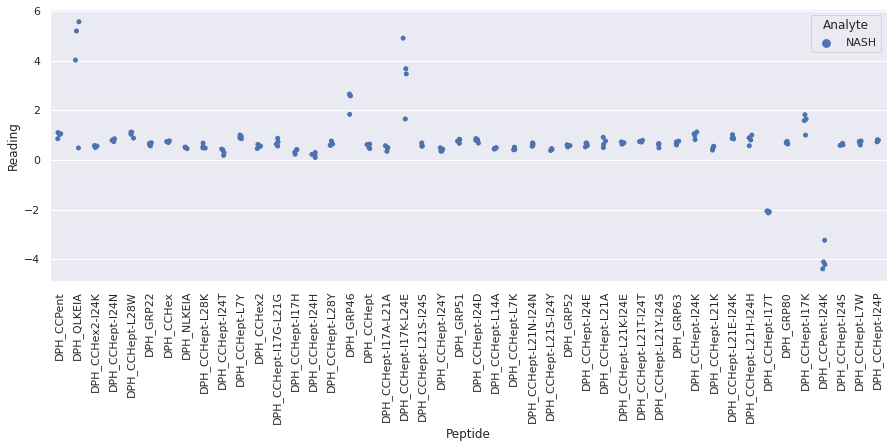

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteenR3_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

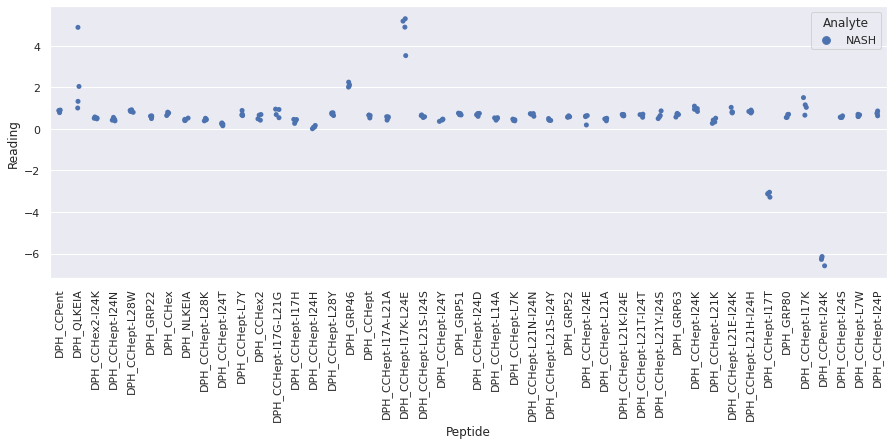

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteenR4_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

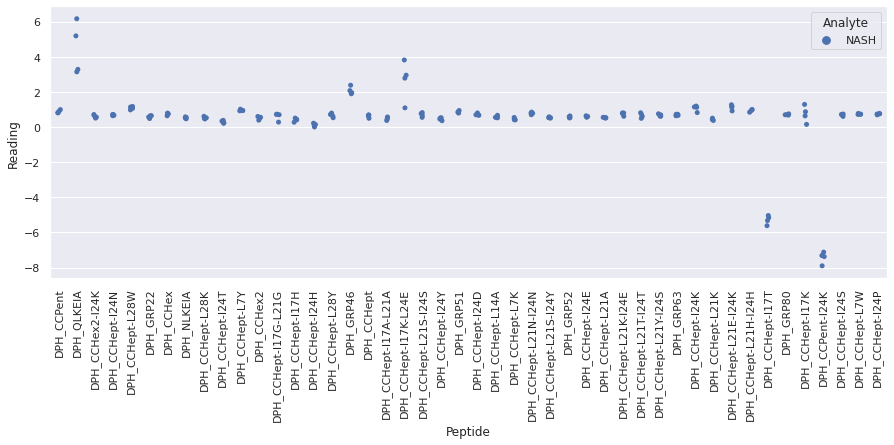

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR1_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR1_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_oneR1_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

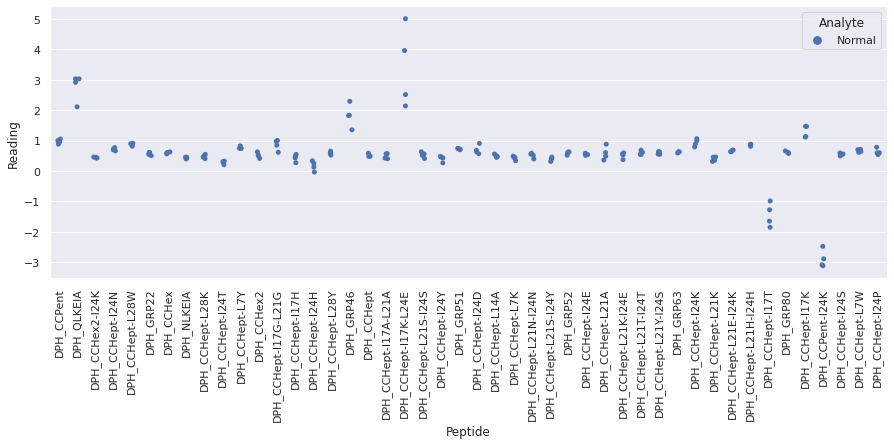

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR2_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR2_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_oneR2_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

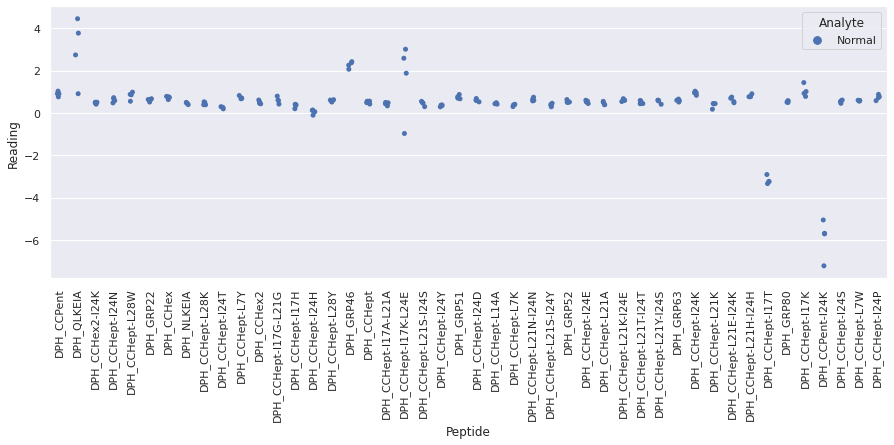

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CC

<Figure size 720x720 with 0 Axes>

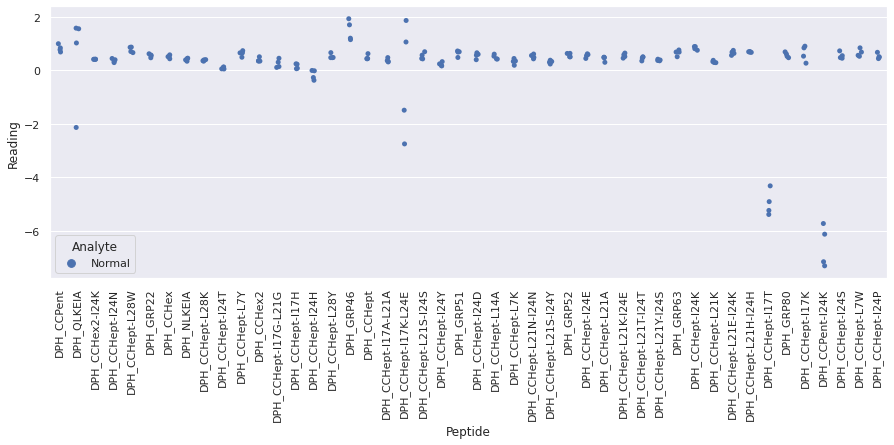

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CC

<Figure size 720x720 with 0 Axes>

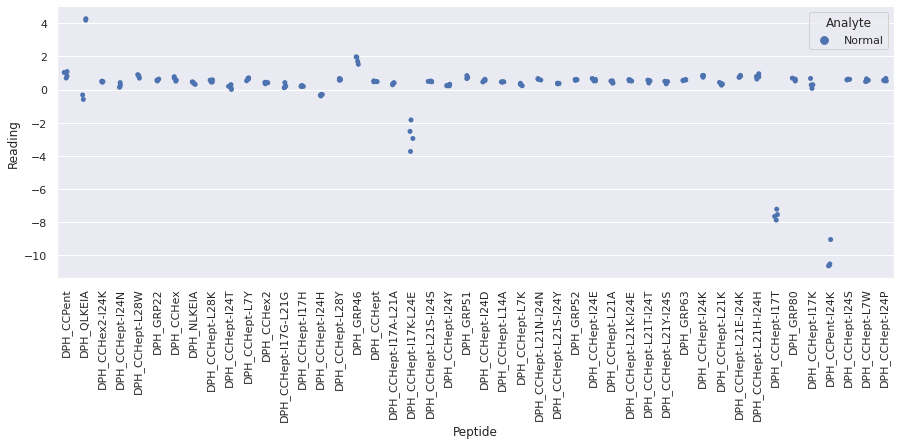

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR1_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR1_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteenR1_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

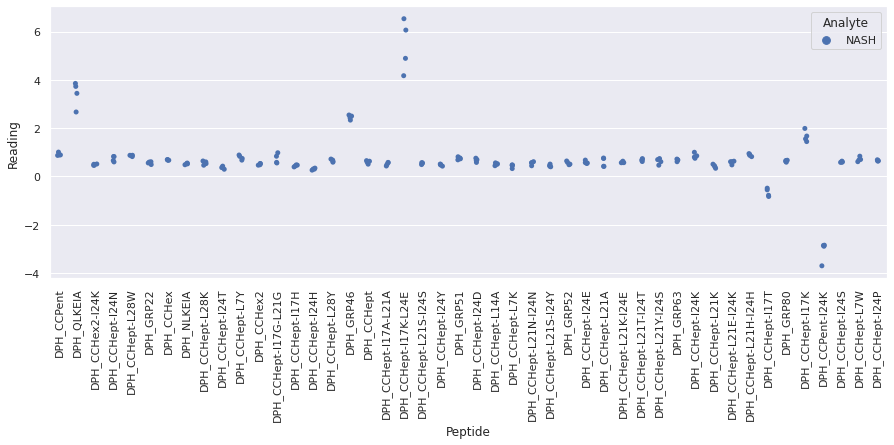

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR2_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR2_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteenR2_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

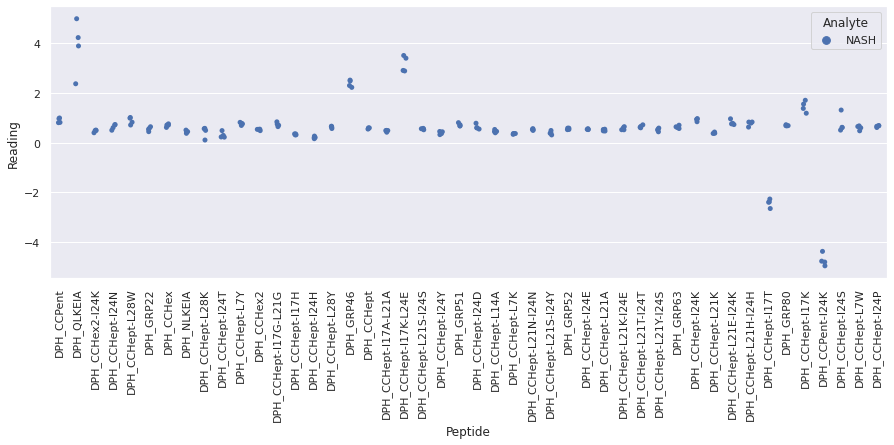

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteenR3_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

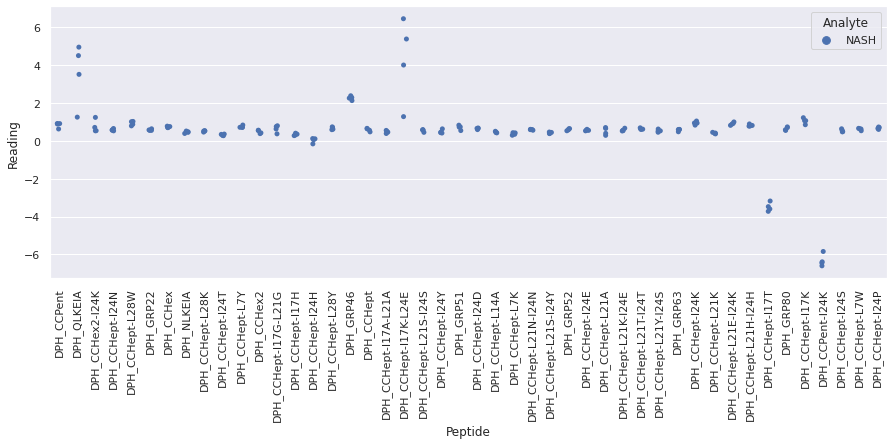

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteenR4_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

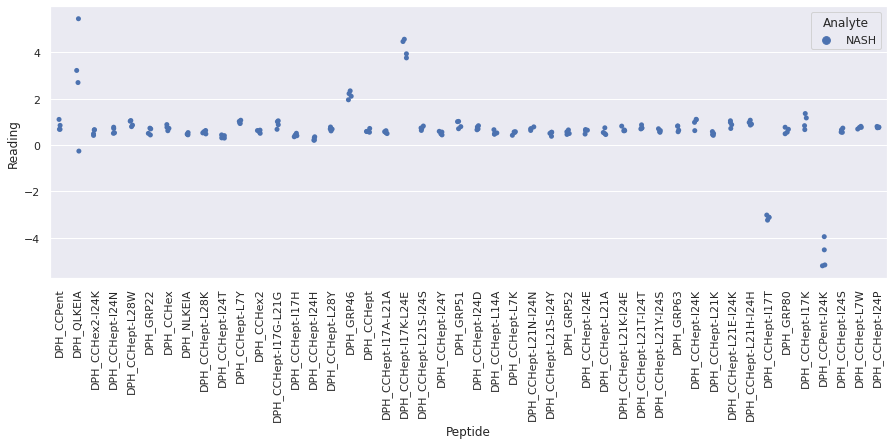

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR1_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR1_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twoR1_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

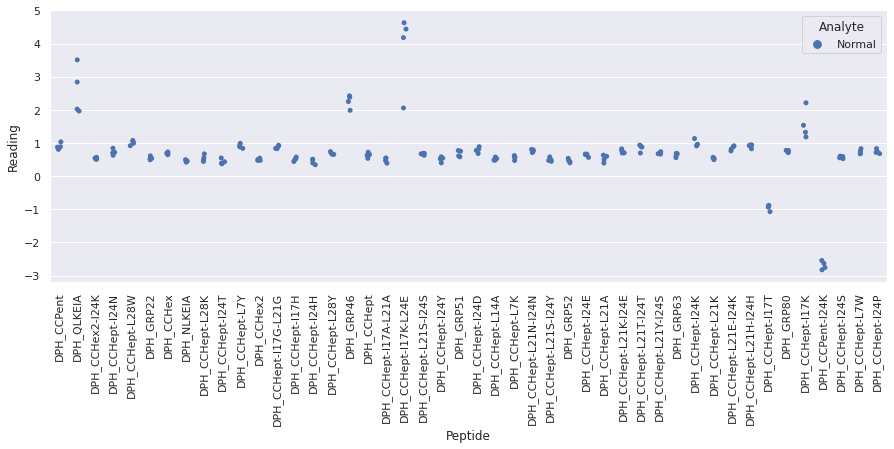

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR2_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR2_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twoR2_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

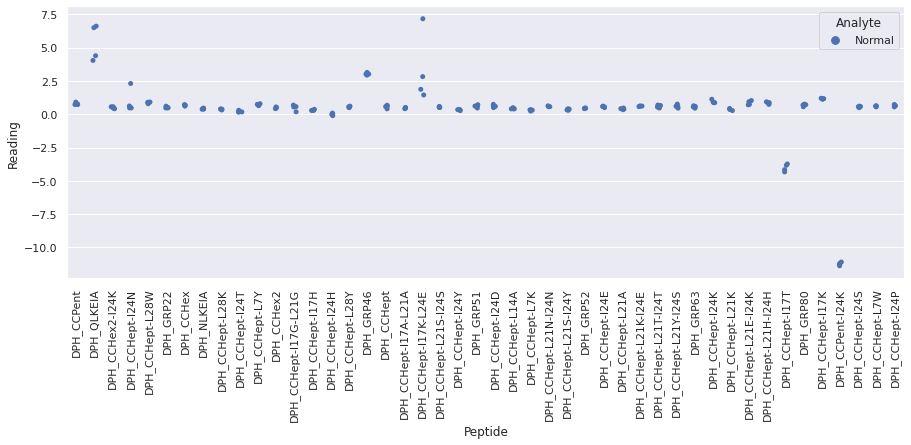

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CC

<Figure size 720x720 with 0 Axes>

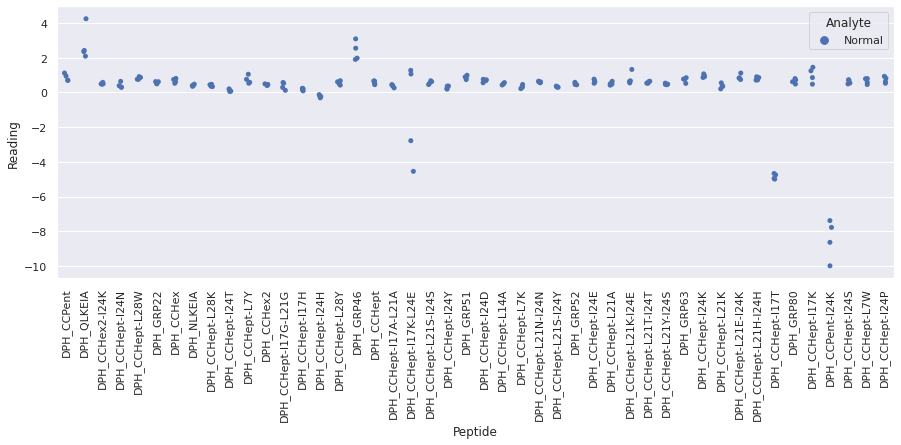

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twoR4_re

<Figure size 720x720 with 0 Axes>

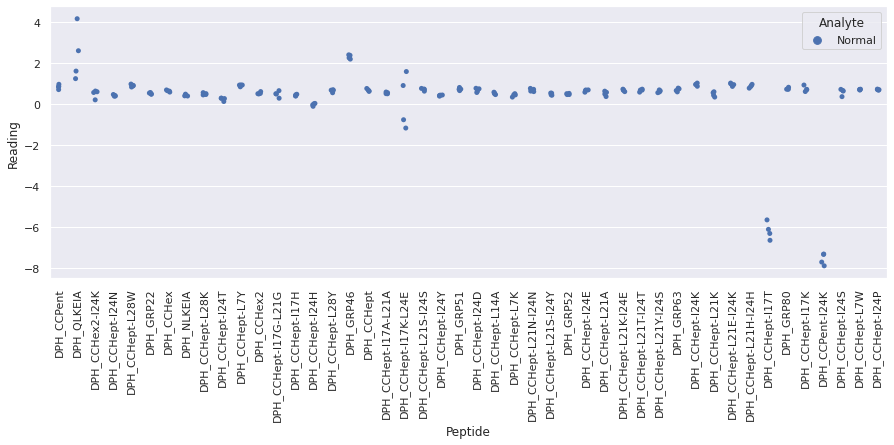

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR1_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR1_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeenR1_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

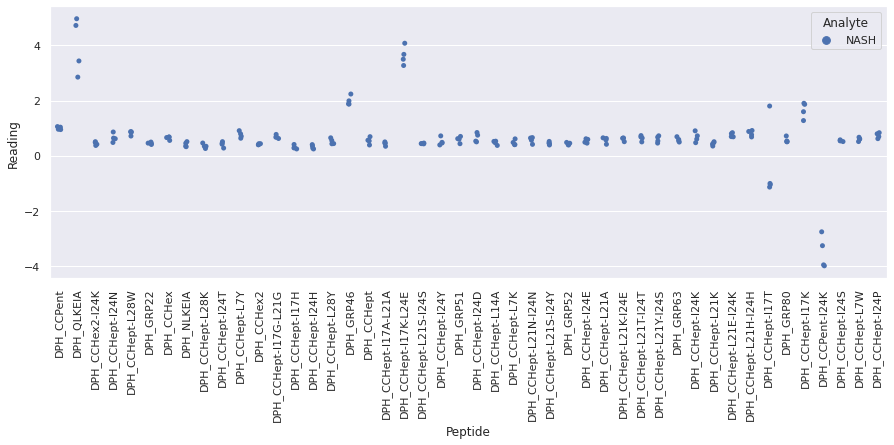

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR2_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR2_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeenR2_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

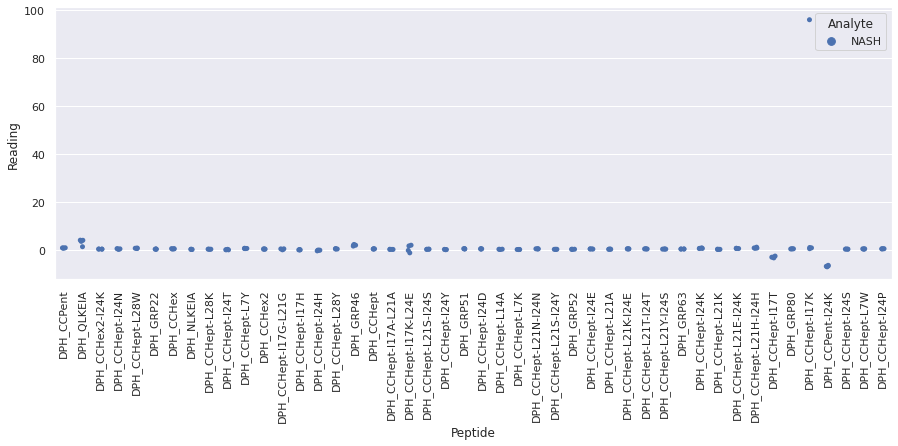

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeenR3_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

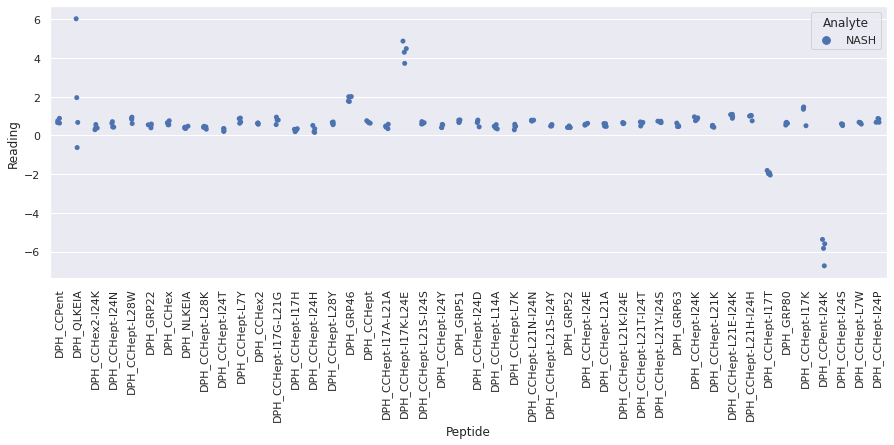

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24N + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17G-L21G + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHe

<Figure size 720x720 with 0 Axes>

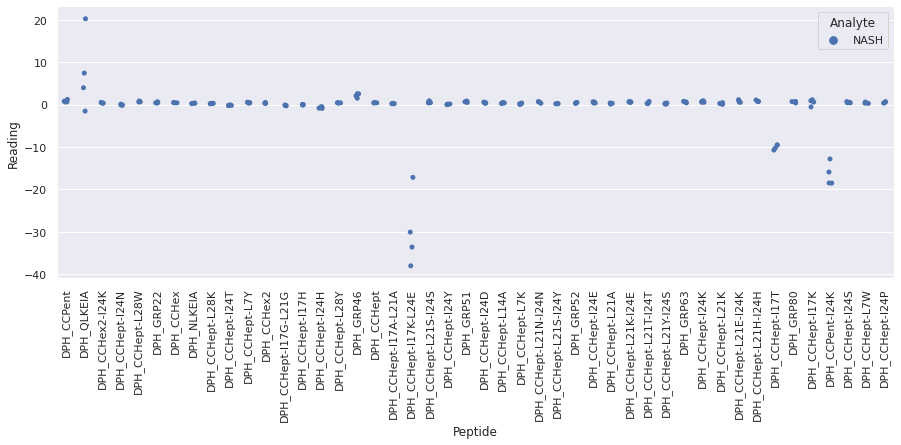

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR1_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR1_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_threeR1_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

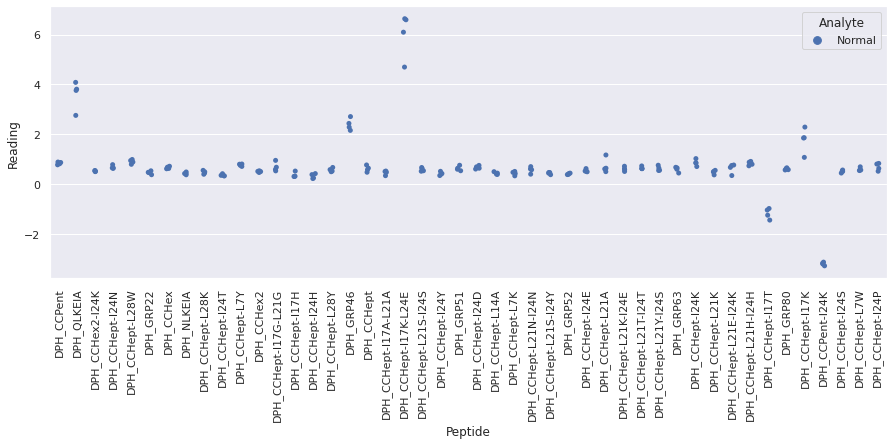

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR2_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR2_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_threeR2_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

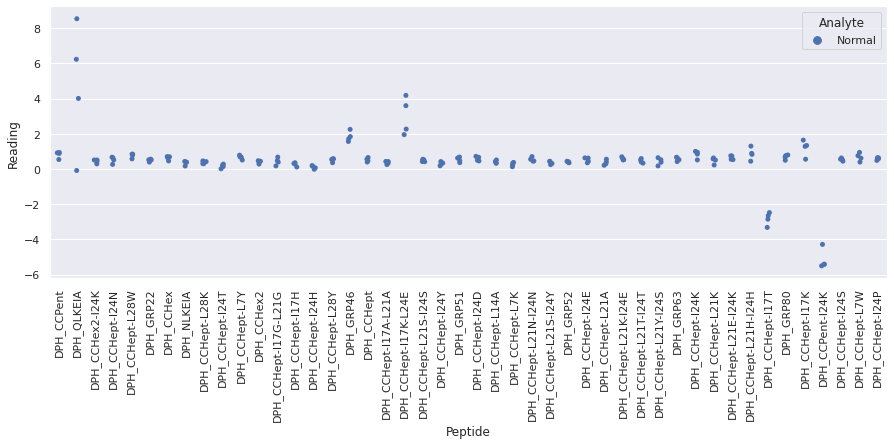

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_th

<Figure size 720x720 with 0 Axes>

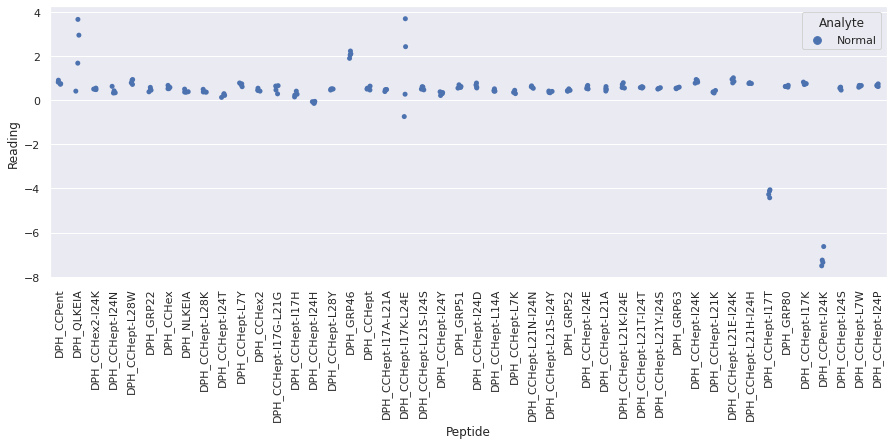

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_threeR4_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

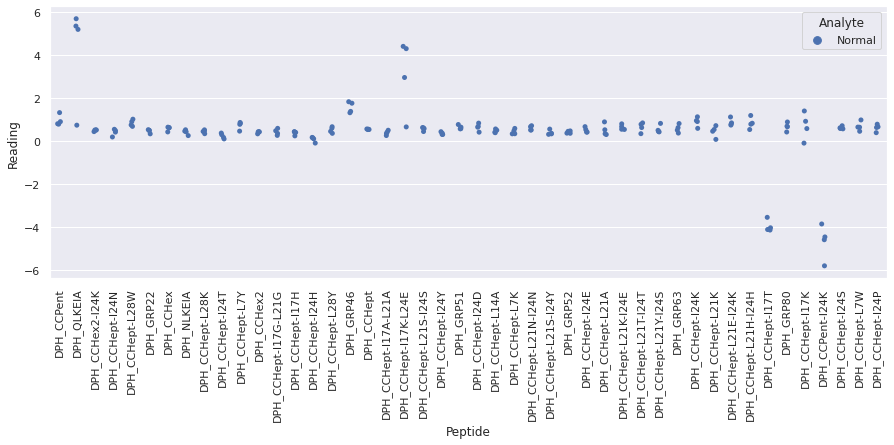

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR1_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR1_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteenR1_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

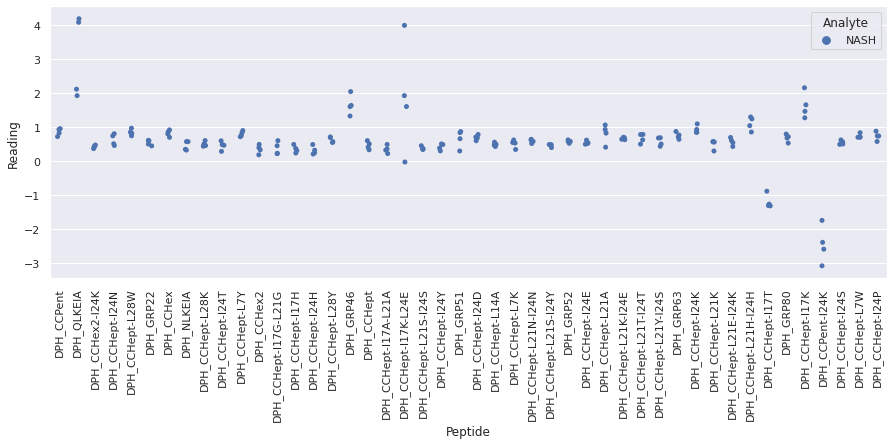

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteenR2_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

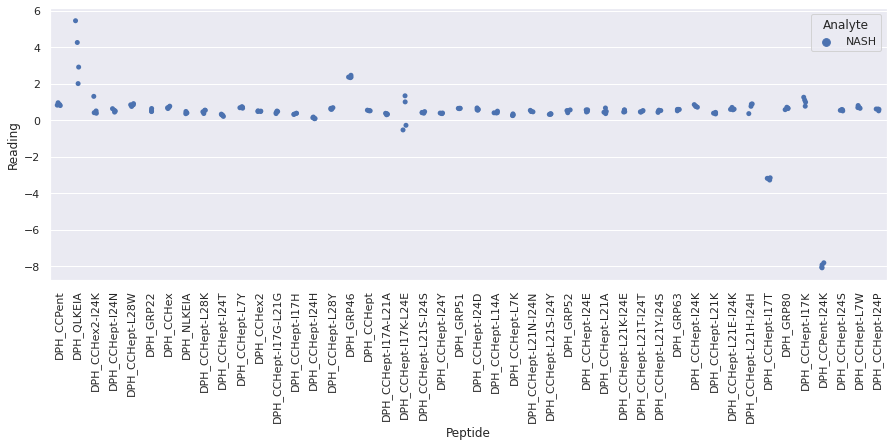

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteenR3_re

<Figure size 720x720 with 0 Axes>

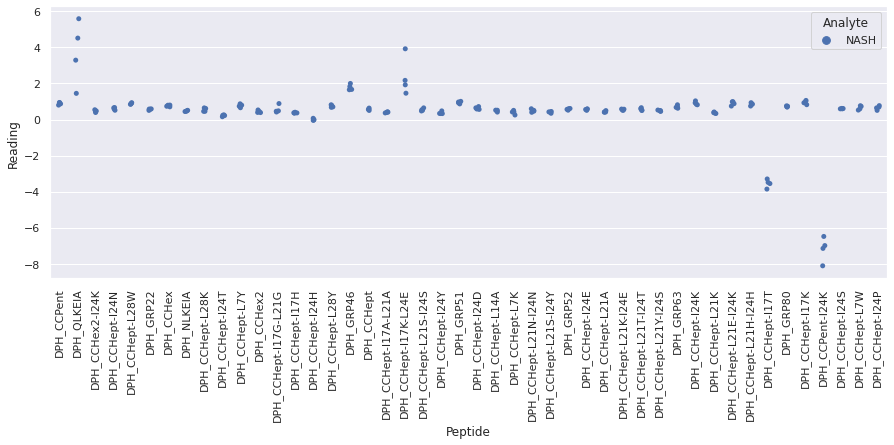

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteenR4_re

<Figure size 720x720 with 0 Axes>

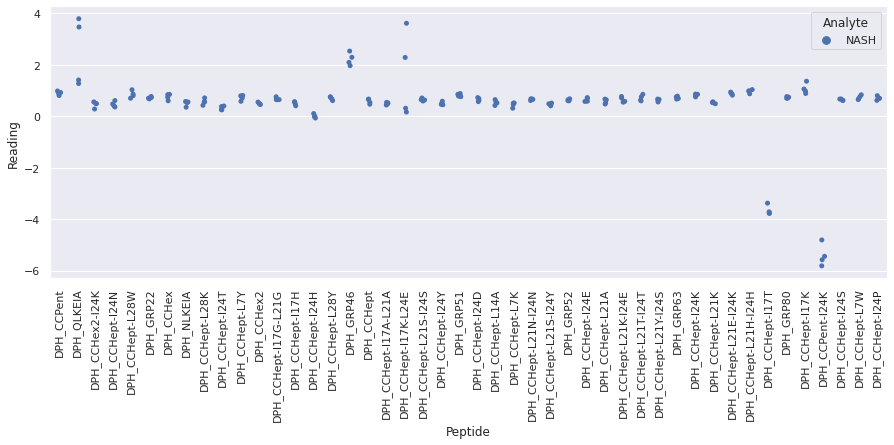

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR1_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR1_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourR1_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

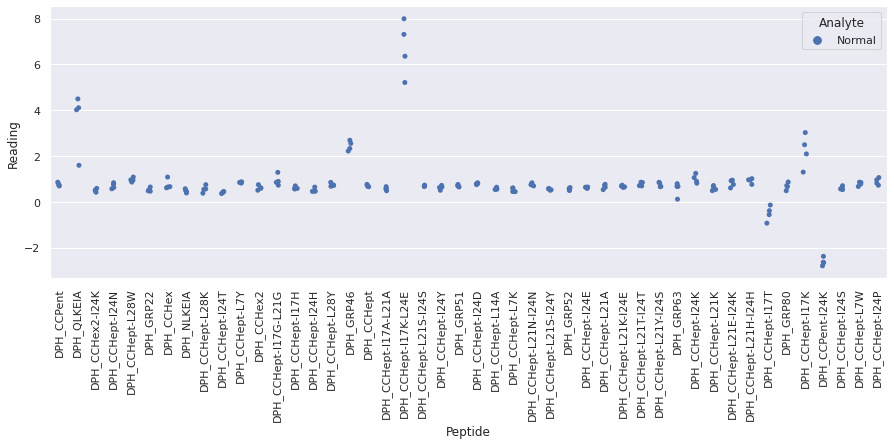

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourR

<Figure size 720x720 with 0 Axes>

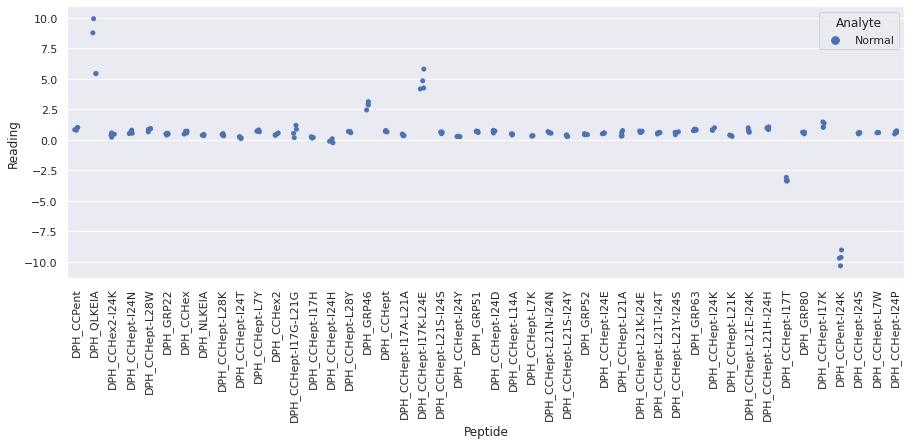

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourR3_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

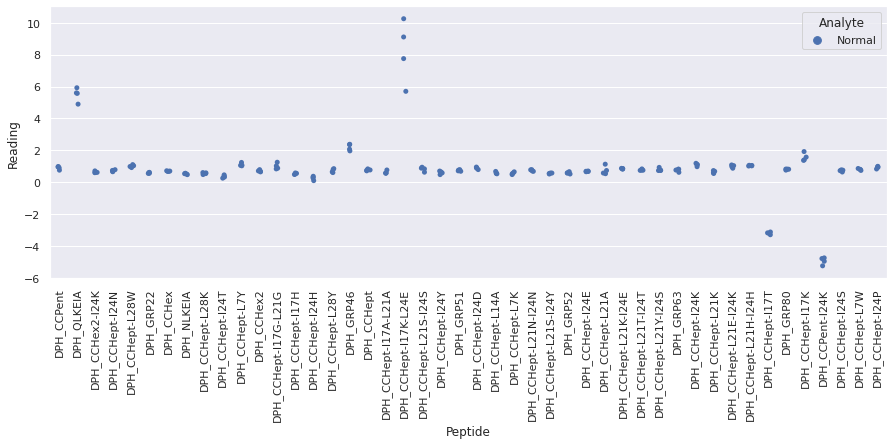

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourR

<Figure size 720x720 with 0 Axes>

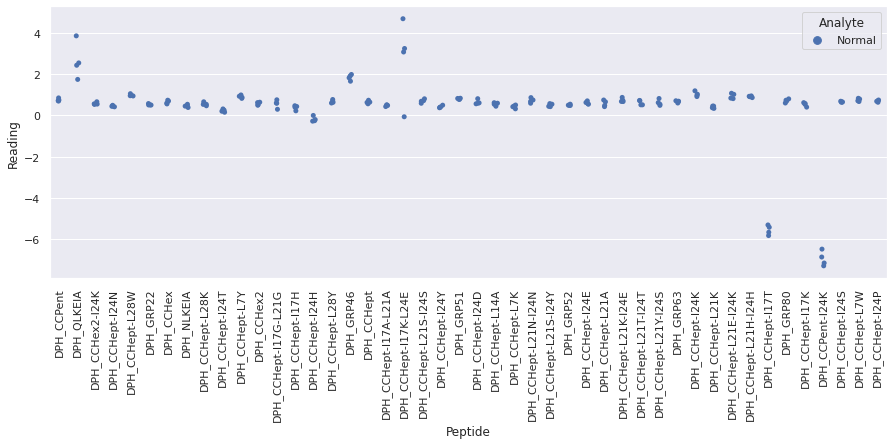

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR1_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR1_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteenR1_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

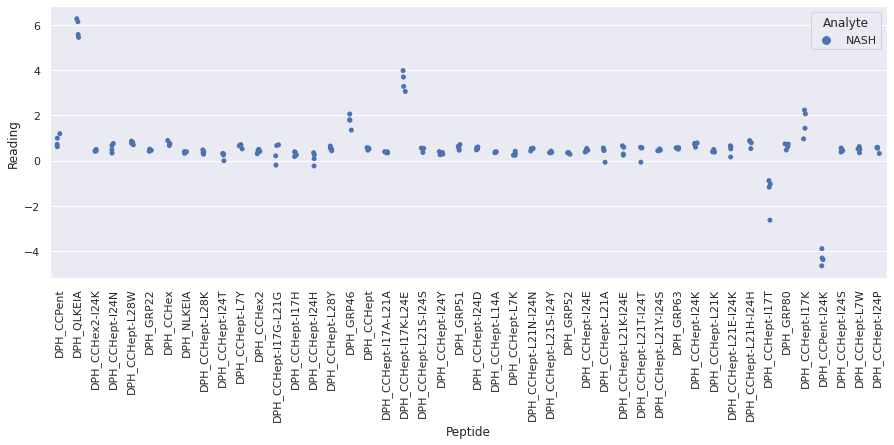

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR2_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR2_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteenR2_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

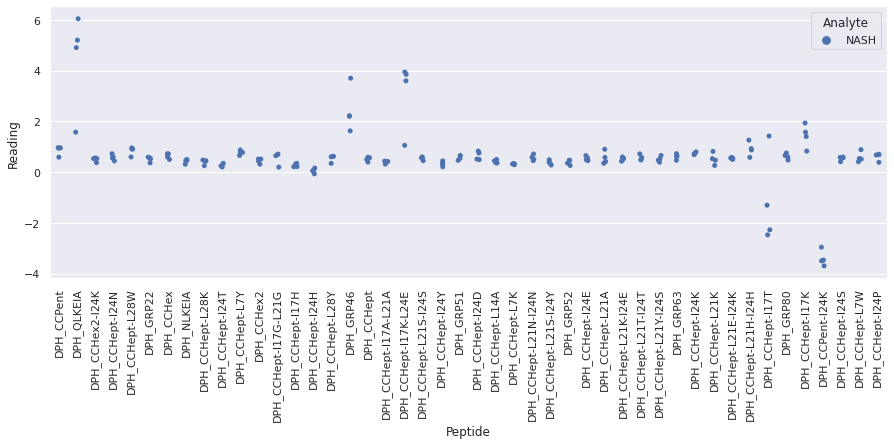

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteenR3_re

<Figure size 720x720 with 0 Axes>

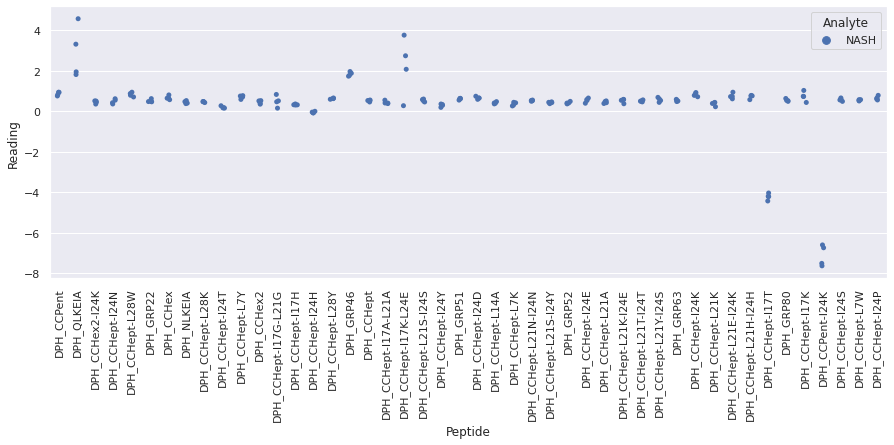

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteenR4_re

<Figure size 720x720 with 0 Axes>

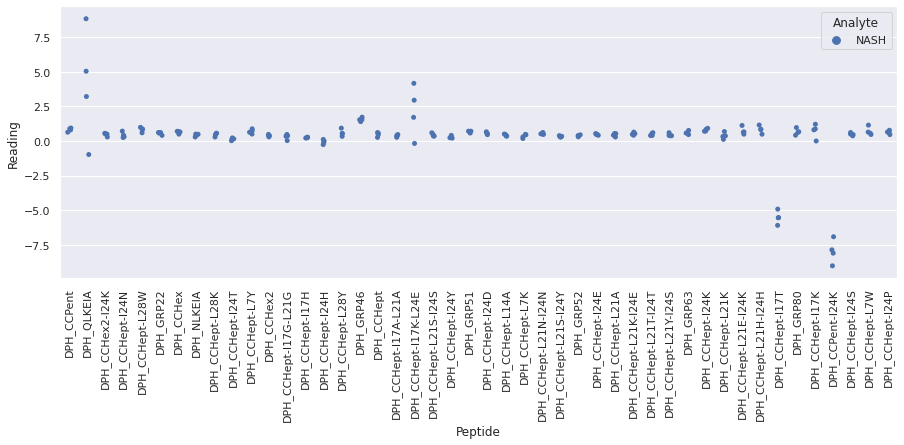

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR1_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR1_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fiveR1_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

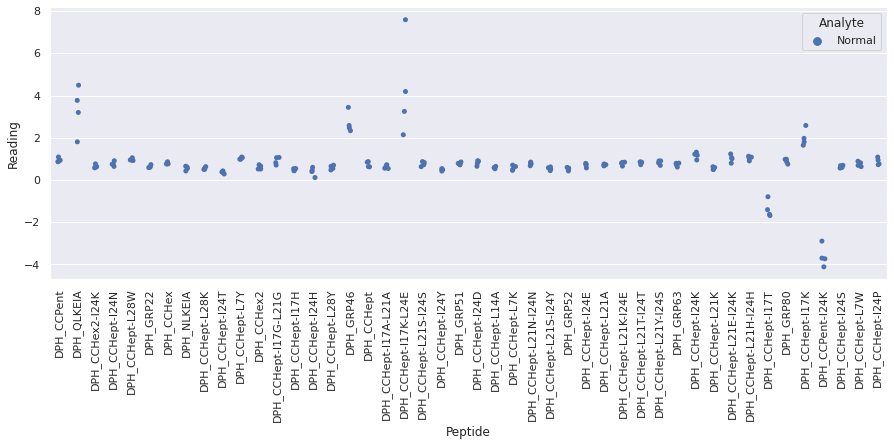

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR2_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR2_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fiveR2_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

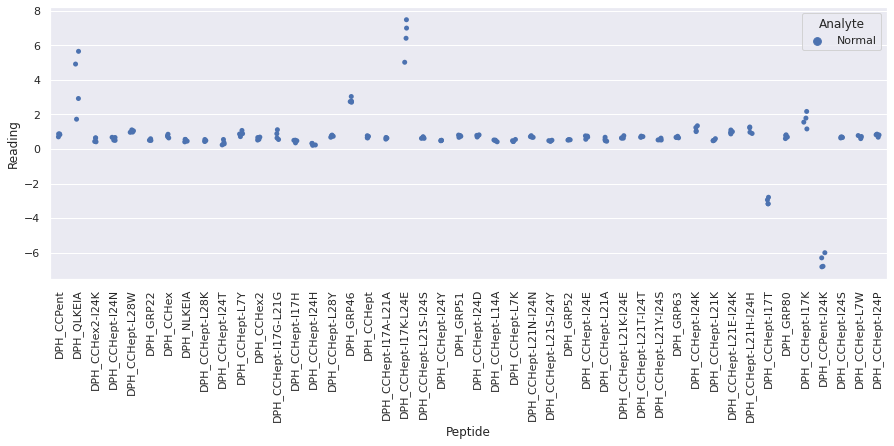

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fiveR3_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

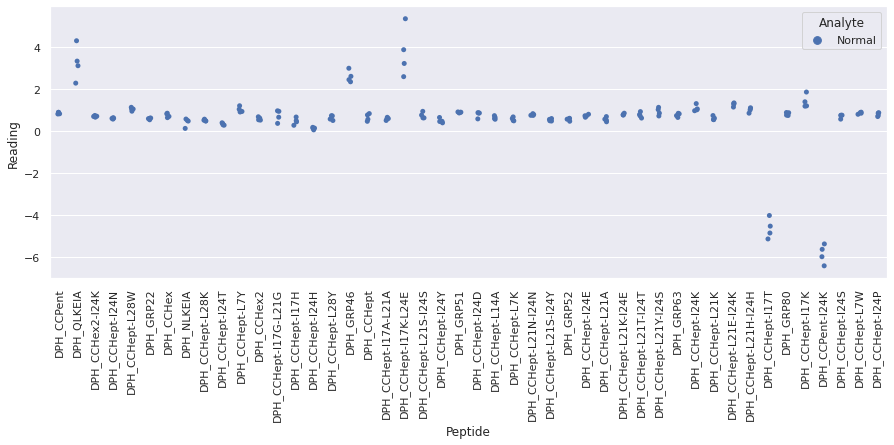

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fiveR

<Figure size 720x720 with 0 Axes>

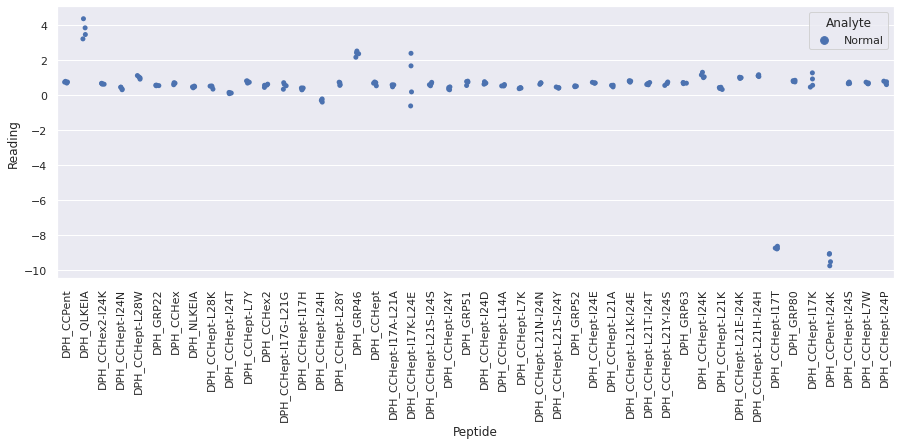

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR1_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR1_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyR1_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

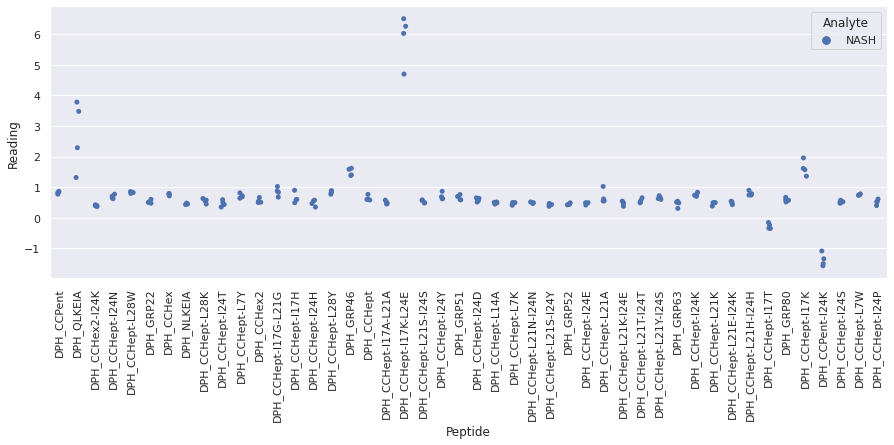

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR2_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR2_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyR2_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

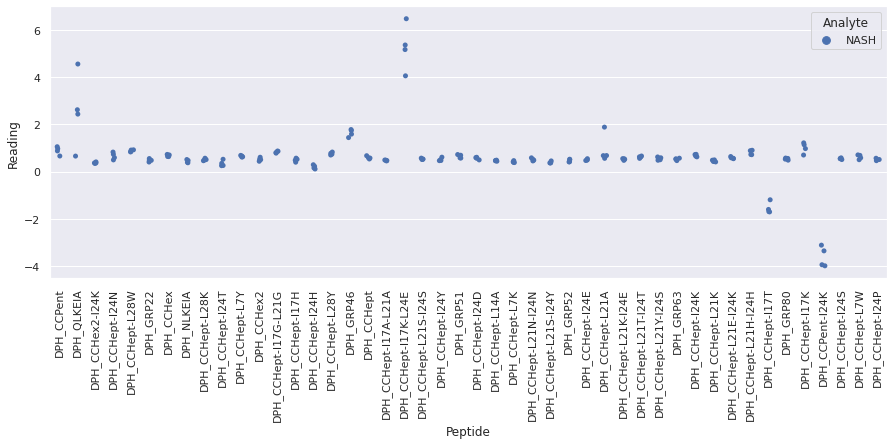

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR3_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR3_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyR3_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

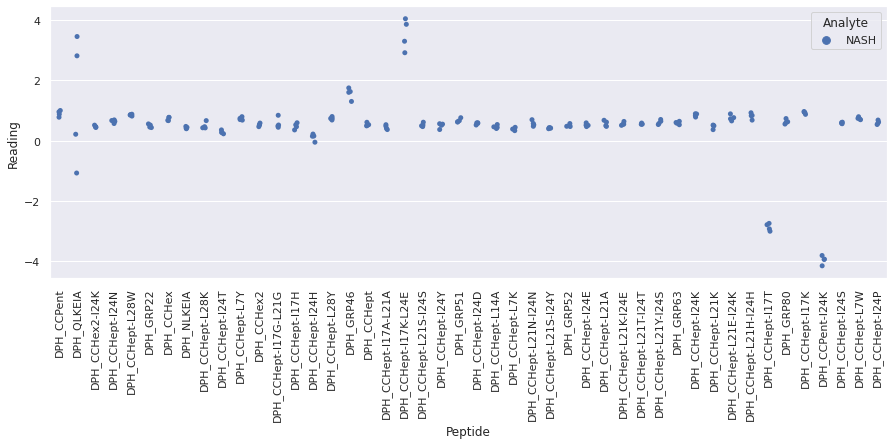

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K +

<Figure size 720x720 with 0 Axes>

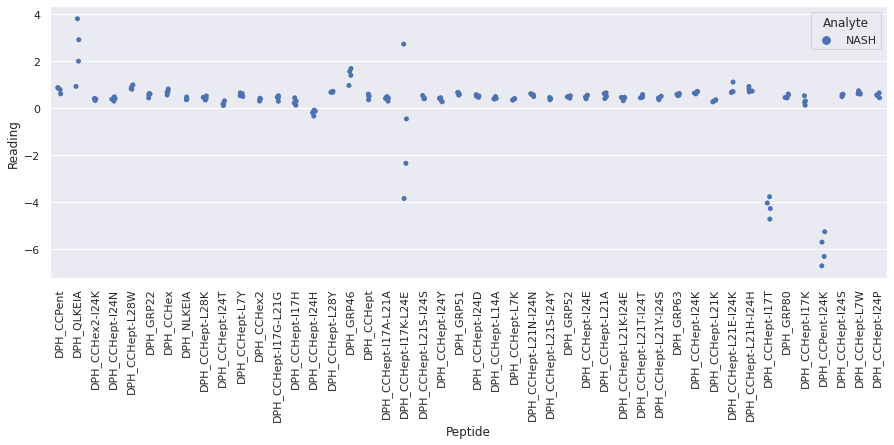

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR1_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR1_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sixR1_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

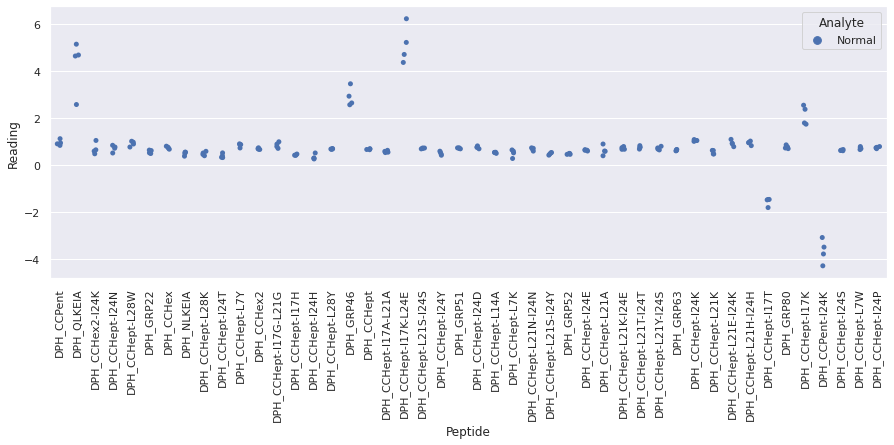

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR2_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR2_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sixR2_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

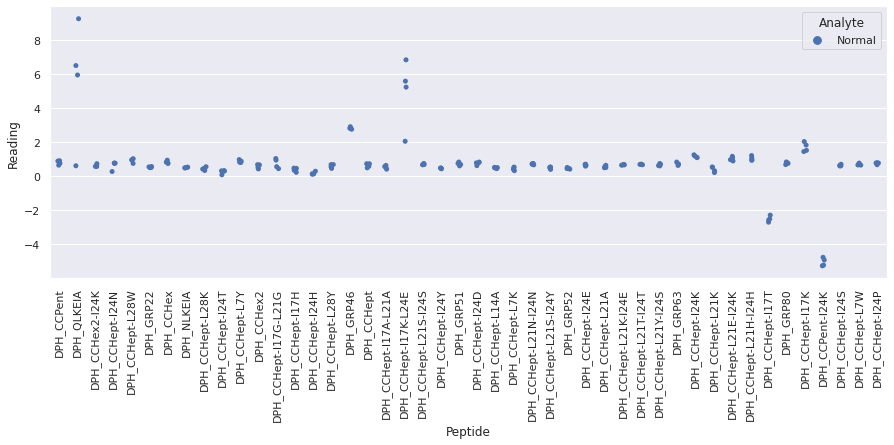

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR3_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR3_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sixR3_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

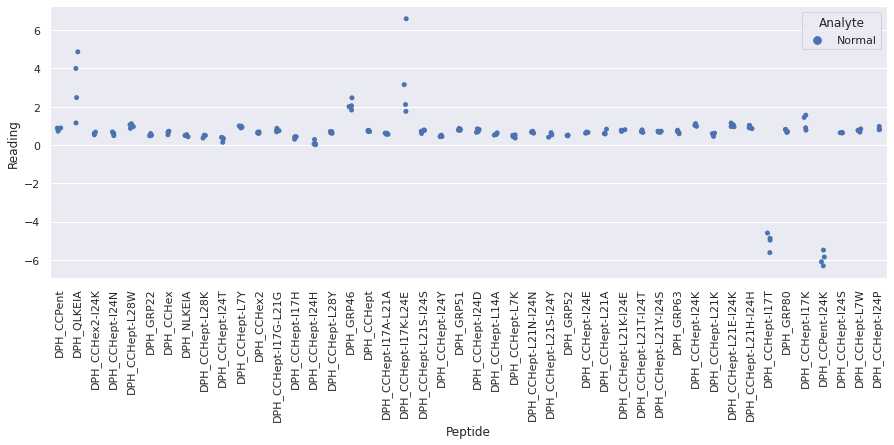

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sixR4_re

<Figure size 720x720 with 0 Axes>

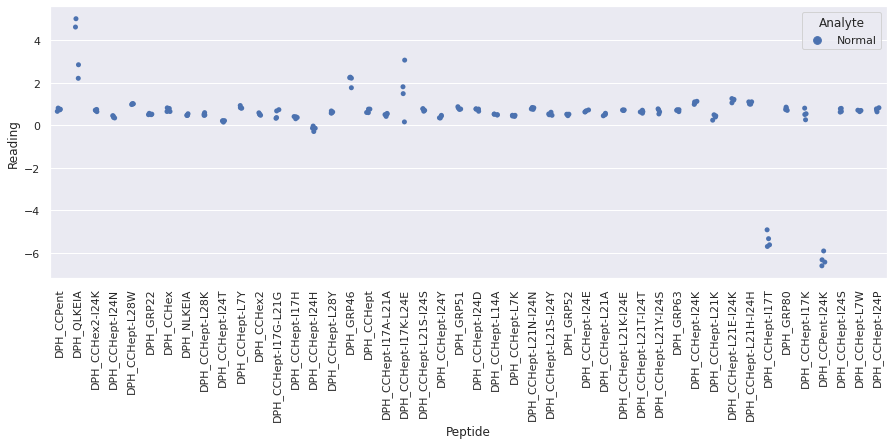

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR1_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR1_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyoneR1_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

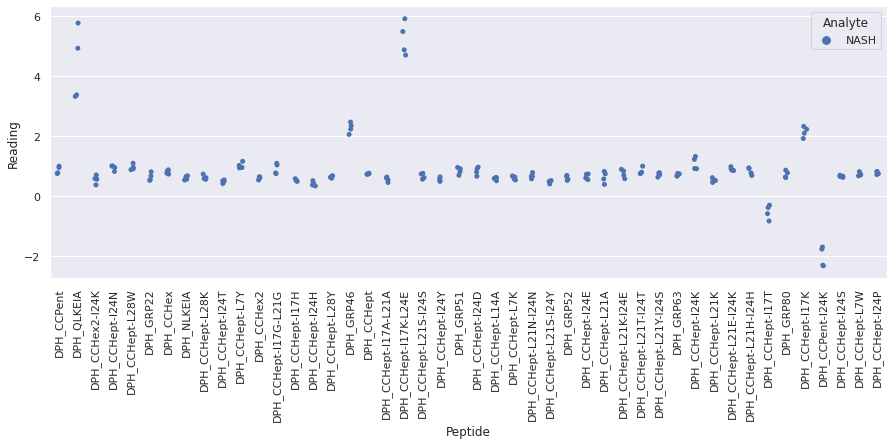

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR2_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR2_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyoneR2_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

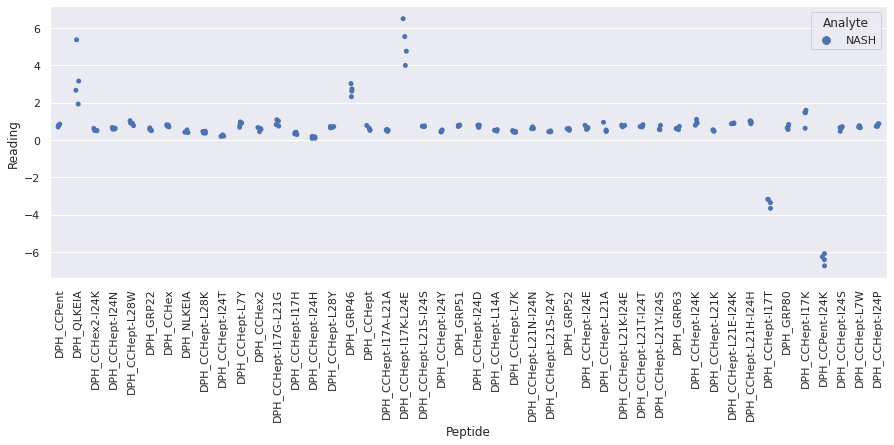

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyoneR3_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

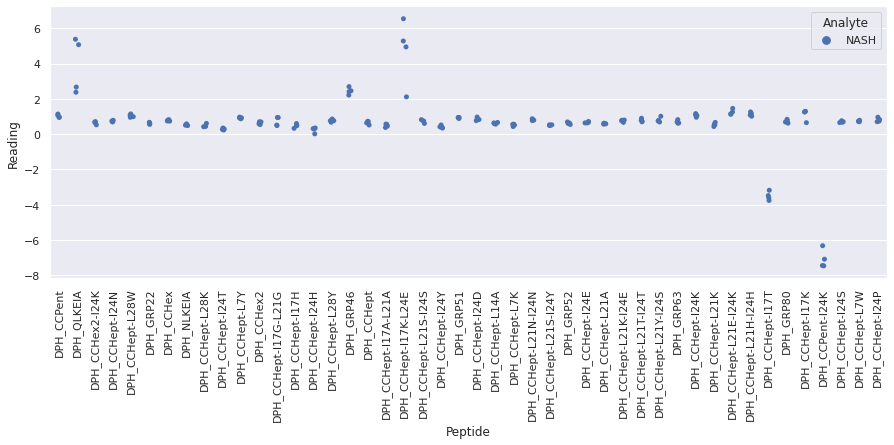

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyoneR

<Figure size 720x720 with 0 Axes>

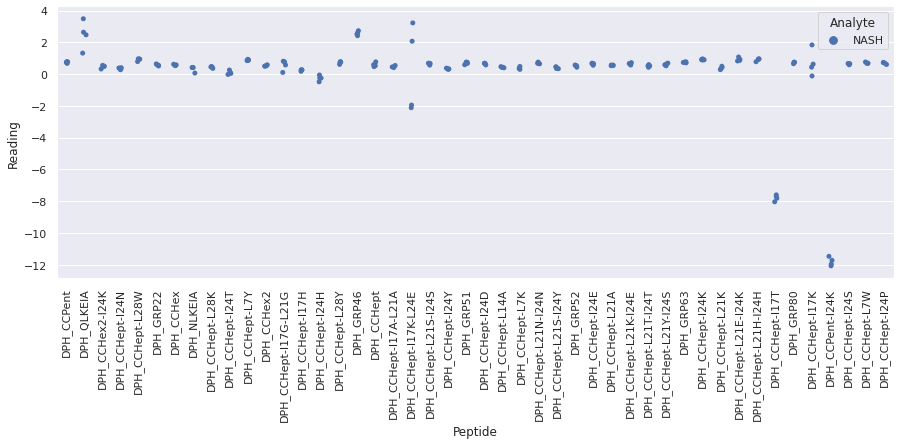

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR1_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR1_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sevenR1_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

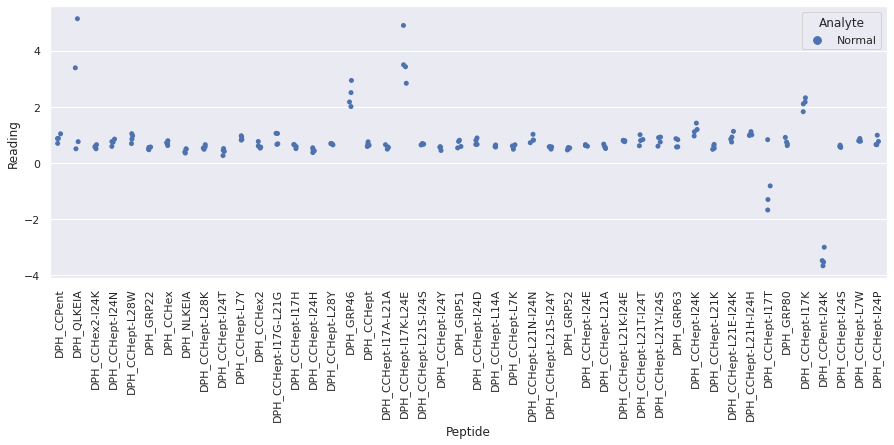

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR2_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR2_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sevenR2_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

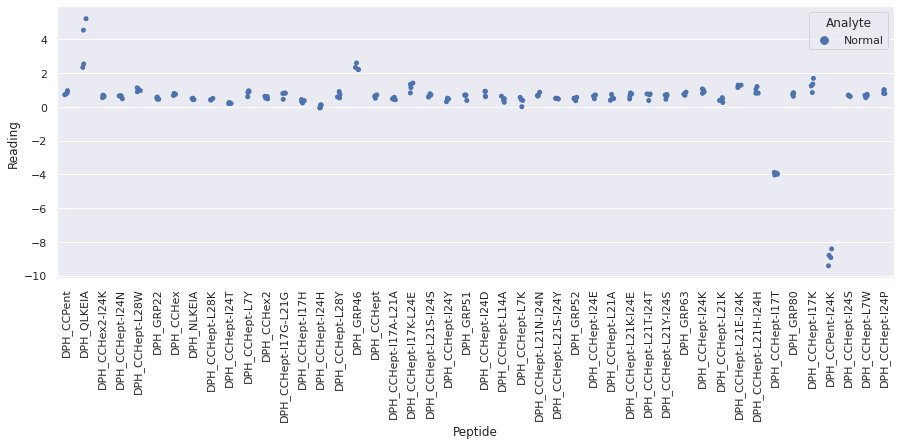

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_se

<Figure size 720x720 with 0 Axes>

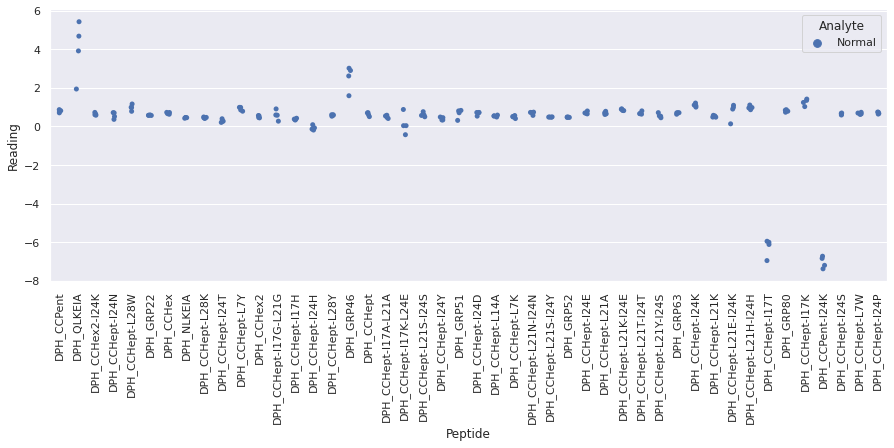

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_se

<Figure size 720x720 with 0 Axes>

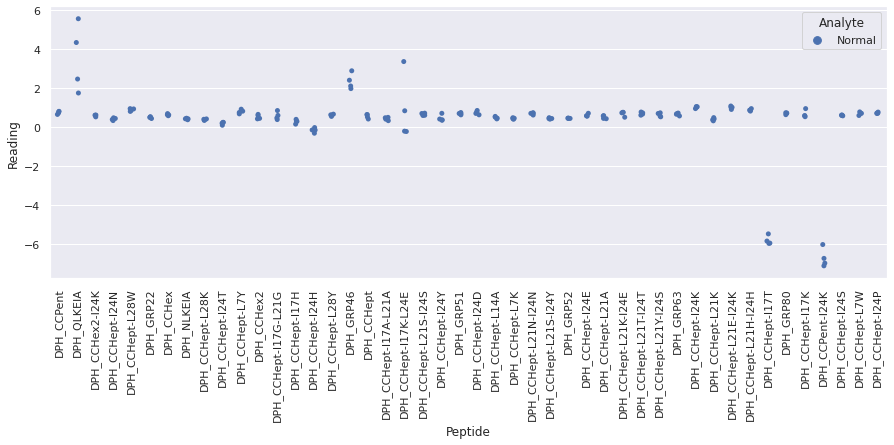

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR1_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR1_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwoR1_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

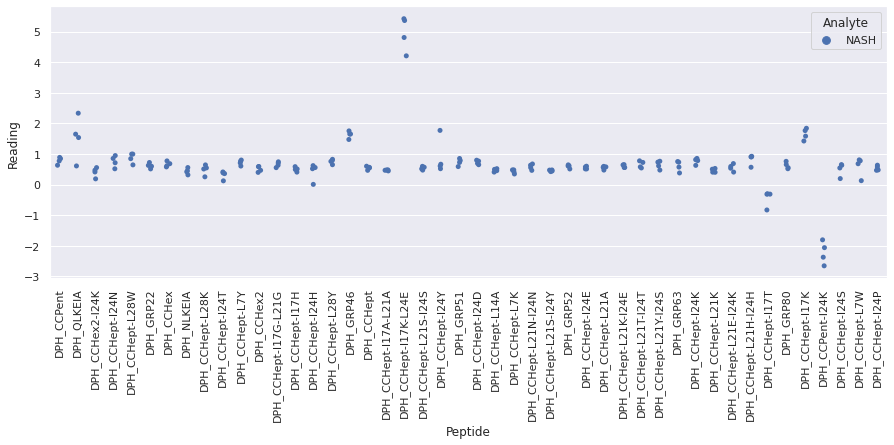

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwoR2_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

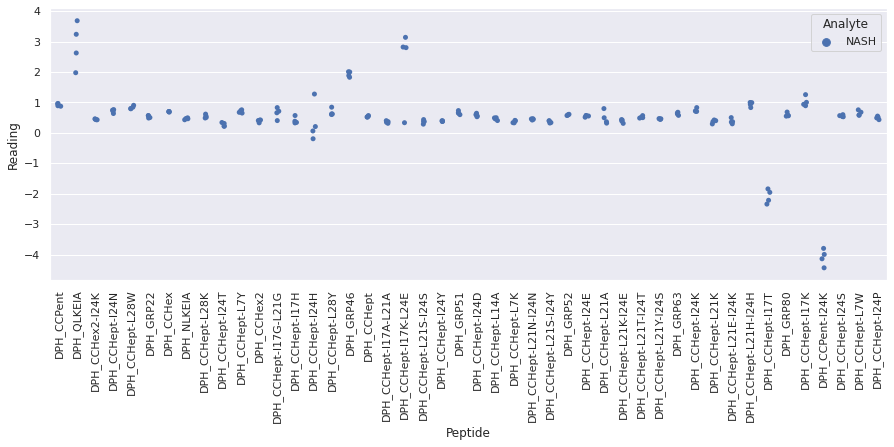

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR3_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR3_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwoR3_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

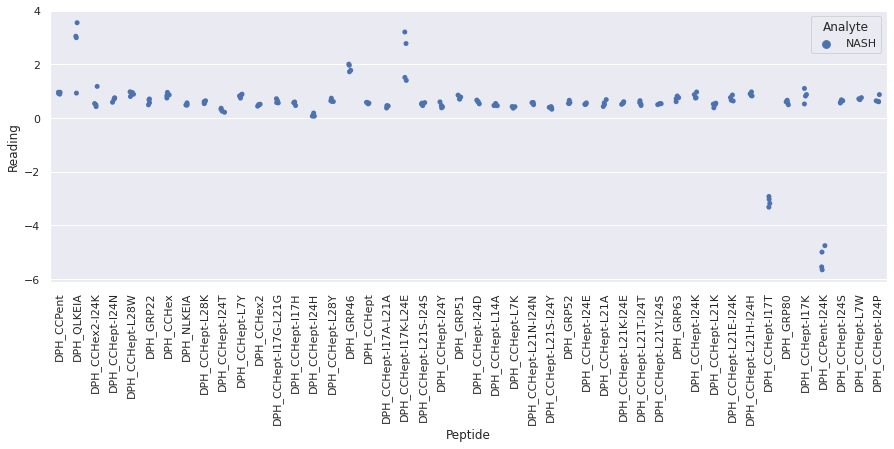

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPe

<Figure size 720x720 with 0 Axes>

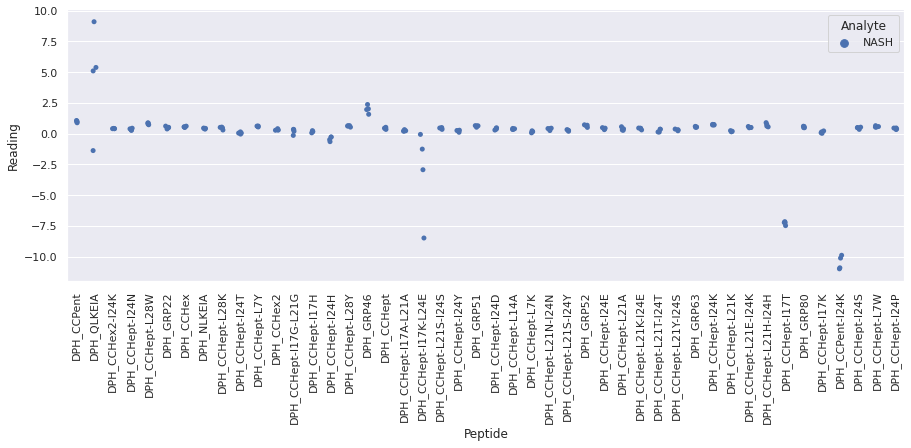

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR1_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR1_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eightR1_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

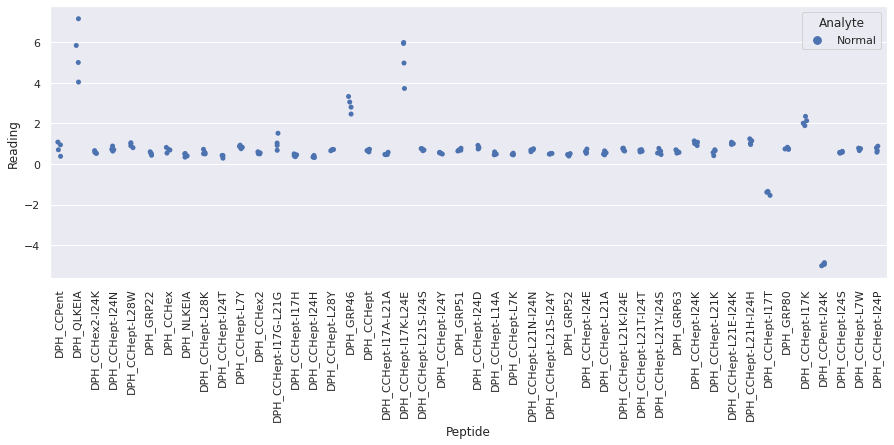

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_ei

<Figure size 720x720 with 0 Axes>

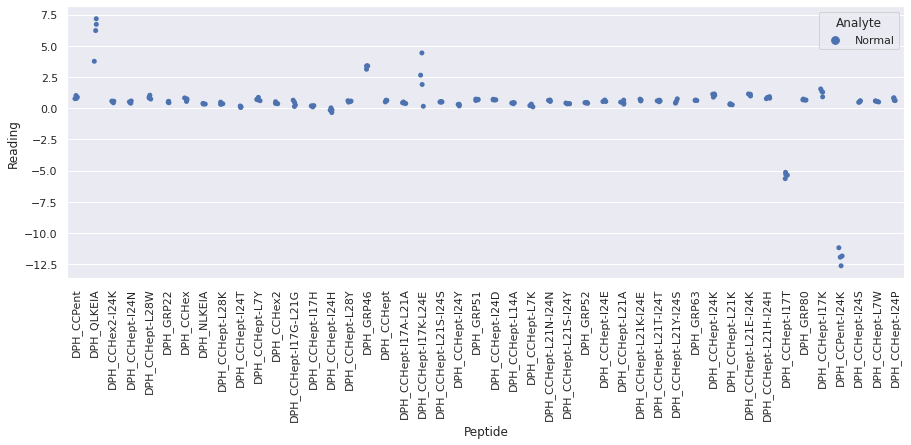

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR3_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR3_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eightR3_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

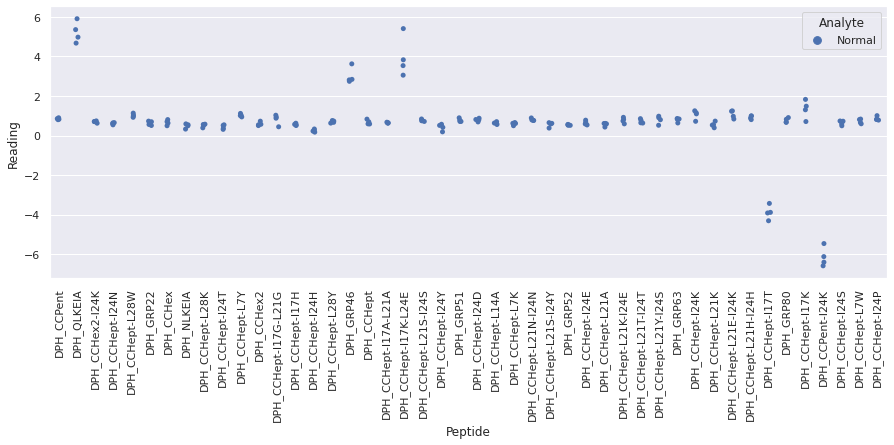

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_ei

<Figure size 720x720 with 0 Axes>

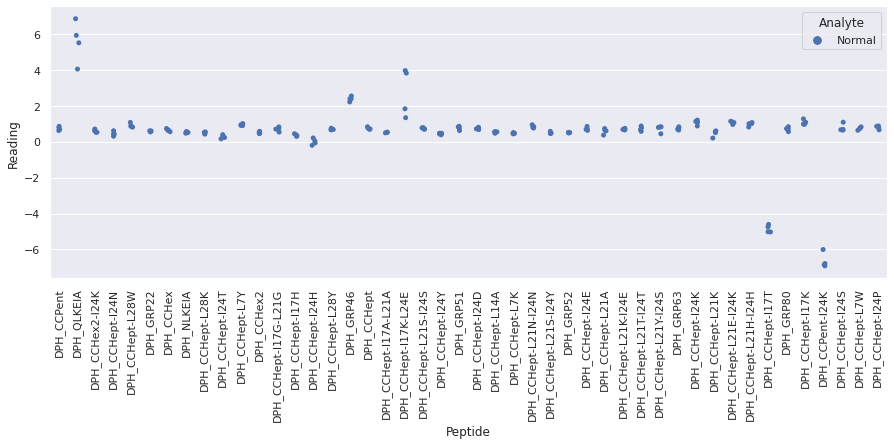

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR1_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR1_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentythreeR1_repeat_9 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

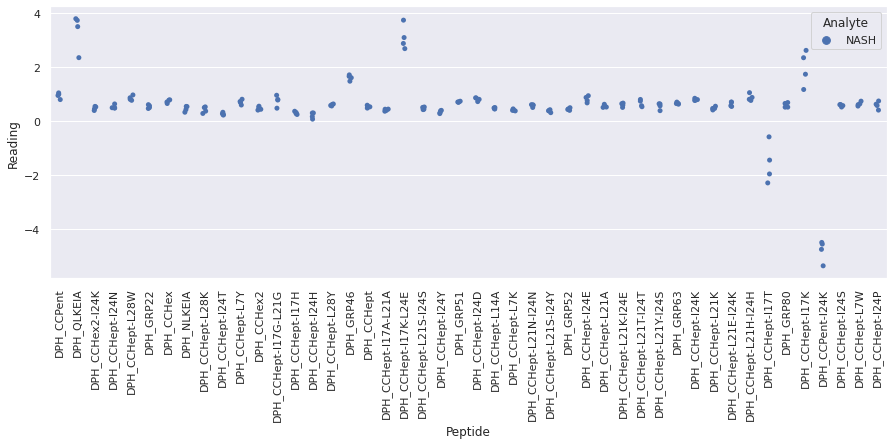

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentythreeR2_repeat_9 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

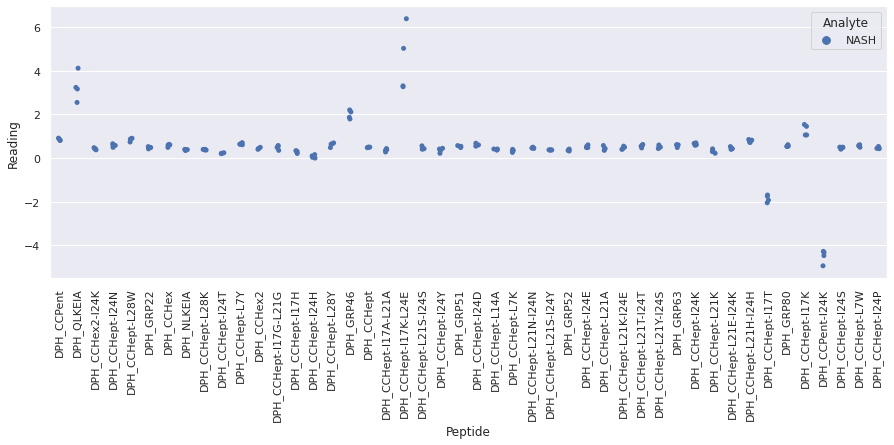

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twen

<Figure size 720x720 with 0 Axes>

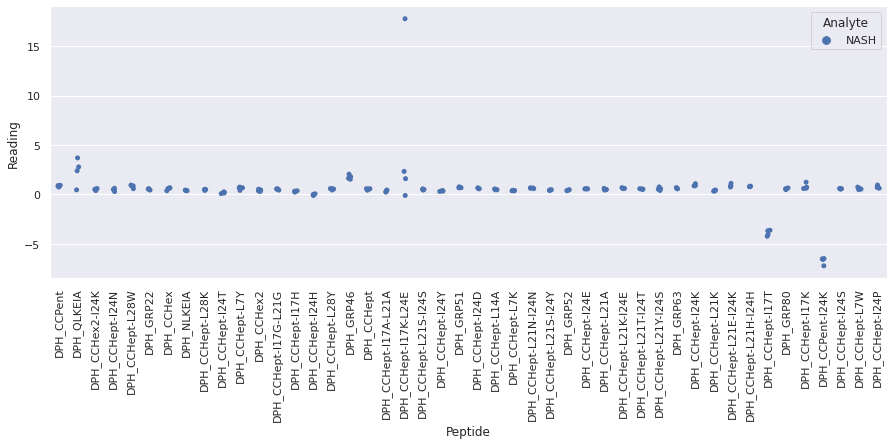

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DP

<Figure size 720x720 with 0 Axes>

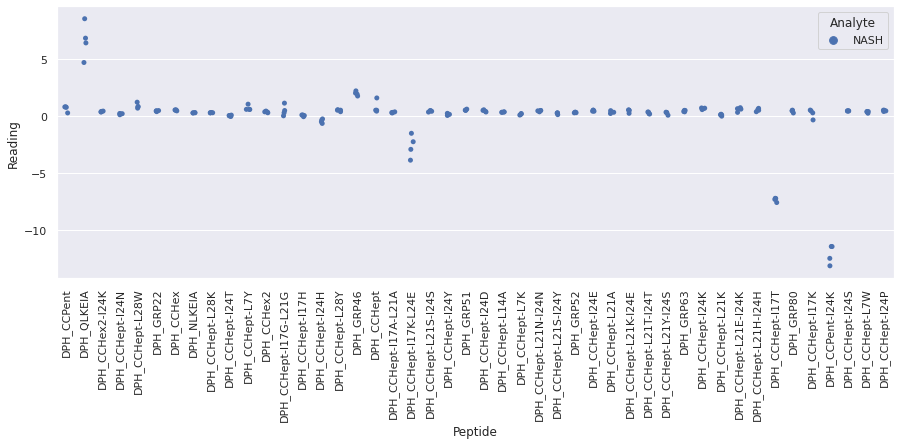

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR1_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR1_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_nineR1_repeat_9 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

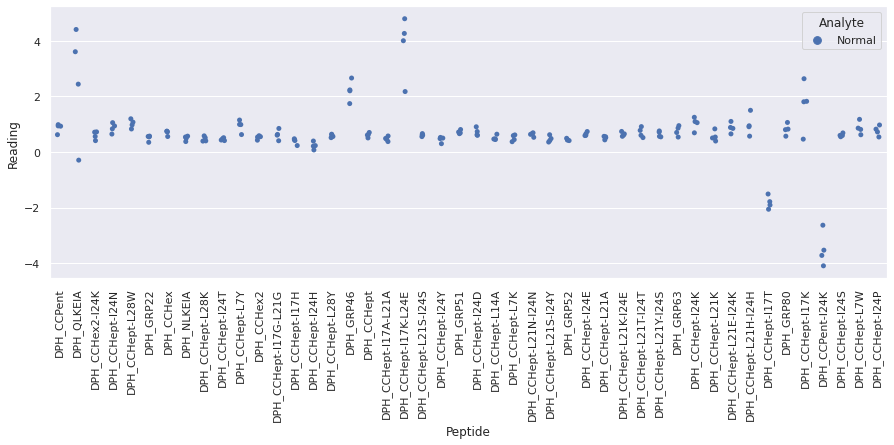

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_nineR

<Figure size 720x720 with 0 Axes>

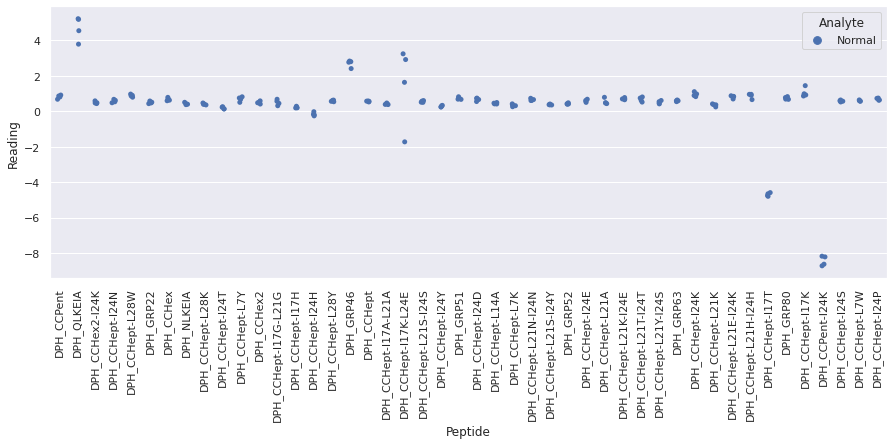

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_nineR

<Figure size 720x720 with 0 Axes>

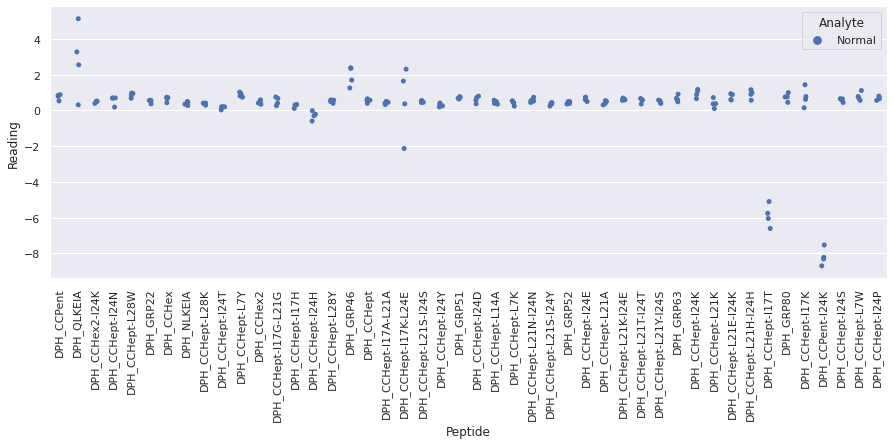

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH

<Figure size 720x720 with 0 Axes>

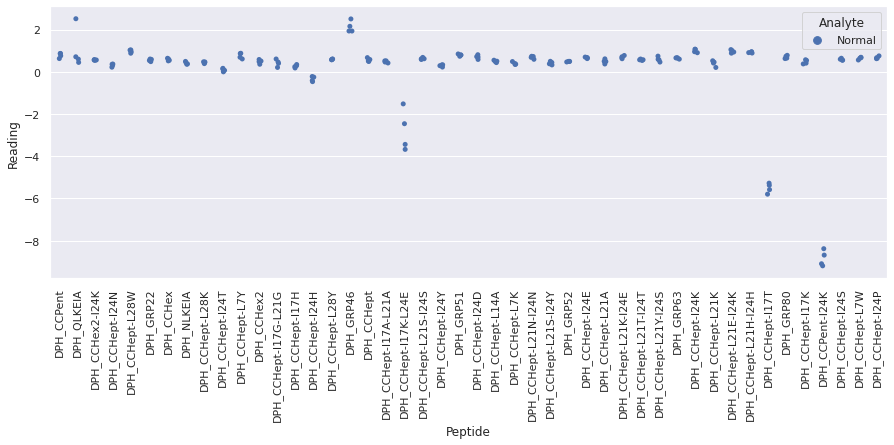

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR1_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR1_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfourR1_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

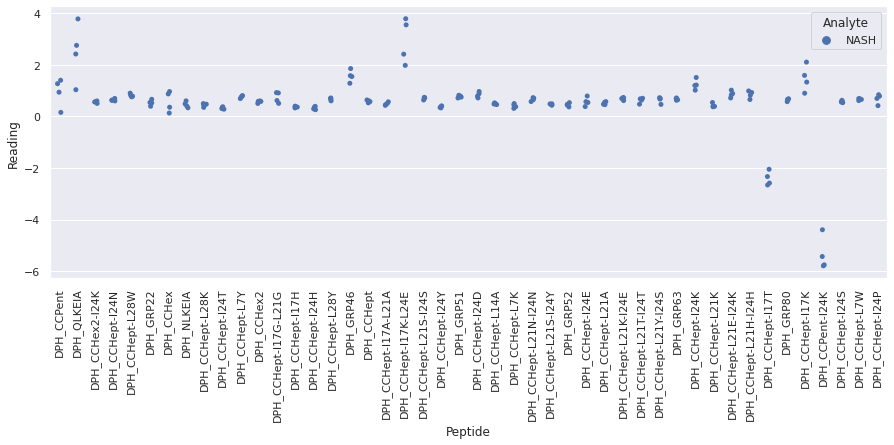

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR2_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR2_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfourR2_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

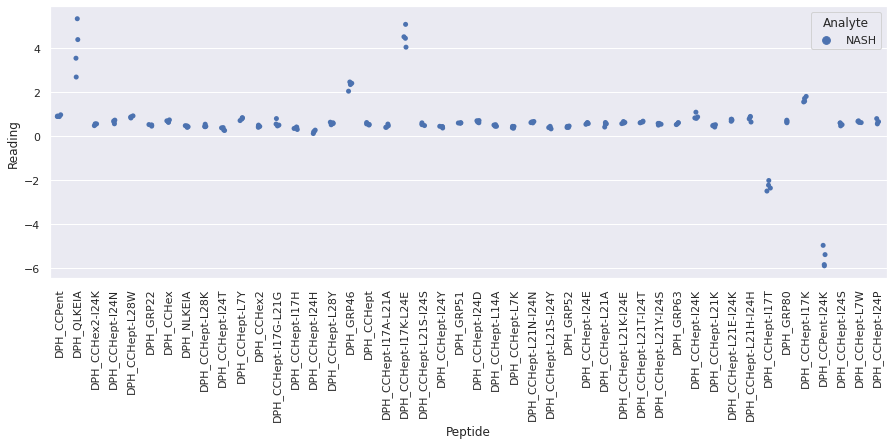

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfourR3_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

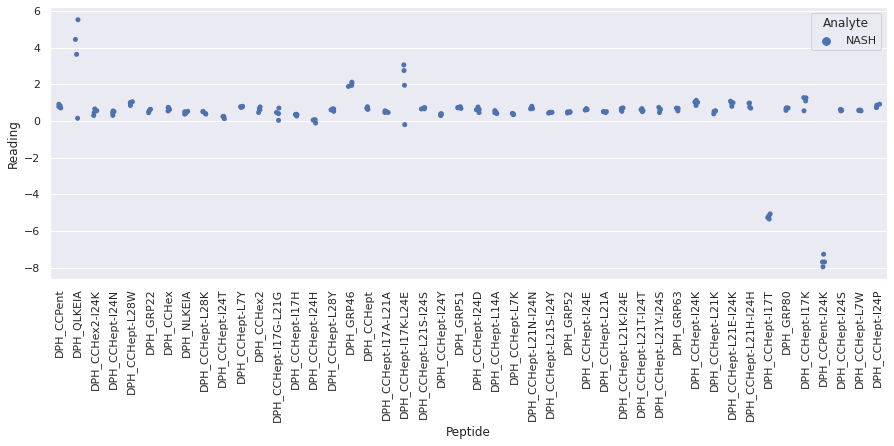

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DP

<Figure size 720x720 with 0 Axes>

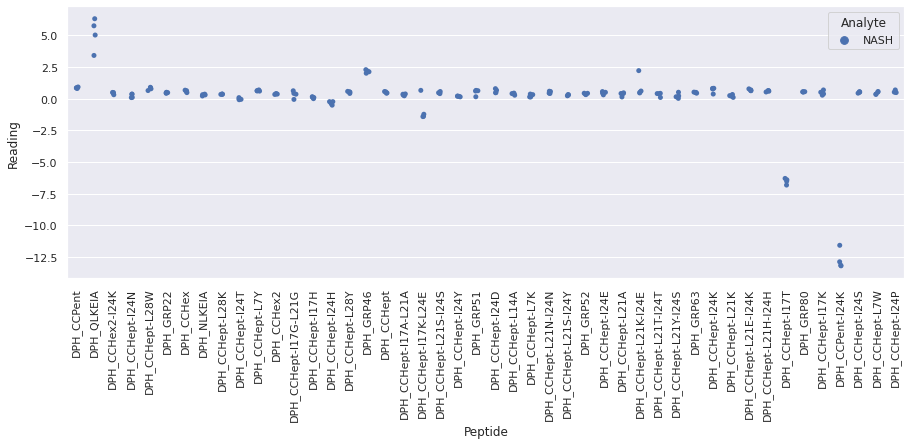

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR1_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR1_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_tenR1_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

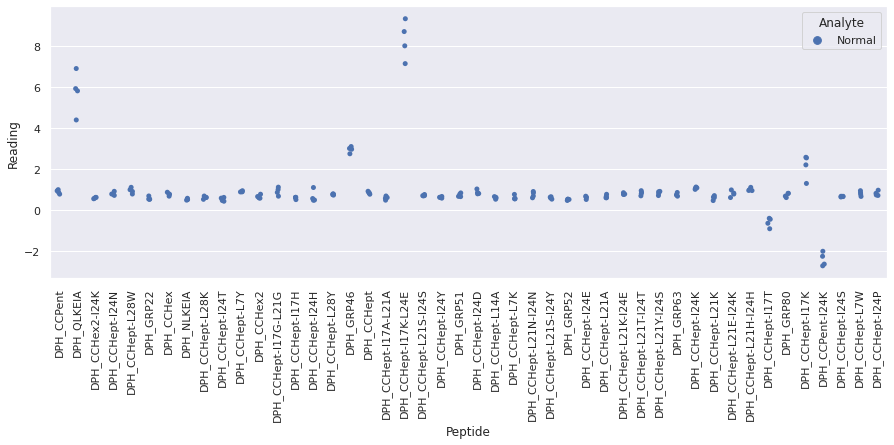

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR2_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR2_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_tenR2_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

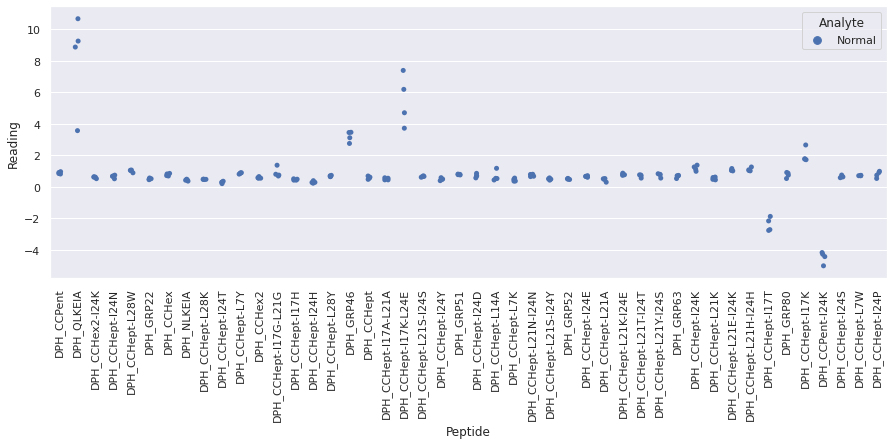

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_tenR3

<Figure size 720x720 with 0 Axes>

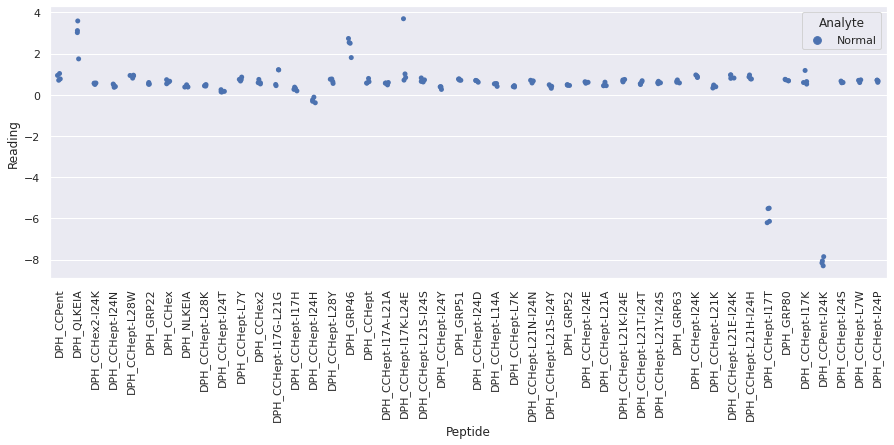

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_tenR4

<Figure size 720x720 with 0 Axes>

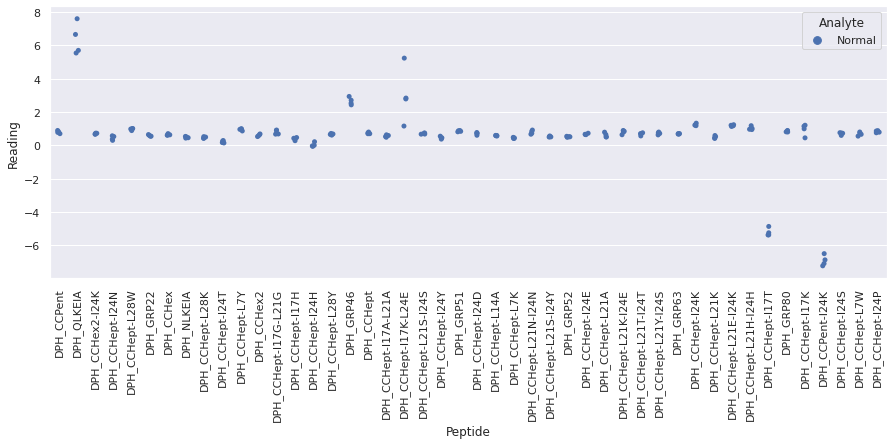

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR1_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR1_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfiveR1_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

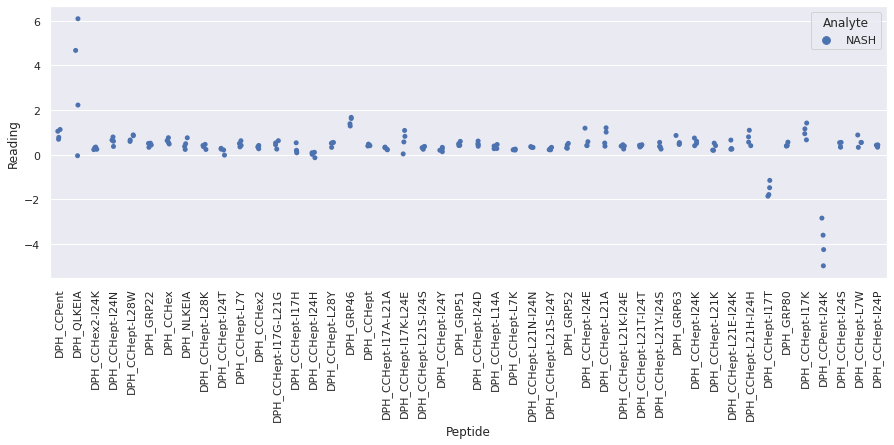

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR2_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR2_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfiveR2_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

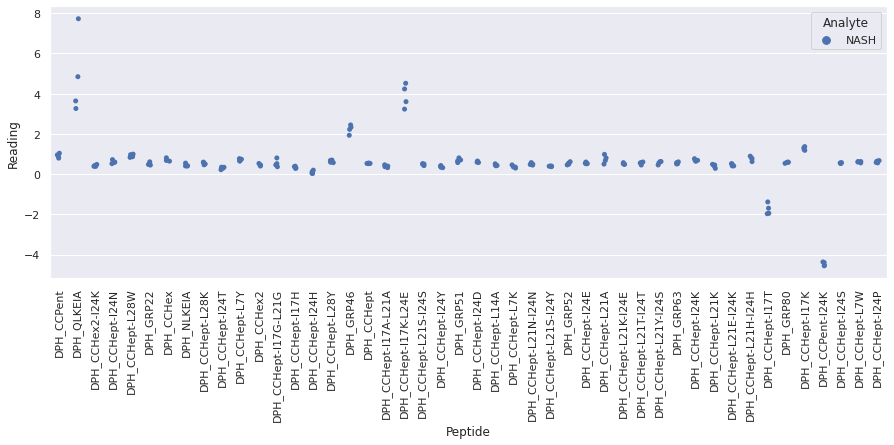

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twen

<Figure size 720x720 with 0 Axes>

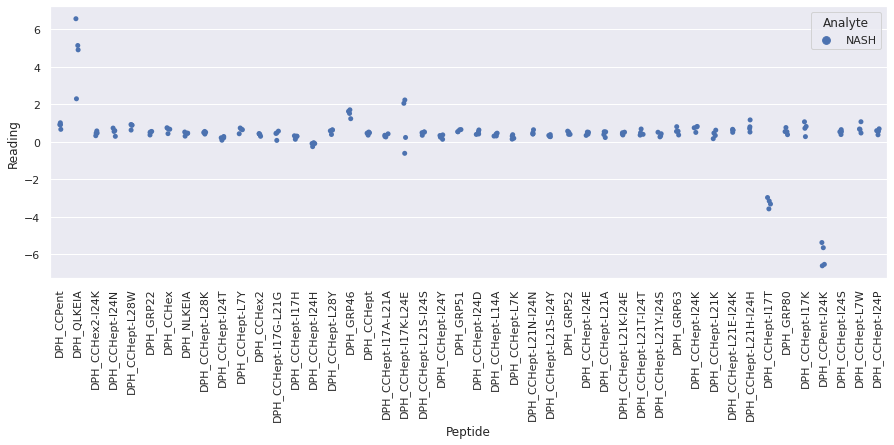

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twen

<Figure size 720x720 with 0 Axes>

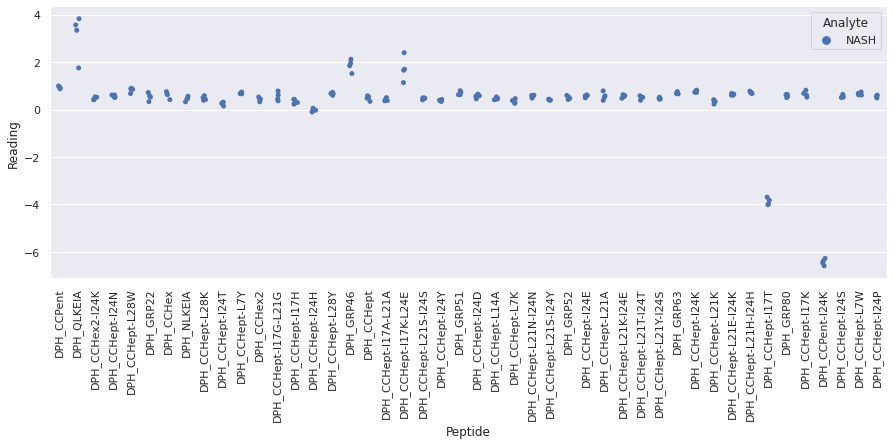

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR1_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR1_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_elevenR1_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

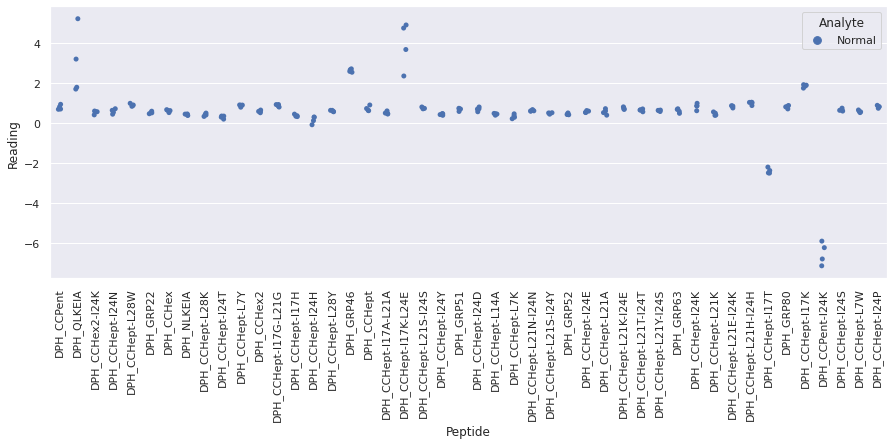

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR2_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR2_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_elevenR2_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

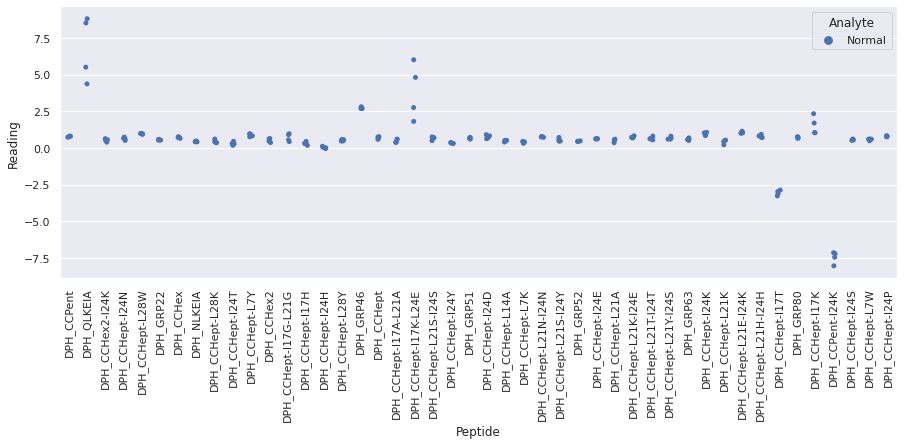

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Nor

<Figure size 720x720 with 0 Axes>

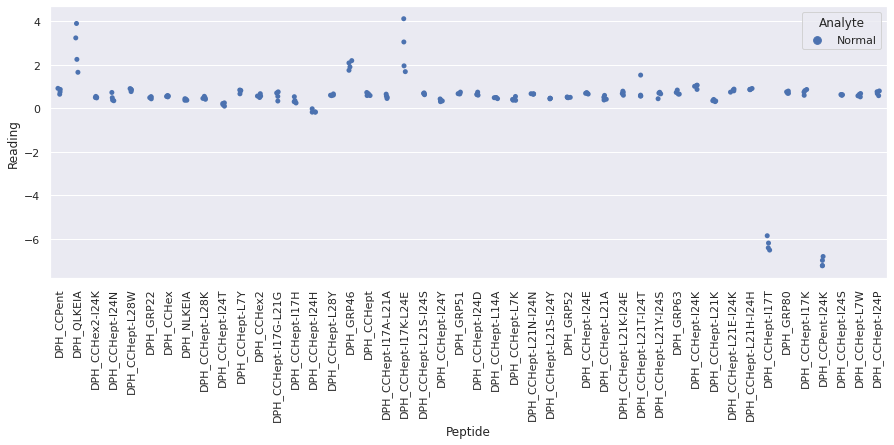

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_elevenR4_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

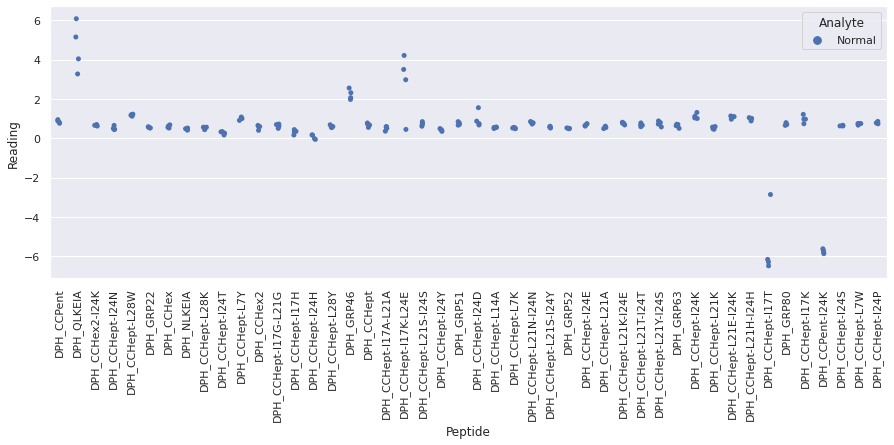

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR1_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR1_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysixR1_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

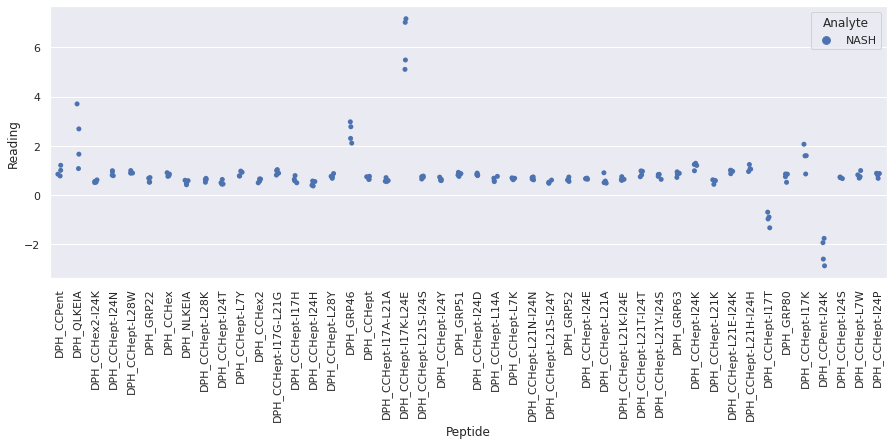

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR2_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR2_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysixR2_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

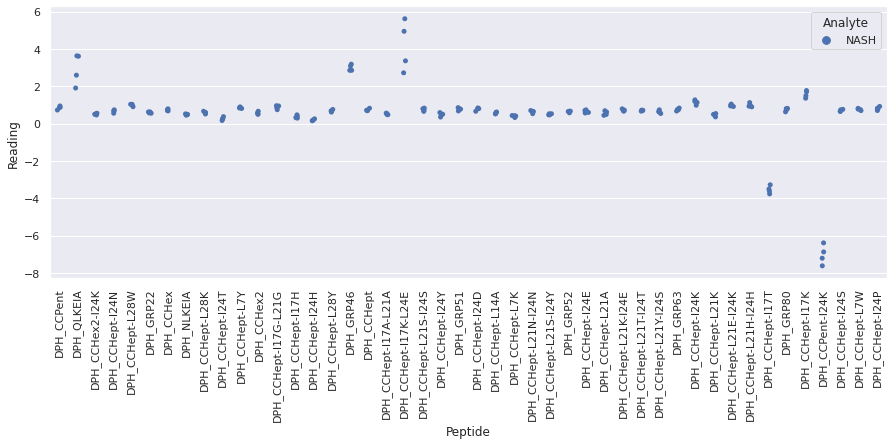

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentys

<Figure size 720x720 with 0 Axes>

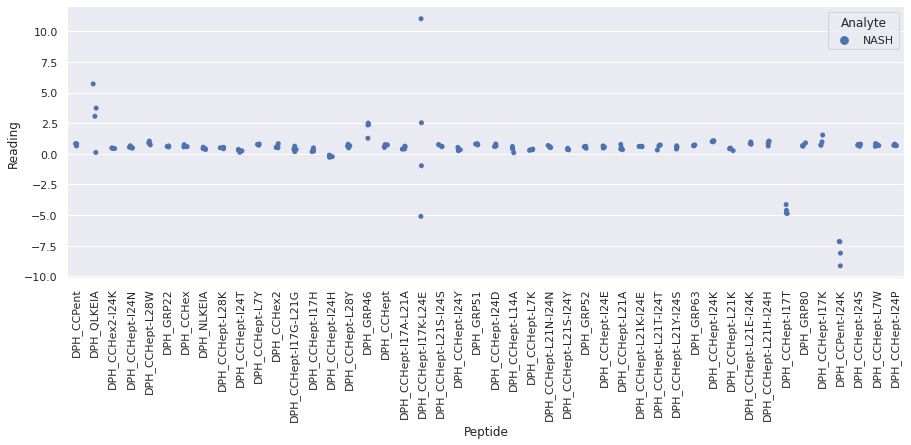

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR4_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR4_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysixR4_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

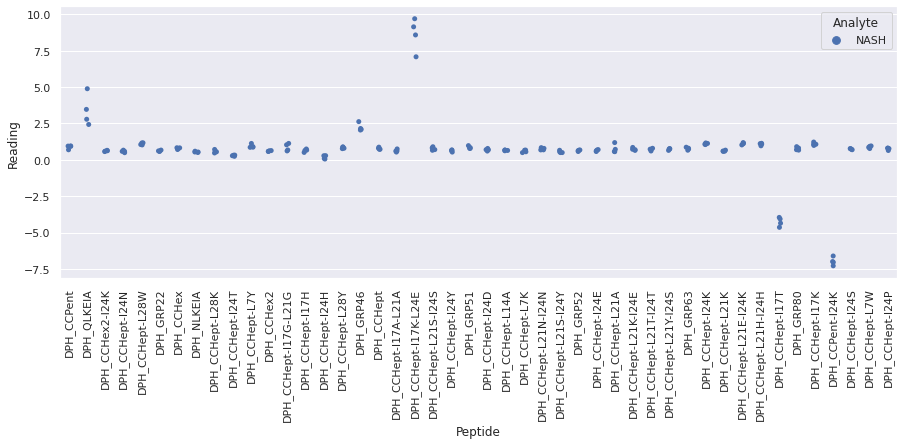

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR1_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR1_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelveR1_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

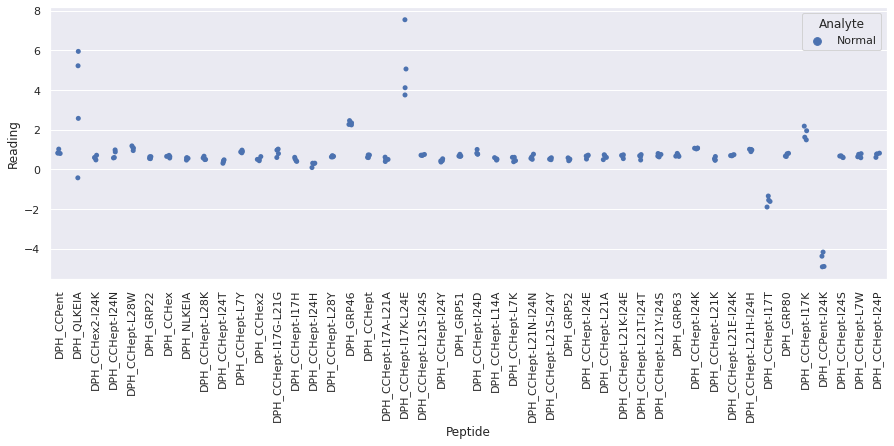

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR2_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR2_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelveR2_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

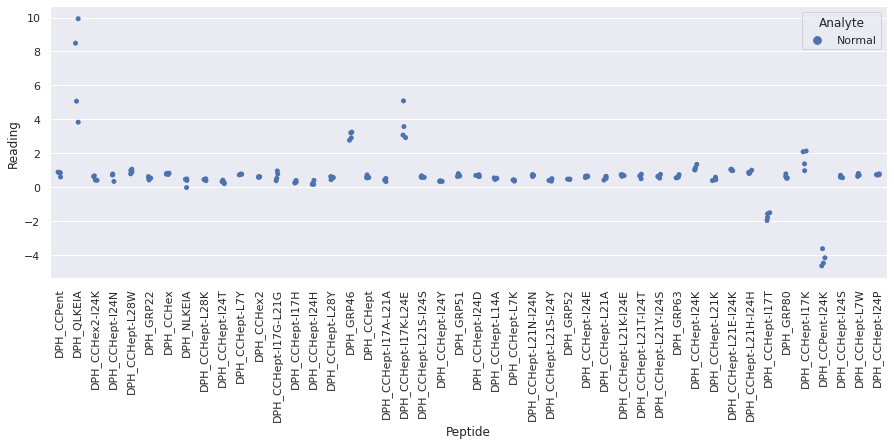

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Nor

<Figure size 720x720 with 0 Axes>

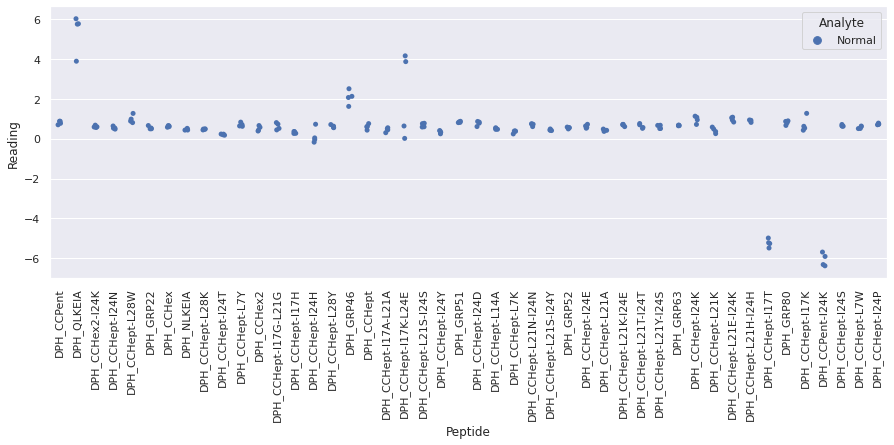

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR4_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR4_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelveR4_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

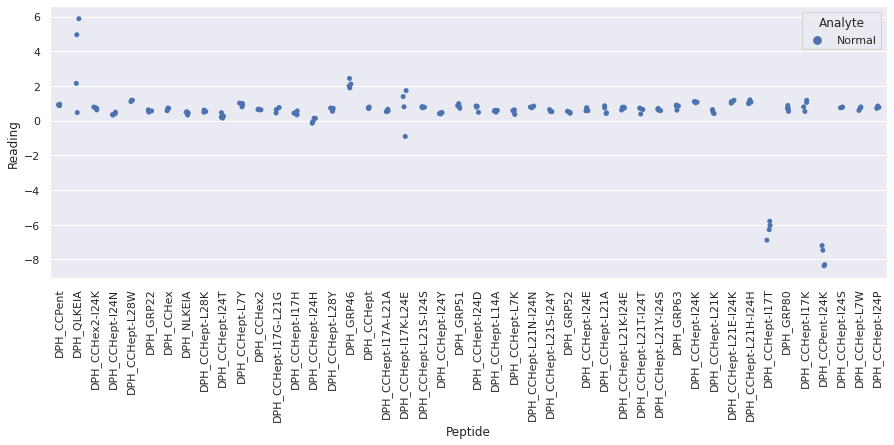

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR1_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR1_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysevenR1_repeat_13 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

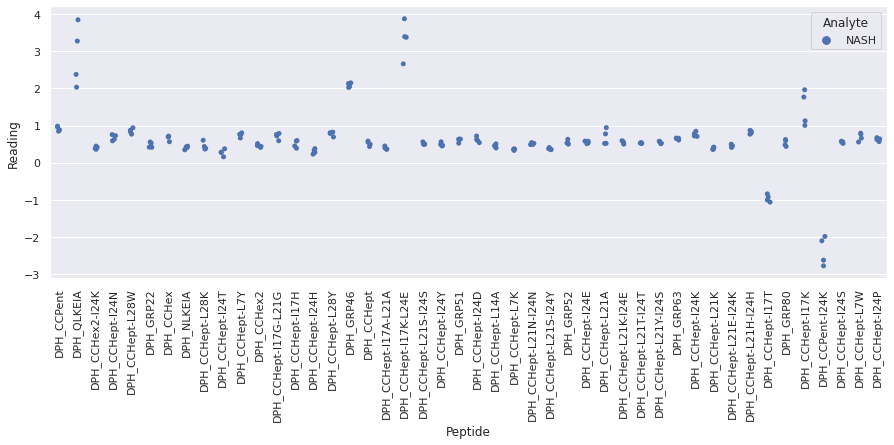

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR2_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR2_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysevenR2_repeat_13 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

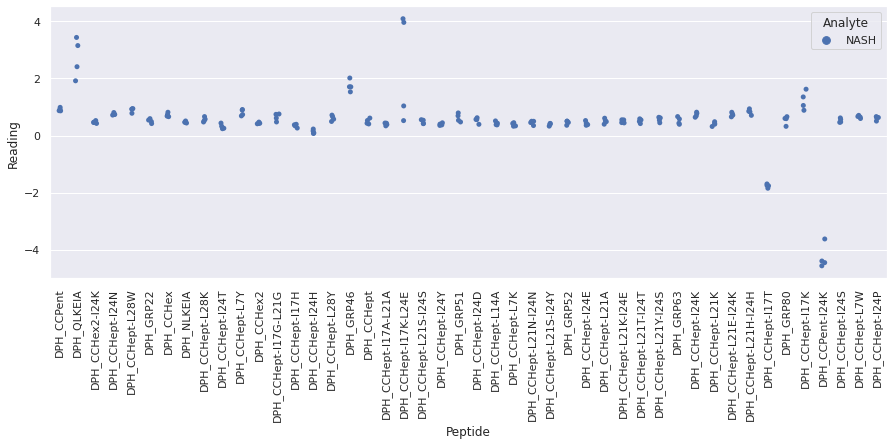

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_t

<Figure size 720x720 with 0 Axes>

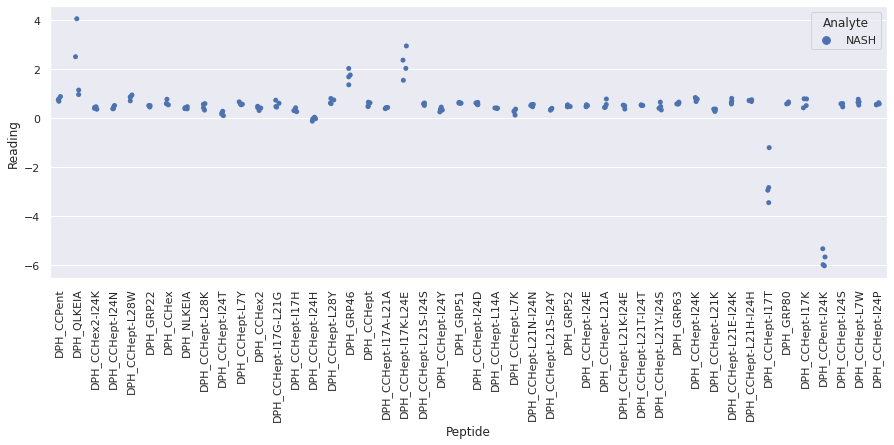

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_t

<Figure size 720x720 with 0 Axes>

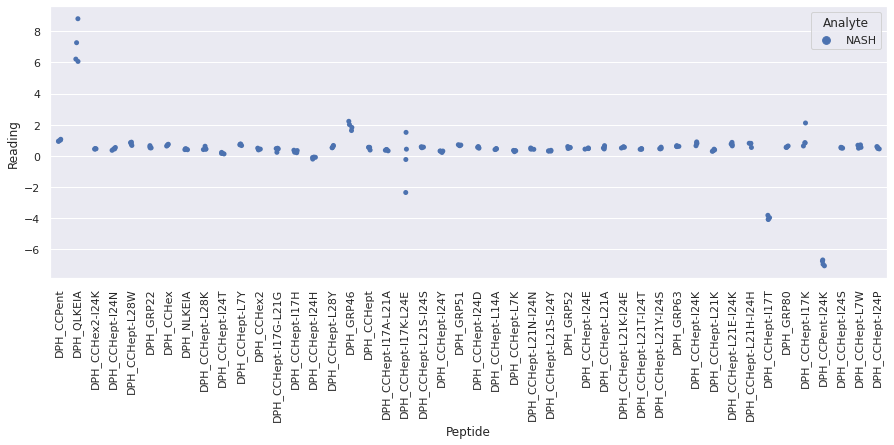

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR1_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR1_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirteenR1_repeat_13 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

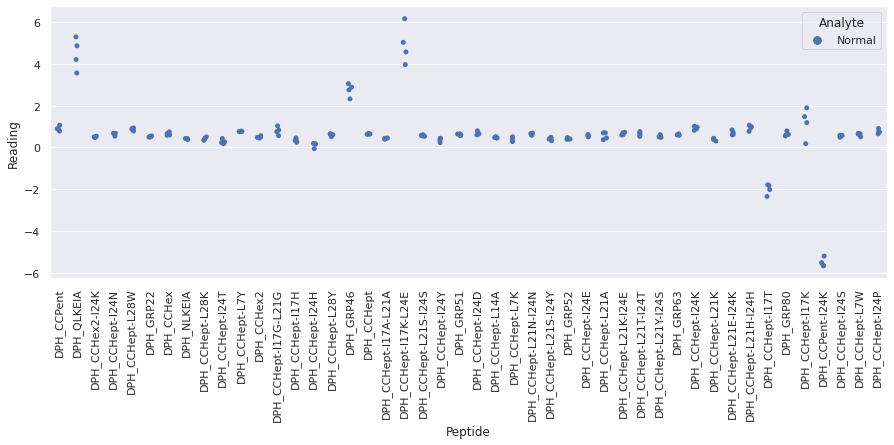

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR2_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR2_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirteenR2_repeat_13 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

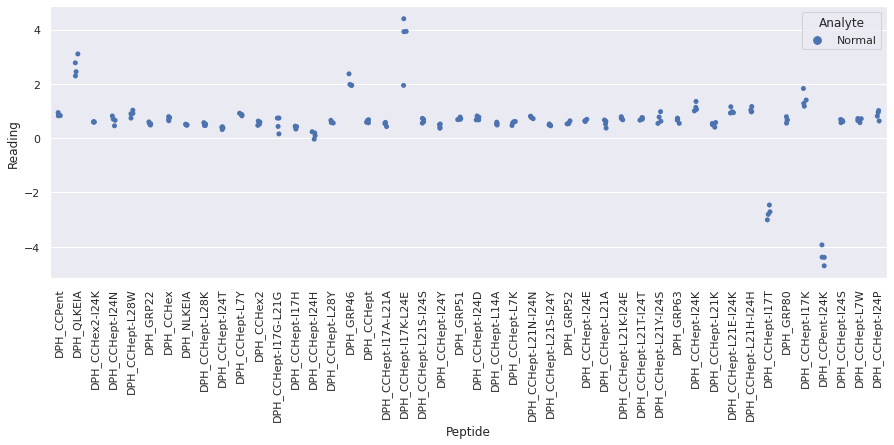

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

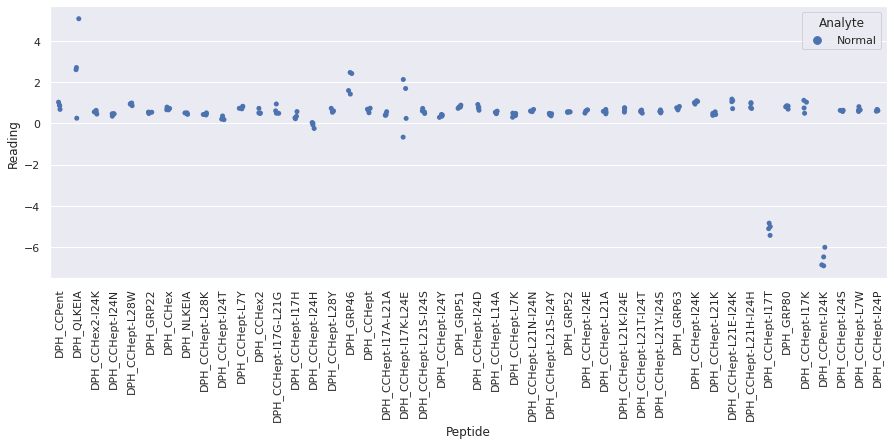

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

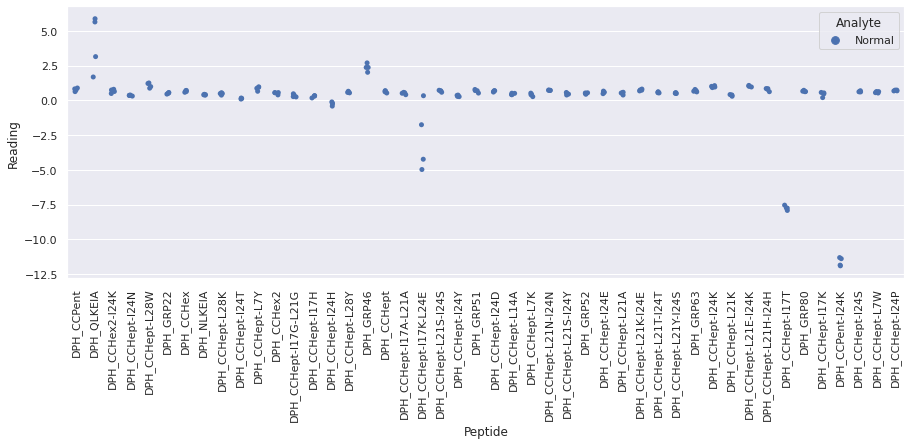

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR1_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR1_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyeightR1_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

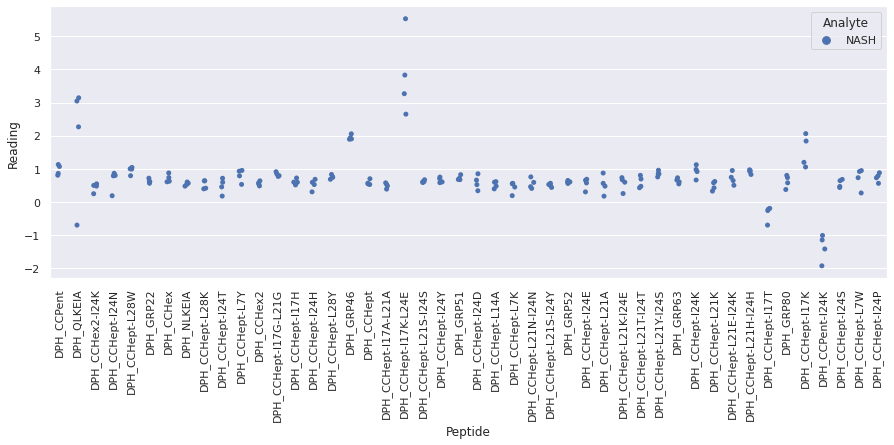

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR2_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR2_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyeightR2_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

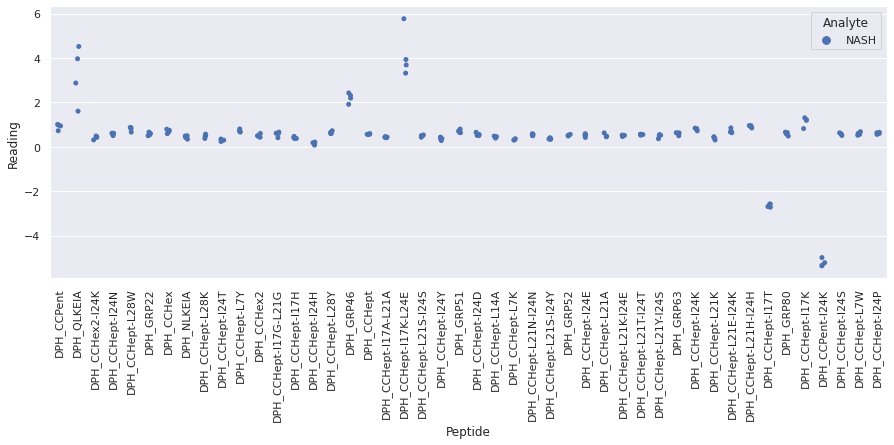

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_t

<Figure size 720x720 with 0 Axes>

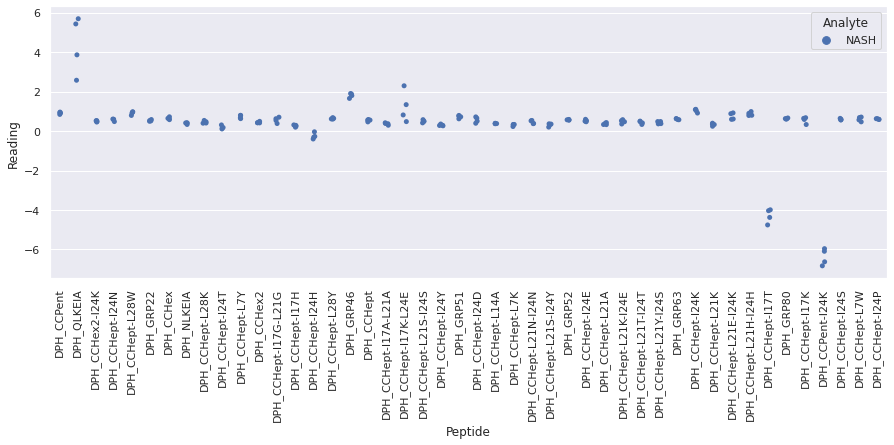

 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH +

<Figure size 720x720 with 0 Axes>

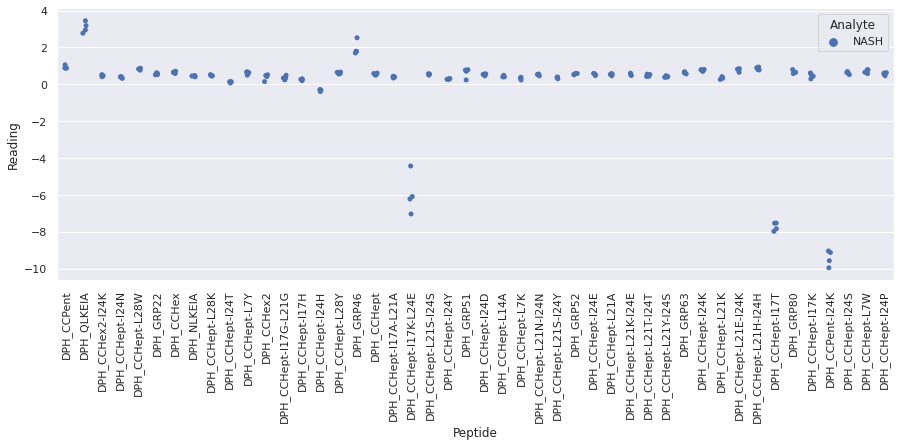

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR1_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR1_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteenR1_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

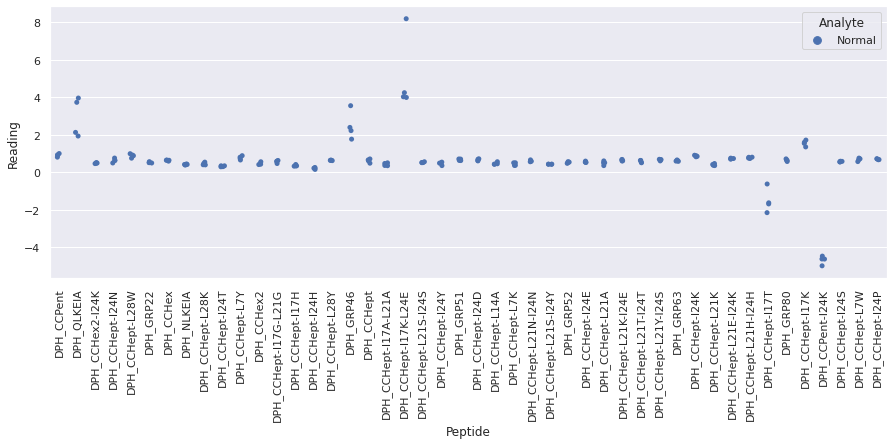

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR2_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR2_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteenR2_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

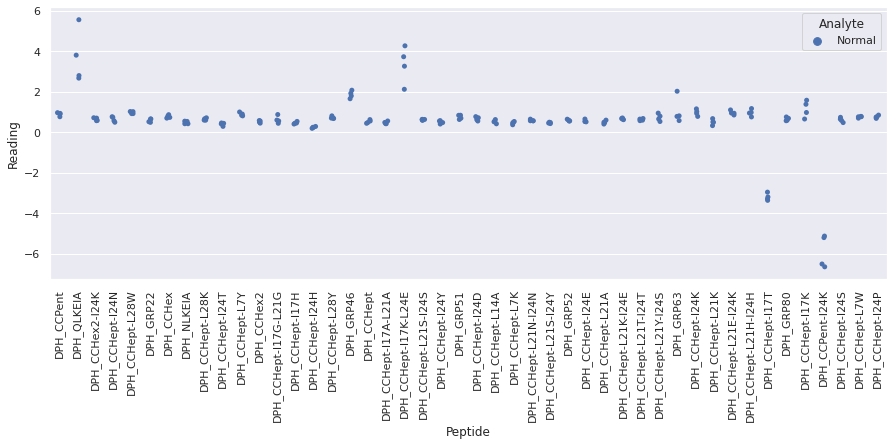

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteenR3_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

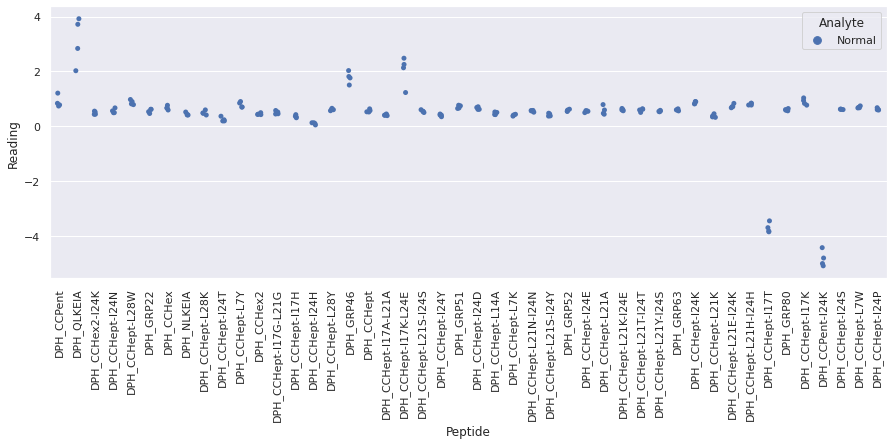

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

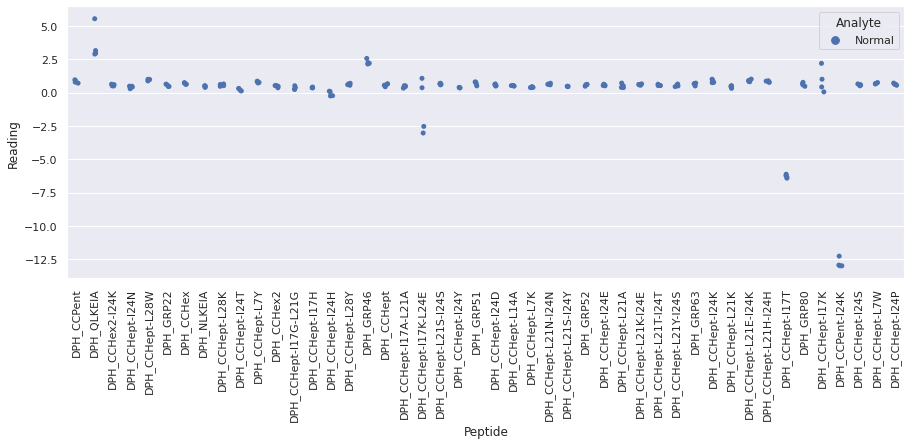

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR1_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR1_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynineR1_repeat_15 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

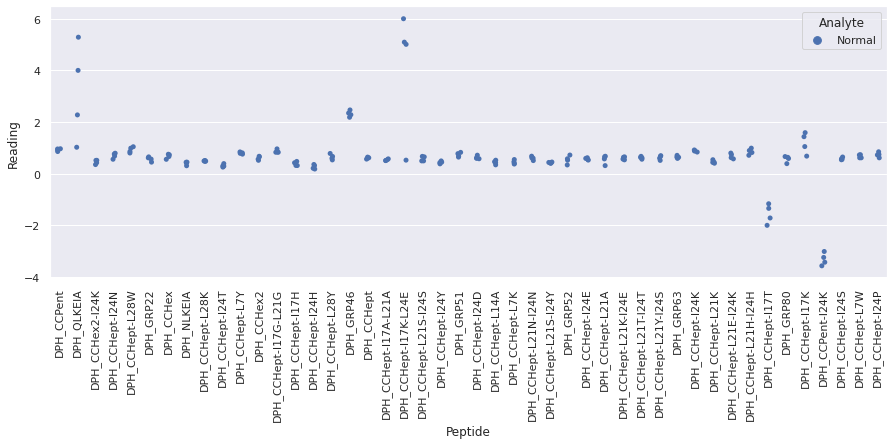

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR2_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR2_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynineR2_repeat_15 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

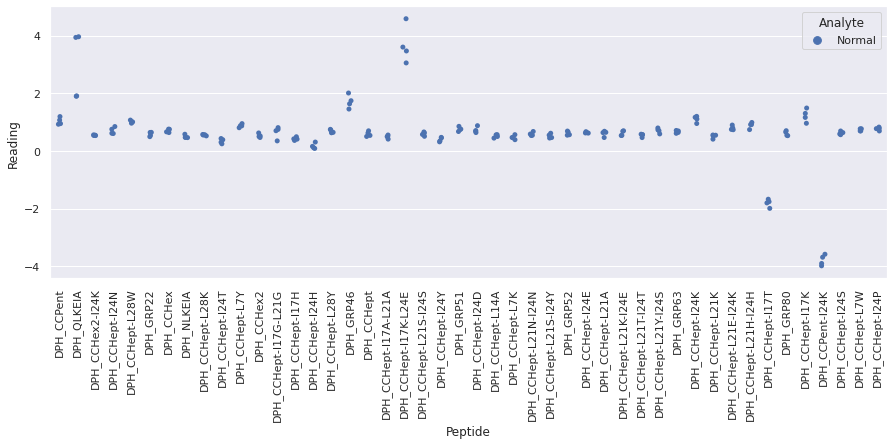

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR3_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR3_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynineR3_repeat_15 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

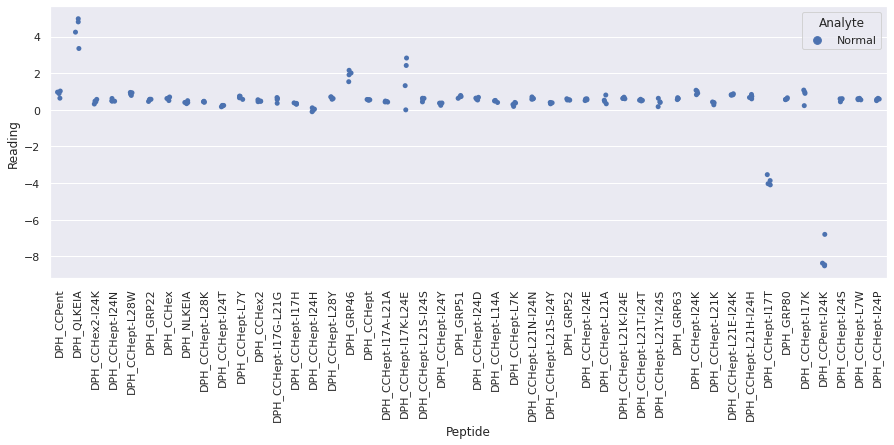

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR4_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR4_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynineR4_repeat_15 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

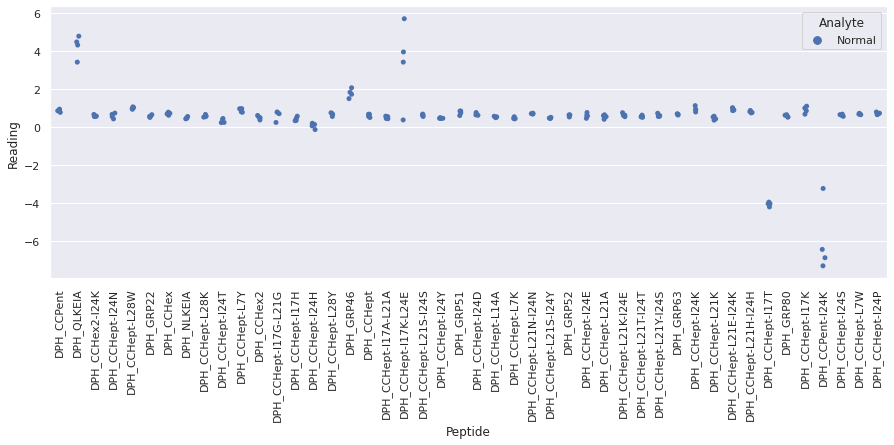

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR1_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR1_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyR1_repeat_16 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

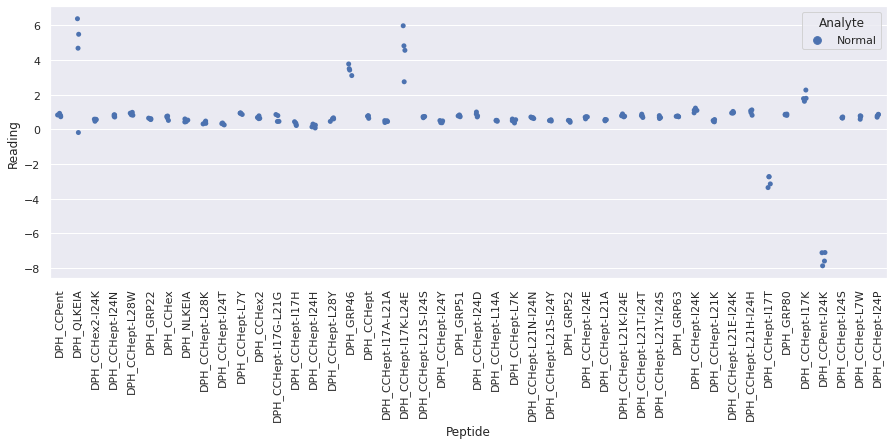

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR2_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR2_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR2_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Nor

<Figure size 720x720 with 0 Axes>

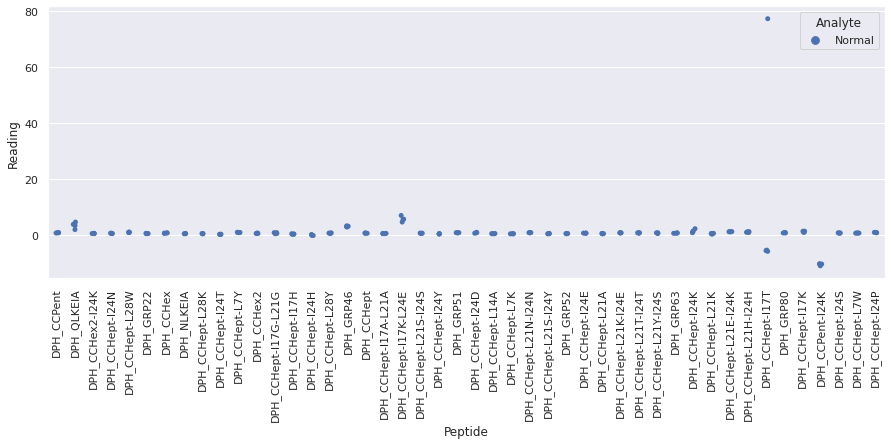

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR3_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR3_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR3_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Nor

<Figure size 720x720 with 0 Axes>

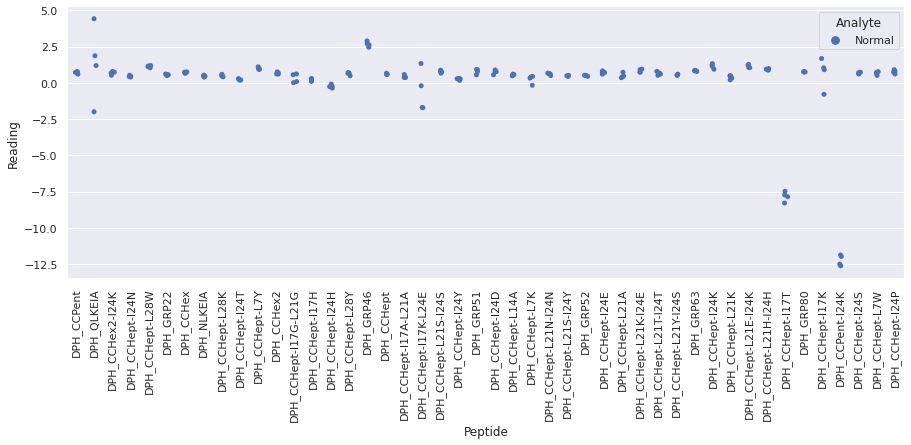

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR4_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR4_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR4_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Nor

<Figure size 720x720 with 0 Axes>

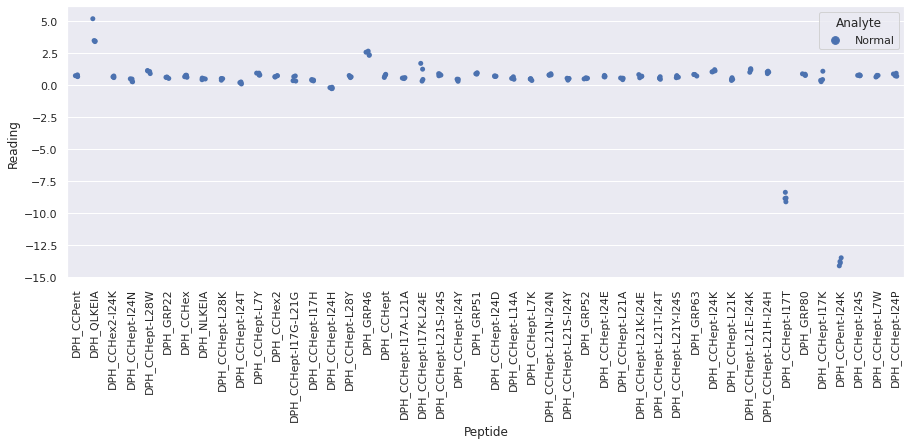

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR1_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR1_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyoneR1_repeat_17 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

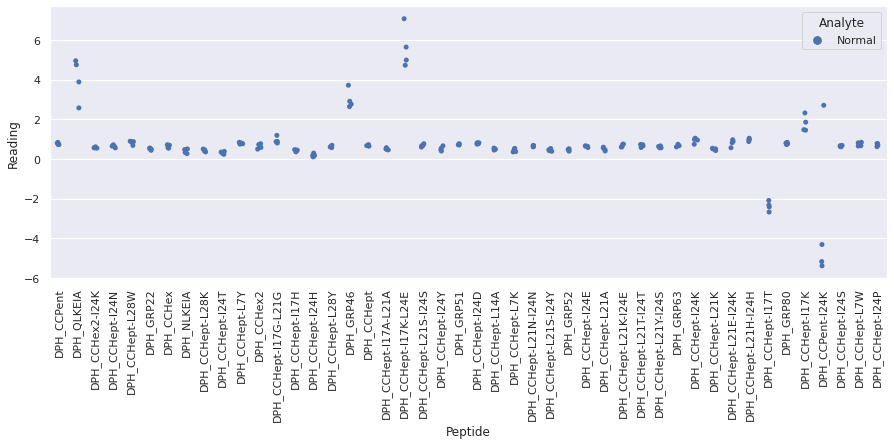

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR2_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR2_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyoneR2_repeat_17 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

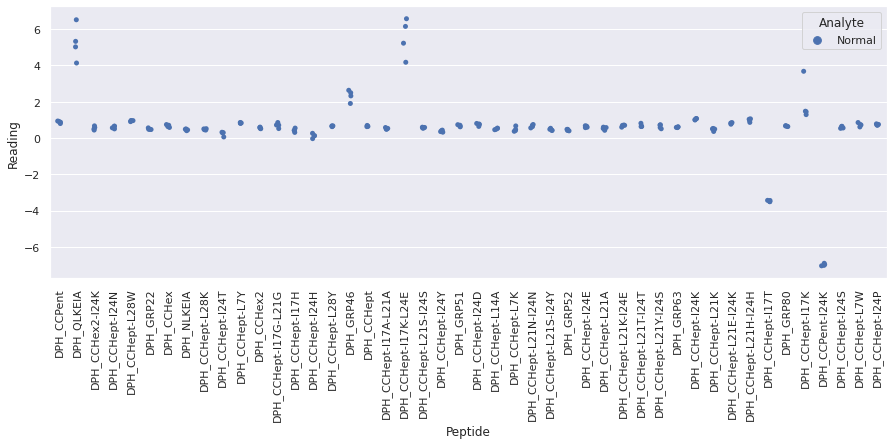

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR3_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR3_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyoneR3_repeat_17 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

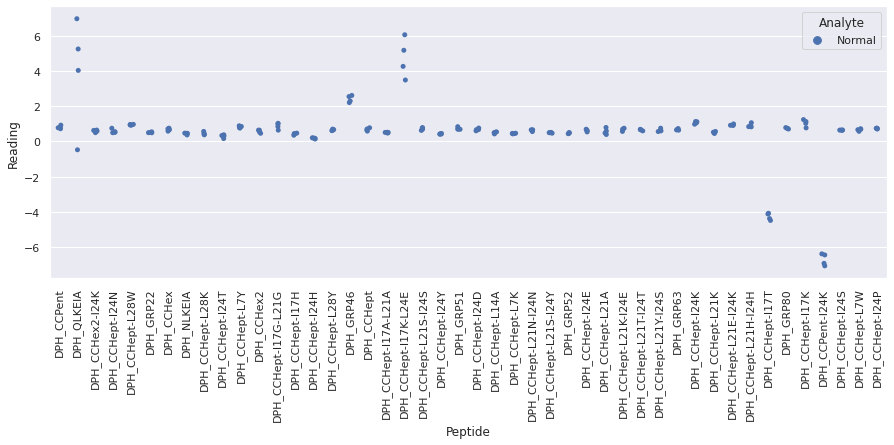

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR4_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR4_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyoneR4_repeat_17 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

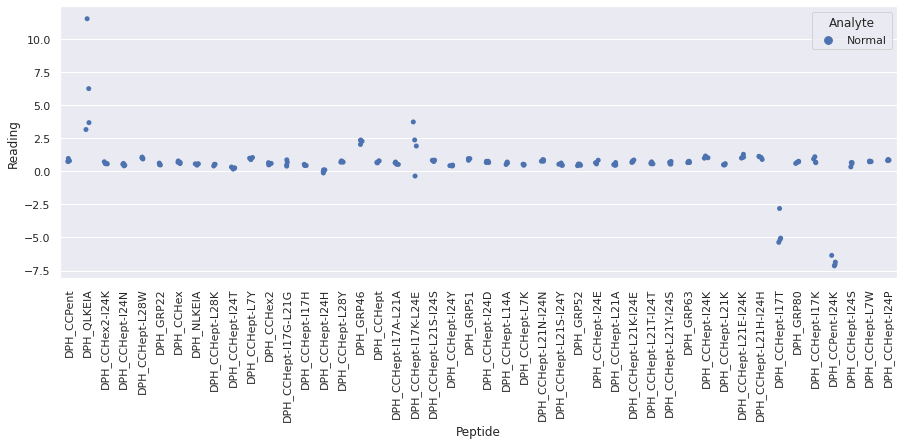

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR1_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR1_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR1_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sprea

<Figure size 720x720 with 0 Axes>

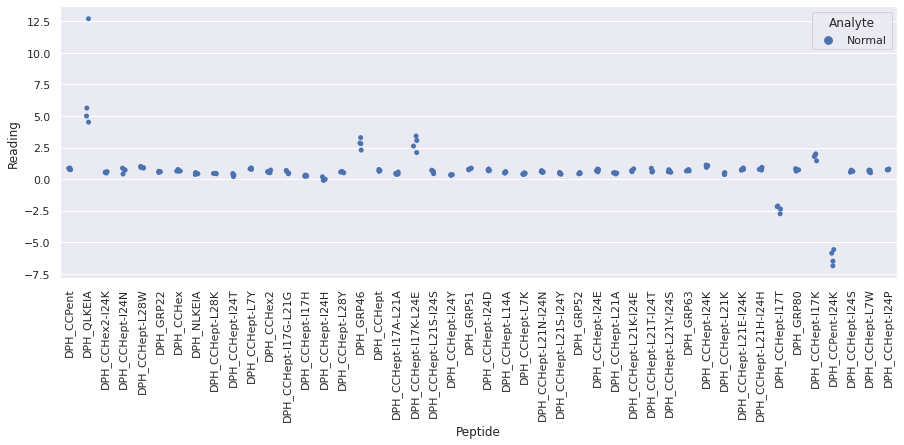

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR2_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR2_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtytwoR2_repeat_18 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

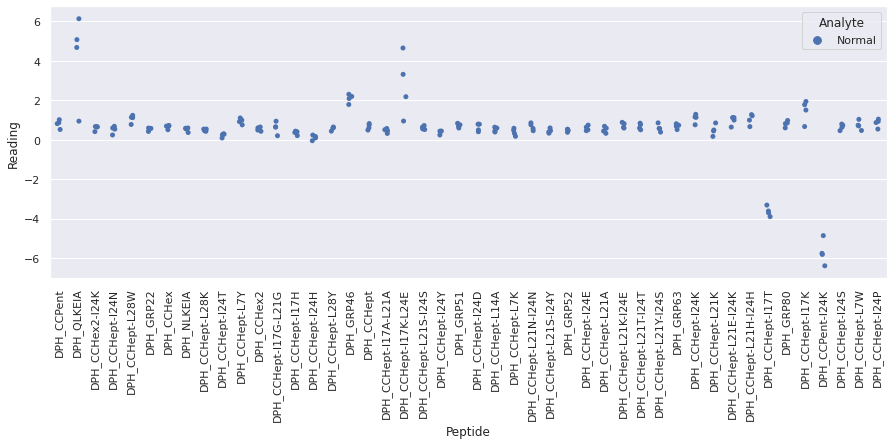

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR3_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR3_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR3_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sprea

<Figure size 720x720 with 0 Axes>

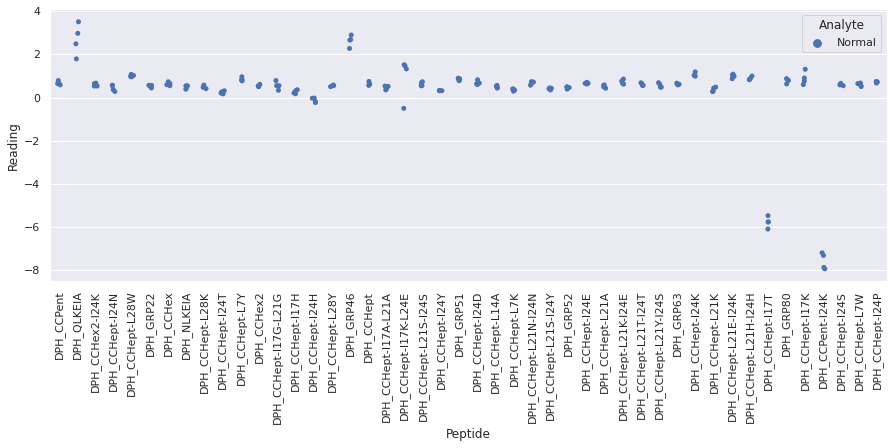

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR4_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR4_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR4_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescenc

<Figure size 720x720 with 0 Axes>

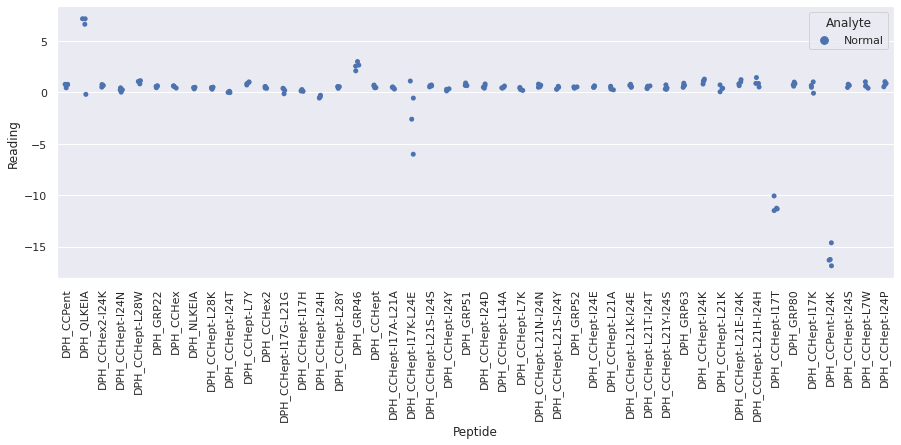

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR1_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR1_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtythreeR1_repeat_19 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

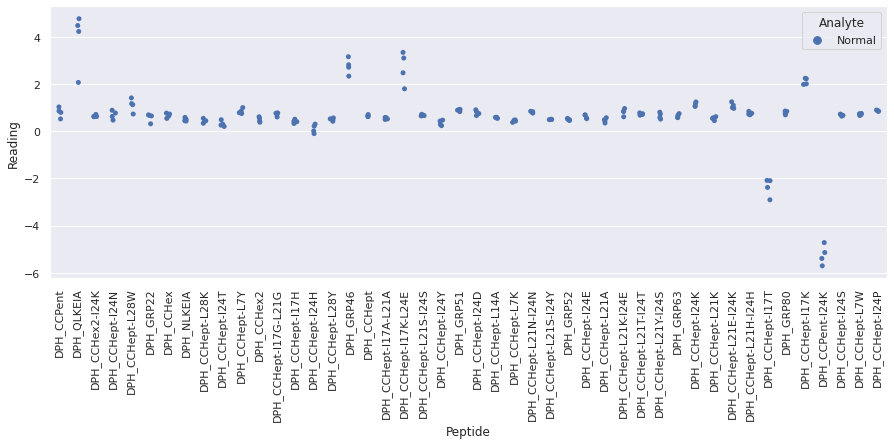

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR2_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR2_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR2_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

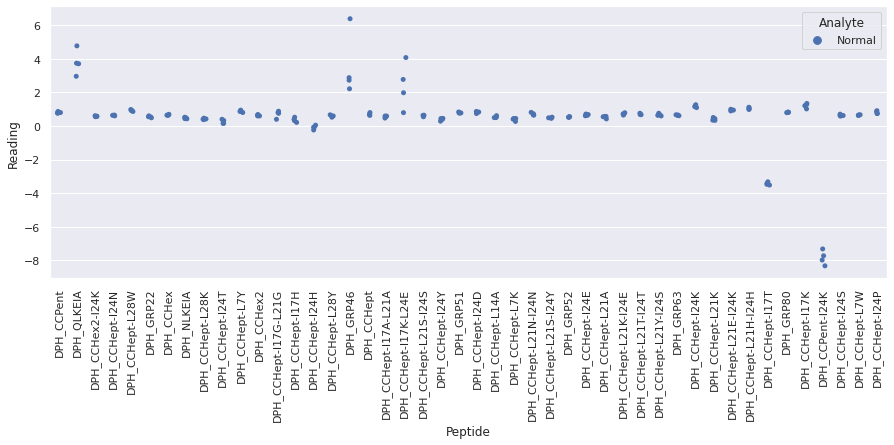

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR3_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR3_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR3_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

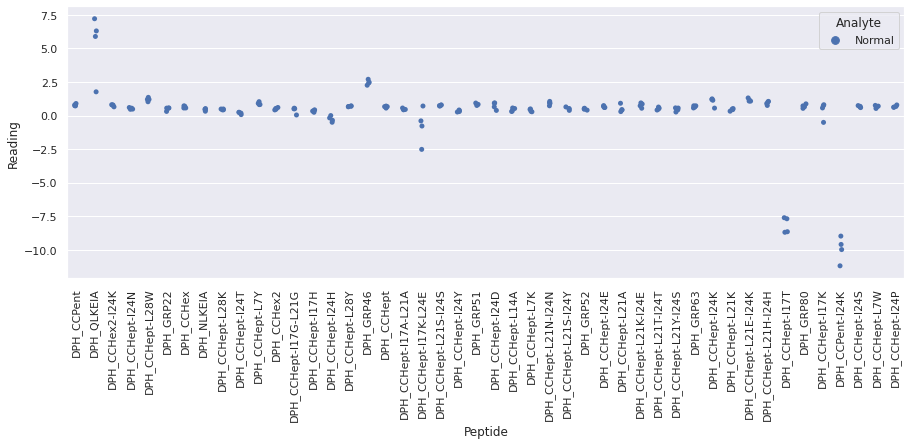

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR4_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR4_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR4_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

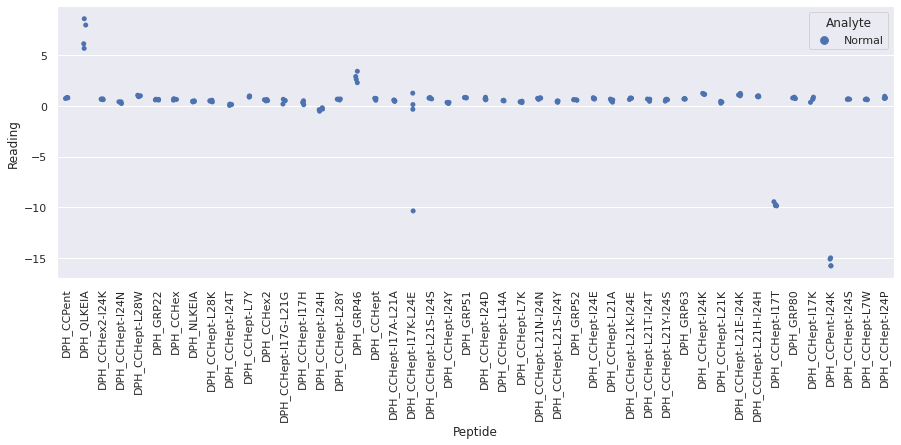

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR1_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR1_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfourR1_repeat_20 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

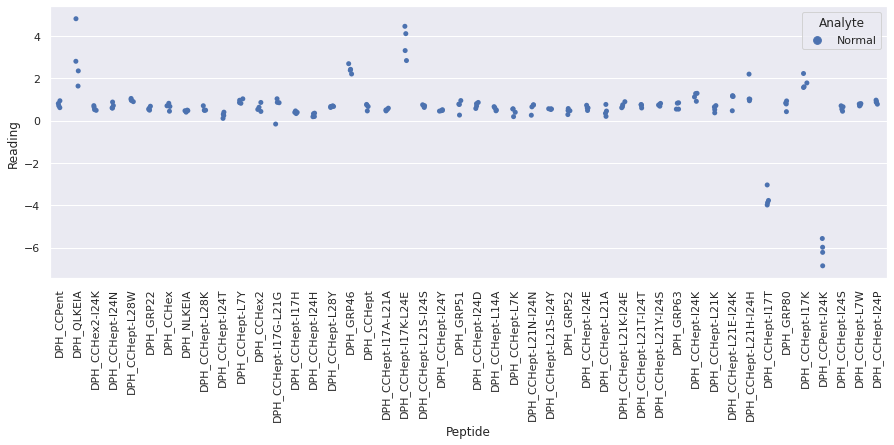

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR2_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR2_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfourR2_repeat_20 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

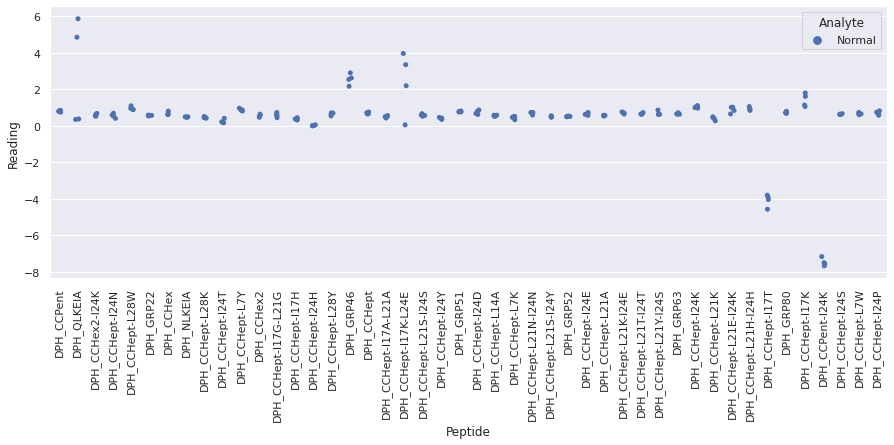

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR3_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR3_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR3_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of da

<Figure size 720x720 with 0 Axes>

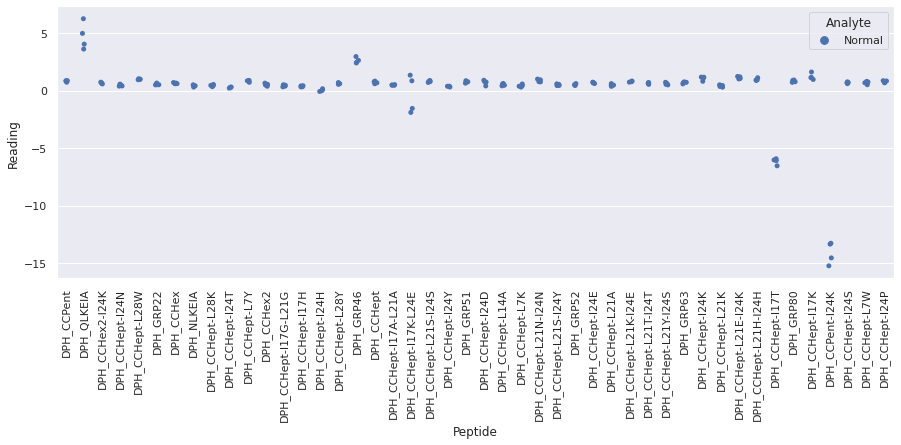

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR4_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR4_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR4_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sp

<Figure size 720x720 with 0 Axes>

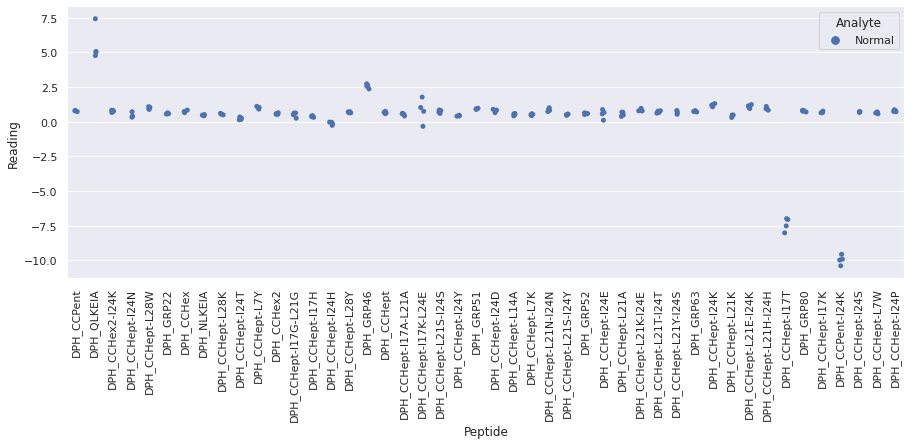

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR1_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR1_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfiveR1_repeat_21 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

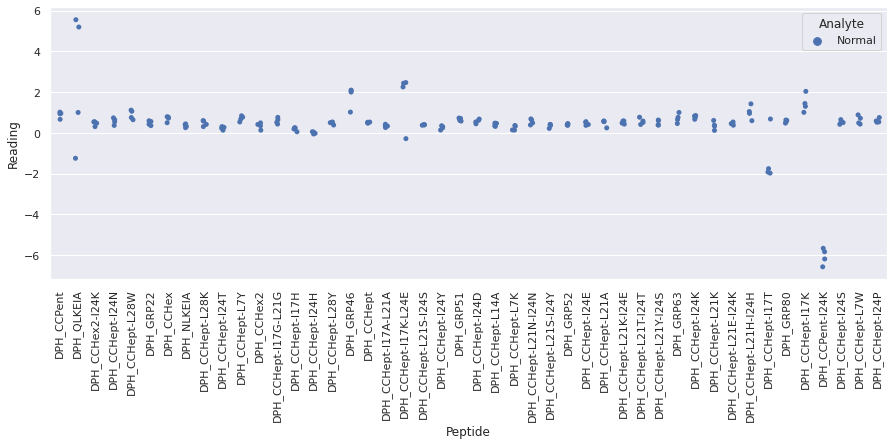

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR2_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR2_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfiveR2_repeat_21 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

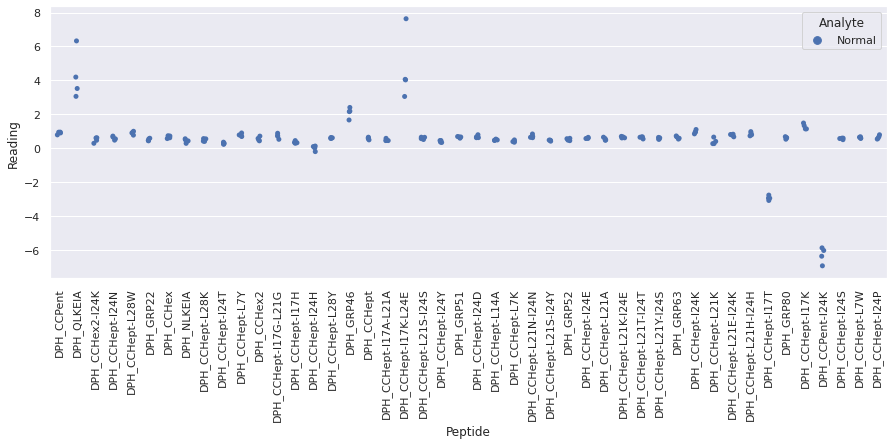

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR3_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR3_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR3_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

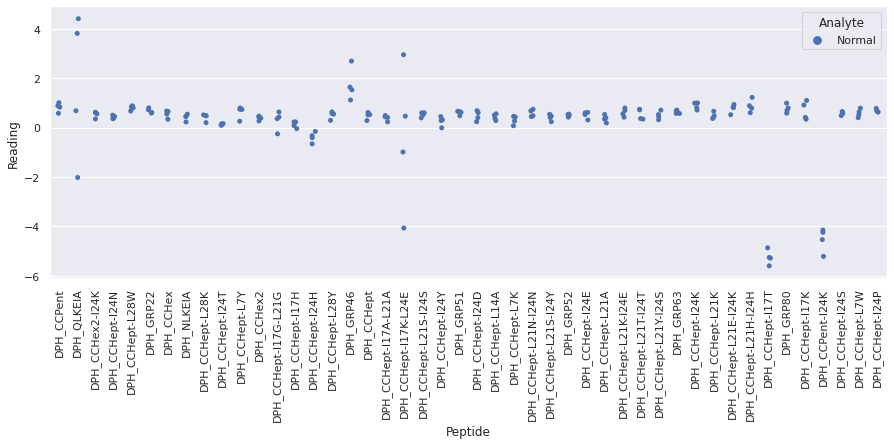

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR4_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR4_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR4_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

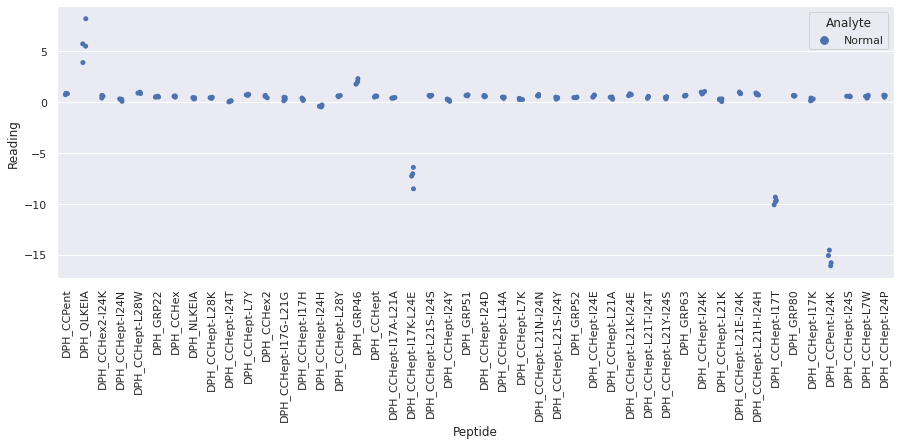

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR1_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR1_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysixR1_repeat_22 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

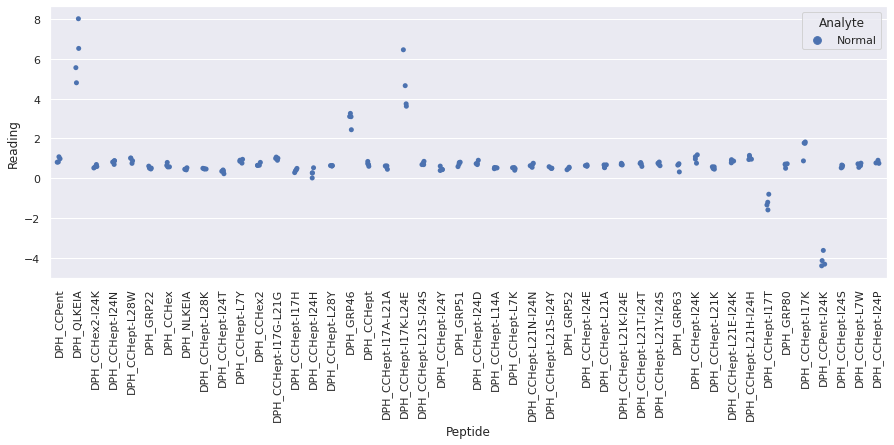

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR2_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR2_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysixR2_repeat_22 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

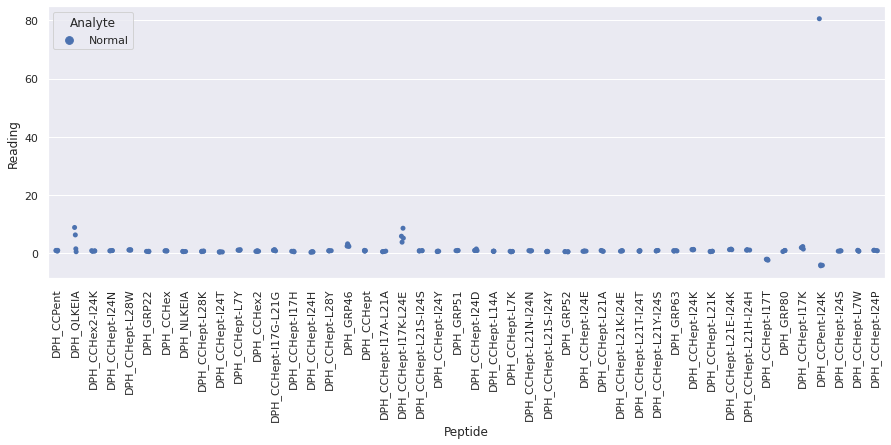

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR3_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR3_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR3_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sprea

<Figure size 720x720 with 0 Axes>

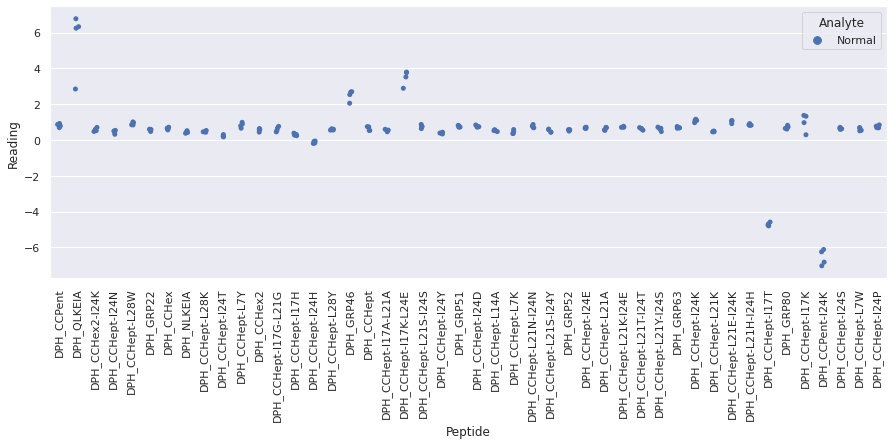

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR4_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR4_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysixR4_repeat_22 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

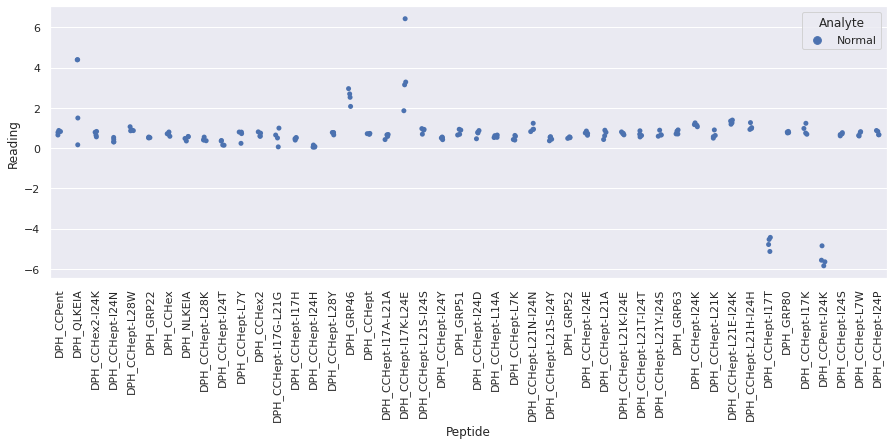

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR1_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR1_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysevenR1_repeat_23 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

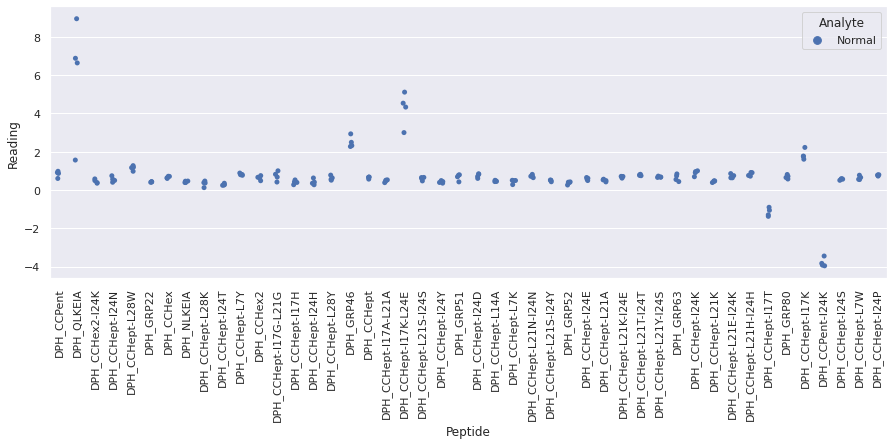

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR2_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR2_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR2_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

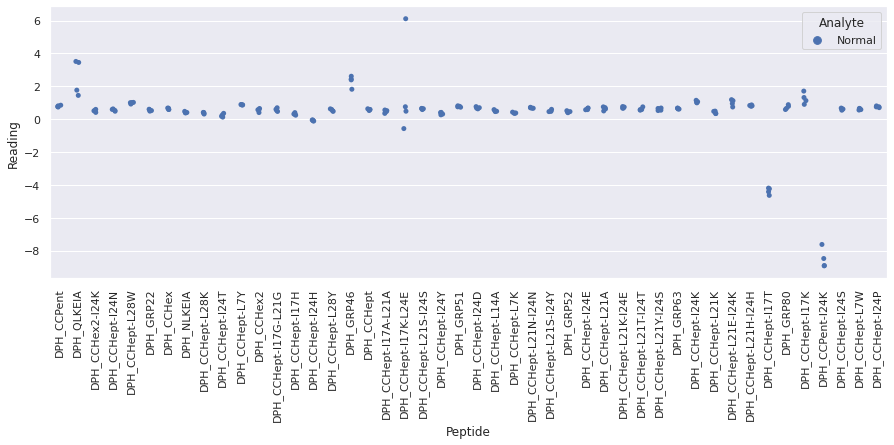

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR3_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR3_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR3_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

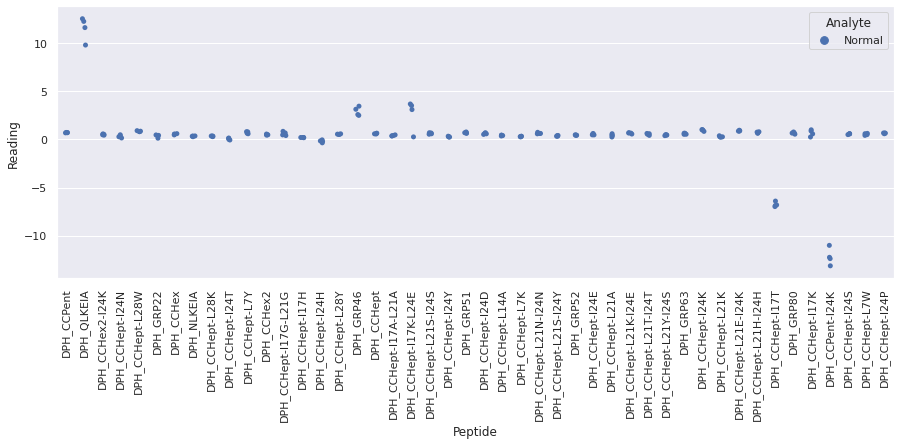

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR4_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR4_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR4_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

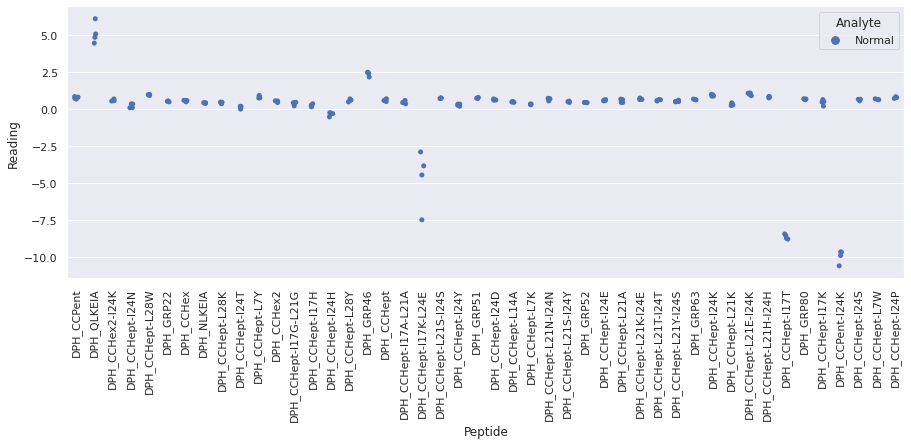

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR1_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR1_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR1_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

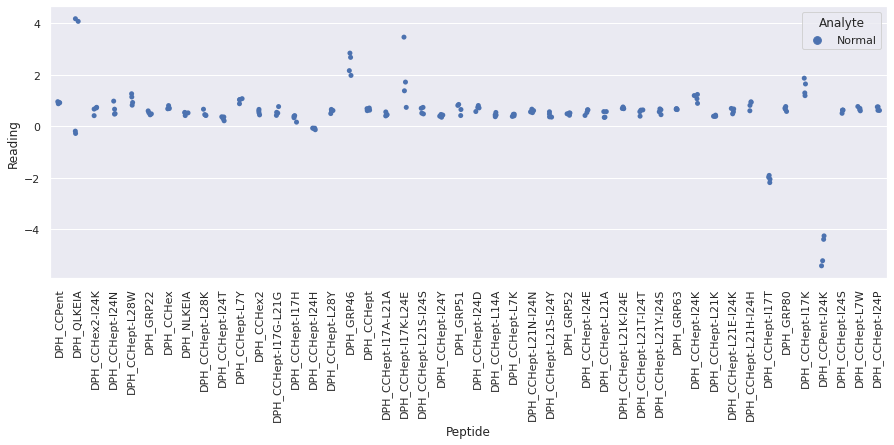

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR2_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR2_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyeightR2_repeat_24 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

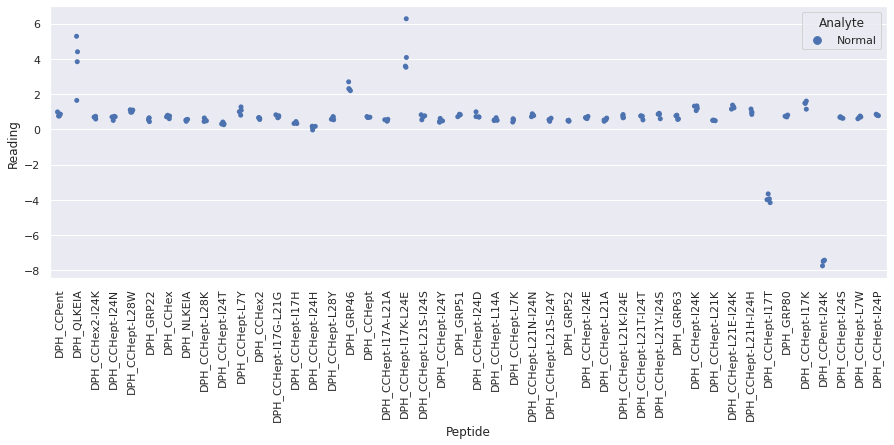

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR3_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR3_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR3_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

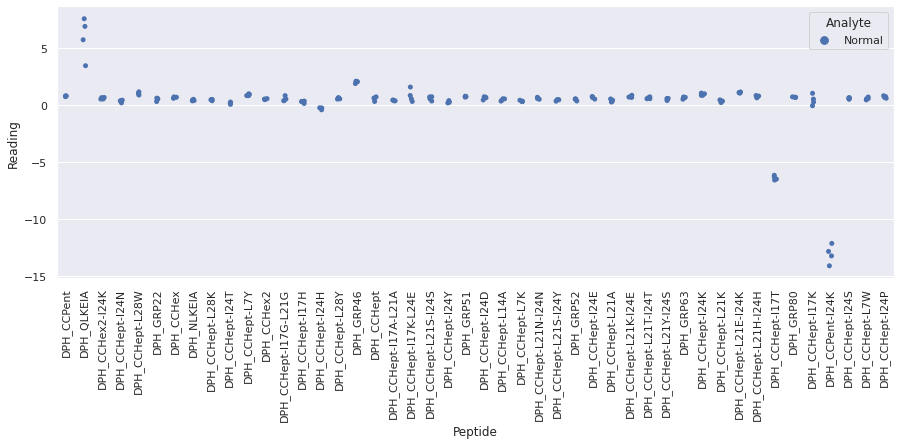

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR4_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR4_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR4_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

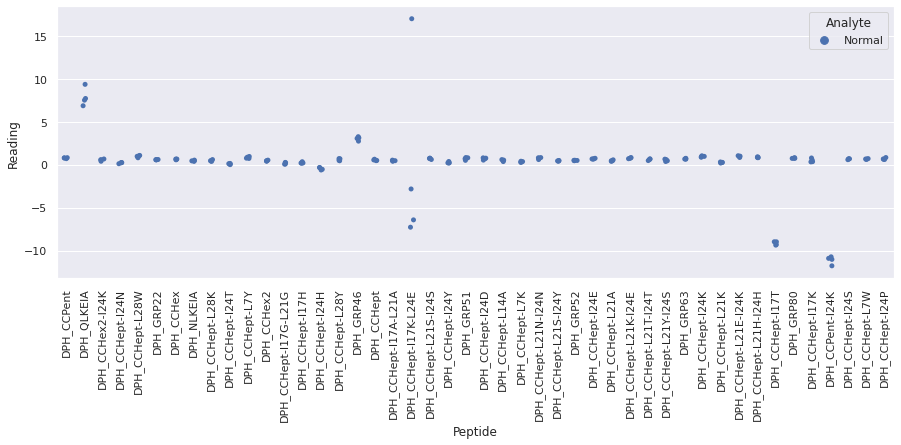

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR1_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR1_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR1_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sp

<Figure size 720x720 with 0 Axes>

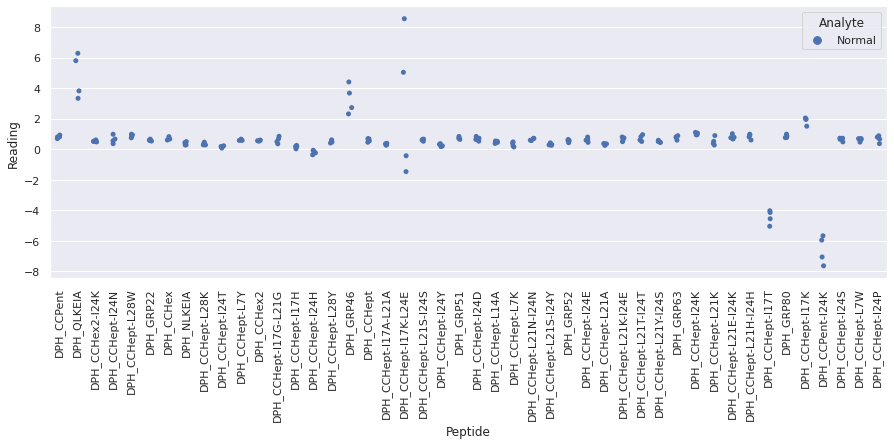

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR2_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR2_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR2_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

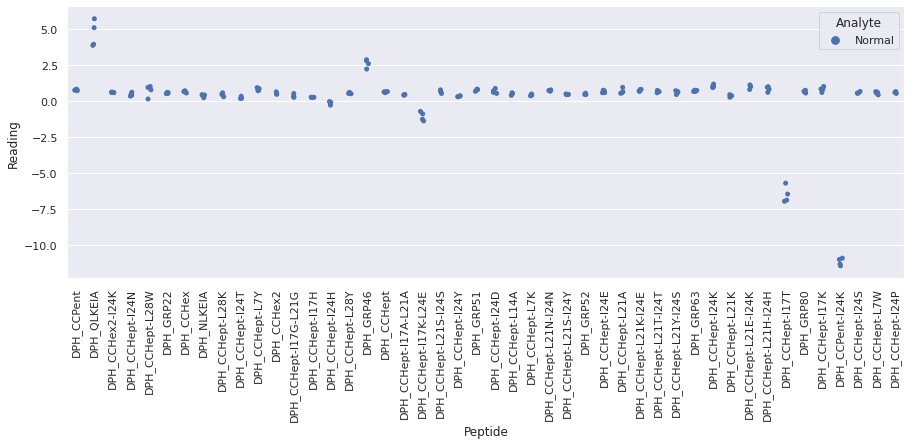

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR3_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR3_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR3_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

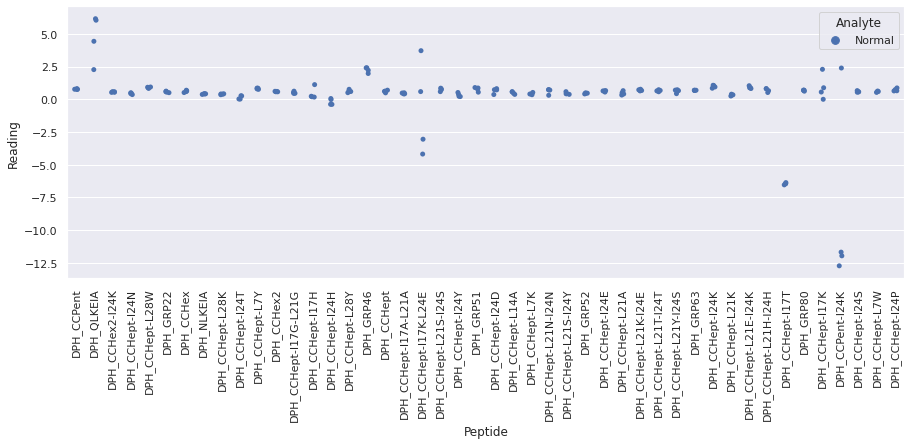

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR4_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR4_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR4_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

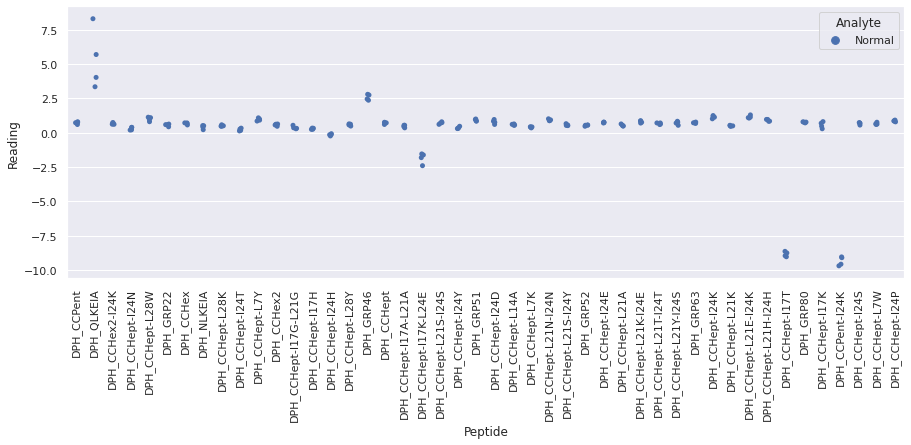

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR1_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR1_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR1_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal

<Figure size 720x720 with 0 Axes>

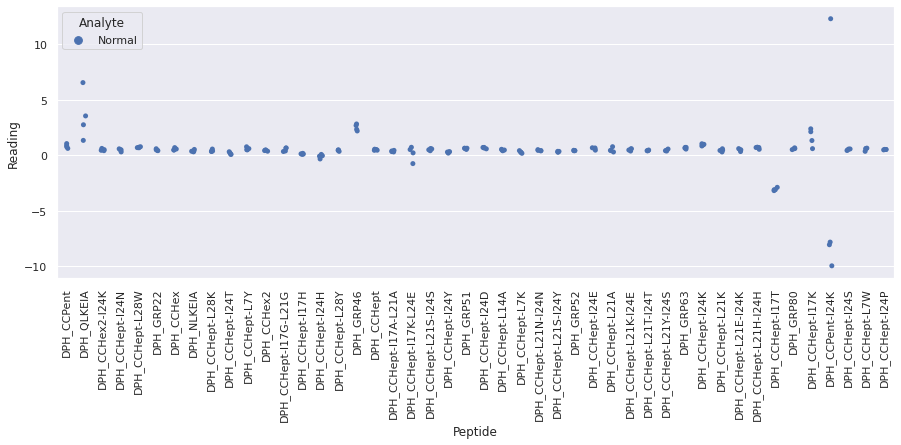

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR2_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR2_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR2_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal

<Figure size 720x720 with 0 Axes>

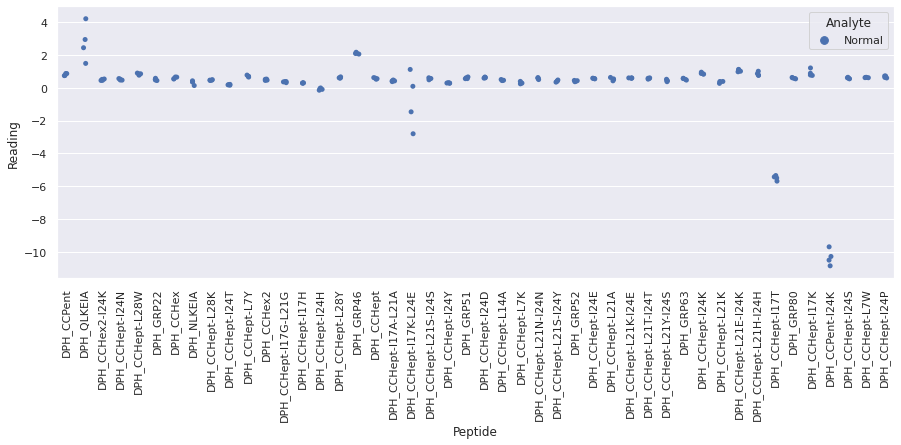

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR3_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR3_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR3_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal

<Figure size 720x720 with 0 Axes>

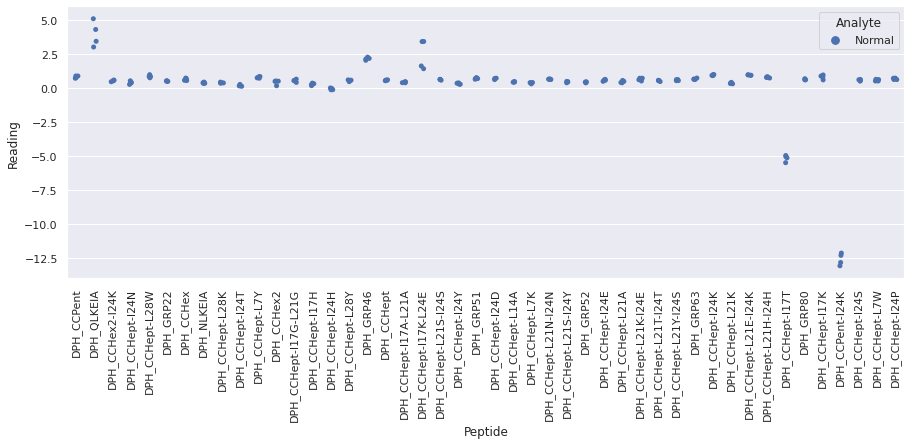

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR4_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR4_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR4_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal

<Figure size 720x720 with 0 Axes>

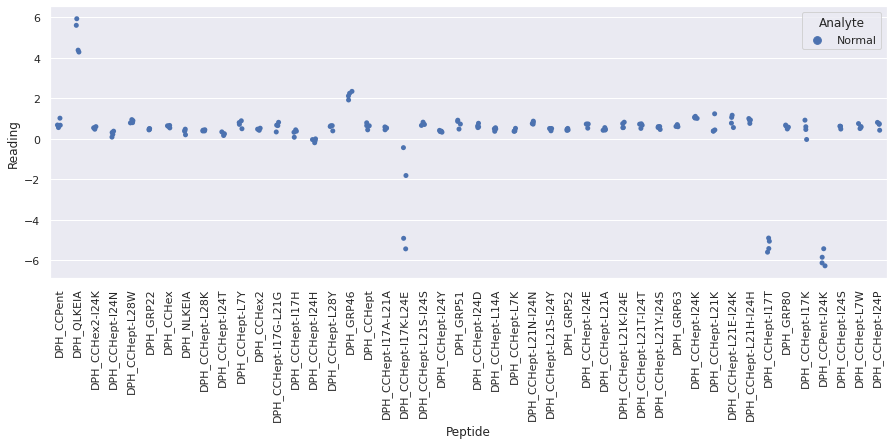

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR1_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR1_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR1_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

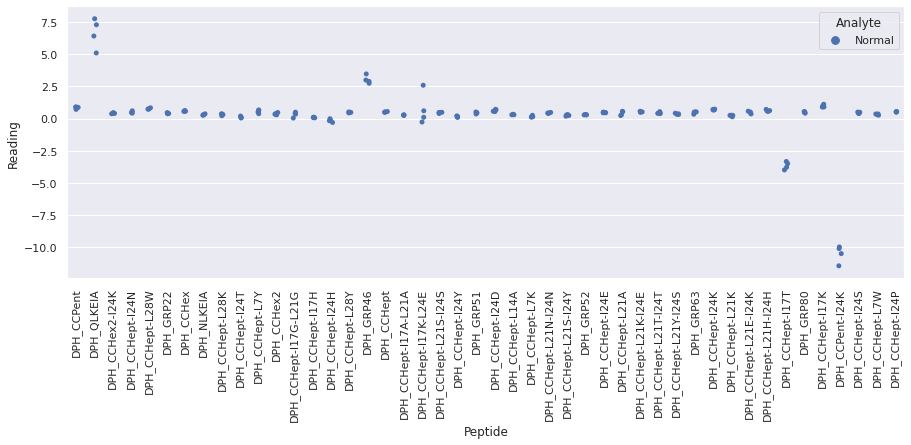

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR2_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR2_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR2_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

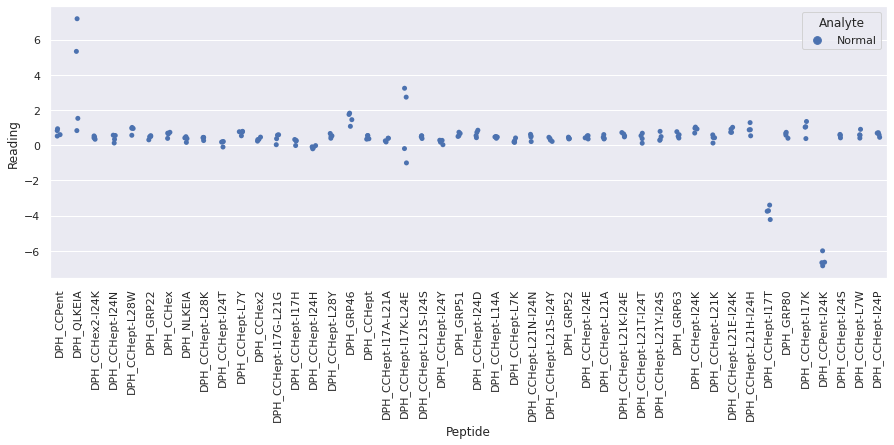

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR3_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR3_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR3_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

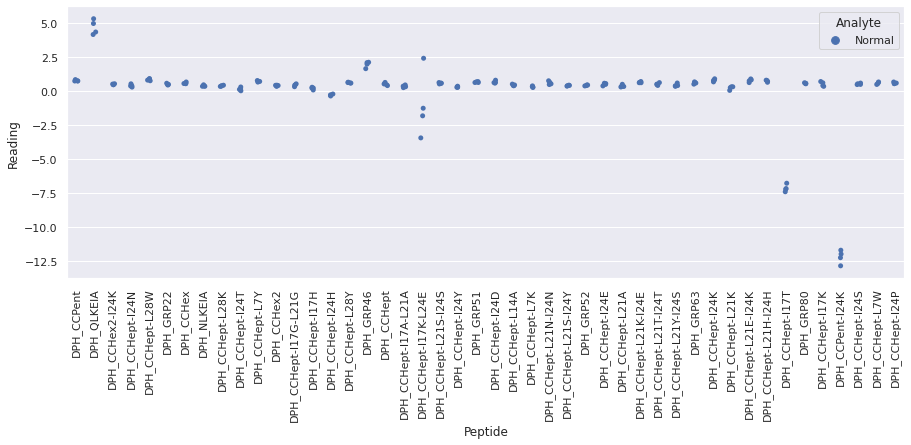

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR4_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR4_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR4_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (No

<Figure size 720x720 with 0 Axes>

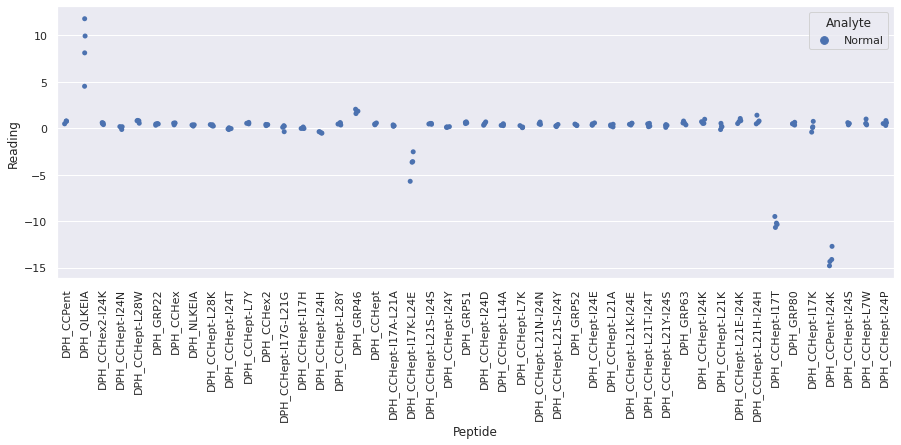

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR1_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR1_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fortytwoR1_repeat_28 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

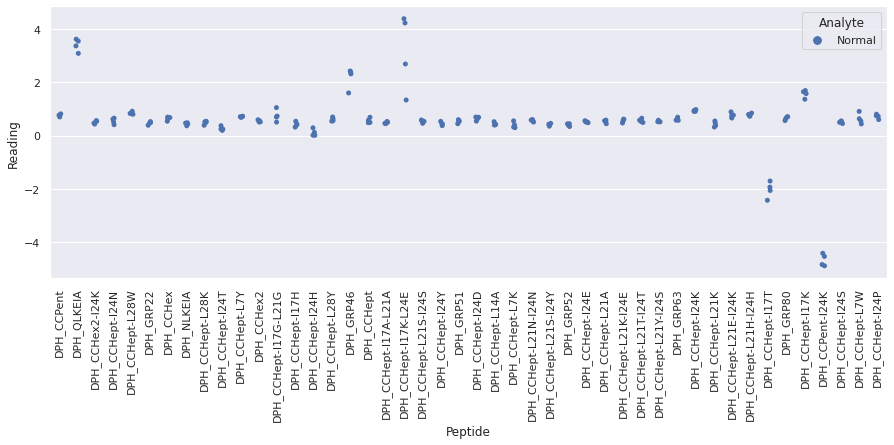

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR2_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR2_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR2_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

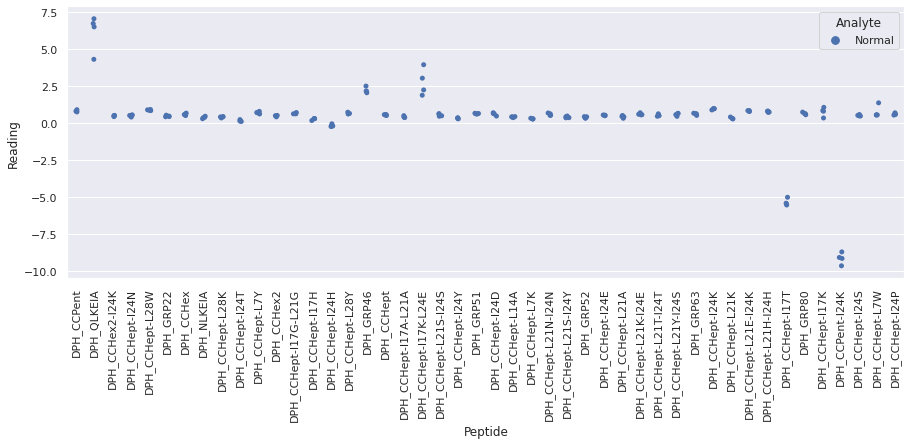

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR3_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR3_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR3_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

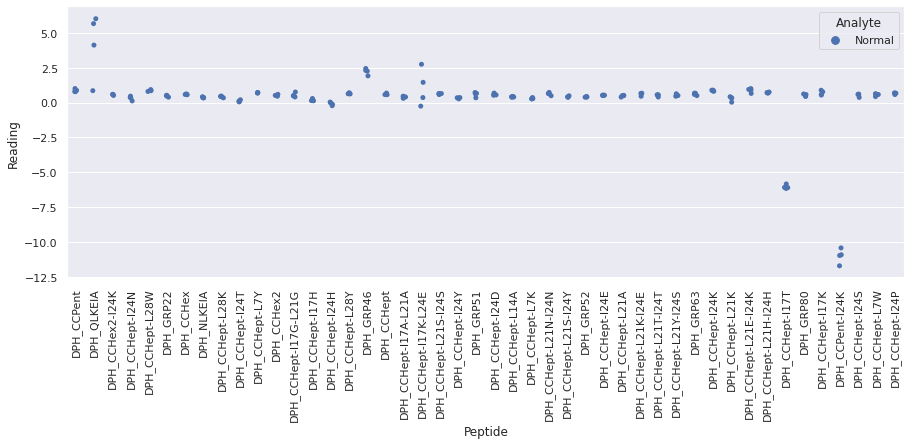

 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR4_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR4_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR4_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

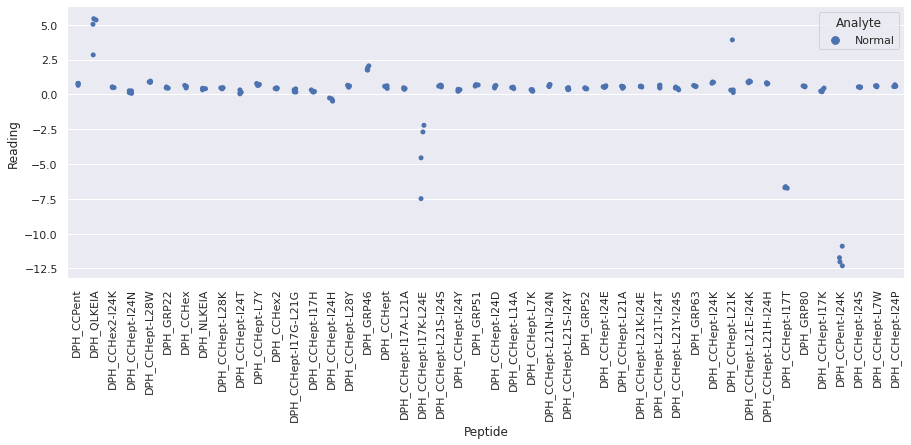



Outliers on the same plate:

/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: blank, DPH_CCHept-I24D, 12646.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: blank, DPH_CCHept-I24S, 28113.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: NASH, DPH_CCHept-L28W, 31364.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: NASH, DPH_CCHept-L21N-I24N, 14523.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: NASH, DPH_CCHept-I24S, 20834.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR2_repeat_1.xlsx: blank, DPH_CCHept-L21H-I24H, 15288.0
/home/ks17361/ML_environment/BAD

In [6]:
nash_fluor_data.xlsx_to_scaled_df(
    no_pep={'DPH': 'No Pep'}, scale_method='analyte_fluorophore', draw_plot=True, plot_dir_name='NASH'
)

At a glance:
- The serum samples are causing changes in fluorescence (e.g. compare to the sugar samples, where addition of analyte has little effect upon the fluorescence signal) - clearly there are components in the samples that are substantially affecting the interaction of DPH with the peptides.
- By eye there aren't any entire plates that are anomalous and hence should be discarded. There are individual outliers on several plates, however they will be discarded when the repeat readings are averaged by calculating the median.
- The serum samples themselves fluoresce at the same wavelength as DPH (excite at 350nm, measure at 450nm), hence the samples show pretty high background signal (compare the blue and orange dots for "DPH_No Pep" on the scatter plots for each plate). 
- There are several peptides that have little effect upon the fluorescence of DPH. Consequently, given the high background fluorescence of the analyte, the fluorescence of the sample with DPH and the peptide exceeds that of DPH and the peptide alone in these cases. The fact that the fluorescence increases in the presence of analyte is not on its own problematic, provided that the increase is consistent - however, the low fluorescence of the peptide and DPH alone means that these readings are more likely to contain larger amounts of noise (since the readings are scaled relative to the fluorescence of the peptide + DPH in order to enable fair comparison of readings measured on different plates). This is reflected in the above scatter plots - the ranges of readings obtained for peptides QLKEIA and CCHept-I17K-L24E in particular are unusually large even when only comparing samples on the same plate => think it is unlikely that the readings from these peptides will provide much signal about the sample class and instead will be predominantly noise. In contrast, although peptides CCHept-I17T and CCPent-I24K yield negative (scaled) readings as a result of the fact that in both cases the fluorescence of analyte + peptide + DPH is smaller than that of analyte + DPH alone, the (scaled) readings are fairly consistent. Hence they are likely to provide useful signal (and accordingly I am not concerned by the warnings that these samples cause the program to raise).

Combines readings of the same analyte solution across different plates, then calculates the median reading of non-independent repeats of the same analyte. Runs generalised ESD test, discards samples with three or more outlier readings (p=0.02 threshold).

(Using the default thresholds of p=0.05 and drop_thresh=2, I found a large number of samples were identified as "anomalous" (when in fact looking at the scatter plots above by eye they did not appear obviously unusual). Consequently I have reduced the p-value threshold to 0.02 for the NASH data. The original values of p=0.05 and drop_thresh=2 were determined on the small molecules data - that they appear to be too stringent for biological data likely reflects the greater variation present in biological samples.)

In [7]:
nash_fluor_data.combine_plate_readings(outlier_excl_thresh=0.02, drop_thresh=2)



Outliers across plates:

repeat_1_NASH: NASH, DPH_GRP22, 0.3197242435848334
repeat_1_NASH: NASH, DPH_CCHept-I24E, 0.1896060690072334
repeat_1_NASH: NASH, DPH_CCHept-L21Y-I24S, 1.0978998384491114
repeat_1_Normal: Normal, DPH_GRP51, 0.4820791779993956
repeat_1_Normal: Normal, DPH_CCHept-I24D, 0.9066447007138935
repeat_1_Normal: Normal, DPH_CCHept-L21A, 0.8812353766963033
repeat_2_NASH: NASH, DPH_CCHex2-I24K, 1.2451471990648169
repeat_2_NASH: NASH, DPH_CCHept-L28K, 0.11148910993602781
repeat_2_NASH: NASH, DPH_CCHept-I24H, -0.15590797408979226
repeat_2_NASH: NASH, DPH_CCHept-L21K-I24E, 0.8178418991851565
repeat_2_NASH: NASH, DPH_CCHept-I24S, 1.3188690717470613
repeat_2_Normal: Normal, DPH_CCHex2-I24K, 0.21552611481887307
repeat_2_Normal: Normal, DPH_CCHept-I24N, 2.306624667782262
repeat_2_Normal: Normal, DPH_CCHept-L21K-I24E, 1.3230985915492959
repeat_3_NASH: NASH, DPH_QLKEIA, 20.261111111111113
repeat_3_NASH: NASH, DPH_CCHept-L21K, 0.055288461538461536
repeat_3_NASH: NASH, DPH_CCHept-I1

Display range of data points across repeats for the different analytes




Original_data:


NASH


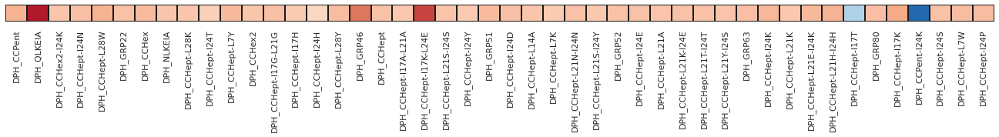


Normal


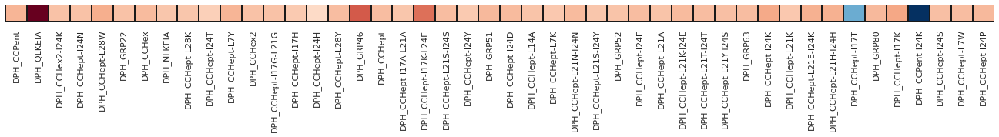




Scaled_data:


NASH


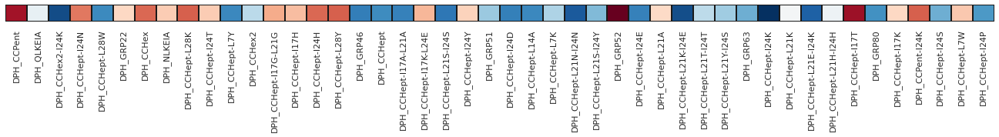


Normal


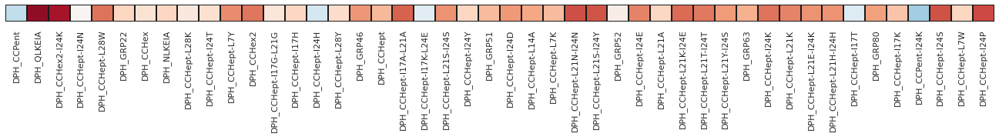




Original_data:



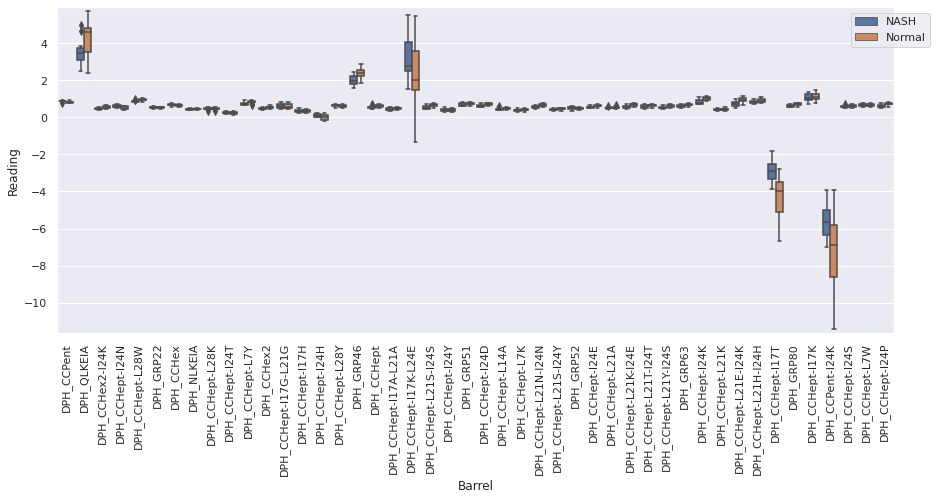

NASH


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 78.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 7.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 71.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 57.1% of the points cannot be placed; you may want t

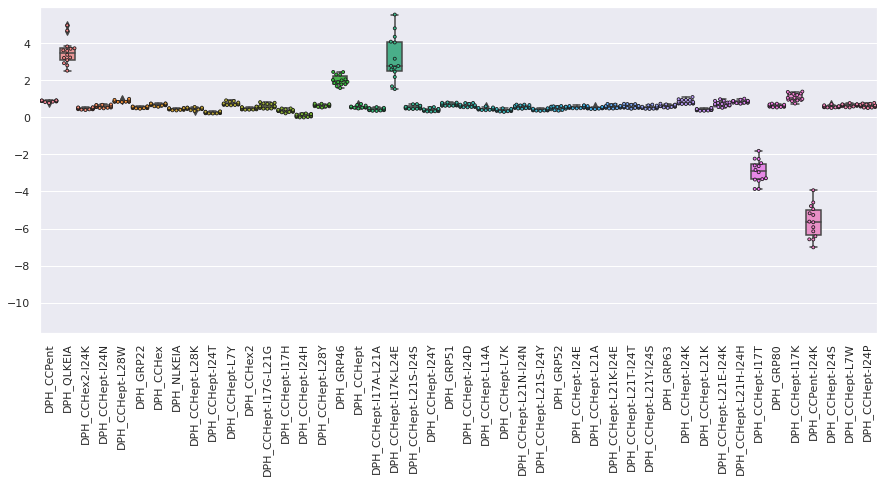

Normal


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 88.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 22.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 85.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 77.8% of the points cannot be placed; you may want 

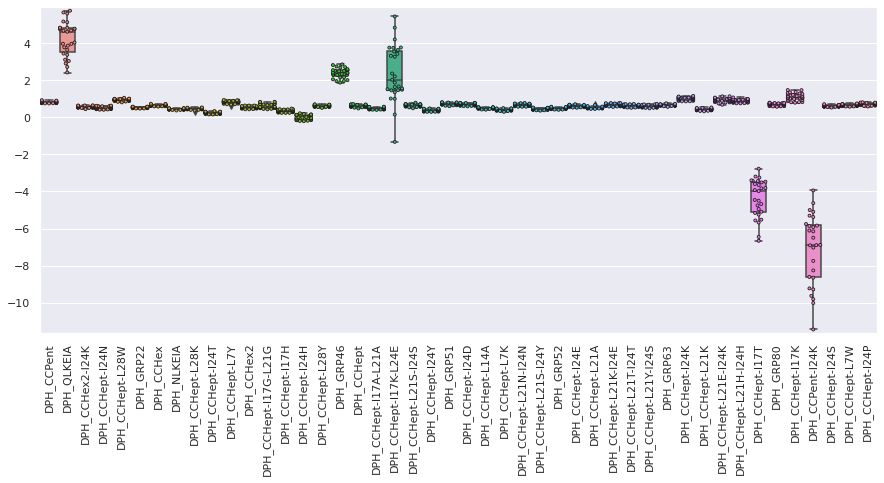




Scaled_data:



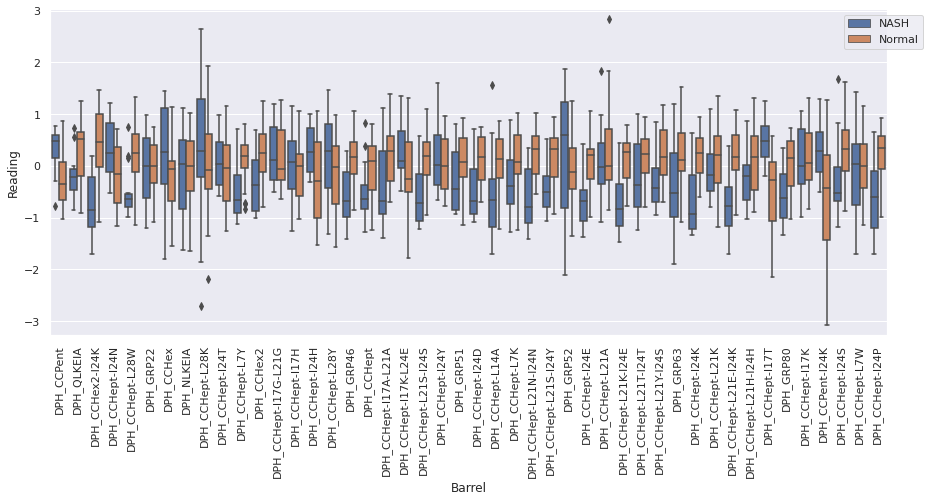

NASH


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 7.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


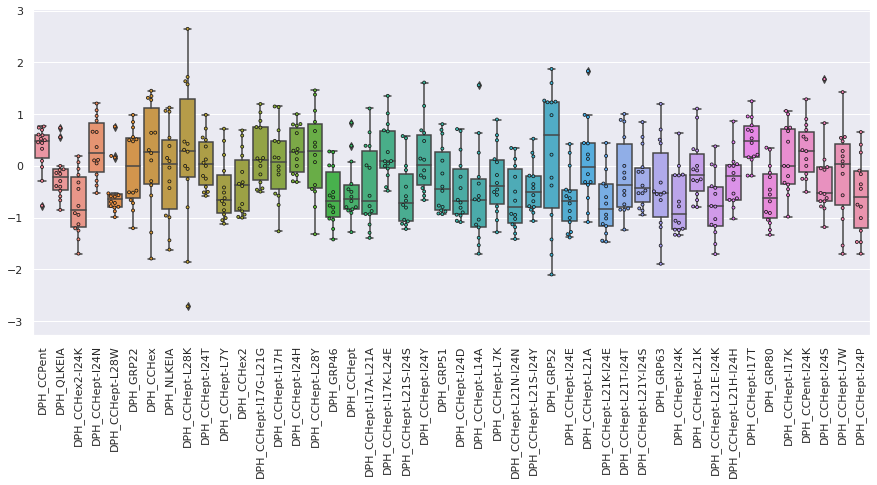

Normal


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 7.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 14.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


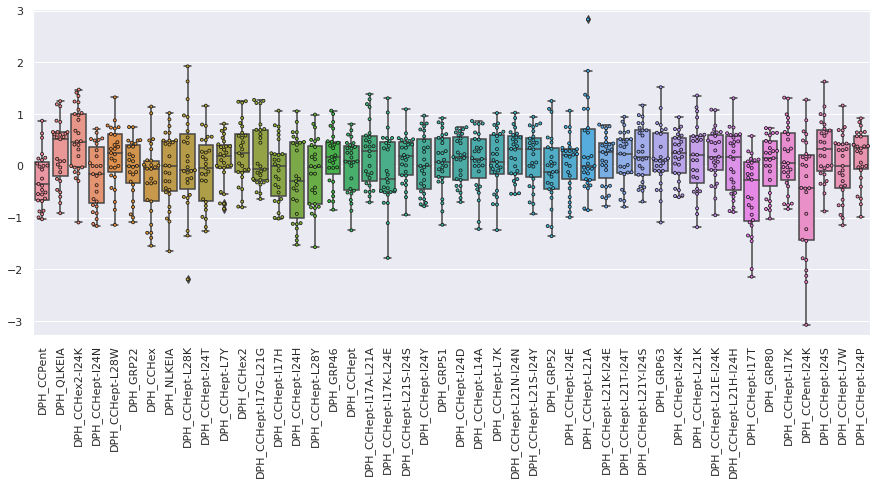

In [8]:
nash_fluor_data.display_data_distribution()

By eye, when looking at the scaled data box plots, there is not a noticeable difference between the degree of class overlap of the peptides that affect DPH fluorescence very little and hence give very high/low raw readings, as compared to the other peptides. Consequently, I will not be discarding any of the peptides prior to ML analysis. 

In [9]:
nash_fluor_data.ml_fluor_data

,DPH_CCPent,DPH_QLKEIA,DPH_CCHex2-I24K,DPH_CCHept-I24N,DPH_CCHept-L28W,DPH_GRP22,DPH_CCHex,DPH_NLKEIA,DPH_CCHept-L28K,DPH_CCHept-I24T,...,DPH_CCHept-L21E-I24K,DPH_CCHept-L21H-I24H,DPH_CCHept-I17T,DPH_GRP80,DPH_CCHept-I17K,DPH_CCPent-I24K,DPH_CCHept-I24S,DPH_CCHept-L7W,DPH_CCHept-I24P,Analyte
0,0.898038,4.689129,0.548631,0.669265,0.947298,0.590466,0.744925,0.500562,0.480087,0.295246,...,0.896946,0.867847,-2.592858,0.685768,1.396095,-5.266176,0.604754,0.688652,0.755124,NASH
1,0.891652,3.623931,0.507853,0.632520,0.874487,0.569603,0.709550,0.476366,0.527286,0.328635,...,0.803925,0.849413,-2.832801,0.675175,1.293779,-4.786618,0.594412,0.673276,0.687043,NASH
2,0.890463,3.834830,0.457376,0.507481,0.828162,0.468715,0.573271,0.375701,0.351252,0.222699,...,0.810712,0.887873,-2.242078,0.588646,1.207475,-6.418259,0.536868,0.587875,0.653174,NASH
3,0.880096,3.382554,0.460034,0.533032,0.848308,0.584211,0.754854,0.468918,0.524846,0.282018,...,0.725673,0.888203,-3.285607,0.702361,1.057597,-6.151534,0.592736,0.702990,0.663489,NASH
4,0.913983,4.972467,0.497819,0.518529,0.839526,0.497436,0.679511,0.404784,0.450762,0.214458,...,0.612944,0.809882,-3.333400,0.616748,0.996600,-5.625567,0.546979,0.536381,0.611955,NASH
5,0.858364,2.523810,0.396985,0.631780,0.846883,0.509833,0.709305,0.437078,0.473693,0.291753,...,0.645088,0.790906,-2.225713,0.564487,0.955814,-3.931559,0.556962,0.709339,0.530511,NASH
6,0.778131,3.234605,0.539367,0.682444,0.944134,0.570627,0.747195,0.499809,0.461107,0.262913,...,0.904422,0.954481,-3.421038,0.741654,1.375970,-6.582707,0.655598,0.708078,0.737019,NASH
7,0.905560,2.809108,0.432889,0.698150,0.849604,0.568319,0.690645,0.458186,0.530637,0.238742,...,0.518785,0.892685,-2.629791,0.572372,0.916064,-4.592120,0.551182,0.680746,0.503557,NASH
8,0.822690,3.596464,0.436396,0.490127,0.858253,0.489036,0.601438,0.384102,0.386091,0.215336,...,0.639973,0.792086,-2.957829,0.536040,1.059237,-5.927344,0.510865,0.548655,0.530008,NASH
9,0.895525,3.708487,0.519613,0.558993,0.868678,0.511779,0.641514,0.406330,0.428722,0.258118,...,0.777749,0.770368,-3.863383,0.644948,1.272214,-6.591890,0.558425,0.604190,0.695182,NASH


#### ML analysis

 *2 classes (Normal and NASH)*

In [10]:
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size
ml_2_classes = RunML(
    results_dir='/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_2_classes_split_illness/'
                'NASH_ML_plots',
    fluor_data=nash_fluor_data.ml_fluor_data.drop(['Analyte'], axis=1),
    classes=nash_fluor_data.ml_fluor_data['Analyte'].tolist(), subclasses=None, shuffle=False
)

- Calculate feature correlations

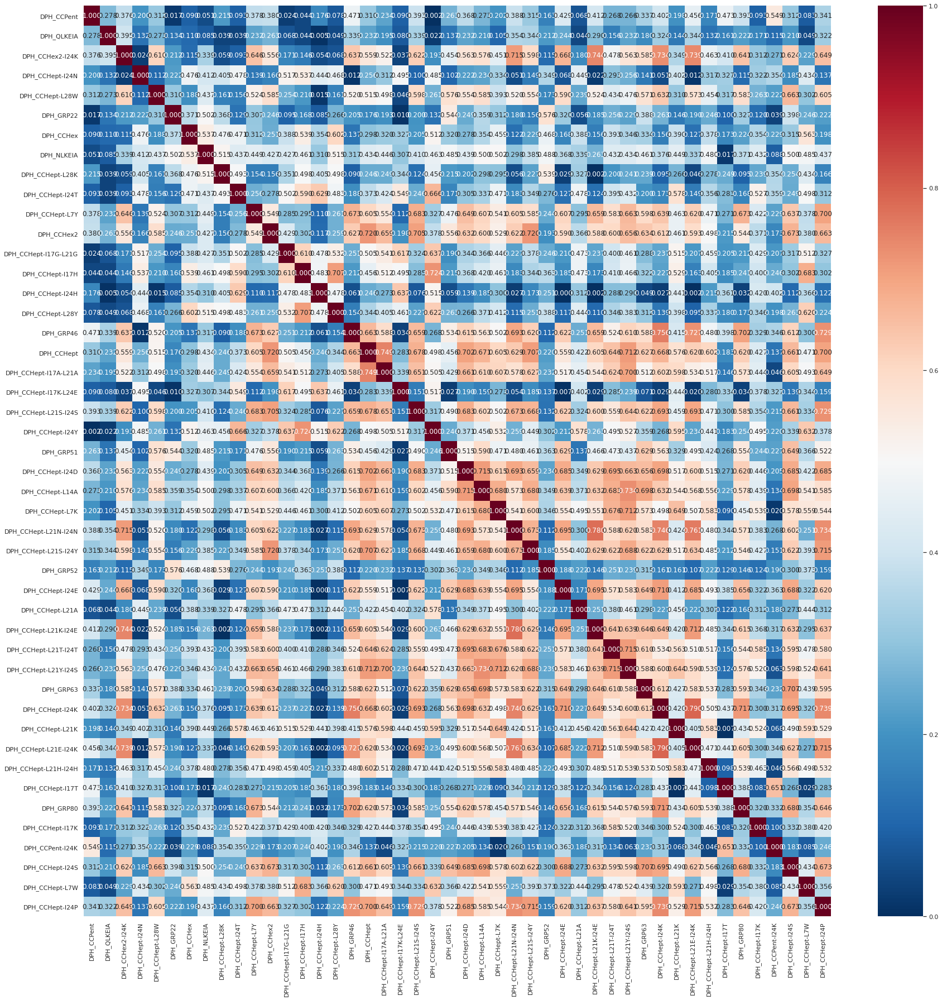

In [11]:
plt.rcParams['figure.figsize'] = (30, 30)
kendall_tau_correlation_matrix = ml_2_classes.calc_feature_correlations(
    fluor_data=ml_2_classes.fluor_data, correlation_coeff='kendall', plt_name='', abs_vals=True
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

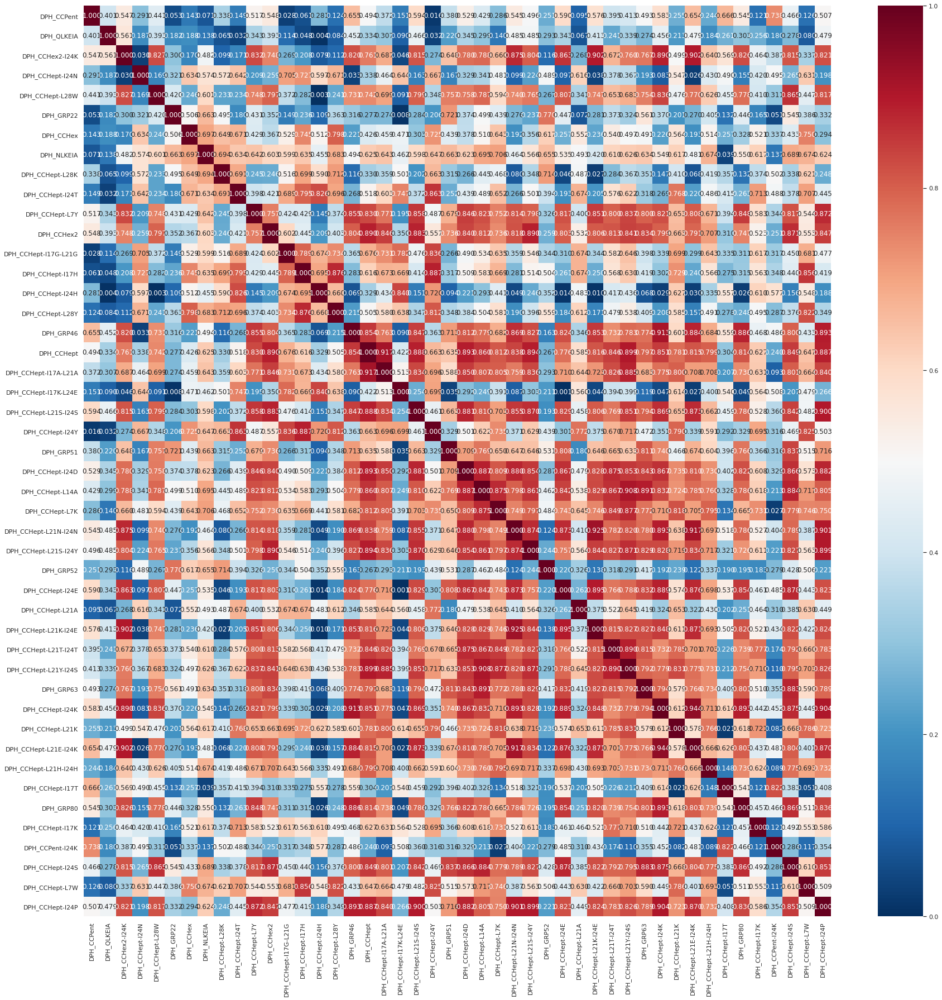

In [12]:
plt.rcParams['figure.figsize'] = (30, 30)
spearman_correlation_matrix = ml_2_classes.calc_feature_correlations(
    fluor_data=ml_2_classes.fluor_data, correlation_coeff='spearman', plt_name='', abs_vals=True
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

So, there is quite a wide range of correlation coefficients across the readings of the different barrels. That some of the barrel pairs show high correlation coefficients is encouraging, as it indicates that at least some of the barrels are likely picking up signal in the data as opposed to just noise. However, the barrels with low correlation coefficients are not necessarily picking up noise - they may instead be picking up different information from one another (and hence combining the readings from such barrels in the subsequent ML analysis would likely be beneficial for model performance). The following analysis will help to identify which barrels fall into which of these categories!

(That the correlation coefficients are generally higher for the per-illness as compared to the per-patient dataset is not surprising, as the former dataset is smaller and will contain less noise due to the additional (median) averaging step applied.)

- Measure the relative importances of the peptides with KBest using one-way ANOVA

<Figure size 720x720 with 0 Axes>

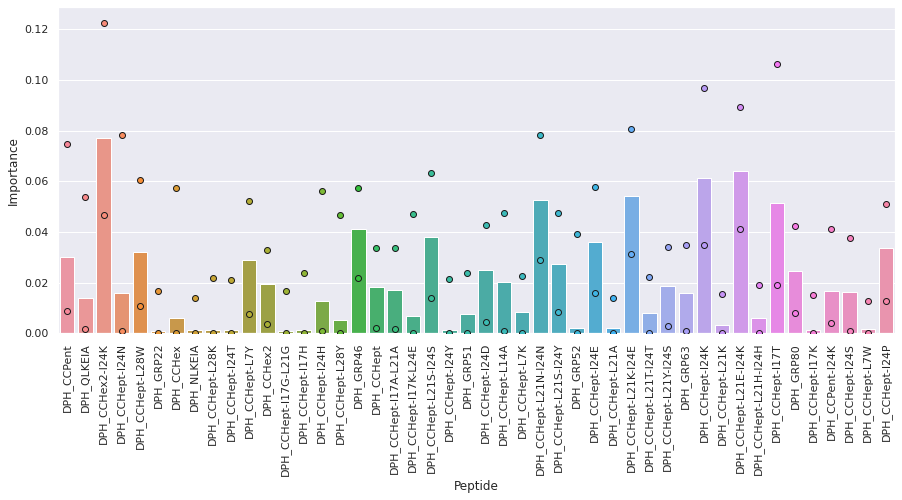

<Figure size 720x720 with 0 Axes>

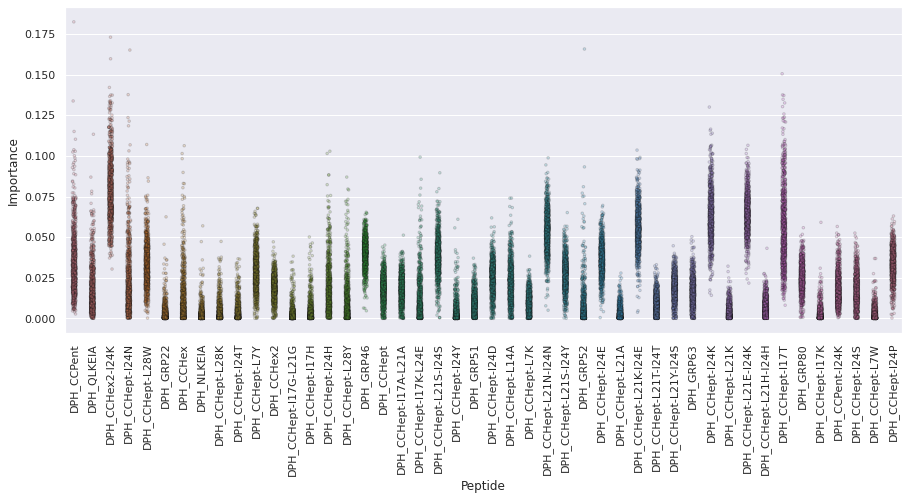

In [13]:
kbest_feat_importances_df, kbest_feat_importances_dict = ml_2_classes.calc_feature_importances_kbest(
    x=ml_2_classes.x, y=ml_2_classes.y, features=None, method_classif='f_classif', num_repeats=1000,
    scale=True, plt_name=''
)

In [14]:
print('Peptides ordered by F-score:')
kbest_feat_importances_df

Peptides ordered by F-score:


,Feature,Score
0,DPH_CCHex2-I24K,0.076960
1,DPH_CCHept-L21E-I24K,0.064123
2,DPH_CCHept-I24K,0.061154
3,DPH_CCHept-L21K-I24E,0.054281
4,DPH_CCHept-L21N-I24N,0.052595
5,DPH_CCHept-I17T,0.051403
6,DPH_GRP46,0.040941
7,DPH_CCHept-L21S-I24S,0.037965
8,DPH_CCHept-I24E,0.036021
9,DPH_CCHept-I24P,0.033612


KBest analysis is a univariate feature selection method, and hence assumes that the features are independent of one another (the importance scores calculated here are the F-scores from running one-way ANOVA). Consequently, the output importance scores do not reflect correlations between features - the scores represent the information provided by a feature about the output class, rather than the unique information provided by that feature alone. Therefore the most important features highlighted by this method could be providing the same information as one another.

Unsurprisingly, there is an approximate (negative) correlation between the degree of overlap of the readings for the two classes in the box plots above and the importance scores in this analysis (the peptides with the largest importance scores via KBest analysis being CCHex2-I24K, CCHept-L21E-I24K and CCHept-I24K), and vice versa. (Encouragingly, these relative importances are similar to those obtained for the per-patient dataset.)

- Measure the relative importances of the peptides with decision tree analysis

<Figure size 720x720 with 0 Axes>

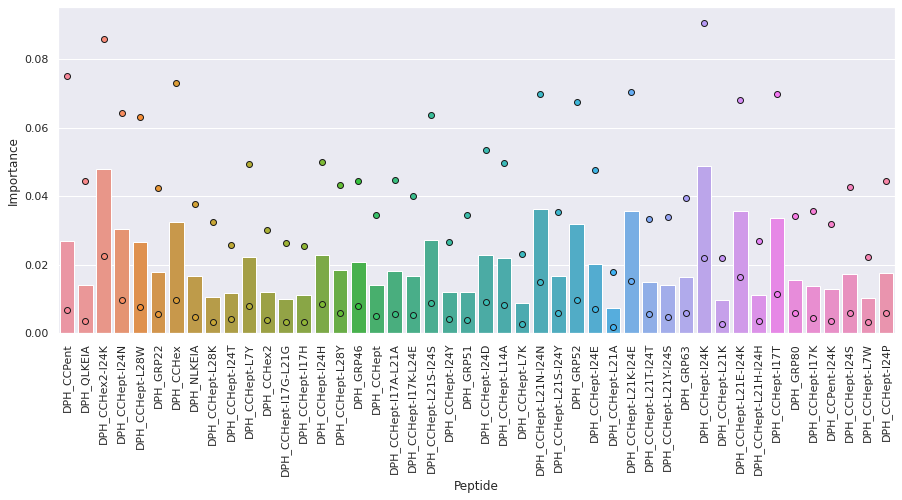

<Figure size 720x720 with 0 Axes>

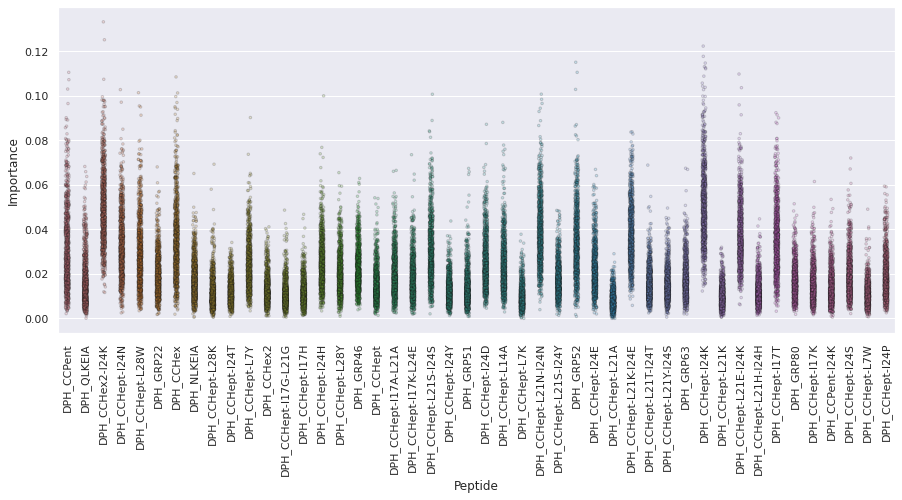

In [15]:
tree_feat_importances_df, tree_feat_importances_dict = ml_2_classes.calc_feature_importances_tree(
    x=ml_2_classes.x, y=ml_2_classes.y, features=None, num_repeats=1000, scale=True, plt_name=''
)

In [16]:
print('Peptides ordered by importance:')
tree_feat_importances_df

Peptides ordered by importance:


,Feature,Score
0,DPH_CCHept-I24K,0.048765
1,DPH_CCHex2-I24K,0.047914
2,DPH_CCHept-L21N-I24N,0.036195
3,DPH_CCHept-L21K-I24E,0.035628
4,DPH_CCHept-L21E-I24K,0.035539
5,DPH_CCHept-I17T,0.033721
6,DPH_CCHex,0.032411
7,DPH_GRP52,0.031916
8,DPH_CCHept-I24N,0.030483
9,DPH_CCHept-L21S-I24S,0.027232


In this method, an ExtraTrees classifier is used to calculate importance scores. The ExtraTrees classifier trains multiple decision trees on the data. Each tree is trained with a random subset of features on a random subset of dataset, the results of these trees are then averaged to make a prediction. Importance scores are calculated as the 
average increase in purity achieved when using a particular feature to split the data across all trees in which that feature is included (i.e. the Gini importance score of the feature). When looking at the Gini importance scores of features in individual trees, correlations between the included features are reflected in the scores. However, as more and more trees, incorporating different subsets of features, are included in the average, feature correlations have less of an effect upon the importance scores. The  number of trees (plus bootstrap repeats) included here means that the correlation between features will have little effect upon the importance scores.

Whilst there are some small differences, the relative order of the peptides identified by this method is very similar to that measured by KBest analysis. The most important peptides identified by this method are essentially the same as those identified by the KBest analysis above (with some small differences in their relative order). The less important peptides are also broadly similar, but unsurprisingly there are more differences in their relative ordering (as the absolute differences between their importance scores are smaller => can lead to more extensive reordering). Consequently, again there is a visible (negative) correlation between the degree of overlap between a peptide's class readings that can be seen in the box plots above and that peptide's importance score.

- Measure the relative importances of the peptides with permutation analysis

<Figure size 720x720 with 0 Axes>

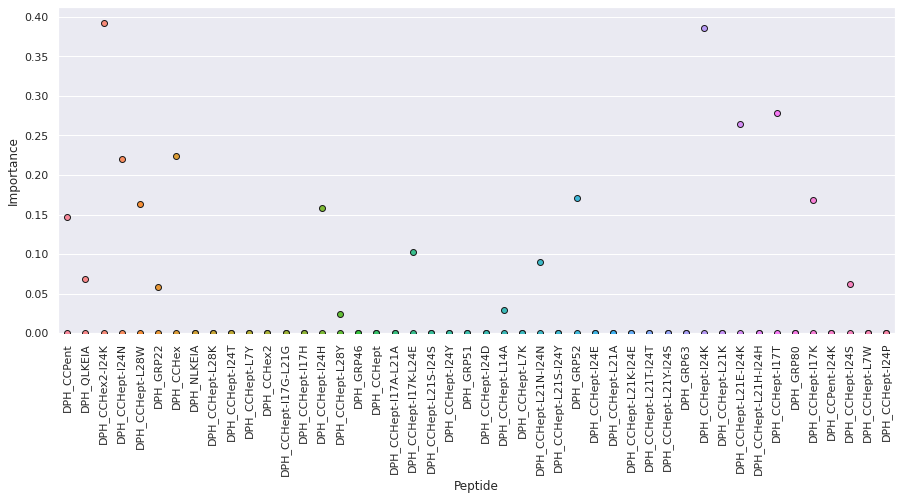

<Figure size 720x720 with 0 Axes>

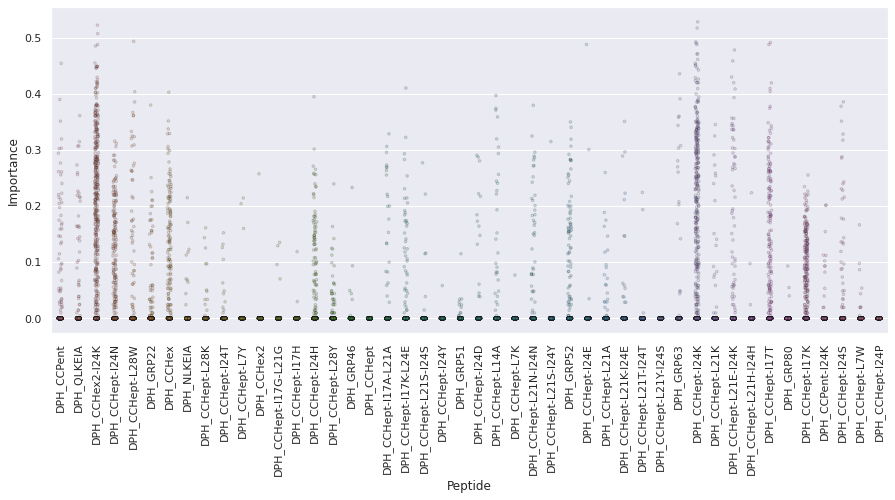

In [17]:
f1 = make_scorer(f1_score, average='weighted')
(
    median_permut_feat_importances_df, permut_feat_importances_dict
) = ml_2_classes.calc_feature_importances_permutation(
    x=ml_2_classes.x, y=ml_2_classes.y, features=None, classifier=AdaBoostClassifier,
    parameters={'n_estimators': np.array([10, 30, 100, 300, 1000])}, model_metric=f1, num_repeats=1000,
    scale=True, plt_name=''
)

In [18]:
print('Peptides ordered by median importance:')
median_permut_feat_importances_df

Peptides ordered by median importance:


,Feature,Score
0,DPH_CCPent,0.0
1,DPH_GRP63,0.0
2,DPH_CCHept-L7K,0.0
3,DPH_CCHept-L21N-I24N,0.0
4,DPH_CCHept-L21S-I24Y,0.0
5,DPH_GRP52,0.0
6,DPH_CCHept-I24E,0.0
7,DPH_CCHept-L21A,0.0
8,DPH_CCHept-L21K-I24E,0.0
9,DPH_CCHept-L21T-I24T,0.0


In [19]:
mean_permut_feat_importances_df = OrderedDict({})
for feat, score_list in permut_feat_importances_dict.items():
    mean_permut_feat_importances_df[feat] = np.mean(score_list)
mean_permut_feat_importances_df = pd.DataFrame({'Feature': list(mean_permut_feat_importances_df.keys()),
                                                'Score': list(mean_permut_feat_importances_df.values())})
mean_permut_feat_importances_df = mean_permut_feat_importances_df.sort_values(
    by=['Score'], axis=0, ascending=False
).reset_index(drop=True)

In [20]:
print('Peptides ordered by mean importance:')
mean_permut_feat_importances_df

Peptides ordered by mean importance:


,Feature,Score
0,DPH_CCHex2-I24K,0.083325
1,DPH_CCHept-I24K,0.065483
2,DPH_CCHept-I17T,0.025755
3,DPH_CCHept-I24N,0.021723
4,DPH_CCHept-I17K,0.020065
5,DPH_CCHex,0.018177
6,DPH_CCHept-L21E-I24K,0.012069
7,DPH_GRP52,0.010677
8,DPH_CCHept-I24H,0.010130
9,DPH_CCHept-L28W,0.009322


In permutation analysis, importance scores are calculated by training two ML models (in this case I have selected AdaBoost classifiers). The first model is trained using all features, the second is trained with one of the features randomly scrambled: the importance score of the feature is then calculated as the difference in performance (in this case measured via model F1 score) between the two models. Hence this method does take into account correlations between features, and the output importance scores represent the unique information that a feature provides about the output class label.

The results obtained with permutation look more different as compared to the difference between the KBest and ExtraTrees analysis, which is perhaps not surprising given that as described above permutation analysis takes feature correlation into account (whereas the former two methods do not).

Interestingly, none of the peptides has an especially high importance score (the median value for every peptide is 0), thus indicating that none of the peptides provides much unique information about the output class that is not captured by one or more of the other barrels. Looking at the mean importance scores, there is broad agreement of the barrels ranked as most important as compared to the KBest and ExtraTrees analysis above, with CCHex2-I24K and CCHept-I24K again being identified as two of the most important barrels, whilst there is unsurprisingly greater disagreement between the relative order of the peptides measured as being less important.

- What percentage of the signal in the data can be measured by N principal components?

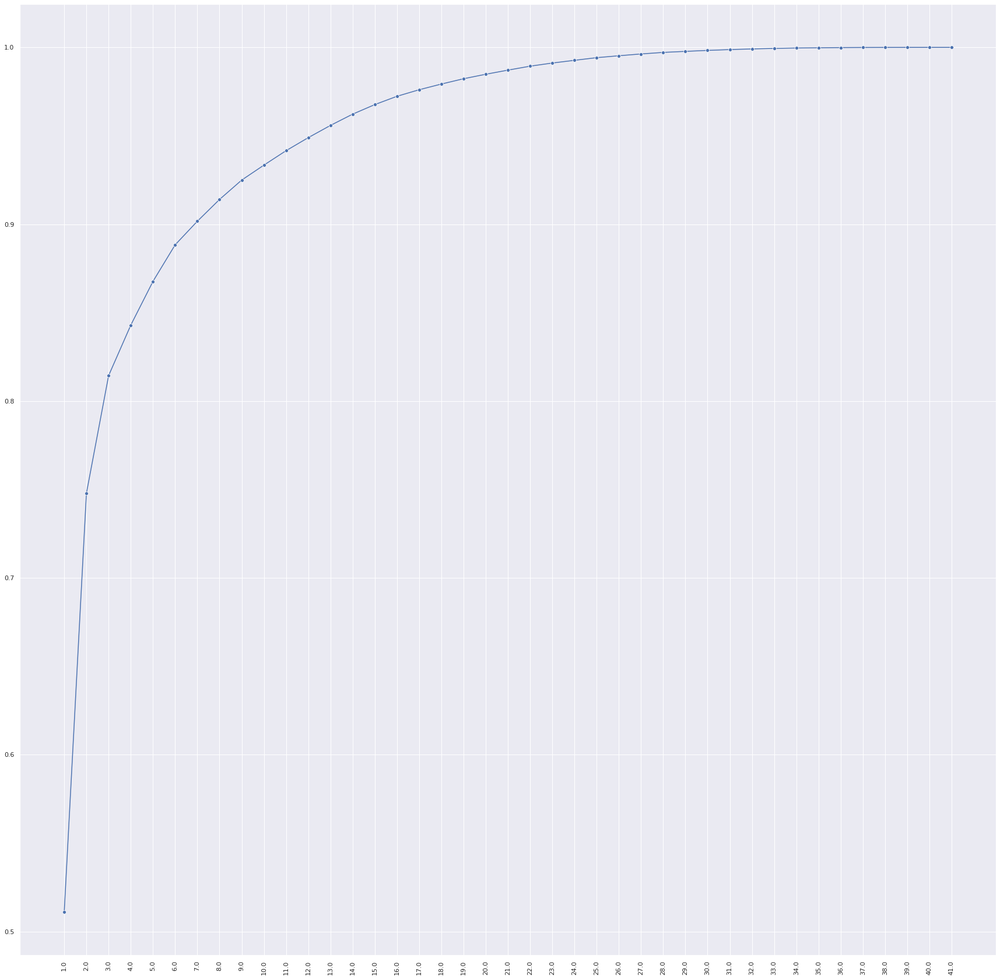

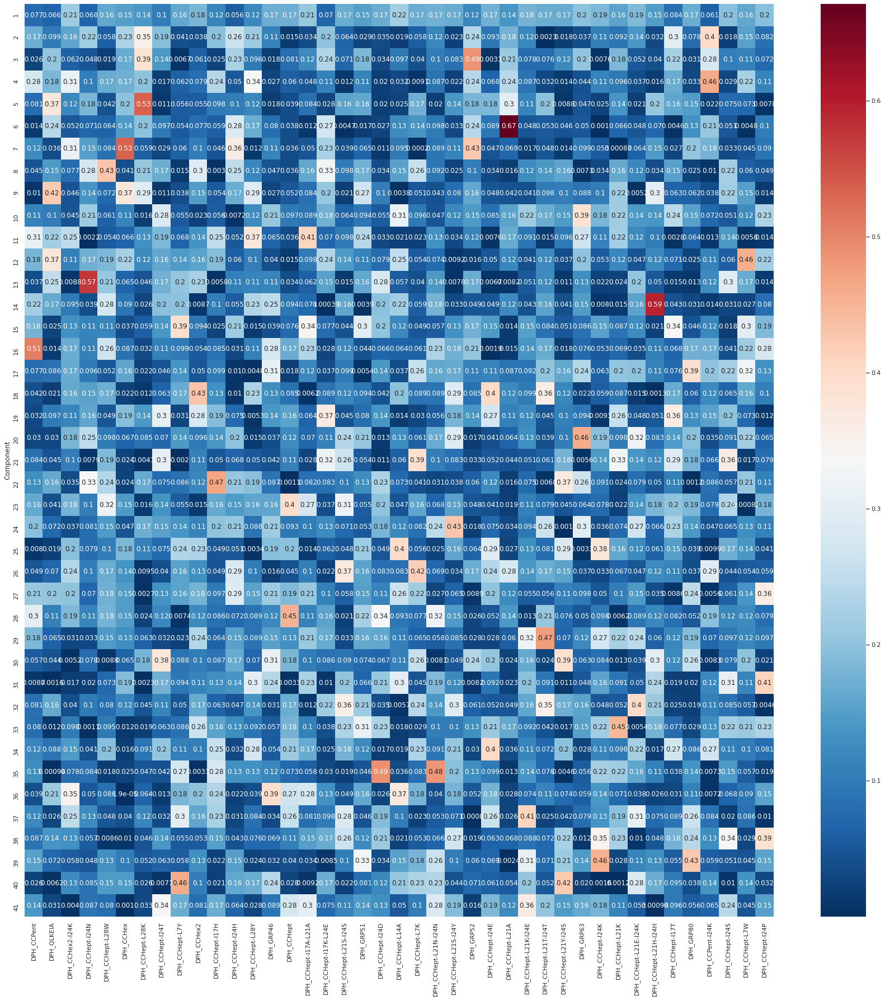

In [21]:
plt.rcParams['figure.figsize'] = (30, 30)  # Sets figure size
pca_model, pca_components = ml_2_classes.run_pca(
    fluor_data=copy.deepcopy(ml_2_classes.fluor_data).drop(kbest_feat_importances_df['Feature'].tolist()[41:], axis=1),
    scale=True, plt_name=''
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

7 components are required to represent ~90% of the variance in the data. Many of the peptides make ~ similar contributions to the first component, whereas the subsequent components tend to be dominated by the signal from one/a few peptides.

Scatter plots of data transformed to PCA dimensions

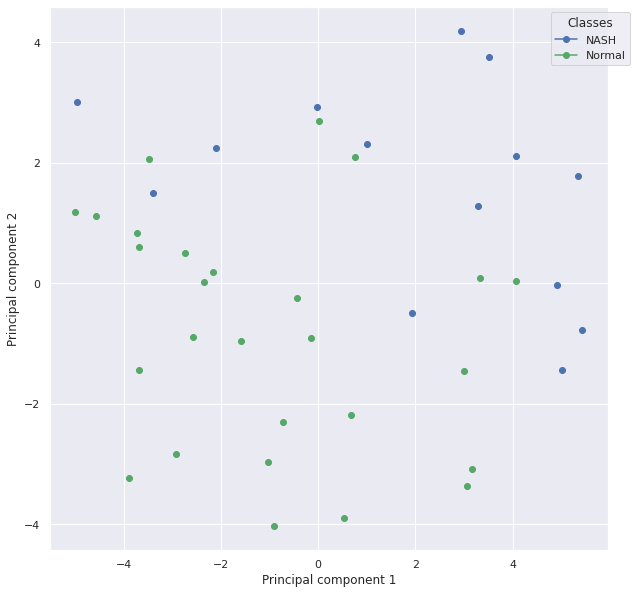

In [22]:
ml_2_classes.plot_scatter_on_pca_axes(
    x=copy.deepcopy(ml_2_classes.fluor_data).drop(kbest_feat_importances_df['Feature'].tolist()[41:], axis=1).to_numpy(),
    y=ml_2_classes.y, subclasses=ml_2_classes.sub_classes, num_dimensions=2,
    scale=True, plt_name=''
)

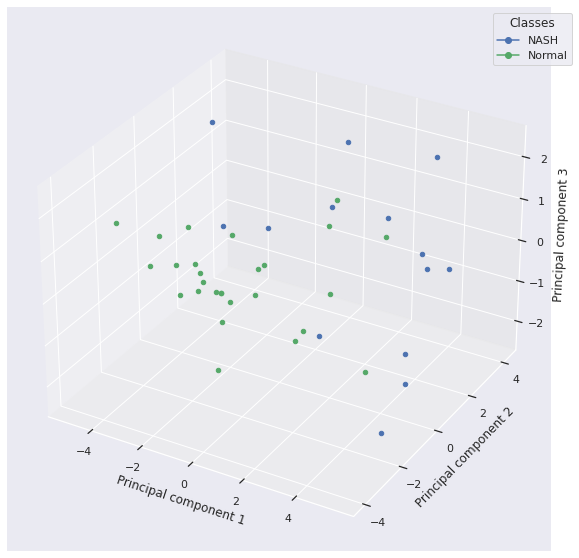

In [23]:
ml_2_classes.plot_scatter_on_pca_axes(
    x=copy.deepcopy(ml_2_classes.fluor_data).drop(kbest_feat_importances_df['Feature'].tolist()[41:], axis=1).to_numpy(),
    y=ml_2_classes.y, subclasses=ml_2_classes.sub_classes, num_dimensions=3,
    scale=True, plt_name=''
)

The 2 classes can clearly be separated by eye on these plots (although there is some overlap). Therefore expect to be able to train ML models to distinguish between the  classes much better than random guessing - will be interesting to see how good a performance can be achieved!

#### How well does a model trained with all features perform?

Runs grid search with nested cross-validation to spot check 5 different ML algorithms. Inner loop identifies the optimal parameter values to use with the ML algorithm; outer loop measures the performance of a model trained using these parameter values.

In [24]:
algorithms = [KNeighborsClassifier, GaussianNB, LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing', 'max_sampling', 'smote'] # Classes are imbalanced

n_components_pca = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 3
cv_folds_outer_loop = 3
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs={accuracy_score: {},
                    recall_score: {'average': 'weighted',
                                   'zero_division': 0},
                    precision_score: {'average': 'weighted',
                                      'zero_division': 0},
                    f1_score: {'average': 'weighted',
                               'zero_division': 0}}

all_feat_searches = OrderedDict({})
all_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': []})

for algorithm in algorithms:
    for resampling_method in resampling_methods:
        fixed_params = ml_2_classes.define_fixed_model_params(classifier=algorithm())
        if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
            fixed_params['random_state'] = 1
        tuned_params = ml_2_classes.define_tuned_model_params(
            classifier=algorithm(), x_train=ml_2_classes.x, n_folds=cv_folds_inner_loop
        )
        nested_cv_search = ml_2_classes.run_nested_CV(
            clf=algorithm, x=ml_2_classes.x, y=ml_2_classes.y, groups=None,
            selected_features=list(ml_2_classes.features), inner_splits=None, outer_splits=None,
            const_split=True, resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
            fixed_params=fixed_params, tuned_params=tuned_params, train_scoring_metric=train_scoring_metric,
            test_scoring_funcs=test_scoring_funcs, n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
            cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
        )

        all_feat_searches[
            '{}__{}'.format(algorithm.__name__, resampling_method)
        ] = copy.deepcopy(nested_cv_search)

        all_feat_score_dict['Algorithm'].append(algorithm.__name__)
        all_feat_score_dict['Resampling_method'].append(resampling_method)
        all_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
        all_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
        all_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
        all_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
        all_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
        all_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
        all_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
        all_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

        # Print output of nested CV
        for i, params in enumerate(nested_cv_search['outer_loop_params']):
            print('\n\n\n')
            print('{}: {}'.format(algorithm.__name__, resampling_method))
            print('Parameters: {}'.format(params))
            print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][i]))
            print('F1: {}'.format(nested_cv_search['test_scores']['f1'][i]))





KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 10), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8571428571428571
F1: 0.8601190476190477




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461




KNeighborsClassifier: max_sampling
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




KNeighborsClassifier: max_sampling
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'di





SVC: smote
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




SVC: smote
Parameters: OrderedDict([('random_state', 1), ('C', 4.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.7857142857142857
F1: 0.789152024446142




SVC: smote
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461




AdaBoostClassifier: no_balancing
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6428571428571429
F1: 0.6485867074102368




AdaBoostClassifier: no_balancing
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




AdaBoostClassifier: no_balancing
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461




AdaBoostCla

In [25]:
all_feat_score_df = pd.DataFrame(all_feat_score_dict)

In [26]:
all_feat_score_df

,Algorithm,Resampling_method,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,0.829670,0.031404,0.829670,0.031404,0.842085,0.047369,0.828574,0.035202
1,KNeighborsClassifier,max_sampling,0.829670,0.031404,0.829670,0.031404,0.842085,0.047369,0.828574,0.035202
2,KNeighborsClassifier,smote,0.805861,0.064909,0.805861,0.064909,0.819466,0.077323,0.806853,0.065703
3,GaussianNB,no_balancing,0.831502,0.064753,0.831502,0.064753,0.840400,0.069748,0.831230,0.066486
4,GaussianNB,max_sampling,0.807692,0.086644,0.807692,0.086644,0.825235,0.080820,0.808258,0.086075
5,GaussianNB,smote,0.831502,0.064753,0.831502,0.064753,0.840400,0.069748,0.831230,0.066486
6,LinearSVC,no_balancing,0.853480,0.058551,0.853480,0.058551,0.862408,0.058251,0.855008,0.057726
7,LinearSVC,max_sampling,0.926740,0.002590,0.926740,0.002590,0.935653,0.003963,0.925269,0.004216
8,LinearSVC,smote,0.853480,0.058551,0.853480,0.058551,0.862408,0.058251,0.855008,0.057726
9,SVC,no_balancing,0.853480,0.058551,0.853480,0.058551,0.854670,0.062984,0.850695,0.060112


In [27]:
with open('{}/All_features_CV_search_models.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((all_feat_searches, all_feat_score_df), f)

The algorithms all perform better than random guessing. LinearSVC with class balancing by random oversampling performs the best across all 4 metrics, so I will take this model forwards.

In [28]:
all_feat_searches['LinearSVC__max_sampling']['outer_loop_params']

[OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 0.03125)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 0.0625)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 0.0625)])]

In [29]:
all_feat_searches['LinearSVC__max_sampling']['best_outer_loop_params']

OrderedDict([('accuracy',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.03125)])),
             ('recall',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.03125)])),
             ('precision',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.03125)])),
             ('f1',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.03125)]))])

In [30]:
all_feat_searches['LinearSVC__max_sampling']['test_scores']['accuracy']

[0.9285714285714286, 0.9285714285714286, 0.9230769230769231]

In [31]:
all_feat_nested_pred = all_feat_searches['LinearSVC__max_sampling']['predictions']
all_feat_nested_y_true = all_feat_searches['LinearSVC__max_sampling']['y_true']
all_feat_nested_x_true = all_feat_searches['LinearSVC__max_sampling']['x_true']

all_feat_flat_pred = np.array([pred for pred_array in all_feat_nested_pred for pred in pred_array])
all_feat_flat_y_true = np.array([y for y_array in all_feat_nested_y_true for y in y_array])
all_feat_flat_x_true = np.array([x for x_array in all_feat_nested_x_true for x in x_array])

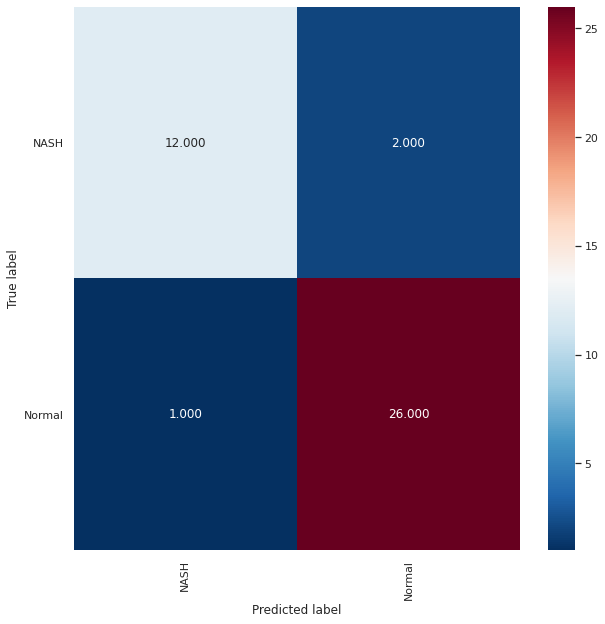

Normalised over true label (rows)


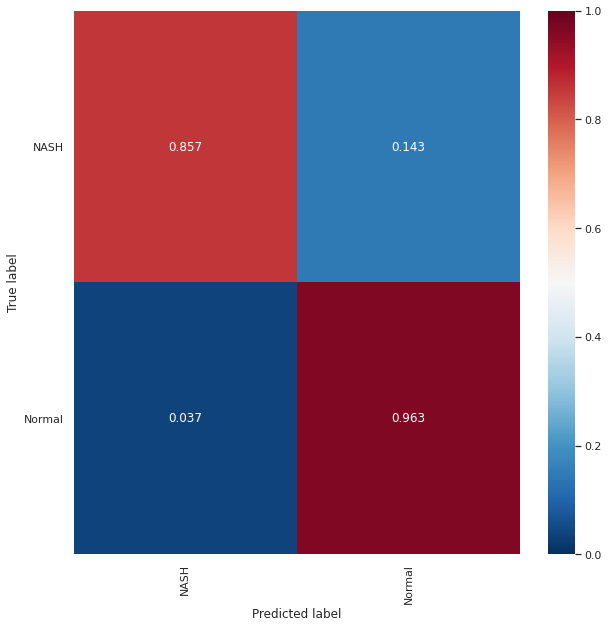

Normalised over pred label (columns)


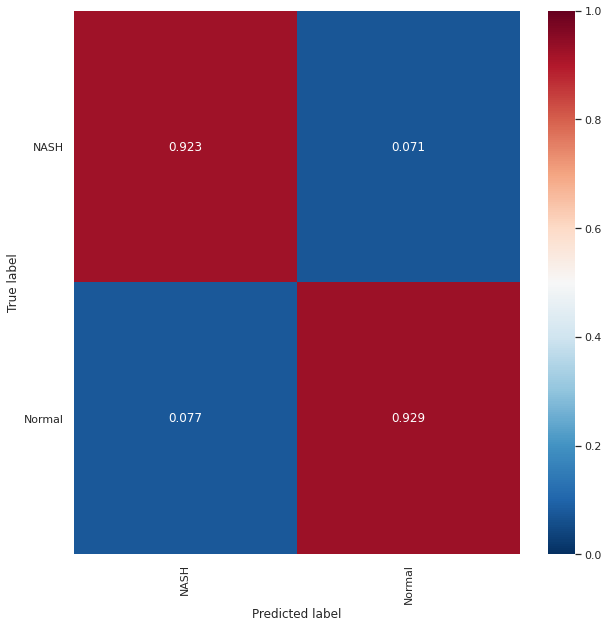

In [32]:
draw_conf_matrices(all_feat_flat_y_true, all_feat_flat_pred, ml_2_classes.results_dir, 'All_features')

In [33]:
all_feat_true_hue = []
for index, y in enumerate(all_feat_flat_y_true):
    if all_feat_flat_pred[index] == y:
        all_feat_true_hue.append('{}_correct'.format(y))
    else:
        all_feat_true_hue.append('{}_incorrect'.format(y))

sub_all_feat_true_hue = []
sub_all_feat_flat_x_true = []
sub_all_feat_flat_y_true = []
for i, true_hue in enumerate(all_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_all_feat_true_hue.append(true_hue)
        sub_all_feat_flat_x_true.append(all_feat_flat_x_true[i])
        sub_all_feat_flat_y_true.append(all_feat_flat_y_true[i])

all_feat_true_hue = np.array(all_feat_true_hue)
sub_all_feat_true_hue = np.array(sub_all_feat_true_hue)
sub_all_feat_flat_x_true = np.array(sub_all_feat_flat_x_true)
sub_all_feat_flat_y_true = np.array(sub_all_feat_flat_y_true)

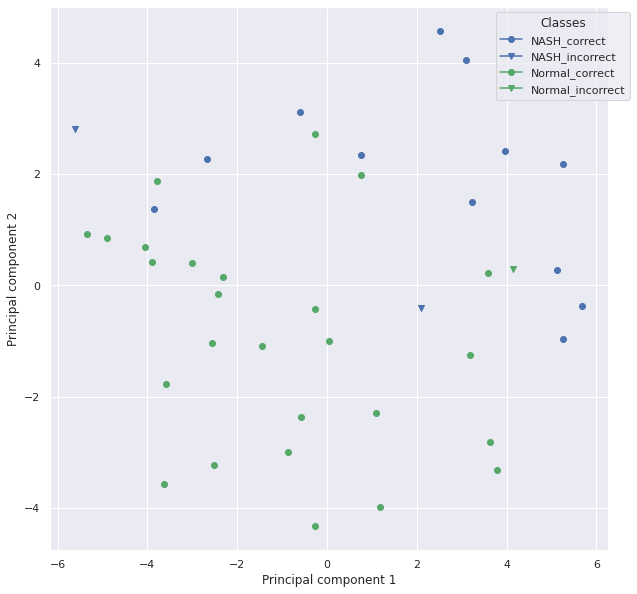

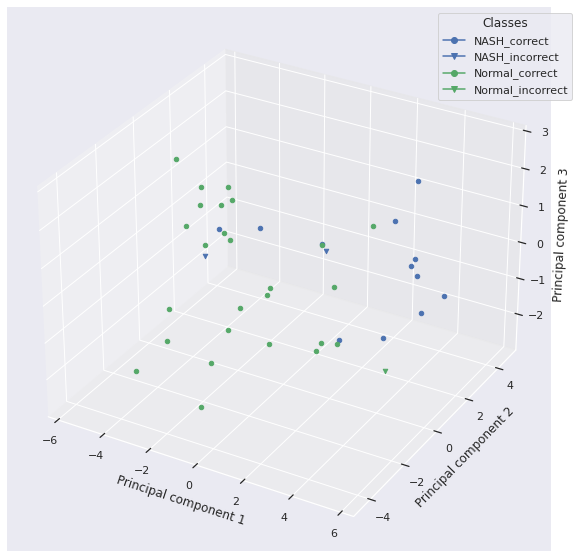

In [34]:
# Scatter plot (axes = top two principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# NASH_incorrect = Value that is actually NASH is predicted to be something else

It is possible to train an ML model that is able to identify, better than random guessing, the class labels of subclasses it was not exposed to during training, i.e. in this case the model can predict the class ("Normal" or "NASH") of a sample from a patient it hasn't seen before.

The earlier correlation coefficients and importance analysis in this notebook indicate that many of the peptides provide similar information to one another. Is it therefore possible to maintain/improve model performance by reducing the number of features?

#### Is it possible to maintain/improve model performance when reducing the number of peptides?

Sequentially include features via their feature importance (as measured via KBest/permutation analysis), measure if there is any difference in trained classifier performance.

In [41]:
algorithms = [KNeighborsClassifier, GaussianNB, LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing', 'max_sampling', 'smote']
num_features_list = [1, 2, 3, 4, 5, 10, 15, 20, 30, 46]

ordered_features = {'KBest_Fscore': kbest_feat_importances_df['Feature'].tolist(),
                    'Permutation_score': mean_permut_feat_importances_df['Feature'].tolist()}

n_components_pca = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 3
cv_folds_outer_loop = 3
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs = {accuracy_score: {},
                      recall_score: {'average': 'weighted',
                                     'zero_division': 0},
                      precision_score: {'average': 'weighted',
                                        'zero_division': 0},
                      f1_score: {'average': 'weighted',
                                 'zero_division': 0}}

red_feat_searches = OrderedDict({})
red_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Feature_selection_method': [],
                                   'Num_features': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': []})
for algorithm in algorithms:
    for resampling_method in resampling_methods:
        for feat_method, all_features in ordered_features.items():
            for num_features in num_features_list:
                fixed_params = ml_2_classes.define_fixed_model_params(classifier=algorithm())
                if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
                    fixed_params['random_state'] = 1
                tuned_params = ml_2_classes.define_tuned_model_params(
                    classifier=algorithm(), x_train=ml_2_classes.x, n_folds=cv_folds_inner_loop
                )
                selected_features = all_features[:num_features]

                nested_cv_search = ml_2_classes.run_nested_CV(
                    clf=algorithm, x=ml_2_classes.x, y=ml_2_classes.y, groups=None,
                    selected_features=selected_features, inner_splits=None, outer_splits=None, const_split=True,
                    resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
                    fixed_params=fixed_params, tuned_params=tuned_params,
                    train_scoring_metric=train_scoring_metric, test_scoring_funcs=test_scoring_funcs,
                    n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
                    cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
                )

                red_feat_searches[
                    '{}__{}__{}__{}'.format(algorithm.__name__, resampling_method, feat_method, num_features)
                ] = copy.deepcopy(nested_cv_search)

                red_feat_score_dict['Algorithm'].append(algorithm.__name__)
                red_feat_score_dict['Resampling_method'].append(resampling_method)
                red_feat_score_dict['Feature_selection_method'].append(feat_method)
                red_feat_score_dict['Num_features'].append(num_features)
                red_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
                red_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
                red_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
                red_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
                red_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
                red_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
                red_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
                red_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

                # Print output of nested CV
                for index, params in enumerate(nested_cv_search['outer_loop_params']):
                    print('\n\n\n')
                    print('{}: {},  {},  {}'.format(
                        algorithm.__name__, resampling_method, feat_method, num_features
                    ))
                    print('Parameters: {}'.format(params))
                    print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][index]))
                    print('F1: {}'.format(nested_cv_search['test_scores']['f1'][index]))





KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8571428571428571
F1: 0.8464285714285714




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 6), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.9230769230769231
F1: 0.9196067090803933




KNeighborsClassifier: no_balancing,  KBest_Fscore,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 8), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




KNeighborsClassifier: no_balancing,  KBest_Fscore,  2
Parameters: Ordere





KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 8), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8571428571428571
F1: 0.8571428571428571




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 8), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461




KNeighborsClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 3), ('p', 2), ('weights', 'distance')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




KNeighborsClassifier: no_balancing,  Permutation_sc





KNeighborsClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8571428571428571
F1: 0.8464285714285714




KNeighborsClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 9), ('p', 2), ('weights', 'distance')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




KNeighborsClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'distance')])
Accuracy: 0.6923076923076923
F1: 0.7038461538461539




KNeighborsClassifier: max_sampling,  KBest_Fscore,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 8), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.8571428571428571
F1: 0.8571428571428571




KNeighborsClassifier: max_sampling,  KBest_Fscore,  10
Parameters: O





KNeighborsClassifier: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.9285714285714286
F1: 0.9297173414820473




KNeighborsClassifier: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8571428571428571
F1: 0.8601190476190477




KNeighborsClassifier: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 8), ('p', 1), ('weights', 'distance')])
Accuracy: 0.7692307692307693
F1: 0.77526395173454




KNeighborsClassifier: max_sampling,  Permutation_score,  20
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.9285714285714286
F1: 0.9297173414820473




KNeighborsClassifier: max_sampling,  Permutation_





KNeighborsClassifier: smote,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




KNeighborsClassifier: smote,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 0.7857142857142857
F1: 0.789010989010989




KNeighborsClassifier: smote,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 2), ('weights', 'distance')])
Accuracy: 0.7692307692307693
F1: 0.77526395173454




KNeighborsClassifier: smote,  KBest_Fscore,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 6), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




KNeighborsClassifier: smote,  KBest_Fscore,  46
Parameters: OrderedDict([('metric', 'minkowski'),





GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.8571428571428571
F1: 0.8464285714285714




GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.9230769230769231
F1: 0.9196067090803933




GaussianNB: no_balancing,  KBest_Fscore,  2
Parameters: OrderedDict()
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




GaussianNB: no_balancing,  KBest_Fscore,  2
Parameters: OrderedDict()
Accuracy: 0.9285714285714286
F1: 0.926482873851295




GaussianNB: no_balancing,  KBest_Fscore,  2
Parameters: OrderedDict()
Accuracy: 0.9230769230769231
F1: 0.9250879839115134




GaussianNB: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict()
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




GaussianNB: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict()
Accuracy: 0.7142857142857143
F1: 0.7142857142





GaussianNB: max_sampling,  KBest_Fscore,  3
Parameters: OrderedDict()
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




GaussianNB: max_sampling,  KBest_Fscore,  3
Parameters: OrderedDict()
Accuracy: 0.7142857142857143
F1: 0.7202380952380951




GaussianNB: max_sampling,  KBest_Fscore,  3
Parameters: OrderedDict()
Accuracy: 0.8461538461538461
F1: 0.851923076923077




GaussianNB: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict()
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




GaussianNB: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict()
Accuracy: 0.7142857142857143
F1: 0.7202380952380951




GaussianNB: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict()
Accuracy: 0.8461538461538461
F1: 0.851923076923077




GaussianNB: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




GaussianNB: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.7142857142857143
F1: 0.72023809523





GaussianNB: smote,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




GaussianNB: smote,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.7142857142857143
F1: 0.7202380952380951




GaussianNB: smote,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.8461538461538461
F1: 0.851923076923077




GaussianNB: smote,  KBest_Fscore,  10
Parameters: OrderedDict()
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




GaussianNB: smote,  KBest_Fscore,  10
Parameters: OrderedDict()
Accuracy: 0.7142857142857143
F1: 0.7202380952380951




GaussianNB: smote,  KBest_Fscore,  10
Parameters: OrderedDict()
Accuracy: 0.9230769230769231
F1: 0.9250879839115134




GaussianNB: smote,  KBest_Fscore,  15
Parameters: OrderedDict()
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




GaussianNB: smote,  KBest_Fscore,  15
Parameters: OrderedDict()
Accuracy: 0.7142857142857143
F1: 0.7202380952380951




GaussianNB: smote,  KBest_Fscore,  15
Pa

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.8571428571428571
F1: 0.8464285714285714




LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461




LinearSVC: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




LinearSVC: no_bala





LinearSVC: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 32.0)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




LinearSVC: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.8571428571428571
F1: 0.8464285714285714




LinearSVC: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.9230769230769231
F1: 0.9196067090803933
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 16.0)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




Lin

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.9285714285714286
F1: 0.9297173414820473




LinearSVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7857142857142857
F1: 0.789152024446142




LinearSVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461
Range tested:

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.9285714285714286
F1: 0.9297173414820473




LinearSVC: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.9285714285714286
F1: 0.926482873851295




LinearSVC: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.9230769230769231
F1: 0.9196067090803933
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  





LinearSVC: max_sampling,  Permutation_score,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 64.0)])
Accuracy: 0.7857142857142857
F1: 0.789010989010989




LinearSVC: max_sampling,  Permutation_score,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.9285714285714286
F1: 0.926482873851295




LinearSVC: max_sampling,  Permutation_score,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Accuracy: 0.9230769230769231
F1: 0.9196067090803933
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.9285714285714286
F1: 0.9297173414820473


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  KBest_Fscore,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.9285714285714286
F1: 0.9297173414820473




LinearSVC: smote,  KBest_Fscore,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7857142857142857
F1: 0.789152024446142




LinearSVC: smote,  KBest_Fscore,  46
Parameters: Order

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  Permutation_score,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 64.0)])
Accuracy: 0.7857142857142857
F1: 0.789010989010989




LinearSVC: smote,  Permutation_score,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7857142857142857
F1: 0.789152024446142




LinearSVC: smote,  Permutation_score,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.9230769230769231
F1: 0.9196067090803933
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0

Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 8.0






SVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 8.0), ('kernel', 'rbf')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




SVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.5), ('kernel', 'rbf')])
Accuracy: 0.8571428571428571
F1: 0.8464285714285714




SVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('C', 4.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.8461538461538461
F1: 0.8282051282051281




SVC: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.7857142857142857
F1: 0.7794486





SVC: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.5714285714285714
F1: 0.5803571428571429




SVC: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 4.0), ('kernel', 'rbf')])
Accuracy: 0.8571428571428571
F1: 0.8571428571428571




SVC: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Val

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 3.0517578125e-05


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0,

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 3.0517578125e-05






SVC: max_sampling,  Permutation_score,  20
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




SVC: max_sampling,  Permutation_score,  20
Parameters: OrderedDict([('random_state', 1), ('C', 64.0), ('gamma', 0.001953125), ('kernel', 'rbf')])
Accuracy: 0.9285714285714286
F1: 0.926482873851295




SVC: max_sampling,  Permutation_score,  20
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy:





SVC: smote,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 64.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




SVC: smote,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 256.0), ('gamma', 0.001953125), ('kernel', 'rbf')])
Accuracy: 0.7142857142857143
F1: 0.7202380952380951




SVC: smote,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.9230769230769231
F1: 0.9250879839115134




SVC: smote,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




SVC: smote,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.7142857142857143
F1: 0.7202380952380951




SVC: smote,  KBest_Fscore,  15
Parameters: OrderedDict([('random





SVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.9285714285714286
F1: 0.9297173414820473




SVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.5), ('kernel', 'rbf')])
Accuracy: 0.9285714285714286
F1: 0.926482873851295




SVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('C', 0.5), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 3.05175781





AdaBoostClassifier: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




AdaBoostClassifier: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7857142857142857
F1: 0.789152024446142




AdaBoostClassifier: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 1.0
F1: 1.0




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.8571428571428571
F1: 0.8601190476190477




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.84





AdaBoostClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6428571428571429
F1: 0.6485867074102368




AdaBoostClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6428571428571429
F1: 0.6485867074102368




AdaBoostClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 1000)])
Accuracy: 1.0
F1: 1.0




AdaBoostClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.6428571428571429
F1: 0.6485867074102368




AdaBoostClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.8571428571428571
F1: 0.8464285714285714




AdaBoostClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.92307





AdaBoostClassifier: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




AdaBoostClassifier: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




AdaBoostClassifier: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461




AdaBoostClassifier: smote,  KBest_Fscore,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




AdaBoostClassifier: smote,  KBest_Fscore,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




AdaBoostClassifier: smote,  KBest_Fscore,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators',





AdaBoostClassifier: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7857142857142857
F1: 0.7794486215538846




AdaBoostClassifier: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7857142857142857
F1: 0.789152024446142




AdaBoostClassifier: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.8461538461538461
F1: 0.8461538461538461




AdaBoostClassifier: smote,  Permutation_score,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.7142857142857143
F1: 0.6928571428571428




AdaBoostClassifier: smote,  Permutation_score,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7142857142857143
F1: 0.7142857142857143




AdaBoostClassifier: smote,  Permutation_score,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)

In [42]:
red_feat_score_df = pd.DataFrame(red_feat_score_dict)

In [43]:
red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,KBest_Fscore,1,0.855311,0.056093,0.855311,0.056093,0.865343,0.061964,0.848495,0.057238
1,KNeighborsClassifier,no_balancing,KBest_Fscore,2,0.855311,0.056093,0.855311,0.056093,0.865343,0.061964,0.848495,0.057238
2,KNeighborsClassifier,no_balancing,KBest_Fscore,3,0.855311,0.056093,0.855311,0.056093,0.865343,0.061964,0.848495,0.057238
3,KNeighborsClassifier,no_balancing,KBest_Fscore,4,0.855311,0.056093,0.855311,0.056093,0.865343,0.061964,0.848495,0.057238
4,KNeighborsClassifier,no_balancing,KBest_Fscore,5,0.831502,0.064753,0.831502,0.064753,0.850733,0.061214,0.818052,0.072494
...,...,...,...,...,...,...,...,...,...,...,...,...
295,AdaBoostClassifier,smote,Permutation_score,10,0.805861,0.028491,0.805861,0.028491,0.809631,0.026902,0.804918,0.029426
296,AdaBoostClassifier,smote,Permutation_score,15,0.758242,0.062163,0.758242,0.062163,0.755356,0.064301,0.751099,0.067781
297,AdaBoostClassifier,smote,Permutation_score,20,0.782051,0.053897,0.782051,0.053897,0.780861,0.053843,0.779963,0.053836
298,AdaBoostClassifier,smote,Permutation_score,30,0.782051,0.053897,0.782051,0.053897,0.787012,0.054685,0.783197,0.053999


In [44]:
with open('{}/Red_features_CV_search_models.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((red_feat_searches, red_feat_score_df), f)

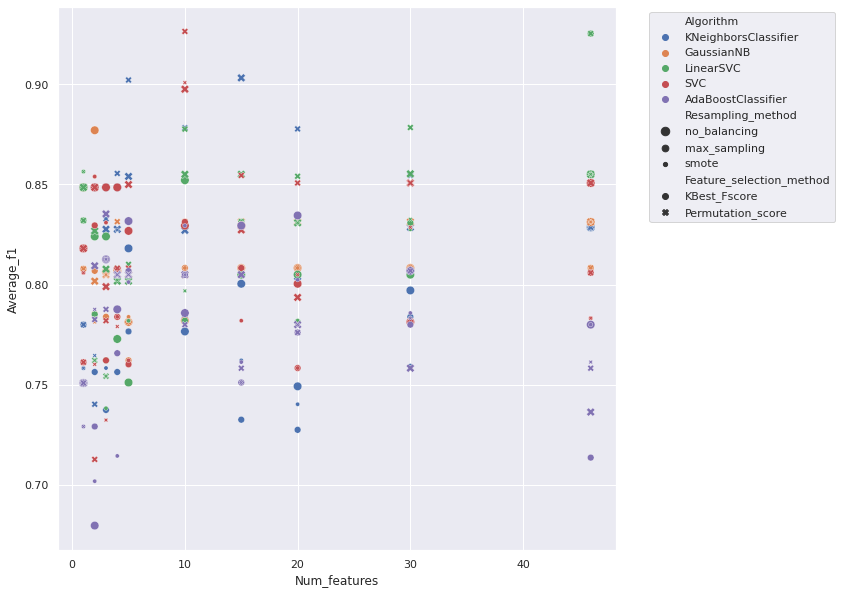

In [45]:
plt.clf()
sns.scatterplot(
    x=red_feat_score_df['Num_features'], y=red_feat_score_df['Average_f1'],
    hue=red_feat_score_df['Algorithm'], style=red_feat_score_df['Feature_selection_method'],
    size=red_feat_score_df['Resampling_method']
)
plt.legend(bbox_to_anchor=(1.05,1))
plt.savefig('{}/Number_of_features_vs_performance_scatter_plot.svg'.format(ml_2_classes.results_dir))
plt.show()

So, the number of features that leads to optimal performance varies depending upon the model. In general though, can achieve an equivalent performance to all 46 peptides with ~5-10 peptides. Typically the selection of features made with permutation analysis leads to better performance as compared to KBest, but this is not always the case! Moreover, in most cases model performance plateaus, rather than peaking (and then declining when extra features are included), thus indicating that the additional peptides are not introducing substantial amounts of noise into the dataset.

However, it is important to remember that this is a very small dataset, and hence the random errors associated with these metric scores will be large! Therefore it is likely that if this analysis were repeated with a different random seed, the scores would vary substantially. It's also likely that with a larger dataset, which will likely have greater variation in the fingerprints generated by samples in different classes, the best-performing trained models would not perform quite as well as they do here (but their scores would more accurately reflect how they would perform when classifying unseen data). That being said, the trained models clearly perform much better than random guessing at identifying the two classes.

In [46]:
sub_red_feat_score_df = red_feat_score_df[
      (red_feat_score_df['Num_features'] == 10)
    & (red_feat_score_df['Feature_selection_method'] == 'Permutation_score')
].reset_index(drop=True)

In [47]:
sub_red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,Permutation_score,10,0.827839,0.071546,0.827839,0.071546,0.836081,0.070532,0.827065,0.070320
1,KNeighborsClassifier,max_sampling,Permutation_score,10,0.875458,0.075114,0.875458,0.075114,0.890446,0.070754,0.878233,0.072810
2,KNeighborsClassifier,smote,Permutation_score,10,0.780220,0.007770,0.780220,0.007770,0.791041,0.007547,0.781288,0.005817
3,GaussianNB,no_balancing,Permutation_score,10,0.805861,0.028491,0.805861,0.028491,0.809631,0.026902,0.804918,0.029426
4,GaussianNB,max_sampling,Permutation_score,10,0.827839,0.071546,0.827839,0.071546,0.843819,0.068474,0.831378,0.069767
5,GaussianNB,smote,Permutation_score,10,0.831502,0.064753,0.831502,0.064753,0.840400,0.069748,0.831230,0.066486
6,LinearSVC,no_balancing,Permutation_score,10,0.853480,0.058551,0.853480,0.058551,0.862408,0.058251,0.855008,0.057726
7,LinearSVC,max_sampling,Permutation_score,10,0.877289,0.036538,0.877289,0.036538,0.893276,0.036713,0.877585,0.035043
8,LinearSVC,smote,Permutation_score,10,0.804029,0.038155,0.804029,0.038155,0.842543,0.043977,0.796828,0.045504
9,SVC,no_balancing,Permutation_score,10,0.902930,0.032454,0.902930,0.032454,0.916533,0.023715,0.897506,0.036226


Most of the algorithms perform similarly well, but will select SVC classifier with class balancing via random oversampling, as it has the highest performance scores across all four metrics.

In [48]:
red_feat_searches['SVC__max_sampling__Permutation_score__10']['outer_loop_params']

[OrderedDict([('random_state', 1),
              ('C', 0.03125),
              ('gamma', 0.0625),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 0.03125),
              ('gamma', 0.5),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 0.5),
              ('gamma', 0.125),
              ('kernel', 'rbf')])]

In [49]:
red_feat_searches['SVC__max_sampling__Permutation_score__10']['best_outer_loop_params']

OrderedDict([('accuracy',
              OrderedDict([('random_state', 1),
                           ('C', 0.03125),
                           ('gamma', 0.0625),
                           ('kernel', 'rbf')])),
             ('recall',
              OrderedDict([('random_state', 1),
                           ('C', 0.03125),
                           ('gamma', 0.0625),
                           ('kernel', 'rbf')])),
             ('precision',
              OrderedDict([('random_state', 1),
                           ('C', 0.03125),
                           ('gamma', 0.0625),
                           ('kernel', 'rbf')])),
             ('f1',
              OrderedDict([('random_state', 1),
                           ('C', 0.03125),
                           ('gamma', 0.0625),
                           ('kernel', 'rbf')]))])

In [50]:
red_feat_nested_pred = red_feat_searches['SVC__max_sampling__Permutation_score__10']['predictions']
red_feat_nested_y_true = red_feat_searches['SVC__max_sampling__Permutation_score__10']['y_true']
red_feat_nested_x_true = red_feat_searches['SVC__max_sampling__Permutation_score__10']['x_true']

red_feat_flat_pred = np.array([pred for pred_array in red_feat_nested_pred for pred in pred_array])
red_feat_flat_y_true = np.array([y for y_array in red_feat_nested_y_true for y in y_array])
red_feat_flat_x_true = np.array([x for x_array in red_feat_nested_x_true for x in x_array])

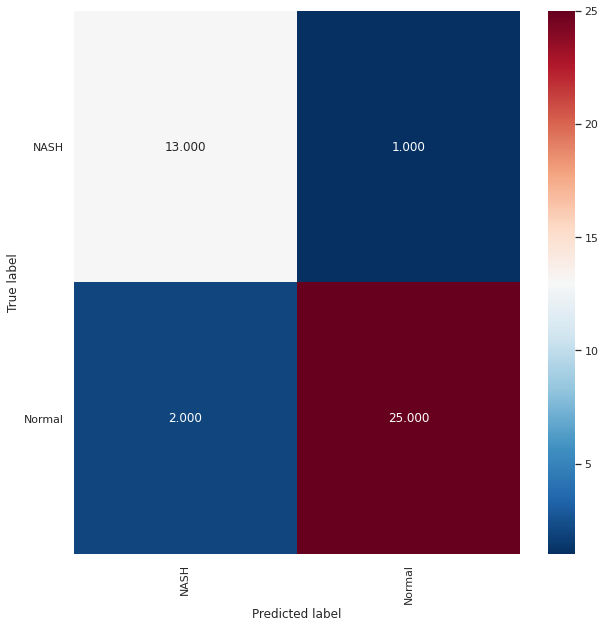

Normalised over true label (rows)


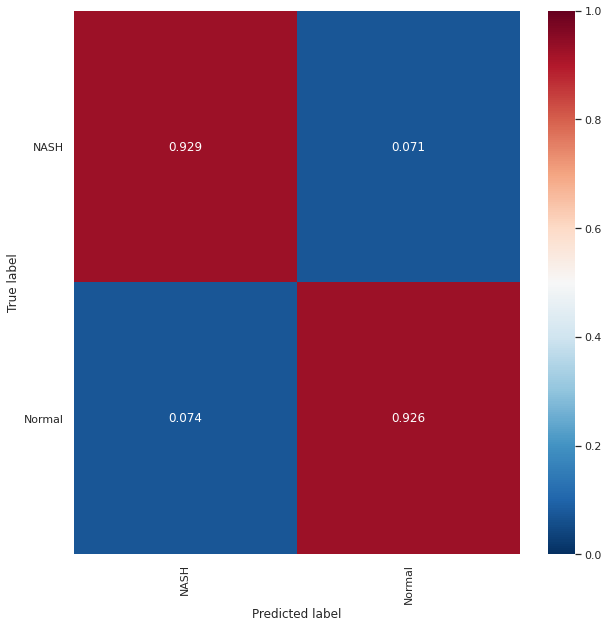

Normalised over pred label (columns)


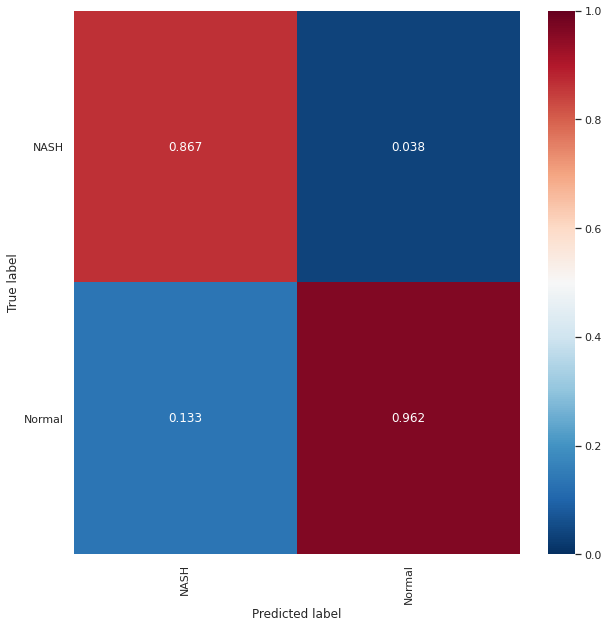

In [51]:
draw_conf_matrices(red_feat_flat_y_true, red_feat_flat_pred, ml_2_classes.results_dir, 'Red_features')

In [52]:
red_feat_true_hue = []
for index, y in enumerate(red_feat_flat_y_true):
    if red_feat_flat_pred[index] == y:
        red_feat_true_hue.append('{}_correct'.format(y))
    else:
        red_feat_true_hue.append('{}_incorrect'.format(y))

sub_red_feat_true_hue = []
sub_red_feat_flat_x_true = []
sub_red_feat_flat_y_true = []
for i, true_hue in enumerate(red_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_red_feat_true_hue.append(true_hue)
        sub_red_feat_flat_x_true.append(red_feat_flat_x_true[i])
        sub_red_feat_flat_y_true.append(red_feat_flat_y_true[i])

red_feat_true_hue = np.array(red_feat_true_hue)
sub_red_feat_true_hue = np.array(sub_red_feat_true_hue)
sub_red_feat_flat_x_true = np.array(sub_red_feat_flat_x_true)
sub_red_feat_flat_y_true = np.array(sub_red_feat_flat_y_true)

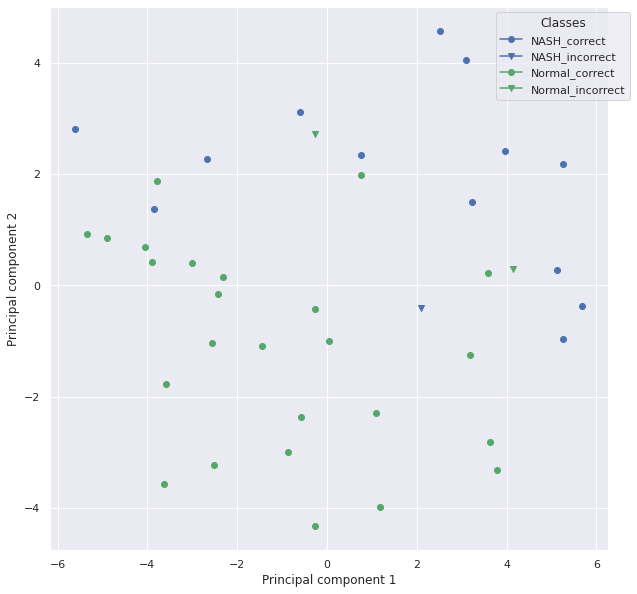

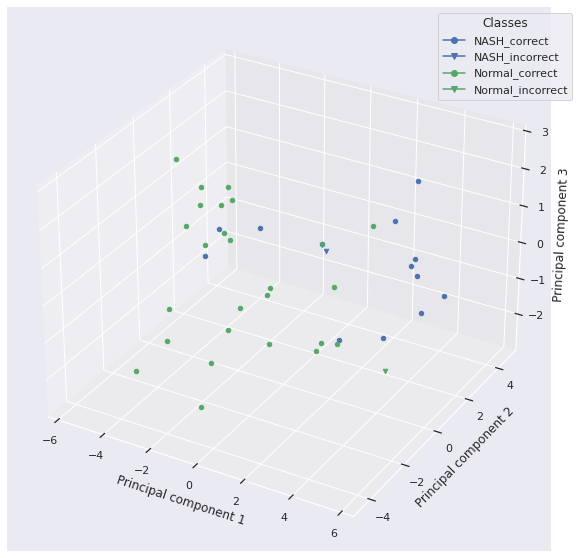

In [53]:
# Scatter plot (axes = top two principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# Black_incorrect = Value that is actually black is predicted to be something else

So, a SVC model trained with 10 peptides (selected as most important by permutation analysis) performs similarly well to a LinearSVC model trained with data from all 46 peptides.

Is there a significant difference between the two models?

In [54]:
params_1 = all_feat_searches['LinearSVC__max_sampling']['best_outer_loop_params']['f1']
selected_features_1 = list(ml_2_classes.features)
params_2 = red_feat_searches['SVC__max_sampling__Permutation_score__10']['best_outer_loop_params']['f1']
selected_features_2 = mean_permut_feat_importances_df['Feature'].tolist()[:10]

print('Model 1:')
print('Algorithm: LinearSVC')
print('Parameters:\n{}'.format(params_1))
print('Features:\n{}'.format(selected_features_1))
print('\n\n\n')
print('Model 2:')
print('Algorithm: SVC')
print('Parameters:\n{}'.format(params_2))
print('Features:\n{}'.format(selected_features_2))

F, p = ml_2_classes.run_5x2_CV_combined_F_test(
    x=ml_2_classes.x, y=ml_2_classes.y, selected_features_1=selected_features_1,
    selected_features_2=selected_features_2, classifier_1=LinearSVC, classifier_2=SVC, params_1=params_1,
    params_2=params_2, resampling_method_1='max_sampling', resampling_method_2='max_sampling',
    n_components_pca_1=None, n_components_pca_2=None
)

Model 1:
Algorithm: LinearSVC
Parameters:
OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Features:
['DPH_CCPent', 'DPH_QLKEIA', 'DPH_CCHex2-I24K', 'DPH_CCHept-I24N', 'DPH_CCHept-L28W', 'DPH_GRP22', 'DPH_CCHex', 'DPH_NLKEIA', 'DPH_CCHept-L28K', 'DPH_CCHept-I24T', 'DPH_CCHept-L7Y', 'DPH_CCHex2', 'DPH_CCHept-I17G-L21G', 'DPH_CCHept-I17H', 'DPH_CCHept-I24H', 'DPH_CCHept-L28Y', 'DPH_GRP46', 'DPH_CCHept', 'DPH_CCHept-I17A-L21A', 'DPH_CCHept-I17K-L24E', 'DPH_CCHept-L21S-I24S', 'DPH_CCHept-I24Y', 'DPH_GRP51', 'DPH_CCHept-I24D', 'DPH_CCHept-L14A', 'DPH_CCHept-L7K', 'DPH_CCHept-L21N-I24N', 'DPH_CCHept-L21S-I24Y', 'DPH_GRP52', 'DPH_CCHept-I24E', 'DPH_CCHept-L21A', 'DPH_CCHept-L21K-I24E', 'DPH_CCHept-L21T-I24T', 'DPH_CCHept-L21Y-I24S', 'DPH_GRP63', 'DPH_CCHept-I24K', 'DPH_CCHept-L21K', 'DPH_CCHept-L21E-I24K', 'DPH_CCHept-L21H-I24H', 'DPH_CCHept-I17T', 'DPH_GRP80', 'DPH_CCHept-I17K', 'DPH_CCPent-I24K', 'DPH_CCHept-I24S', 'DPH_CCHept-L7W', 'DPH_CCHept-I24P']

In [55]:
print('F score: {}'.format(F))
print('p value: {}'.format(p))

F score: 0.802801625148459
p value: 0.6422456960160381


So, there is no significant difference in performance when reduce the number of peptides from 46 to 10.